In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import time
import math

import torch
# import torch.utils.data as data
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

# import torchvision
# from torchvision.datasets import MNIST
# from torchvision import transforms

from sklearn.datasets import make_moons

# if torch.cuda.is_available():
#     device = torch.device('cuda')
#     dtype = torch.cuda.FloatTensor
# else:
device = torch.device('cpu')
dtype = torch.FloatTensor
print(device)

cpu


# Utils

In [2]:
def get_moons(n_samples):
    y, _ = make_moons(n_samples=n_samples, noise=0.05)
    y = torch.from_numpy(y).to(torch.float32).to(device)
    return y

def get_two_moons_centered(n_samples):
    y = get_moons(n_samples)
    y[:, 0] = y[:, 0] - y[:, 0].mean()
    y[:, 1] = y[:, 1] - y[:, 1].mean()
    return y

def generate_x_grid(points_to_grid, nr, nc):
    # generate grid for plotting purpose
    xmin, ymin = 1.1*torch.min(points_to_grid, dim=0)[0]
    xmax, ymax = 1.1*torch.max(points_to_grid, dim=0)[0]
    xs = torch.linspace(xmin, xmax, steps=nr)
    ys = torch.linspace(ymin, ymax, steps=nc)
    xm, ym = torch.meshgrid(xs, ys, indexing='ij')
    xm = xm.T
    ym = ym.T
    xgrid = torch.cat((xm.reshape(nr*nc,1),ym.reshape(nr*nc,1)),1).to(device)
    return xm, ym, xgrid


def gaussian_2d(xgrid, mux=0, muy=0, sigmax=1, sigmay=1):
    return 1 / (2*math.pi*sigmax*sigmay) * \
      torch.exp(-((xgrid[:, 0] - mux)**2 / (2*sigmax**2) + (xgrid[:, 1] - muy)**2 / (2*sigmay**2)))

In [3]:
d = 2   # dimension of the data points
n = 200   # number of generated data points
nr, nc = 256, 256 # Grid number of points

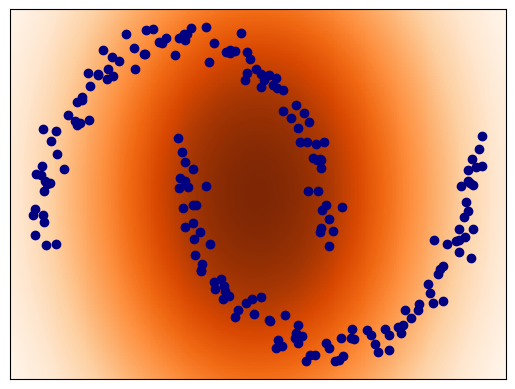

In [4]:
y = get_two_moons_centered(n)
xm, ym, xgrid = generate_x_grid(y, nr, nc)

# Plot data points
fig = plt.figure(dpi=100)
plt.xticks([])
plt.yticks([])
plt.pcolormesh(xm, ym, gaussian_2d(xgrid).detach().cpu().numpy().reshape(nr,nc), cmap = 'Oranges')
plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
plt.show()

In [4]:
def save_checkpoint(model, ema, optimizer, filepath):
    checkpoint = {
        'model_state_dict': model.state_dict(),
        'ema_state_dict': ema.shadow,
        'optimizer_state_dict': optimizer.state_dict(),
    }
    torch.save(checkpoint, filepath)
    
def load_checkpoint(model, ema, optimizer, filepath):
    checkpoint = torch.load(filepath,)
    model.load_state_dict(checkpoint['model_state_dict'])
    
    # Load EMA parameters if available
    if 'ema_state_dict' in checkpoint:
        for name, param in model.named_parameters():
            if param.requires_grad and name in checkpoint['ema_state_dict']:
                ema.shadow[name] = checkpoint['ema_state_dict'][name].clone()
    
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

# Degradation model

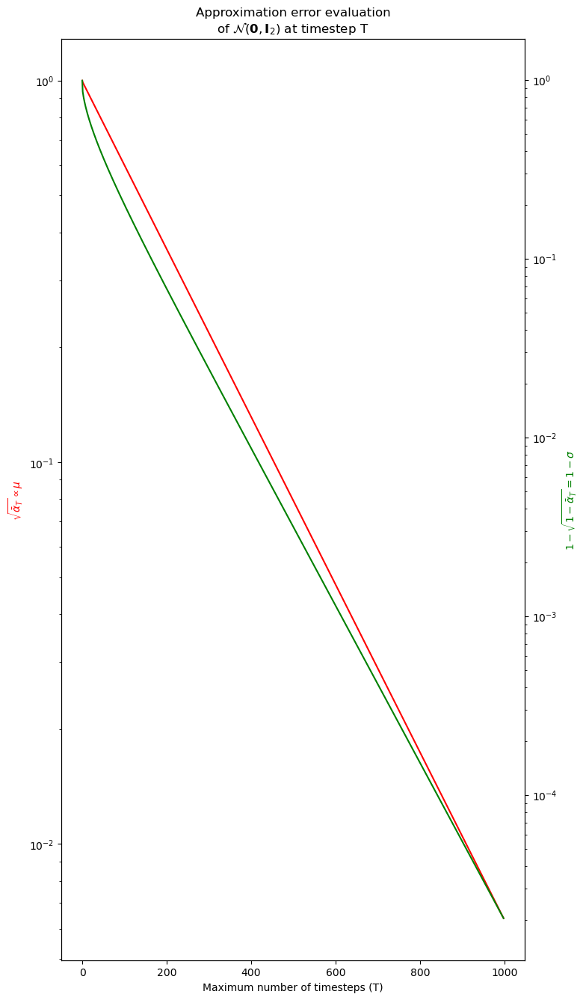

In [48]:
mu_prior, sigma_prior = [], []
for num_diffusion_timesteps in range(1, 1000):
    reversed_time_steps = np.arange(num_diffusion_timesteps)[::-1]
    beta_start = 0.0001
    beta_end = 0.02
    betas = np.linspace(beta_start, beta_end, num_diffusion_timesteps,
                                    dtype=np.float64)
    alphas = 1.0 - betas
    alphas_cumprod = np.cumprod(alphas, axis=0)
    mu_prior.append(np.sqrt(alphas_cumprod[num_diffusion_timesteps-1]))
    sigma_prior.append(1-np.sqrt(1-alphas_cumprod[num_diffusion_timesteps-1]))
fig, ax = plt.subplots(figsize = (8, 16))
ax.set_xlabel("Maximum number of timesteps (T)")
ax_twin = ax.twinx()
ax.semilogy(mu_prior, label="mu", c="r")
ax_twin.semilogy(sigma_prior, label="sigma", c="g")
eqy = (r"$\sqrt{\bar{\alpha}_T}\propto\mu$")
ax.set_ylabel(eqy, color="red")
eqy = (r"$1-\sqrt{1-\bar{\alpha}_T} = 1-\sigma$")
ax_twin.set_ylabel(eqy, color="green")
g = r"$\mathcal{N}(\mathbf{0}, \mathbf{I}_2$)"
plt.title(f"Approximation error evaluation\nof {g} at timestep T")
plt.savefig("./figures/degradation_model/approx_error")
plt.show()
plt.close()

In [5]:
def degrade_data_point(datapoint, alphas_cumprod, t, eps = None):
    n_samples, n_repet = t.shape
    datapoint_repeted = datapoint.unsqueeze(dim=1).expand((-1, n_repet, -1)) # [N, n_repet, d=2]
    eps = torch.randn_like(datapoint_repeted) if eps is None else eps.view((n_samples, n_repet, 2)) # [N, n_repet, d=2]
    t_flatten = t.view(-1)
    coeff_x = torch.sqrt(alphas_cumprod[t_flatten]).view(t.shape).unsqueeze(dim=-1) # [N, n_repet, 1]
    coeff_eps = torch.sqrt(1-alphas_cumprod[t_flatten]).view(t.shape).unsqueeze(dim=-1) # [N, n_repet, 1]
    degraded_x = coeff_x * datapoint_repeted + coeff_eps * eps
    return degraded_x.view(-1, 2), eps.view(-1, 2)

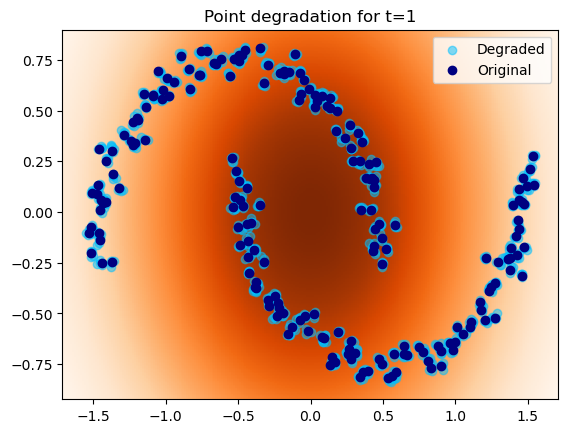

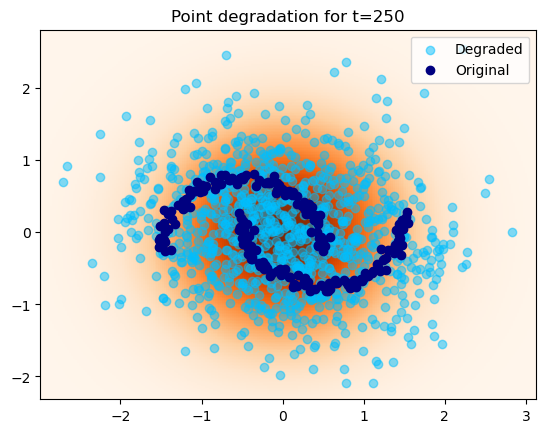

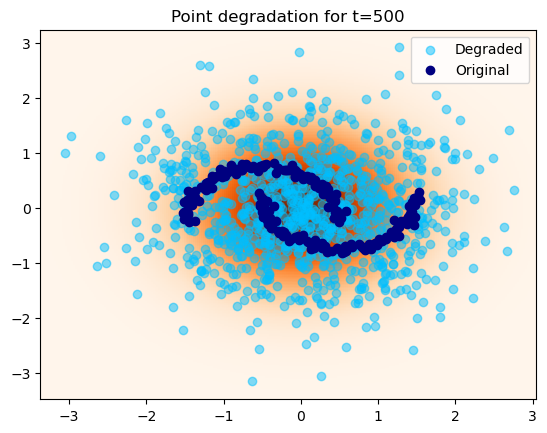

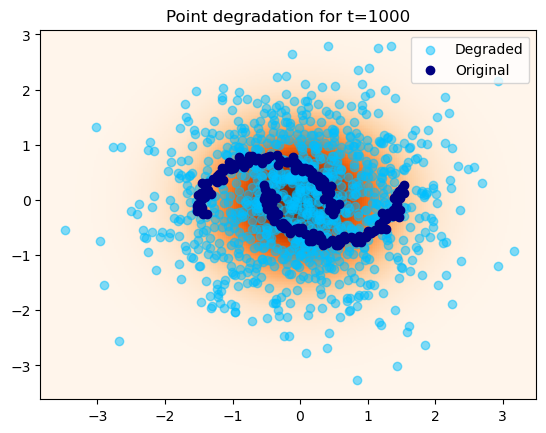

In [9]:
num_diffusion_timesteps = 1000
nb_degradation_per_point = 5

# Degradation parameters
reversed_time_steps = torch.tensor(list(range(num_diffusion_timesteps))[::-1])
beta_start = 0.0001
beta_end = 0.02
betas = torch.linspace(beta_start, beta_end, num_diffusion_timesteps, dtype=torch.float32)
alphas = 1.0 - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = torch.cat((torch.tensor([1.0]), alphas_cumprod[:-1]), dim=0)

for t in [0, num_diffusion_timesteps//4-1, num_diffusion_timesteps//2-1, num_diffusion_timesteps-1]:
    degraded_points = degrade_data_point(y, alphas_cumprod, t*torch.ones((n, nb_degradation_per_point)).to(torch.int32))[0]
    xm, ym, xgrid = generate_x_grid(degraded_points, nr, nc)
    fig = plt.figure(dpi=100)

    # Global gaussian plot
    plt.pcolormesh(xm, ym, gaussian_2d(xgrid).detach().cpu().numpy().reshape(nr,nc), cmap = 'Oranges')
    
    # Plot original and degraded points
    plt.scatter(degraded_points[:, 0].cpu(), degraded_points[:,1].cpu(), c='deepskyblue', alpha=.5, label="Degraded")
    plt.scatter(y[:, 0].cpu(), y[:,1].cpu(), c='navy', label="Original")
    plt.title(f"Point degradation for t={t+1}")
    plt.legend(loc="upper right")
    plt.savefig(f"./figures/degradation_model/degradation_T{num_diffusion_timesteps}_t{t+1}")
    plt.show()
    plt.close()

# Diffusion model

In [ ]:
class EncoderDiscreteTimeResidualBlock(nn.Module):
    """Generic block to learn a nonlinear function f(x, t), where
    t is discrete and x is continuous."""

    def __init__(self, d_model: int, n_time_steps: int = 20):
        super().__init__()
        self.emb = nn.Embedding(n_time_steps, d_model)
        self.layer = nn.Sequential(
            nn.LayerNorm(d_model),
            nn.SiLU(),
            nn.Linear(d_model, d_model),
            nn.LayerNorm(d_model),
            nn.SiLU(),
            nn.Linear(d_model, d_model),
        )

    def forward(self, x, t):
        return x + self.layer(x) + self.emb(t)

class BottleneckBlock(nn.Module):
    """Generic block to learn a nonlinear function f(x, t), where
    t is discrete and x is continuous."""

    def __init__(self, d_model: int, n_time_steps: int = 20):
        super().__init__()
        self.emb1 = nn.Embedding(n_time_steps, d_model)
        self.emb2 = nn.Embedding(n_time_steps, d_model)
        self.middle_t = nn.Embedding(n_time_steps, d_model)
        self.middle1 = nn.Sequential(
            nn.LayerNorm(d_model),
            nn.SiLU(),
            nn.Linear(d_model, d_model)
        )
        self.middle2 = nn.Sequential(
            nn.LayerNorm(d_model),
            nn.SiLU(),
            nn.Linear(d_model, d_model)
        )

    def forward(self, x, t):
        x = self.middle1(x) + self.emb1(t)
        return self.middle2(x) + self.emb2(t)

class DecoderDiscreteTimeResidualBlock(nn.Module):
    """Generic block to learn a nonlinear function f(x, t), where
    t is discrete and x is continuous."""

    def __init__(self, d_model: int, n_time_steps: int = 20):
        super().__init__()
        self.emb = nn.Embedding(n_time_steps, d_model)
        self.layer = nn.Sequential(
            nn.LayerNorm(2*d_model),
            nn.SiLU(),
            nn.Linear(2*d_model, d_model),
            nn.LayerNorm(d_model),
            nn.SiLU(),
            nn.Linear(d_model, d_model),
        )

    def forward(self, x, x_enc, t):
        return x + self.layer(torch.cat([x, x_enc], dim=-1)) + self.emb(t)

class OutDecoder(nn.Module):
    def __init__(self, d_model: int, n_time_steps: int = 20):
        super().__init__()
        self.emb = nn.Embedding(n_time_steps, d_model)
        self.lin_out1 = nn.Sequential(
            nn.LayerNorm(d_model),
            nn.Tanh(),
            nn.Linear(d_model, d_model))
        
        self.lin_out2 = nn.Sequential(
            nn.LayerNorm(d_model),
            nn.Tanh(),
            nn.Linear(d_model, 2))
    
    def forward(self, x, t):
        x = self.lin_out1(x) + self.emb(t)
        return self.lin_out2(x)

    
    
class BasicDiscreteTimeModel(nn.Module):
    def __init__(self, d_model: int = 128, n_blocks: int = 2, n_time_steps: int = 20, dim_in: int = 2):
        super().__init__()
        self.dim_output = dim_in
        
        # Degradation parameters
        self.num_diffusion_timesteps = n_time_steps
        self.reversed_time_steps = torch.tensor(list(range(self.num_diffusion_timesteps))[::-1])

        beta_start = 0.0001
        beta_end = 0.02
        self.betas = torch.linspace(beta_start, beta_end, self.num_diffusion_timesteps, dtype=torch.float32)
        self.alphas = 1.0 - self.betas
        self.alphas_cumprod = torch.cumprod(self.alphas, axis=0)
        self.alphas_cumprod_prev = torch.cat((torch.tensor([1.0]), self.alphas_cumprod[:-1]), dim=0)


        self.d_model = d_model
        self.n_blocks = n_blocks

        self.lin_in = nn.Linear(dim_in, d_model)
        
        self.encoder_blocks = nn.ParameterList([EncoderDiscreteTimeResidualBlock(d_model=d_model, n_time_steps=n_time_steps) for _ in range(n_blocks)])
        self.middle = BottleneckBlock(d_model, n_time_steps)
        self.decoder_blocks = nn.ParameterList([DecoderDiscreteTimeResidualBlock(d_model=d_model, n_time_steps=n_time_steps) for _ in range(n_blocks)])
        self.out = OutDecoder(d_model, n_time_steps)

    def forward(self, x, t):
        x = self.lin_in(x)

        x_enc = []
        for block in self.encoder_blocks:
            x = block(x, t)
            x_enc.append(x)

        x = self.middle(x, t)

        x_enc.reverse()
        for i, block in enumerate(self.decoder_blocks):
            x = block(x, x_enc[i], t)
            
        return self.out(x, t)

    def get_eps_from_model(self, x, t):
        return self.forward(x, t)
    
    def sample(self, nb_samples):
        self.eval()
        with torch.no_grad():  # avoid backprop wrt model parameters
            x = torch.randn((nb_samples, self.dim_output), device=device)  # [n_samples, d=2]
            for t in self.reversed_time_steps:
                z = torch.randn_like(x) if t> 0 else torch.zeros_like(x) # [n_samples, d=2]
                eps = self.get_eps_from_model(x, torch.tensor(t).unsqueeze(0).expand((nb_samples,))) # [n_samples, d=2]
                coef = (1-self.alphas[t])/np.sqrt(1-self.alphas_cumprod[t])
                mu = 1/np.sqrt(self.alphas[t]) * (x - coef * eps)
                x = mu + np.sqrt(self.betas[t]) * z
        return x

In [6]:
class EMA:
    def __init__(self, model, decay):
        self.model = model
        self.decay = decay
        self.shadow = {}
        self.backup = {}

        for name, param in self.model.named_parameters():
            if param.requires_grad:
                self.shadow[name] = param.clone()
    
    def update(self):
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                new_average = (1. - self.decay) * param.data + self.decay * self.shadow[name]
                self.shadow[name] = new_average.clone()
    
    def apply_shadow(self):
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                self.backup[name] = param.data.clone()
                param.data = self.shadow[name]
    
    def restore(self):
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                param.data = self.backup[name]

In [7]:
def sample_and_plot(model, nb_samples, title, savepath):
    with torch.no_grad():
        fig = plt.figure(dpi=100)
        # Plot original and degraded points
        sampled_points = model.sample(nb_samples=nb_samples)
        plt.scatter(sampled_points[:, 0].cpu(), sampled_points[:,1].cpu(), c='deepskyblue', alpha=.5)
        plt.scatter(y[:, 0].cpu(), y[:,1].cpu(), c='navy')
        plt.title(title)
        plt.savefig(savepath)
        plt.show()
        plt.close()

def plot_loss(losses, savepath):
    plt.plot(losses["epochs"], losses["loss"])
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Loss evolution during training")
    plt.savefig(savepath)
    plt.show()
    plt.close()

In [8]:
def train_diffusion(nepochs=10000, lr=1e-3, ema_decay=0.9,
                    n_samples_per_batch=128, nb_degradation_per_datapoint=1,
                    d_model=128, n_blocks=5, num_diffusion_timesteps=1000,
                    epoch_log=1, epoch_display=1, nb_samples_display=256,
                    fig_savepath = "", model_savepath=""):
    
    # Model definition
    score_model = BasicDiscreteTimeModel(d_model = d_model,
                                        n_blocks = n_blocks,
                                        n_time_steps=num_diffusion_timesteps).to(device)
    optimizer = optim.AdamW(score_model.parameters(), lr=lr)
    ema_score_model = EMA(score_model, decay = ema_decay)

    # Initial plot
    if not os.path.exists(fig_savepath):
        os.makedirs(fig_savepath)
    sample_and_plot(score_model, nb_samples_display,
                    title = "Initial model sampling",
                    savepath = f"{fig_savepath}/epoch0")
    
    # Train
    all_losses = {"epochs": [], "loss": []}
    losses = []
    score_model.train()
    for epoch in range(1, 1+nepochs):
        optimizer.zero_grad()
        ## Sample batch
        y = get_two_moons_centered(n_samples_per_batch)
        ## Degrade datapoints
        t = torch.randint(0, score_model.num_diffusion_timesteps, (n_samples_per_batch, nb_degradation_per_datapoint))
        x_t, eps_to_predict = degrade_data_point(y, score_model.alphas_cumprod, t)
        ## Predict noise
        eps_predicted = score_model(x_t, t.view(-1))
        ## Compute loss
        loss = F.mse_loss(eps_predicted, eps_to_predict, reduction="sum")
        ## Optimization step
        loss.backward()
        nn.utils.clip_grad_norm_(score_model.parameters(), 1.0)
        optimizer.step()
        ema_score_model.update()
        losses.append(loss.cpu().detach().item())

        # Intermediary log
        if((epoch)%epoch_log == 0):
            print('[%d/%d] \tLoss: %.4f' % (epoch, nepochs, loss.item()))
            all_losses["epochs"].append(epoch)
            all_losses["loss"].append(sum(losses)/len(losses))
            losses = []
        
        # Intermediary plot
        if((epoch)%epoch_display == 0):
            ## Apply ema weights
            ema_score_model.apply_shadow()
            score_model.eval()
            ## Plot
            sample_and_plot(score_model, nb_samples_display,
                                        title = f"Point sampled epoch {epoch}",
                                        savepath = f"{fig_savepath}/epoch{epoch}")
            ## Restore training weights
            ema_score_model.restore()
            score_model.train()
    
    plot_loss(all_losses, savepath = f"{fig_savepath}/losses")
    save_checkpoint(score_model, ema_score_model, optimizer, model_savepath)
    

In [21]:
nepochs=10000
lr=1e-3
ema_decay=0.9

n_samples_per_batch=128
nb_degradation_per_datapoint=1

d_model=128
n_blocks=5
num_diffusion_timesteps=1000

epoch_log=50
epoch_display=250
nb_samples_display=256

fig_savepath="./figures/diffusion_two_moons_T1000"
model_savepath="./models/diffusion_two_moons_T1000_epoch10000.pt"

/var/folders/yz/4vvn3_m17vs_yltzv97dzf240000gn/T/ipykernel_3233/1745347617.py:135: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  eps = self.get_eps_from_model(x, torch.tensor(t).unsqueeze(0).expand((nb_samples,))) # [n_samples, d=2]


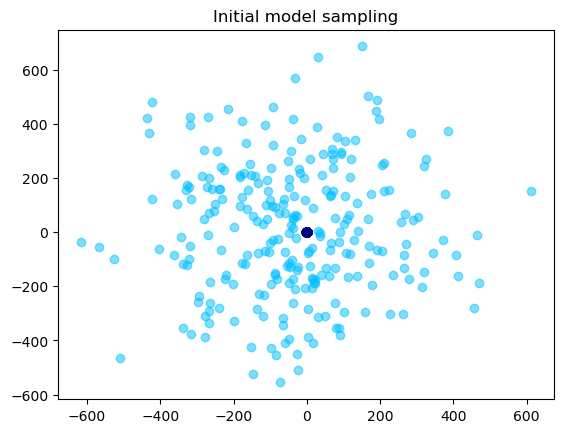

[50/10000] 	Loss: 96.5839
[100/10000] 	Loss: 69.6313
[150/10000] 	Loss: 49.3065
[200/10000] 	Loss: 53.4147
[250/10000] 	Loss: 58.5137


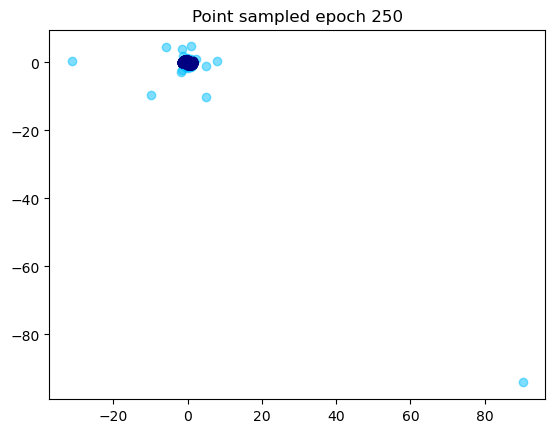

[300/10000] 	Loss: 65.1027
[350/10000] 	Loss: 76.7166
[400/10000] 	Loss: 56.3610
[450/10000] 	Loss: 66.5836
[500/10000] 	Loss: 58.5001


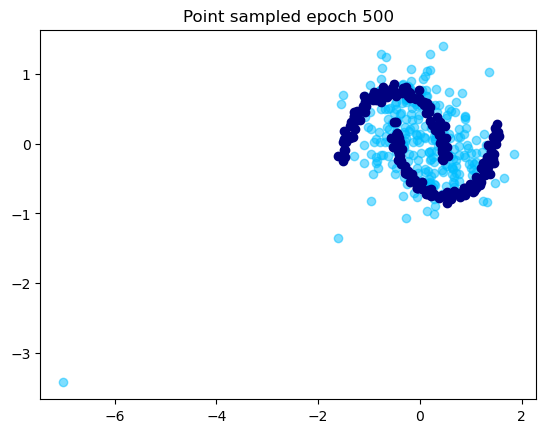

[550/10000] 	Loss: 57.6890
[600/10000] 	Loss: 62.0119
[650/10000] 	Loss: 65.5856
[700/10000] 	Loss: 55.9420
[750/10000] 	Loss: 67.0739


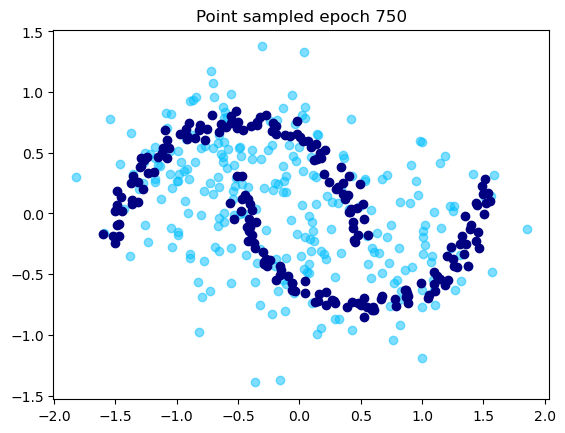

[800/10000] 	Loss: 64.0252
[850/10000] 	Loss: 63.9972
[900/10000] 	Loss: 74.9724
[950/10000] 	Loss: 56.7466
[1000/10000] 	Loss: 50.0981


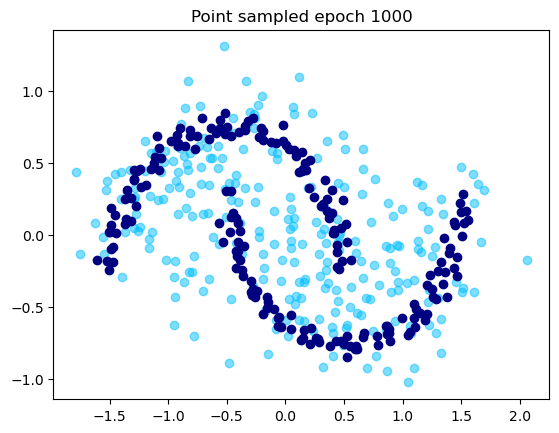

[1050/10000] 	Loss: 67.3353
[1100/10000] 	Loss: 61.3601
[1150/10000] 	Loss: 43.2859
[1200/10000] 	Loss: 55.5029
[1250/10000] 	Loss: 40.9283


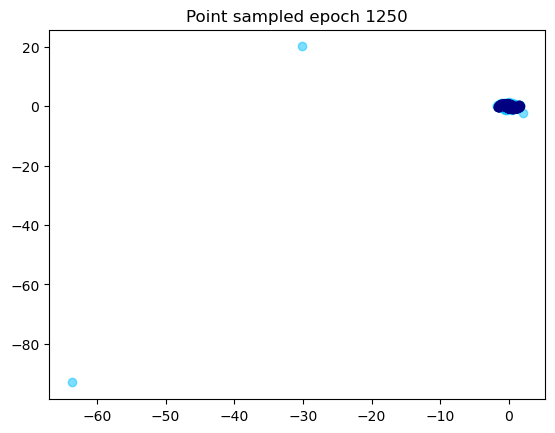

[1300/10000] 	Loss: 38.9928
[1350/10000] 	Loss: 49.0703
[1400/10000] 	Loss: 58.1495
[1450/10000] 	Loss: 51.0170
[1500/10000] 	Loss: 53.1871


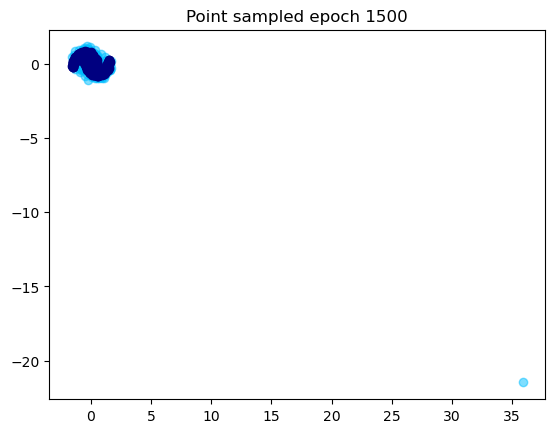

[1550/10000] 	Loss: 61.2659
[1600/10000] 	Loss: 44.7558
[1650/10000] 	Loss: 57.2731
[1700/10000] 	Loss: 66.6516
[1750/10000] 	Loss: 30.7385


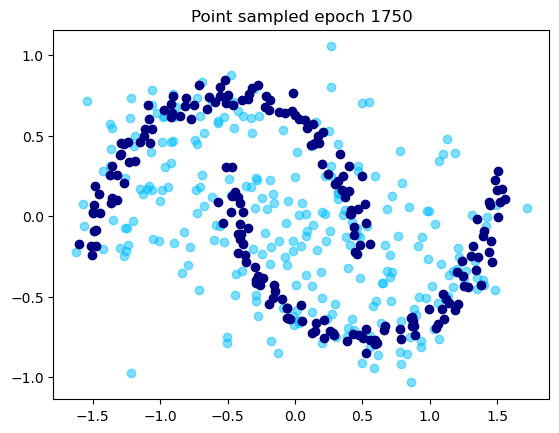

[1800/10000] 	Loss: 60.2258
[1850/10000] 	Loss: 64.9750
[1900/10000] 	Loss: 61.5545
[1950/10000] 	Loss: 46.9255
[2000/10000] 	Loss: 43.0242


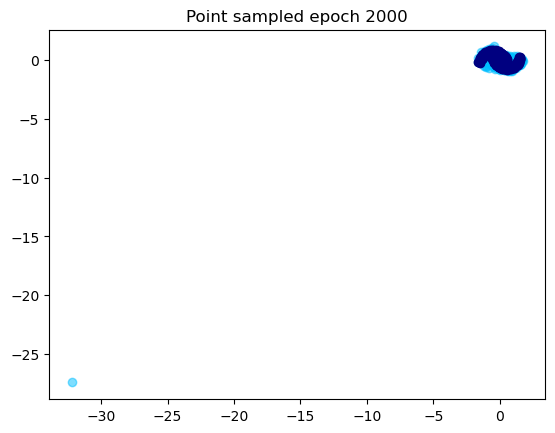

[2050/10000] 	Loss: 55.4062
[2100/10000] 	Loss: 47.7287
[2150/10000] 	Loss: 46.6618
[2200/10000] 	Loss: 58.3291
[2250/10000] 	Loss: 61.1339


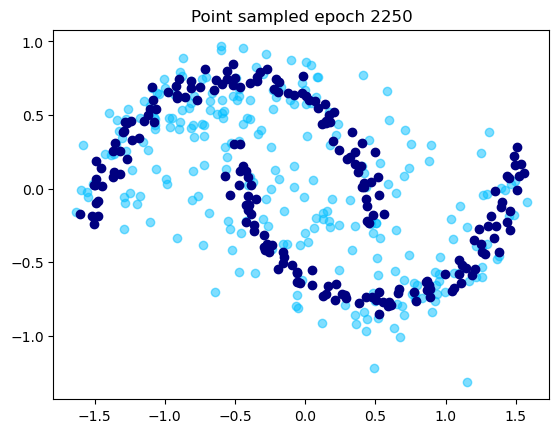

[2300/10000] 	Loss: 50.5405
[2350/10000] 	Loss: 41.8016
[2400/10000] 	Loss: 43.3131
[2450/10000] 	Loss: 50.7841
[2500/10000] 	Loss: 39.2515


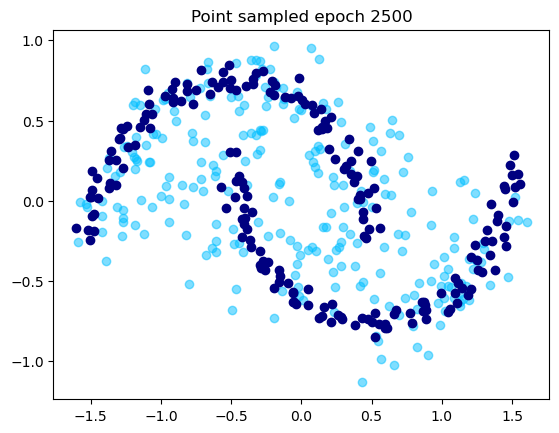

[2550/10000] 	Loss: 68.4791
[2600/10000] 	Loss: 40.4682
[2650/10000] 	Loss: 47.0168
[2700/10000] 	Loss: 40.7564
[2750/10000] 	Loss: 47.9732


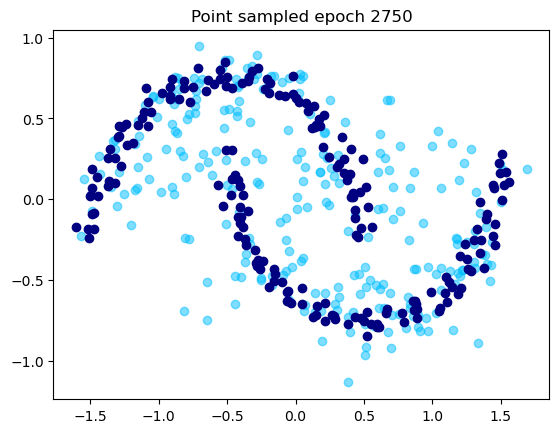

[2800/10000] 	Loss: 62.2796
[2850/10000] 	Loss: 54.9304
[2900/10000] 	Loss: 45.2618
[2950/10000] 	Loss: 38.3112
[3000/10000] 	Loss: 48.2043


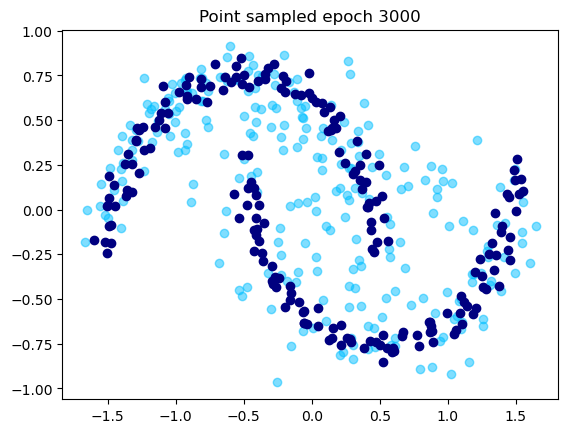

[3050/10000] 	Loss: 54.0848
[3100/10000] 	Loss: 61.4847
[3150/10000] 	Loss: 46.6182
[3200/10000] 	Loss: 48.3883
[3250/10000] 	Loss: 39.2162


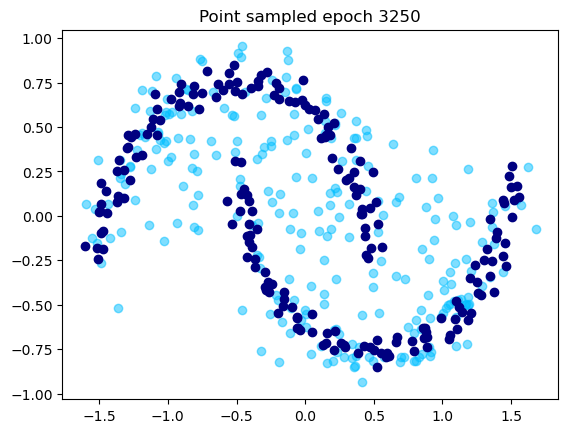

[3300/10000] 	Loss: 52.9209
[3350/10000] 	Loss: 51.0373
[3400/10000] 	Loss: 27.4674
[3450/10000] 	Loss: 48.4834
[3500/10000] 	Loss: 50.0241


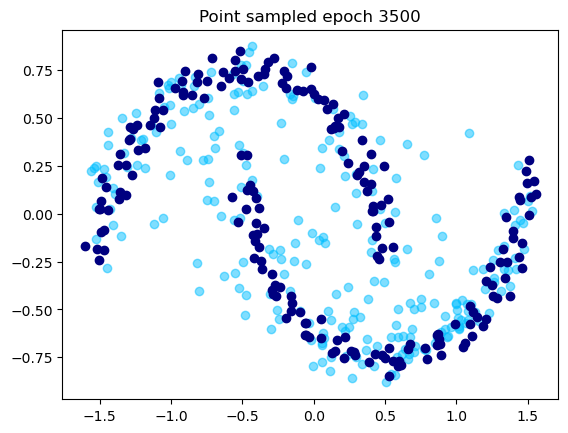

[3550/10000] 	Loss: 45.2960
[3600/10000] 	Loss: 27.6896
[3650/10000] 	Loss: 39.8461
[3700/10000] 	Loss: 43.3423
[3750/10000] 	Loss: 55.9579


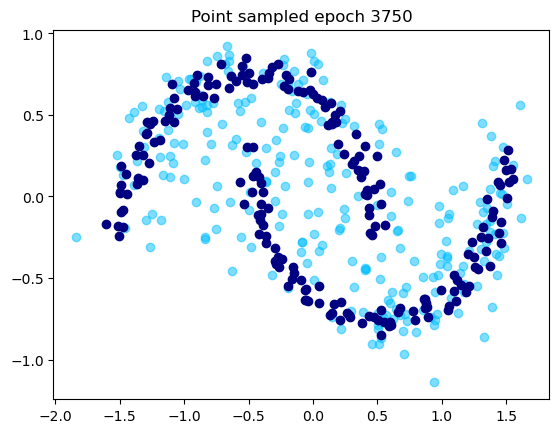

[3800/10000] 	Loss: 75.4852
[3850/10000] 	Loss: 49.2178
[3900/10000] 	Loss: 31.1500
[3950/10000] 	Loss: 36.2517
[4000/10000] 	Loss: 44.6078


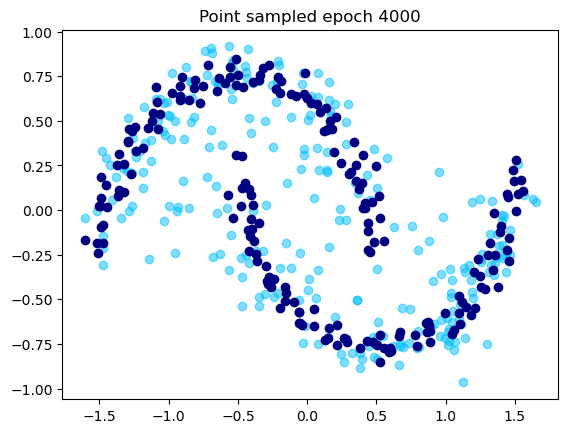

[4050/10000] 	Loss: 56.2999
[4100/10000] 	Loss: 48.1531
[4150/10000] 	Loss: 66.9569
[4200/10000] 	Loss: 48.0670
[4250/10000] 	Loss: 53.9029


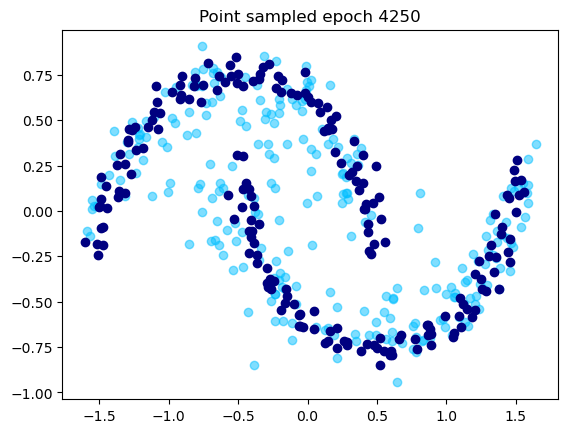

[4300/10000] 	Loss: 48.7196
[4350/10000] 	Loss: 52.4920
[4400/10000] 	Loss: 43.8688
[4450/10000] 	Loss: 48.7269
[4500/10000] 	Loss: 38.7485


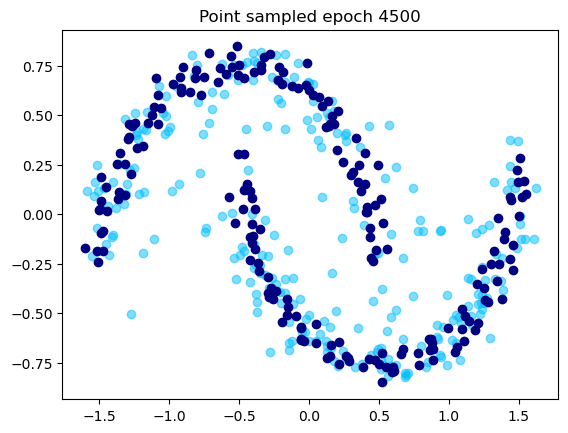

[4550/10000] 	Loss: 51.2257
[4600/10000] 	Loss: 49.5192
[4650/10000] 	Loss: 52.3901
[4700/10000] 	Loss: 55.8692
[4750/10000] 	Loss: 60.5423


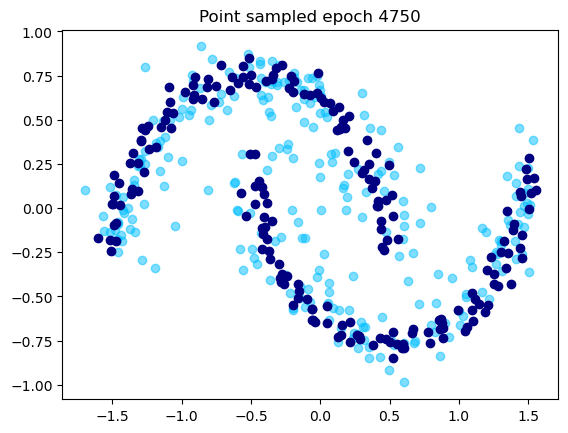

[4800/10000] 	Loss: 54.0513
[4850/10000] 	Loss: 54.0084
[4900/10000] 	Loss: 52.3286
[4950/10000] 	Loss: 60.4137
[5000/10000] 	Loss: 40.4564


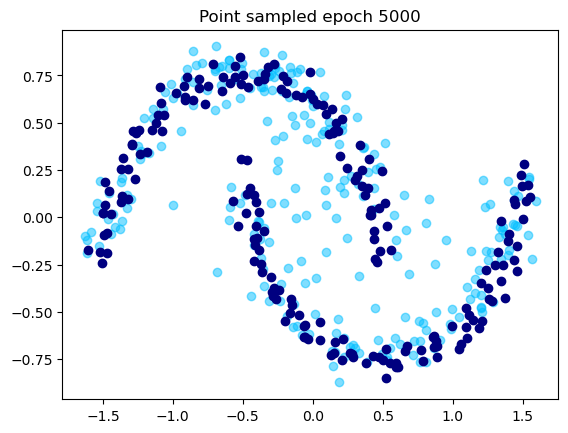

[5050/10000] 	Loss: 59.6045
[5100/10000] 	Loss: 75.1629
[5150/10000] 	Loss: 49.4894
[5200/10000] 	Loss: 41.9421
[5250/10000] 	Loss: 61.3612


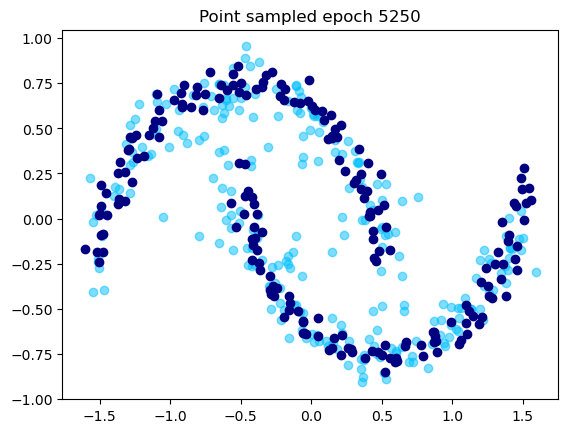

[5300/10000] 	Loss: 49.2363
[5350/10000] 	Loss: 44.1246
[5400/10000] 	Loss: 67.0714
[5450/10000] 	Loss: 39.3053
[5500/10000] 	Loss: 64.6130


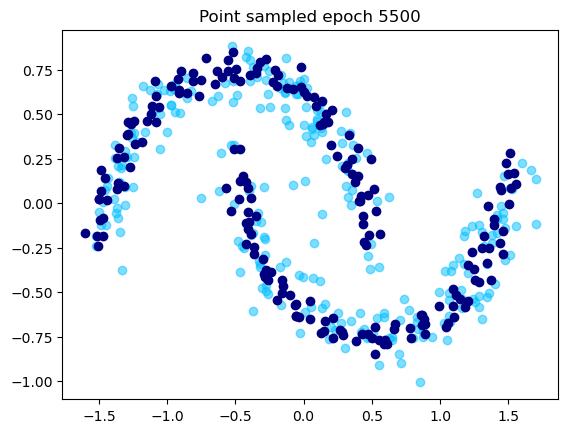

[5550/10000] 	Loss: 48.4444
[5600/10000] 	Loss: 41.3318
[5650/10000] 	Loss: 55.1704
[5700/10000] 	Loss: 38.0639
[5750/10000] 	Loss: 50.9598


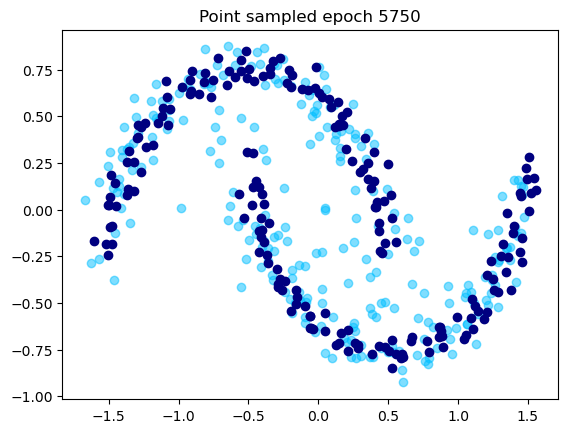

[5800/10000] 	Loss: 79.1234
[5850/10000] 	Loss: 38.0976
[5900/10000] 	Loss: 34.2228
[5950/10000] 	Loss: 41.5212
[6000/10000] 	Loss: 40.6956


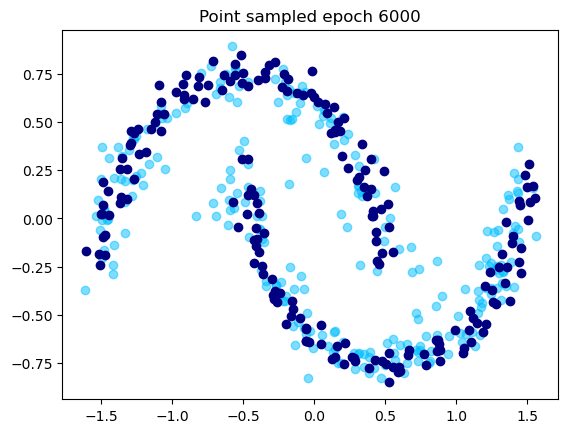

[6050/10000] 	Loss: 43.9509
[6100/10000] 	Loss: 55.6994
[6150/10000] 	Loss: 54.7085
[6200/10000] 	Loss: 41.1578
[6250/10000] 	Loss: 37.6044


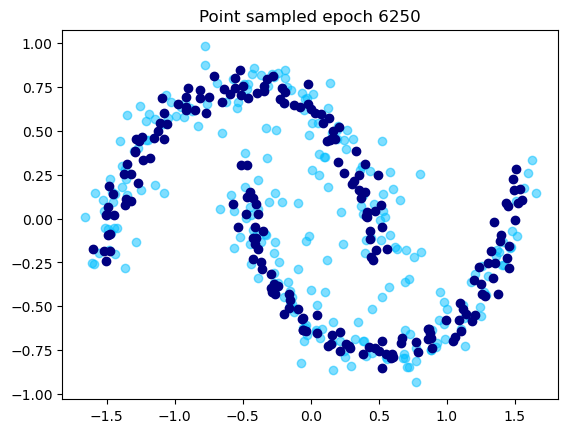

[6300/10000] 	Loss: 47.1705
[6350/10000] 	Loss: 47.6054
[6400/10000] 	Loss: 66.9531
[6450/10000] 	Loss: 61.8325
[6500/10000] 	Loss: 31.6124


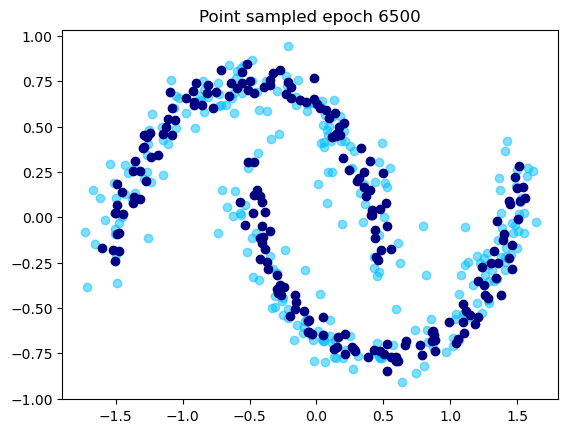

[6550/10000] 	Loss: 54.7261
[6600/10000] 	Loss: 53.6116
[6650/10000] 	Loss: 49.1760
[6700/10000] 	Loss: 34.4367
[6750/10000] 	Loss: 73.4912


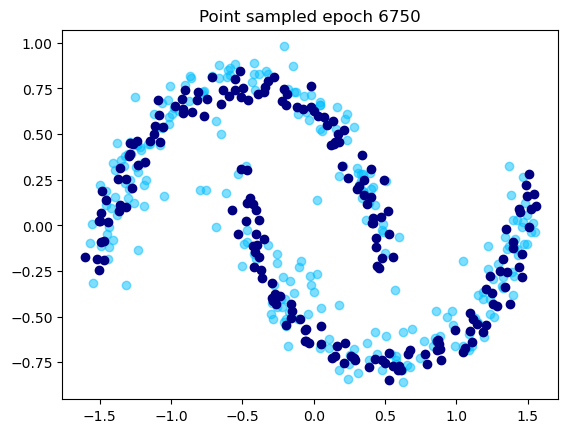

[6800/10000] 	Loss: 45.8887
[6850/10000] 	Loss: 41.8659
[6900/10000] 	Loss: 45.6575
[6950/10000] 	Loss: 38.0316
[7000/10000] 	Loss: 46.1640


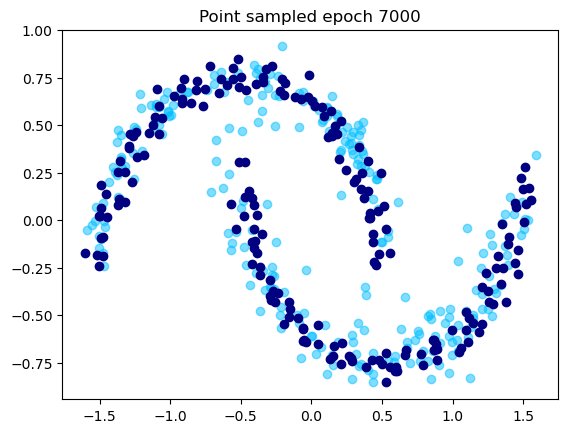

[7050/10000] 	Loss: 60.4853
[7100/10000] 	Loss: 34.1873
[7150/10000] 	Loss: 40.4828
[7200/10000] 	Loss: 61.6081
[7250/10000] 	Loss: 57.0431


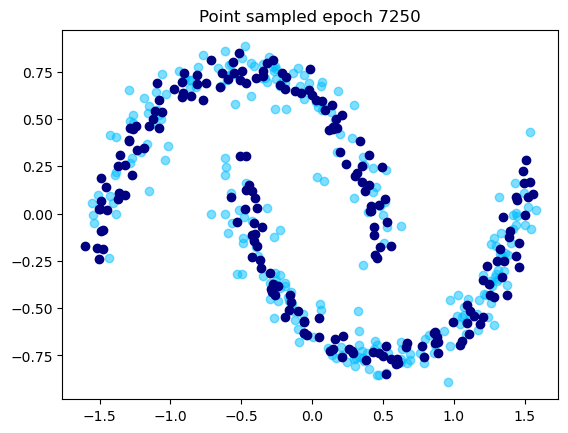

[7300/10000] 	Loss: 55.8724
[7350/10000] 	Loss: 47.8670
[7400/10000] 	Loss: 43.1386
[7450/10000] 	Loss: 48.0448
[7500/10000] 	Loss: 37.5023


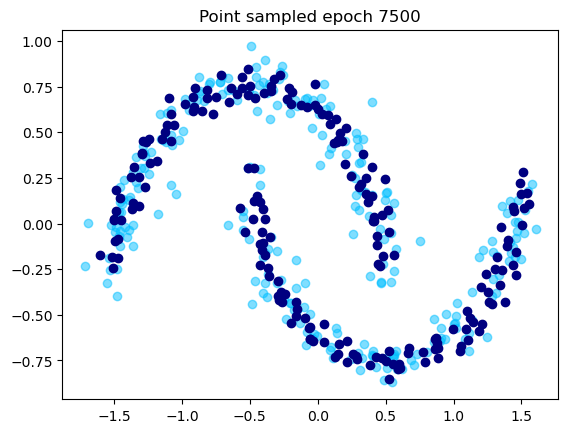

[7550/10000] 	Loss: 44.8494
[7600/10000] 	Loss: 32.5080
[7650/10000] 	Loss: 47.9594
[7700/10000] 	Loss: 53.1376
[7750/10000] 	Loss: 70.8137


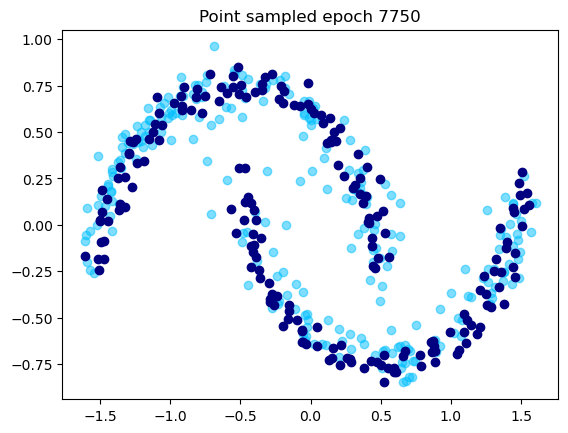

[7800/10000] 	Loss: 47.7717
[7850/10000] 	Loss: 38.3457
[7900/10000] 	Loss: 54.4237
[7950/10000] 	Loss: 40.4576
[8000/10000] 	Loss: 61.6386


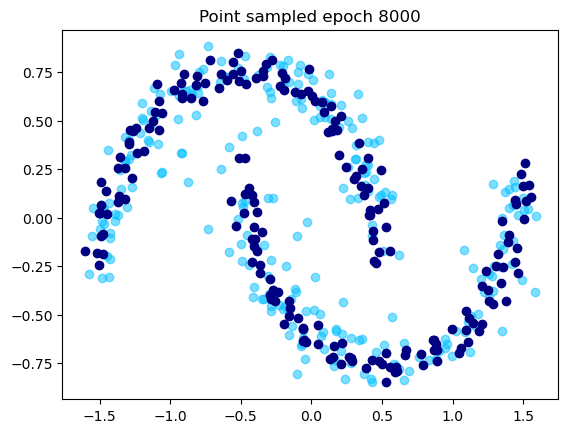

[8050/10000] 	Loss: 36.6048
[8100/10000] 	Loss: 48.8105
[8150/10000] 	Loss: 39.2862
[8200/10000] 	Loss: 38.5130
[8250/10000] 	Loss: 41.2527


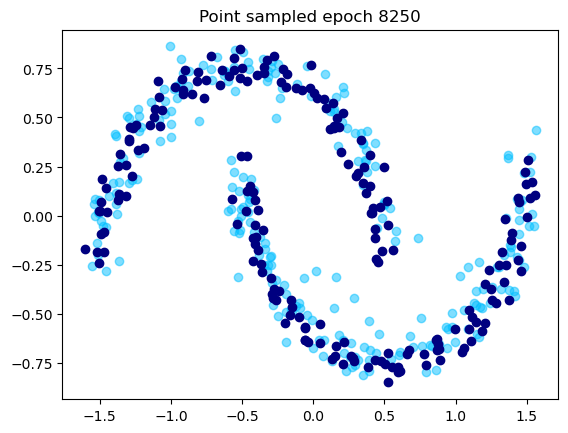

[8300/10000] 	Loss: 43.0249
[8350/10000] 	Loss: 42.0580
[8400/10000] 	Loss: 36.2429
[8450/10000] 	Loss: 26.6262
[8500/10000] 	Loss: 67.5351


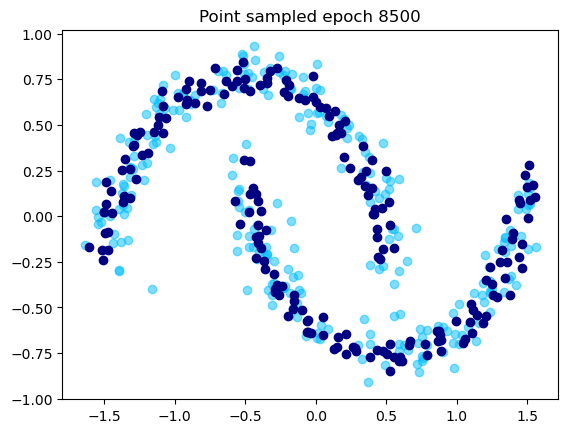

[8550/10000] 	Loss: 45.1007
[8600/10000] 	Loss: 55.9613
[8650/10000] 	Loss: 47.1723
[8700/10000] 	Loss: 59.9032
[8750/10000] 	Loss: 46.6410


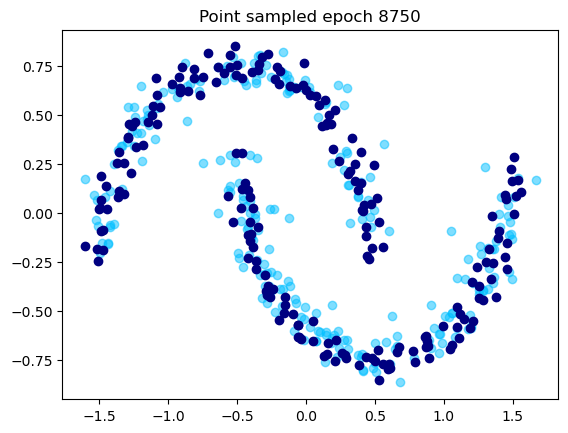

[8800/10000] 	Loss: 50.1317
[8850/10000] 	Loss: 54.4762
[8900/10000] 	Loss: 28.2261
[8950/10000] 	Loss: 39.1403
[9000/10000] 	Loss: 56.5954


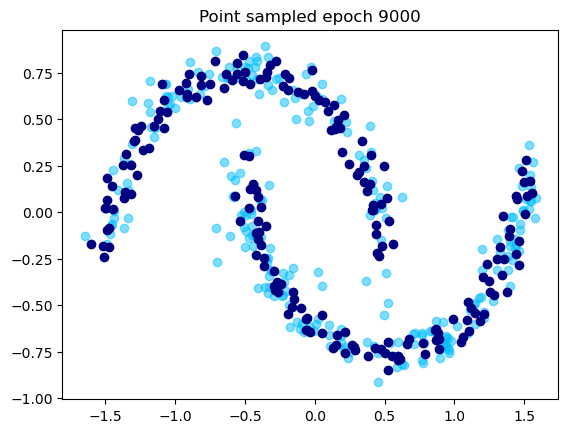

[9050/10000] 	Loss: 37.9703
[9100/10000] 	Loss: 47.2140
[9150/10000] 	Loss: 30.1444
[9200/10000] 	Loss: 40.3955
[9250/10000] 	Loss: 30.6749


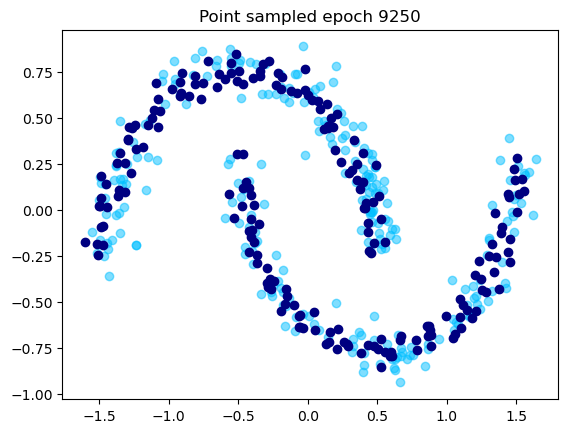

[9300/10000] 	Loss: 35.7511
[9350/10000] 	Loss: 51.9323
[9400/10000] 	Loss: 52.6411
[9450/10000] 	Loss: 46.1198
[9500/10000] 	Loss: 32.5945


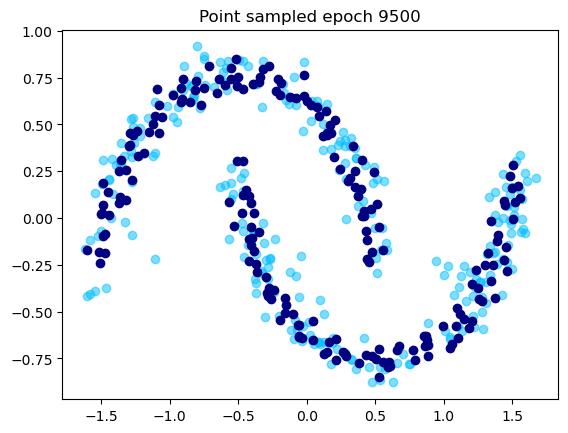

[9550/10000] 	Loss: 46.3787
[9600/10000] 	Loss: 54.8311
[9650/10000] 	Loss: 38.7402
[9700/10000] 	Loss: 37.1548
[9750/10000] 	Loss: 37.0189


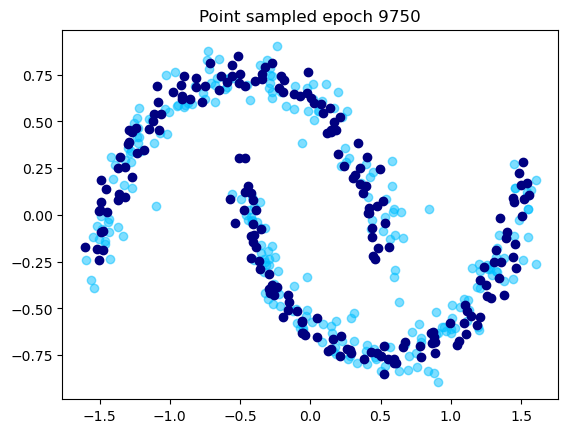

[9800/10000] 	Loss: 45.9120
[9850/10000] 	Loss: 38.7792
[9900/10000] 	Loss: 47.0502
[9950/10000] 	Loss: 34.6275
[10000/10000] 	Loss: 36.1814


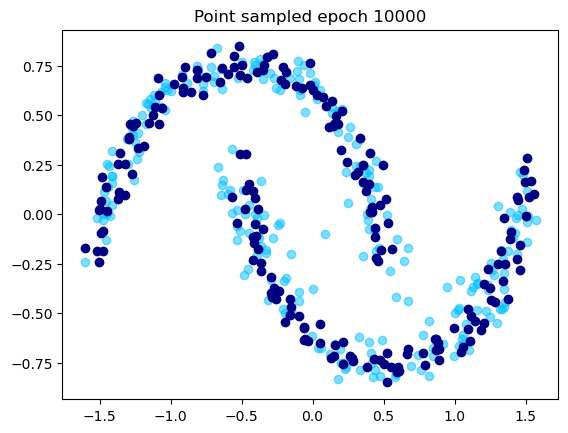

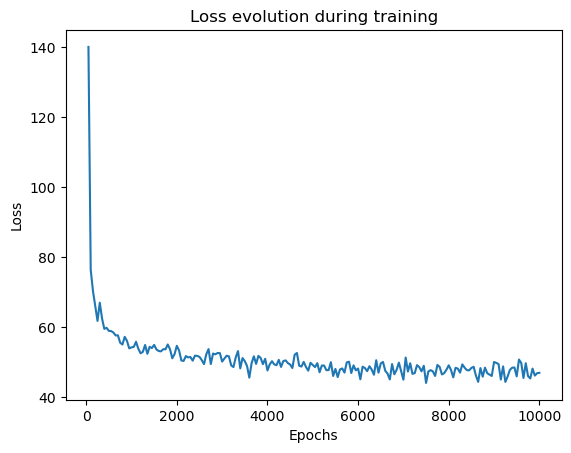

In [22]:
train_diffusion(nepochs, lr, ema_decay,
                n_samples_per_batch, nb_degradation_per_datapoint,
                d_model, n_blocks, num_diffusion_timesteps,
                epoch_log, epoch_display, nb_samples_display,
                fig_savepath, model_savepath)

# Consistency training

In [14]:
class ConsistencyDiscreteTimeModel(nn.Module):
    def __init__(self, d_model: int = 128, n_blocks: int = 2, n_time_steps: int = 20, total_time = 1000):
        super().__init__()
        # Time evolution parameters
        self.eps = 2e-3
        self.sigma_data = 1.
        self.dim_output = 2

        # Degradation parameters
        self.num_diffusion_timesteps = n_time_steps # N
        self.total_time = total_time # T

        beta_start = 0.0001
        beta_end = 0.02
        self.betas = torch.linspace(beta_start, beta_end, total_time, dtype=torch.float32)
        self.alphas = 1.0 - self.betas
        self.alphas_cumprod = torch.cumprod(self.alphas, axis=0)
        self.alphas_cumprod_prev = torch.cat((torch.tensor([1.0]), self.alphas_cumprod[:-1]), dim=0)

        # Model parameters
        self.d_model = d_model
        self.n_blocks = n_blocks

        self.lin_in = nn.Linear(2, d_model)
        # NB: We create T=1000 embedding vectors, but will use in practice only N (all the i*(T//N) for i in [0, N-1] ones).
        # The other T-N embeddings will be existing but not trained. Make sure in the forward to use the time in the referential
        # of the diffusion model (time) and not in the referential of the consistency model (timestep index) -> use self.map_tidx_to_teq
        # to previously transfer time from one referential to another. If t is taken in [0, N] (consistency referential), this method
        # will convert it to [0, T] (diffusion referential). This is especially important for the distillation case.
        self.encoder_blocks = nn.ParameterList([EncoderDiscreteTimeResidualBlock(d_model=d_model, n_time_steps=total_time) for _ in range(n_blocks)])
        self.middle = BottleneckBlock(d_model, total_time)
        self.decoder_blocks = nn.ParameterList([DecoderDiscreteTimeResidualBlock(d_model=d_model, n_time_steps=total_time) for _ in range(n_blocks)])
        self.out = OutDecoder(d_model, total_time)
    
    def map_tidx_to_teq(self, t_idx):
        """
        Map the time in the referential of the consistency model into the referential of the diffusion model
        The goal is to use the same degradation parameters as the diffusion model (same T=1000) but with fewer
        timesteps (N). Thus the timesteps are bigger, and the final time is the same.
        """
        return t_idx * int(self.total_time/self.num_diffusion_timesteps)

    def forward(self, x, t_flatten):
        x_in = self.lin_in(x) # [N * n_repet, d_out]

        x_enc = []
        for block in self.encoder_blocks:
            x_in = block(x_in, t_flatten) # [N * n_repet, d_out]
            x_enc.append(x_in)

        x_in = self.middle(x_in, t_flatten) # [N * n_repet, d_out]

        x_enc.reverse()
        for i, block in enumerate(self.decoder_blocks):
            x_in = block(x_in, x_enc[i], t_flatten) # [N * n_repet, d_out]

        c_skip = (self.sigma_data**2)/(self.sigma_data**2+(t_flatten)**2) # [N * n_repet]
        c_out = (self.sigma_data * (t_flatten)) / torch.sqrt(self.sigma_data**2+(t_flatten+self.eps)**2) # [N * n_repet]
        return c_skip.view((-1, 1)) * x + c_out.view((-1, 1)) * self.out(x_in, t_flatten) # [N * n_repet, 2]
    
    def sample(self, nb_samples):
        with torch.no_grad():  # avoid backprop wrt model parameters
            x = torch.randn((nb_samples, self.dim_output), device=device)  # initialize x_t for t=T
            t_flatten_idx = (self.num_diffusion_timesteps-1)*torch.ones((x.shape[0],), dtype = torch.int32, device = x.device)
            t_flatten = self.map_tidx_to_teq(t_flatten_idx)
            return self.forward(x, t_flatten)

In [15]:
def train_consistency(nepochs=10000, lr=1e-3, ema_decay=0.3,
                    n_samples_per_batch=128, nb_degradation_per_datapoint=1,
                    d_model=128, n_blocks=5, num_diffusion_timesteps=1000, timespand=1000,
                    epoch_log=1, epoch_display=1, nb_samples_display=256,
                    fig_savepath = "", model_savepath=""):

    consistency_model = ConsistencyDiscreteTimeModel(d_model=d_model, n_blocks=n_blocks, n_time_steps=num_diffusion_timesteps, total_time=timespand).to(device)
    optimizer = optim.AdamW(consistency_model.parameters(), lr=lr)
    ema_consistency = EMA(consistency_model, decay = ema_decay)

    # Initial plot
    if not os.path.exists(fig_savepath):
        os.makedirs(fig_savepath)
    sample_and_plot(consistency_model, nb_samples_display,
                    title = "Initial model sampling",
                    savepath = f"{fig_savepath}/epoch0")
    
    # Train
    all_losses = {"epochs": [], "loss": []}
    losses = []
    consistency_model.train()
    for epoch in range(1, 1+nepochs):
        optimizer.zero_grad()
        # Sample batch
        y = get_two_moons_centered(n_samples_per_batch)

        # Degrading image
        ## Degradation time t
        t_idx = torch.randint(0, consistency_model.num_diffusion_timesteps-1, (n_samples_per_batch, nb_degradation_per_datapoint))
        t_eq = consistency_model.map_tidx_to_teq(t_idx)
        x_t, eps = degrade_data_point(y, consistency_model.alphas_cumprod, t_eq) # degrade function is in the diffusion time referential
        ## Degradation time t+1
        t_idxplus1 = t_idx+1
        t_eqplus1 = consistency_model.map_tidx_to_teq(t_idxplus1)
        x_tplus1, eps = degrade_data_point(y, consistency_model.alphas_cumprod, t_eqplus1, eps) # degrade using exact same random noise

        # Student prediction
        data_pred = consistency_model(x_tplus1, t_flatten = t_eqplus1.view(-1))

        # Teacher prediction
        ema_consistency.apply_shadow()
        consistency_model.eval()
        with torch.no_grad():
            data_pred_ema = consistency_model(x_t, t_flatten = t_eq.view(-1))
        ema_consistency.restore()
        consistency_model.train()

        # Loss ; lamba(t)=1
        loss = F.mse_loss(data_pred, data_pred_ema, reduction="mean")

        # Optimization
        loss.backward()
        nn.utils.clip_grad_norm_(consistency_model.parameters(), 1.0)
        optimizer.step() # Student update
        ema_consistency.update() # Teacher update
        losses.append(loss.cpu().detach().item())

        # Intermediary log
        if((epoch)%epoch_log == 0):
            print('[%d/%d] \tLoss: %.4f' % (epoch, nepochs, loss.item()))
            all_losses["epochs"].append(epoch)
            all_losses["loss"].append(sum(losses)/len(losses))
            losses = []
        
        # Intermediary plot
        if((epoch)%epoch_display == 0):
            ## Apply ema weights
            ema_consistency.apply_shadow()
            consistency_model.eval()
            ## Plot
            sample_and_plot(consistency_model, nb_samples_display,
                            title = f"Point sampled epoch {epoch}",
                            savepath = f"{fig_savepath}/{epoch}")
            ## Restore training weights
            ema_consistency.restore()
            consistency_model.train()

    plot_loss(all_losses, savepath = f"{fig_savepath}/losses")
    save_checkpoint(consistency_model, ema_consistency, optimizer, model_savepath)

## T = 1000, N = 1000

In [118]:
nepochs=40000
lr=1e-3
ema_decay=0.3
                    
n_samples_per_batch=128
nb_degradation_per_datapoint=1

d_model=128
n_blocks=5

num_diffusion_timesteps=1000 # N
timespand=1000 # T

epoch_log=50
epoch_display=1000
nb_samples_display=512

fig_savepath="./figures/CT_two_moons_T1000_N1000_test"
model_savepath="./models/CT_two_moons_T1000_N1000_test_epoch40000.pt"

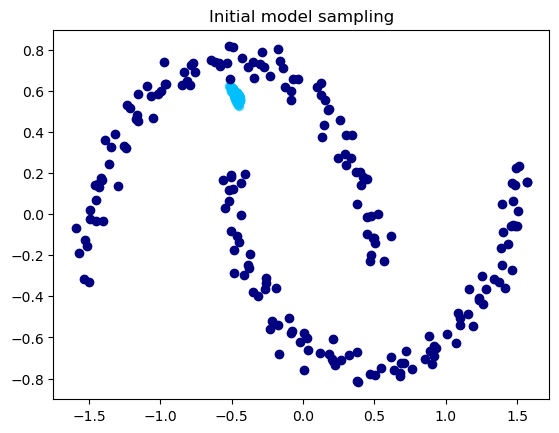

[50/40000] 	Loss: 0.0198
[100/40000] 	Loss: 0.0056
[150/40000] 	Loss: 0.0023
[200/40000] 	Loss: 0.0013
[250/40000] 	Loss: 0.0008
[300/40000] 	Loss: 0.0006
[350/40000] 	Loss: 0.0005
[400/40000] 	Loss: 0.0004
[450/40000] 	Loss: 0.0008
[500/40000] 	Loss: 0.0003
[550/40000] 	Loss: 0.0003
[600/40000] 	Loss: 0.0003
[650/40000] 	Loss: 0.0002
[700/40000] 	Loss: 0.0002
[750/40000] 	Loss: 0.0006
[800/40000] 	Loss: 0.0002
[850/40000] 	Loss: 0.0002
[900/40000] 	Loss: 0.0003
[950/40000] 	Loss: 0.0002
[1000/40000] 	Loss: 0.0001


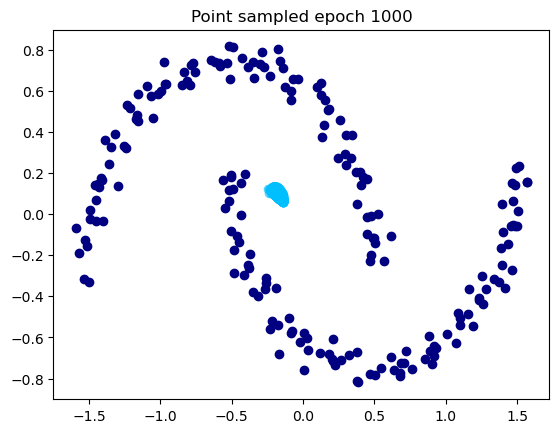

[1050/40000] 	Loss: 0.0001
[1100/40000] 	Loss: 0.0002
[1150/40000] 	Loss: 0.0002
[1200/40000] 	Loss: 0.0010
[1250/40000] 	Loss: 0.0009
[1300/40000] 	Loss: 0.0003
[1350/40000] 	Loss: 0.0003
[1400/40000] 	Loss: 0.0002
[1450/40000] 	Loss: 0.0003
[1500/40000] 	Loss: 0.0002
[1550/40000] 	Loss: 0.0021
[1600/40000] 	Loss: 0.0009
[1650/40000] 	Loss: 0.0004
[1700/40000] 	Loss: 0.0008
[1750/40000] 	Loss: 0.0003
[1800/40000] 	Loss: 0.0003
[1850/40000] 	Loss: 0.0003
[1900/40000] 	Loss: 0.0003
[1950/40000] 	Loss: 0.0005
[2000/40000] 	Loss: 0.0003


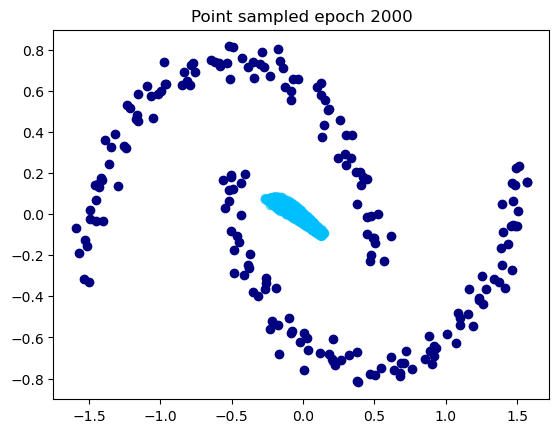

[2050/40000] 	Loss: 0.0006
[2100/40000] 	Loss: 0.0004
[2150/40000] 	Loss: 0.0006
[2200/40000] 	Loss: 0.0004
[2250/40000] 	Loss: 0.0004
[2300/40000] 	Loss: 0.0004
[2350/40000] 	Loss: 0.0002
[2400/40000] 	Loss: 0.0005
[2450/40000] 	Loss: 0.0008
[2500/40000] 	Loss: 0.0007
[2550/40000] 	Loss: 0.0012
[2600/40000] 	Loss: 0.0003
[2650/40000] 	Loss: 0.0012
[2700/40000] 	Loss: 0.0001
[2750/40000] 	Loss: 0.0001
[2800/40000] 	Loss: 0.0001
[2850/40000] 	Loss: 0.0001
[2900/40000] 	Loss: 0.0001
[2950/40000] 	Loss: 0.0002
[3000/40000] 	Loss: 0.0002


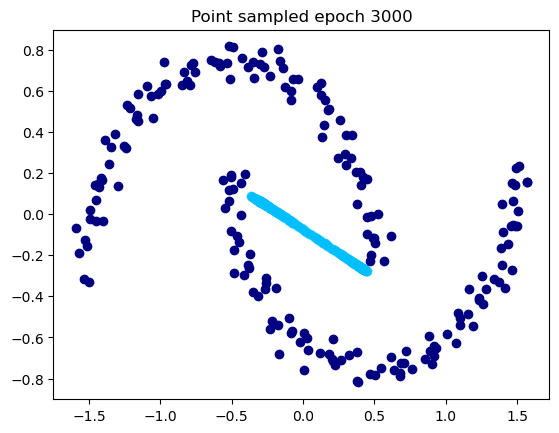

[3050/40000] 	Loss: 0.0004
[3100/40000] 	Loss: 0.0010
[3150/40000] 	Loss: 0.0002
[3200/40000] 	Loss: 0.0001
[3250/40000] 	Loss: 0.0001
[3300/40000] 	Loss: 0.0002
[3350/40000] 	Loss: 0.0003
[3400/40000] 	Loss: 0.0002
[3450/40000] 	Loss: 0.0002
[3500/40000] 	Loss: 0.0001
[3550/40000] 	Loss: 0.0001
[3600/40000] 	Loss: 0.0001
[3650/40000] 	Loss: 0.0011
[3700/40000] 	Loss: 0.0001
[3750/40000] 	Loss: 0.0009
[3800/40000] 	Loss: 0.0002
[3850/40000] 	Loss: 0.0003
[3900/40000] 	Loss: 0.0003
[3950/40000] 	Loss: 0.0002
[4000/40000] 	Loss: 0.0001


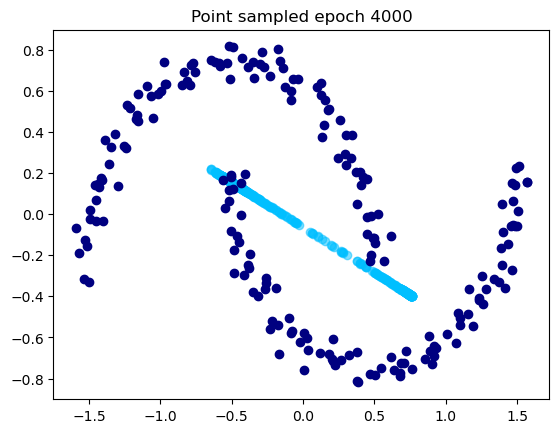

[4050/40000] 	Loss: 0.0001
[4100/40000] 	Loss: 0.0002
[4150/40000] 	Loss: 0.0001
[4200/40000] 	Loss: 0.0002
[4250/40000] 	Loss: 0.0002
[4300/40000] 	Loss: 0.0001
[4350/40000] 	Loss: 0.0001
[4400/40000] 	Loss: 0.0001
[4450/40000] 	Loss: 0.0001
[4500/40000] 	Loss: 0.0001
[4550/40000] 	Loss: 0.0001
[4600/40000] 	Loss: 0.0001
[4650/40000] 	Loss: 0.0001
[4700/40000] 	Loss: 0.0001
[4750/40000] 	Loss: 0.0001
[4800/40000] 	Loss: 0.0000
[4850/40000] 	Loss: 0.0001
[4900/40000] 	Loss: 0.0002
[4950/40000] 	Loss: 0.0001
[5000/40000] 	Loss: 0.0001


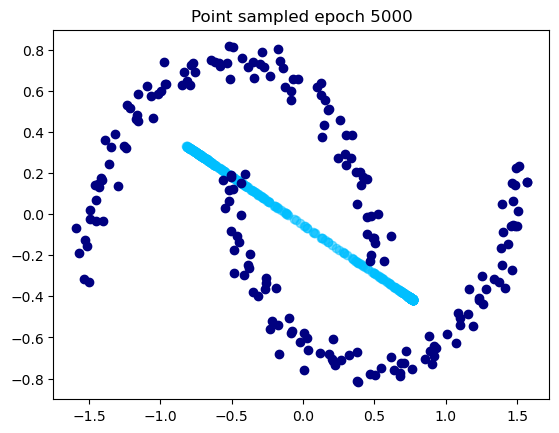

[5050/40000] 	Loss: 0.0001
[5100/40000] 	Loss: 0.0001
[5150/40000] 	Loss: 0.0010
[5200/40000] 	Loss: 0.0001
[5250/40000] 	Loss: 0.0001
[5300/40000] 	Loss: 0.0002
[5350/40000] 	Loss: 0.0001
[5400/40000] 	Loss: 0.0002
[5450/40000] 	Loss: 0.0001
[5500/40000] 	Loss: 0.0001
[5550/40000] 	Loss: 0.0001
[5600/40000] 	Loss: 0.0001
[5650/40000] 	Loss: 0.0001
[5700/40000] 	Loss: 0.0002
[5750/40000] 	Loss: 0.0001
[5800/40000] 	Loss: 0.0001
[5850/40000] 	Loss: 0.0001
[5900/40000] 	Loss: 0.0001
[5950/40000] 	Loss: 0.0000
[6000/40000] 	Loss: 0.0001


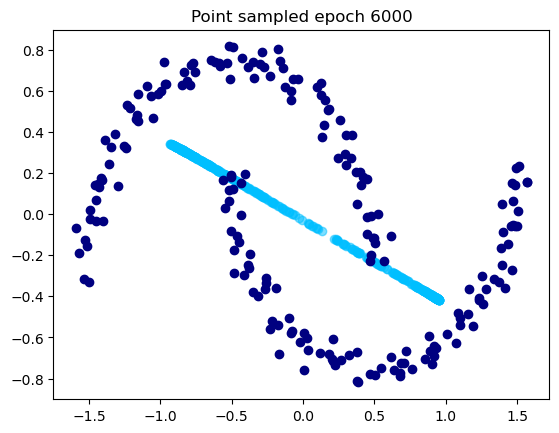

[6050/40000] 	Loss: 0.0005
[6100/40000] 	Loss: 0.0000
[6150/40000] 	Loss: 0.0000
[6200/40000] 	Loss: 0.0001
[6250/40000] 	Loss: 0.0001
[6300/40000] 	Loss: 0.0000
[6350/40000] 	Loss: 0.0001
[6400/40000] 	Loss: 0.0000
[6450/40000] 	Loss: 0.0000
[6500/40000] 	Loss: 0.0001
[6550/40000] 	Loss: 0.0001
[6600/40000] 	Loss: 0.0006
[6650/40000] 	Loss: 0.0001
[6700/40000] 	Loss: 0.0001
[6750/40000] 	Loss: 0.0000
[6800/40000] 	Loss: 0.0005
[6850/40000] 	Loss: 0.0001
[6900/40000] 	Loss: 0.0000
[6950/40000] 	Loss: 0.0002
[7000/40000] 	Loss: 0.0001


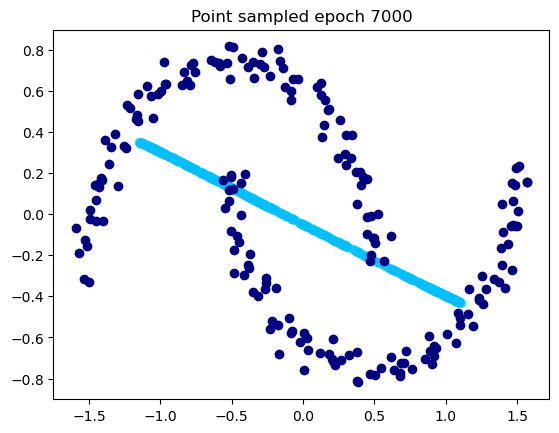

[7050/40000] 	Loss: 0.0001
[7100/40000] 	Loss: 0.0001
[7150/40000] 	Loss: 0.0001
[7200/40000] 	Loss: 0.0001
[7250/40000] 	Loss: 0.0000
[7300/40000] 	Loss: 0.0000
[7350/40000] 	Loss: 0.0000
[7400/40000] 	Loss: 0.0000
[7450/40000] 	Loss: 0.0000
[7500/40000] 	Loss: 0.0000
[7550/40000] 	Loss: 0.0001
[7600/40000] 	Loss: 0.0001
[7650/40000] 	Loss: 0.0000
[7700/40000] 	Loss: 0.0001
[7750/40000] 	Loss: 0.0000
[7800/40000] 	Loss: 0.0001
[7850/40000] 	Loss: 0.0000
[7900/40000] 	Loss: 0.0000
[7950/40000] 	Loss: 0.0000
[8000/40000] 	Loss: 0.0000


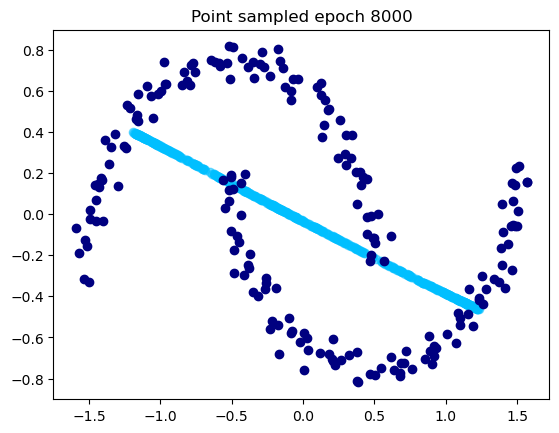

[8050/40000] 	Loss: 0.0000
[8100/40000] 	Loss: 0.0000
[8150/40000] 	Loss: 0.0000
[8200/40000] 	Loss: 0.0000
[8250/40000] 	Loss: 0.0001
[8300/40000] 	Loss: 0.0000
[8350/40000] 	Loss: 0.0000
[8400/40000] 	Loss: 0.0000
[8450/40000] 	Loss: 0.0000
[8500/40000] 	Loss: 0.0000
[8550/40000] 	Loss: 0.0000
[8600/40000] 	Loss: 0.0000
[8650/40000] 	Loss: 0.0001
[8700/40000] 	Loss: 0.0000
[8750/40000] 	Loss: 0.0000
[8800/40000] 	Loss: 0.0000
[8850/40000] 	Loss: 0.0000
[8900/40000] 	Loss: 0.0000
[8950/40000] 	Loss: 0.0000
[9000/40000] 	Loss: 0.0000


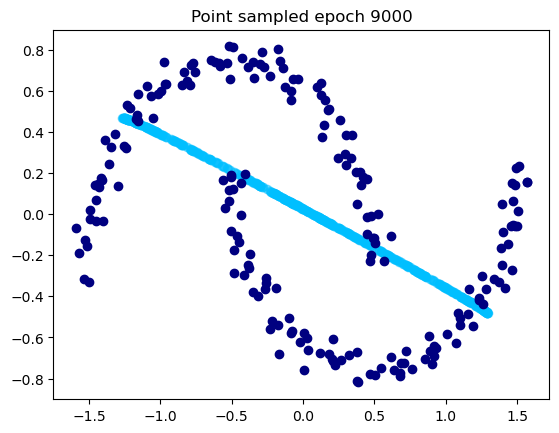

[9050/40000] 	Loss: 0.0000
[9100/40000] 	Loss: 0.0005
[9150/40000] 	Loss: 0.0000
[9200/40000] 	Loss: 0.0000
[9250/40000] 	Loss: 0.0000
[9300/40000] 	Loss: 0.0002
[9350/40000] 	Loss: 0.0001
[9400/40000] 	Loss: 0.0001
[9450/40000] 	Loss: 0.0001
[9500/40000] 	Loss: 0.0000
[9550/40000] 	Loss: 0.0000
[9600/40000] 	Loss: 0.0000
[9650/40000] 	Loss: 0.0001
[9700/40000] 	Loss: 0.0000
[9750/40000] 	Loss: 0.0000
[9800/40000] 	Loss: 0.0000
[9850/40000] 	Loss: 0.0000
[9900/40000] 	Loss: 0.0000
[9950/40000] 	Loss: 0.0000
[10000/40000] 	Loss: 0.0000


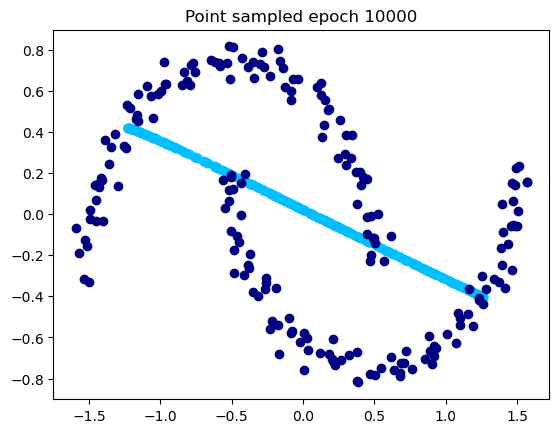

[10050/40000] 	Loss: 0.0000
[10100/40000] 	Loss: 0.0000
[10150/40000] 	Loss: 0.0000
[10200/40000] 	Loss: 0.0000
[10250/40000] 	Loss: 0.0000
[10300/40000] 	Loss: 0.0001
[10350/40000] 	Loss: 0.0000
[10400/40000] 	Loss: 0.0001
[10450/40000] 	Loss: 0.0000
[10500/40000] 	Loss: 0.0000
[10550/40000] 	Loss: 0.0001
[10600/40000] 	Loss: 0.0000
[10650/40000] 	Loss: 0.0000
[10700/40000] 	Loss: 0.0000
[10750/40000] 	Loss: 0.0000
[10800/40000] 	Loss: 0.0000
[10850/40000] 	Loss: 0.0000
[10900/40000] 	Loss: 0.0005
[10950/40000] 	Loss: 0.0001
[11000/40000] 	Loss: 0.0000


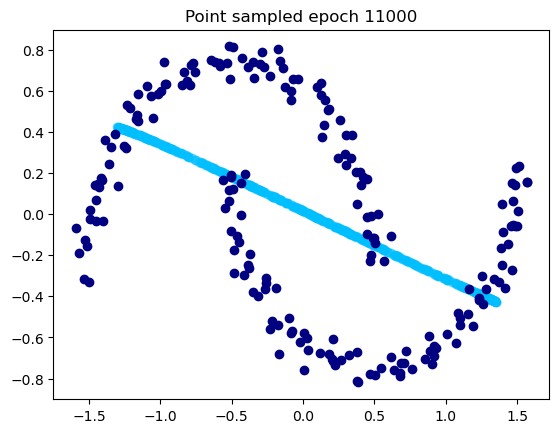

[11050/40000] 	Loss: 0.0000
[11100/40000] 	Loss: 0.0000
[11150/40000] 	Loss: 0.0000
[11200/40000] 	Loss: 0.0000
[11250/40000] 	Loss: 0.0000
[11300/40000] 	Loss: 0.0000
[11350/40000] 	Loss: 0.0000
[11400/40000] 	Loss: 0.0000
[11450/40000] 	Loss: 0.0000
[11500/40000] 	Loss: 0.0000
[11550/40000] 	Loss: 0.0000
[11600/40000] 	Loss: 0.0000
[11650/40000] 	Loss: 0.0000
[11700/40000] 	Loss: 0.0000
[11750/40000] 	Loss: 0.0001
[11800/40000] 	Loss: 0.0002
[11850/40000] 	Loss: 0.0000
[11900/40000] 	Loss: 0.0001
[11950/40000] 	Loss: 0.0000
[12000/40000] 	Loss: 0.0000


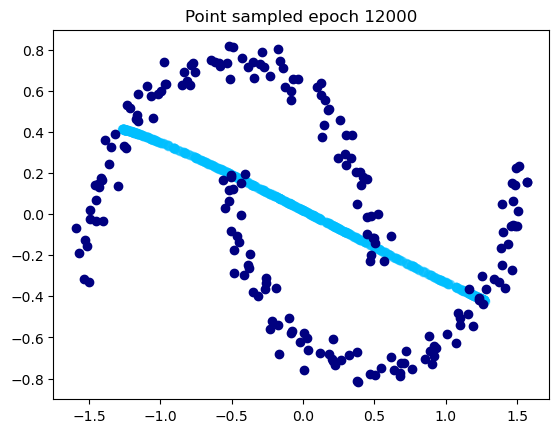

[12050/40000] 	Loss: 0.0000
[12100/40000] 	Loss: 0.0000
[12150/40000] 	Loss: 0.0001
[12200/40000] 	Loss: 0.0000
[12250/40000] 	Loss: 0.0000
[12300/40000] 	Loss: 0.0000
[12350/40000] 	Loss: 0.0000
[12400/40000] 	Loss: 0.0000
[12450/40000] 	Loss: 0.0004
[12500/40000] 	Loss: 0.0000
[12550/40000] 	Loss: 0.0000
[12600/40000] 	Loss: 0.0000
[12650/40000] 	Loss: 0.0001
[12700/40000] 	Loss: 0.0001
[12750/40000] 	Loss: 0.0000
[12800/40000] 	Loss: 0.0000
[12850/40000] 	Loss: 0.0000
[12900/40000] 	Loss: 0.0000
[12950/40000] 	Loss: 0.0001
[13000/40000] 	Loss: 0.0000


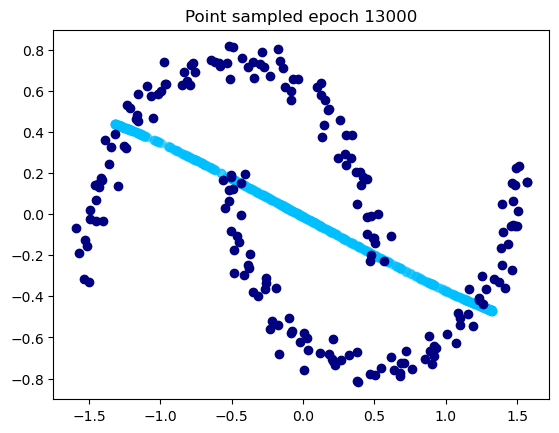

[13050/40000] 	Loss: 0.0000
[13100/40000] 	Loss: 0.0003
[13150/40000] 	Loss: 0.0000
[13200/40000] 	Loss: 0.0000
[13250/40000] 	Loss: 0.0000
[13300/40000] 	Loss: 0.0000
[13350/40000] 	Loss: 0.0000
[13400/40000] 	Loss: 0.0000
[13450/40000] 	Loss: 0.0001
[13500/40000] 	Loss: 0.0000
[13550/40000] 	Loss: 0.0000
[13600/40000] 	Loss: 0.0000
[13650/40000] 	Loss: 0.0000
[13700/40000] 	Loss: 0.0000
[13750/40000] 	Loss: 0.0000
[13800/40000] 	Loss: 0.0000
[13850/40000] 	Loss: 0.0000
[13900/40000] 	Loss: 0.0000
[13950/40000] 	Loss: 0.0000
[14000/40000] 	Loss: 0.0001


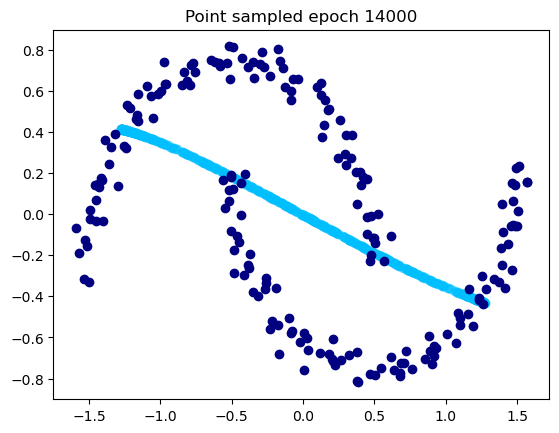

[14050/40000] 	Loss: 0.0000
[14100/40000] 	Loss: 0.0000
[14150/40000] 	Loss: 0.0000
[14200/40000] 	Loss: 0.0000
[14250/40000] 	Loss: 0.0000
[14300/40000] 	Loss: 0.0000
[14350/40000] 	Loss: 0.0000
[14400/40000] 	Loss: 0.0000
[14450/40000] 	Loss: 0.0000
[14500/40000] 	Loss: 0.0001
[14550/40000] 	Loss: 0.0002
[14600/40000] 	Loss: 0.0000
[14650/40000] 	Loss: 0.0000
[14700/40000] 	Loss: 0.0000
[14750/40000] 	Loss: 0.0000
[14800/40000] 	Loss: 0.0000
[14850/40000] 	Loss: 0.0000
[14900/40000] 	Loss: 0.0000
[14950/40000] 	Loss: 0.0001
[15000/40000] 	Loss: 0.0000


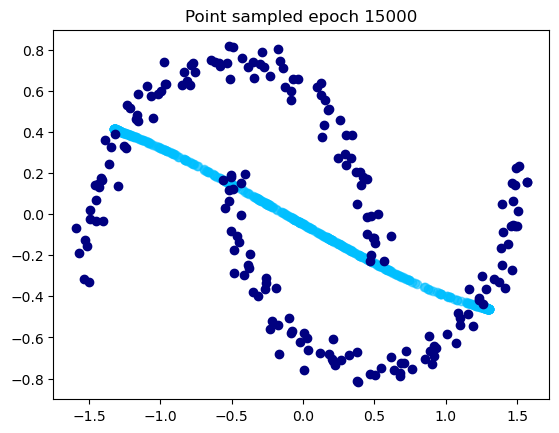

[15050/40000] 	Loss: 0.0000
[15100/40000] 	Loss: 0.0000
[15150/40000] 	Loss: 0.0000
[15200/40000] 	Loss: 0.0000
[15250/40000] 	Loss: 0.0000
[15300/40000] 	Loss: 0.0000
[15350/40000] 	Loss: 0.0000
[15400/40000] 	Loss: 0.0000
[15450/40000] 	Loss: 0.0000
[15500/40000] 	Loss: 0.0000
[15550/40000] 	Loss: 0.0000
[15600/40000] 	Loss: 0.0001
[15650/40000] 	Loss: 0.0000
[15700/40000] 	Loss: 0.0001
[15750/40000] 	Loss: 0.0000
[15800/40000] 	Loss: 0.0000
[15850/40000] 	Loss: 0.0000
[15900/40000] 	Loss: 0.0000
[15950/40000] 	Loss: 0.0000
[16000/40000] 	Loss: 0.0002


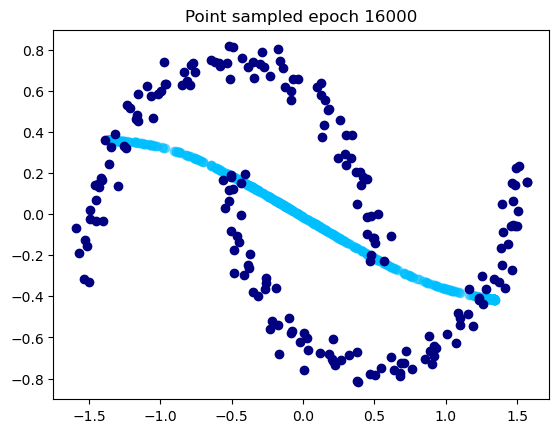

[16050/40000] 	Loss: 0.0000
[16100/40000] 	Loss: 0.0000
[16150/40000] 	Loss: 0.0000
[16200/40000] 	Loss: 0.0000
[16250/40000] 	Loss: 0.0000
[16300/40000] 	Loss: 0.0000
[16350/40000] 	Loss: 0.0000
[16400/40000] 	Loss: 0.0000
[16450/40000] 	Loss: 0.0000
[16500/40000] 	Loss: 0.0000
[16550/40000] 	Loss: 0.0000
[16600/40000] 	Loss: 0.0000
[16650/40000] 	Loss: 0.0000
[16700/40000] 	Loss: 0.0000
[16750/40000] 	Loss: 0.0000
[16800/40000] 	Loss: 0.0000
[16850/40000] 	Loss: 0.0000
[16900/40000] 	Loss: 0.0000
[16950/40000] 	Loss: 0.0000
[17000/40000] 	Loss: 0.0000


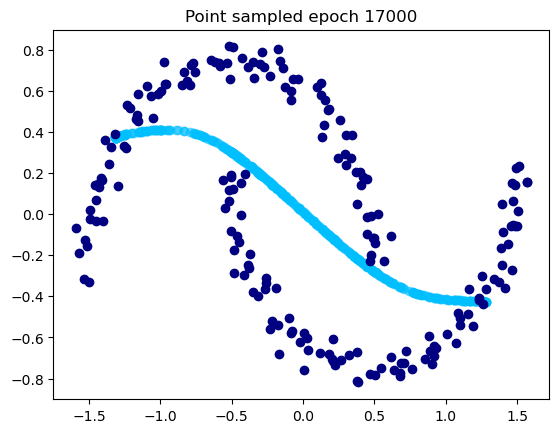

[17050/40000] 	Loss: 0.0000
[17100/40000] 	Loss: 0.0000
[17150/40000] 	Loss: 0.0000
[17200/40000] 	Loss: 0.0000
[17250/40000] 	Loss: 0.0000
[17300/40000] 	Loss: 0.0000
[17350/40000] 	Loss: 0.0000
[17400/40000] 	Loss: 0.0000
[17450/40000] 	Loss: 0.0001
[17500/40000] 	Loss: 0.0000
[17550/40000] 	Loss: 0.0000
[17600/40000] 	Loss: 0.0001
[17650/40000] 	Loss: 0.0000
[17700/40000] 	Loss: 0.0002
[17750/40000] 	Loss: 0.0000
[17800/40000] 	Loss: 0.0000
[17850/40000] 	Loss: 0.0000
[17900/40000] 	Loss: 0.0000
[17950/40000] 	Loss: 0.0000
[18000/40000] 	Loss: 0.0001


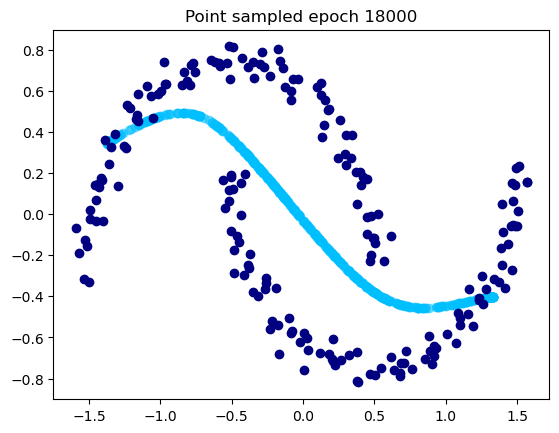

[18050/40000] 	Loss: 0.0000
[18100/40000] 	Loss: 0.0001
[18150/40000] 	Loss: 0.0001
[18200/40000] 	Loss: 0.0000
[18250/40000] 	Loss: 0.0000
[18300/40000] 	Loss: 0.0000
[18350/40000] 	Loss: 0.0000
[18400/40000] 	Loss: 0.0000
[18450/40000] 	Loss: 0.0000
[18500/40000] 	Loss: 0.0000
[18550/40000] 	Loss: 0.0000
[18600/40000] 	Loss: 0.0000
[18650/40000] 	Loss: 0.0000
[18700/40000] 	Loss: 0.0000
[18750/40000] 	Loss: 0.0000
[18800/40000] 	Loss: 0.0000
[18850/40000] 	Loss: 0.0000
[18900/40000] 	Loss: 0.0000
[18950/40000] 	Loss: 0.0000
[19000/40000] 	Loss: 0.0000


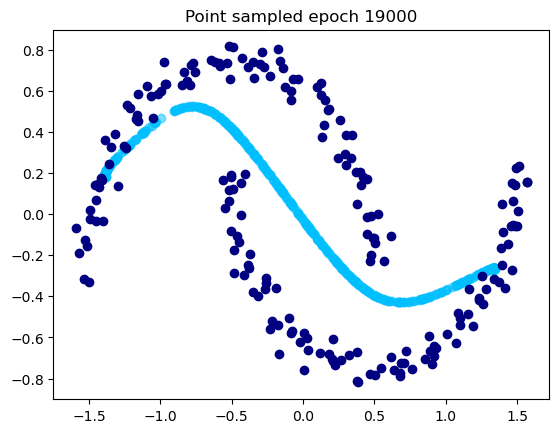

[19050/40000] 	Loss: 0.0001
[19100/40000] 	Loss: 0.0000
[19150/40000] 	Loss: 0.0000
[19200/40000] 	Loss: 0.0000
[19250/40000] 	Loss: 0.0002
[19300/40000] 	Loss: 0.0000
[19350/40000] 	Loss: 0.0000
[19400/40000] 	Loss: 0.0000
[19450/40000] 	Loss: 0.0000
[19500/40000] 	Loss: 0.0000
[19550/40000] 	Loss: 0.0002
[19600/40000] 	Loss: 0.0000
[19650/40000] 	Loss: 0.0001
[19700/40000] 	Loss: 0.0001
[19750/40000] 	Loss: 0.0000
[19800/40000] 	Loss: 0.0000
[19850/40000] 	Loss: 0.0000
[19900/40000] 	Loss: 0.0000
[19950/40000] 	Loss: 0.0000
[20000/40000] 	Loss: 0.0000


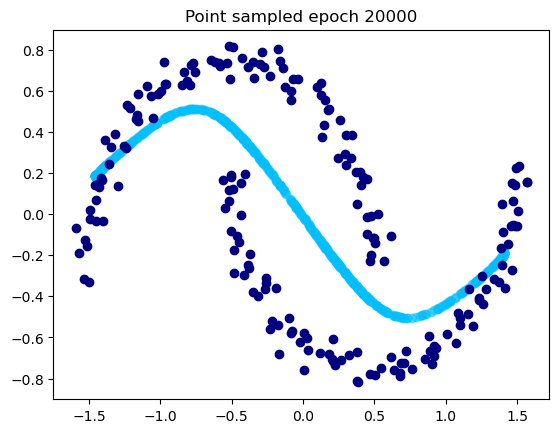

[20050/40000] 	Loss: 0.0000
[20100/40000] 	Loss: 0.0000
[20150/40000] 	Loss: 0.0000
[20200/40000] 	Loss: 0.0000
[20250/40000] 	Loss: 0.0000
[20300/40000] 	Loss: 0.0000
[20350/40000] 	Loss: 0.0000
[20400/40000] 	Loss: 0.0000
[20450/40000] 	Loss: 0.0000
[20500/40000] 	Loss: 0.0000
[20550/40000] 	Loss: 0.0000
[20600/40000] 	Loss: 0.0000
[20650/40000] 	Loss: 0.0000
[20700/40000] 	Loss: 0.0000
[20750/40000] 	Loss: 0.0002
[20800/40000] 	Loss: 0.0000
[20850/40000] 	Loss: 0.0000
[20900/40000] 	Loss: 0.0000
[20950/40000] 	Loss: 0.0000
[21000/40000] 	Loss: 0.0000


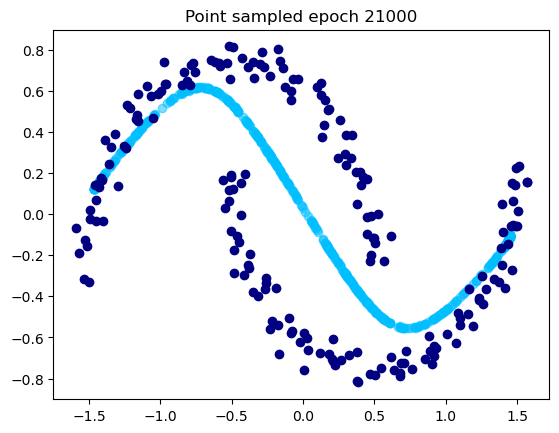

[21050/40000] 	Loss: 0.0000
[21100/40000] 	Loss: 0.0000
[21150/40000] 	Loss: 0.0000
[21200/40000] 	Loss: 0.0000
[21250/40000] 	Loss: 0.0000
[21300/40000] 	Loss: 0.0000
[21350/40000] 	Loss: 0.0000
[21400/40000] 	Loss: 0.0000
[21450/40000] 	Loss: 0.0000
[21500/40000] 	Loss: 0.0000
[21550/40000] 	Loss: 0.0000
[21600/40000] 	Loss: 0.0000
[21650/40000] 	Loss: 0.0000
[21700/40000] 	Loss: 0.0000
[21750/40000] 	Loss: 0.0001
[21800/40000] 	Loss: 0.0000
[21850/40000] 	Loss: 0.0000
[21900/40000] 	Loss: 0.0000
[21950/40000] 	Loss: 0.0000
[22000/40000] 	Loss: 0.0000


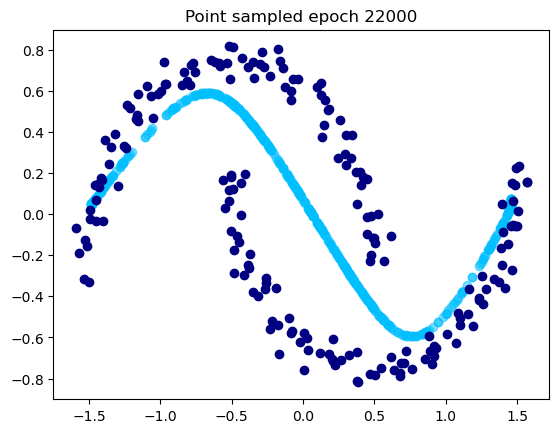

[22050/40000] 	Loss: 0.0000
[22100/40000] 	Loss: 0.0000
[22150/40000] 	Loss: 0.0000
[22200/40000] 	Loss: 0.0000
[22250/40000] 	Loss: 0.0001
[22300/40000] 	Loss: 0.0000
[22350/40000] 	Loss: 0.0000
[22400/40000] 	Loss: 0.0000
[22450/40000] 	Loss: 0.0000
[22500/40000] 	Loss: 0.0000
[22550/40000] 	Loss: 0.0001
[22600/40000] 	Loss: 0.0000
[22650/40000] 	Loss: 0.0000
[22700/40000] 	Loss: 0.0002
[22750/40000] 	Loss: 0.0000
[22800/40000] 	Loss: 0.0000
[22850/40000] 	Loss: 0.0000
[22900/40000] 	Loss: 0.0000
[22950/40000] 	Loss: 0.0000
[23000/40000] 	Loss: 0.0002


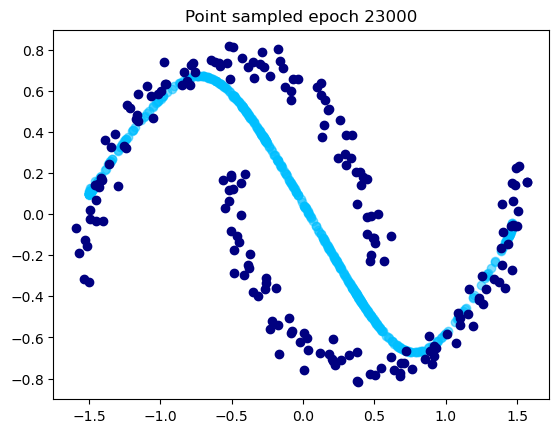

[23050/40000] 	Loss: 0.0000
[23100/40000] 	Loss: 0.0000
[23150/40000] 	Loss: 0.0000
[23200/40000] 	Loss: 0.0000
[23250/40000] 	Loss: 0.0000
[23300/40000] 	Loss: 0.0000
[23350/40000] 	Loss: 0.0000
[23400/40000] 	Loss: 0.0001
[23450/40000] 	Loss: 0.0000
[23500/40000] 	Loss: 0.0000
[23550/40000] 	Loss: 0.0000
[23600/40000] 	Loss: 0.0000
[23650/40000] 	Loss: 0.0000
[23700/40000] 	Loss: 0.0000
[23750/40000] 	Loss: 0.0000
[23800/40000] 	Loss: 0.0000
[23850/40000] 	Loss: 0.0000
[23900/40000] 	Loss: 0.0000
[23950/40000] 	Loss: 0.0000
[24000/40000] 	Loss: 0.0000


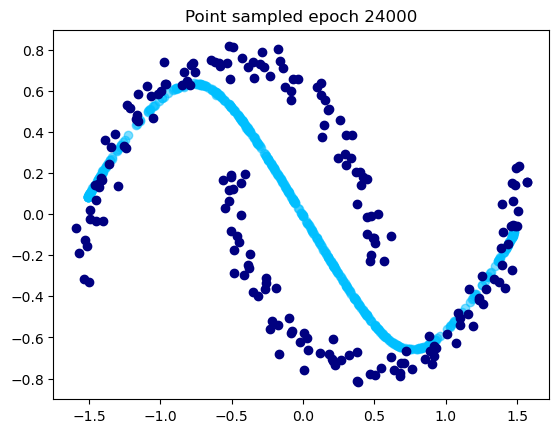

[24050/40000] 	Loss: 0.0000
[24100/40000] 	Loss: 0.0000
[24150/40000] 	Loss: 0.0000
[24200/40000] 	Loss: 0.0000
[24250/40000] 	Loss: 0.0000
[24300/40000] 	Loss: 0.0000
[24350/40000] 	Loss: 0.0000
[24400/40000] 	Loss: 0.0000
[24450/40000] 	Loss: 0.0000
[24500/40000] 	Loss: 0.0000
[24550/40000] 	Loss: 0.0000
[24600/40000] 	Loss: 0.0000
[24650/40000] 	Loss: 0.0000
[24700/40000] 	Loss: 0.0001
[24750/40000] 	Loss: 0.0000
[24800/40000] 	Loss: 0.0000
[24850/40000] 	Loss: 0.0002
[24900/40000] 	Loss: 0.0000
[24950/40000] 	Loss: 0.0000
[25000/40000] 	Loss: 0.0000


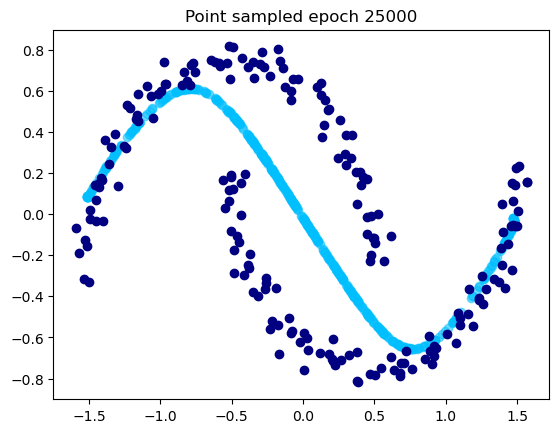

[25050/40000] 	Loss: 0.0000
[25100/40000] 	Loss: 0.0000
[25150/40000] 	Loss: 0.0000
[25200/40000] 	Loss: 0.0001
[25250/40000] 	Loss: 0.0000
[25300/40000] 	Loss: 0.0000
[25350/40000] 	Loss: 0.0001
[25400/40000] 	Loss: 0.0000
[25450/40000] 	Loss: 0.0000
[25500/40000] 	Loss: 0.0000
[25550/40000] 	Loss: 0.0000
[25600/40000] 	Loss: 0.0000
[25650/40000] 	Loss: 0.0003
[25700/40000] 	Loss: 0.0000
[25750/40000] 	Loss: 0.0000
[25800/40000] 	Loss: 0.0000
[25850/40000] 	Loss: 0.0000
[25900/40000] 	Loss: 0.0000
[25950/40000] 	Loss: 0.0000
[26000/40000] 	Loss: 0.0000


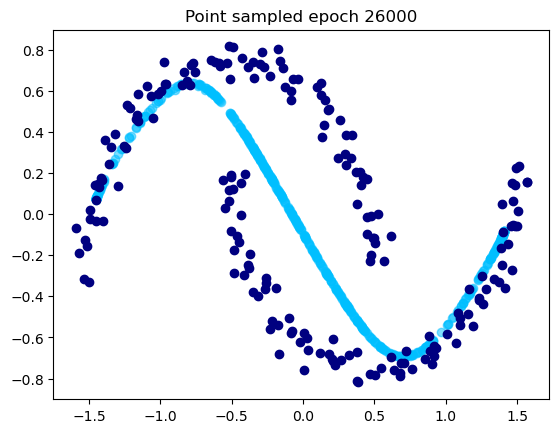

[26050/40000] 	Loss: 0.0000
[26100/40000] 	Loss: 0.0000
[26150/40000] 	Loss: 0.0000
[26200/40000] 	Loss: 0.0000
[26250/40000] 	Loss: 0.0000
[26300/40000] 	Loss: 0.0000
[26350/40000] 	Loss: 0.0000
[26400/40000] 	Loss: 0.0000
[26450/40000] 	Loss: 0.0000
[26500/40000] 	Loss: 0.0000
[26550/40000] 	Loss: 0.0000
[26600/40000] 	Loss: 0.0001
[26650/40000] 	Loss: 0.0000
[26700/40000] 	Loss: 0.0000
[26750/40000] 	Loss: 0.0000
[26800/40000] 	Loss: 0.0000
[26850/40000] 	Loss: 0.0001
[26900/40000] 	Loss: 0.0000
[26950/40000] 	Loss: 0.0000
[27000/40000] 	Loss: 0.0000


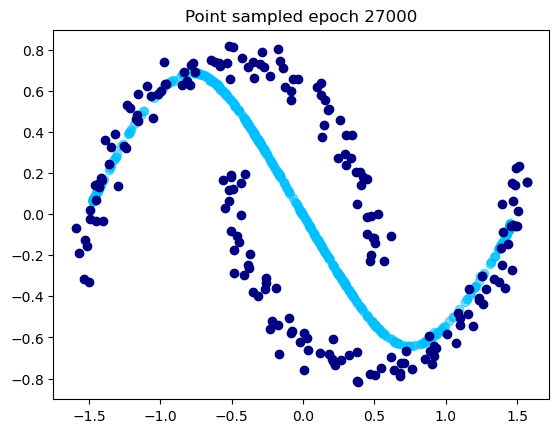

[27050/40000] 	Loss: 0.0000
[27100/40000] 	Loss: 0.0000
[27150/40000] 	Loss: 0.0001
[27200/40000] 	Loss: 0.0000
[27250/40000] 	Loss: 0.0000
[27300/40000] 	Loss: 0.0000
[27350/40000] 	Loss: 0.0000
[27400/40000] 	Loss: 0.0000
[27450/40000] 	Loss: 0.0000
[27500/40000] 	Loss: 0.0000
[27550/40000] 	Loss: 0.0000
[27600/40000] 	Loss: 0.0000
[27650/40000] 	Loss: 0.0000
[27700/40000] 	Loss: 0.0000
[27750/40000] 	Loss: 0.0000
[27800/40000] 	Loss: 0.0000
[27850/40000] 	Loss: 0.0000
[27900/40000] 	Loss: 0.0000
[27950/40000] 	Loss: 0.0000
[28000/40000] 	Loss: 0.0000


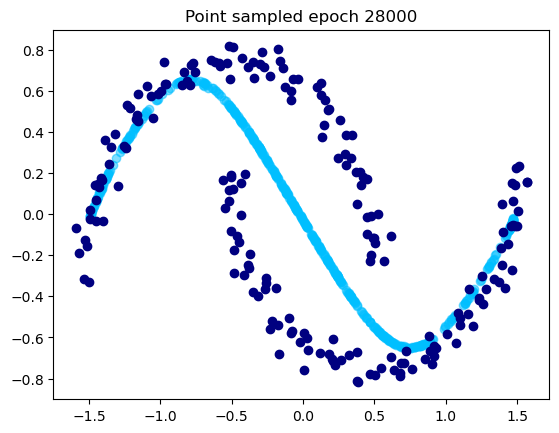

[28050/40000] 	Loss: 0.0000
[28100/40000] 	Loss: 0.0000
[28150/40000] 	Loss: 0.0000
[28200/40000] 	Loss: 0.0000
[28250/40000] 	Loss: 0.0000
[28300/40000] 	Loss: 0.0001
[28350/40000] 	Loss: 0.0000
[28400/40000] 	Loss: 0.0000
[28450/40000] 	Loss: 0.0000
[28500/40000] 	Loss: 0.0000
[28550/40000] 	Loss: 0.0000
[28600/40000] 	Loss: 0.0000
[28650/40000] 	Loss: 0.0000
[28700/40000] 	Loss: 0.0001
[28750/40000] 	Loss: 0.0000
[28800/40000] 	Loss: 0.0000
[28850/40000] 	Loss: 0.0000
[28900/40000] 	Loss: 0.0000
[28950/40000] 	Loss: 0.0000
[29000/40000] 	Loss: 0.0000


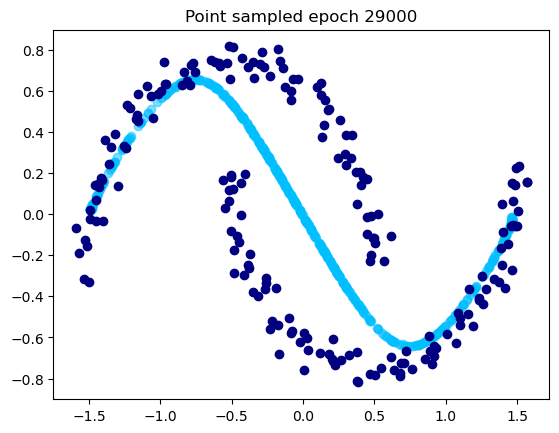

[29050/40000] 	Loss: 0.0000
[29100/40000] 	Loss: 0.0000
[29150/40000] 	Loss: 0.0000
[29200/40000] 	Loss: 0.0000
[29250/40000] 	Loss: 0.0000
[29300/40000] 	Loss: 0.0000
[29350/40000] 	Loss: 0.0000
[29400/40000] 	Loss: 0.0000
[29450/40000] 	Loss: 0.0000
[29500/40000] 	Loss: 0.0000
[29550/40000] 	Loss: 0.0000
[29600/40000] 	Loss: 0.0000
[29650/40000] 	Loss: 0.0000
[29700/40000] 	Loss: 0.0000
[29750/40000] 	Loss: 0.0000
[29800/40000] 	Loss: 0.0000
[29850/40000] 	Loss: 0.0000
[29900/40000] 	Loss: 0.0000
[29950/40000] 	Loss: 0.0000
[30000/40000] 	Loss: 0.0000


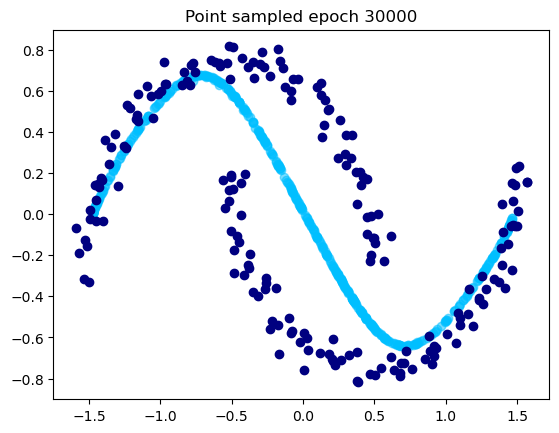

[30050/40000] 	Loss: 0.0000
[30100/40000] 	Loss: 0.0000
[30150/40000] 	Loss: 0.0001
[30200/40000] 	Loss: 0.0000
[30250/40000] 	Loss: 0.0000
[30300/40000] 	Loss: 0.0000
[30350/40000] 	Loss: 0.0000
[30400/40000] 	Loss: 0.0000
[30450/40000] 	Loss: 0.0000
[30500/40000] 	Loss: 0.0000
[30550/40000] 	Loss: 0.0000
[30600/40000] 	Loss: 0.0000
[30650/40000] 	Loss: 0.0000
[30700/40000] 	Loss: 0.0000
[30750/40000] 	Loss: 0.0000
[30800/40000] 	Loss: 0.0000
[30850/40000] 	Loss: 0.0000
[30900/40000] 	Loss: 0.0000
[30950/40000] 	Loss: 0.0000
[31000/40000] 	Loss: 0.0000


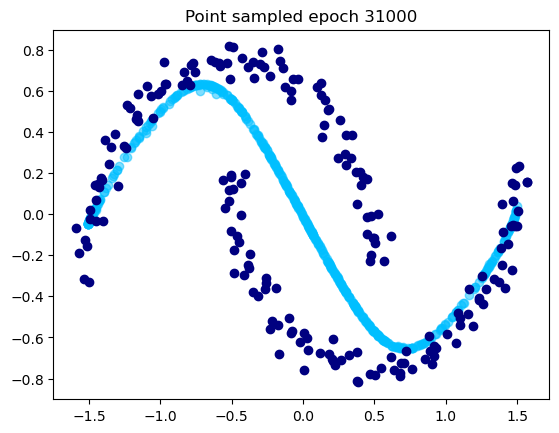

[31050/40000] 	Loss: 0.0000
[31100/40000] 	Loss: 0.0000
[31150/40000] 	Loss: 0.0000
[31200/40000] 	Loss: 0.0000
[31250/40000] 	Loss: 0.0000
[31300/40000] 	Loss: 0.0000
[31350/40000] 	Loss: 0.0000
[31400/40000] 	Loss: 0.0000
[31450/40000] 	Loss: 0.0000
[31500/40000] 	Loss: 0.0000
[31550/40000] 	Loss: 0.0000
[31600/40000] 	Loss: 0.0000
[31650/40000] 	Loss: 0.0000
[31700/40000] 	Loss: 0.0000
[31750/40000] 	Loss: 0.0000
[31800/40000] 	Loss: 0.0000
[31850/40000] 	Loss: 0.0000
[31900/40000] 	Loss: 0.0000
[31950/40000] 	Loss: 0.0000
[32000/40000] 	Loss: 0.0000


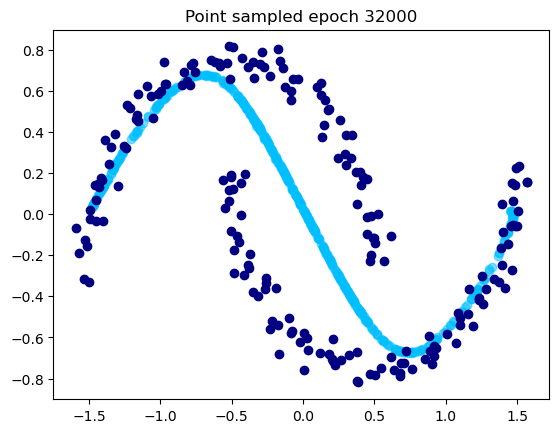

[32050/40000] 	Loss: 0.0000
[32100/40000] 	Loss: 0.0000
[32150/40000] 	Loss: 0.0000
[32200/40000] 	Loss: 0.0000
[32250/40000] 	Loss: 0.0000
[32300/40000] 	Loss: 0.0000
[32350/40000] 	Loss: 0.0000
[32400/40000] 	Loss: 0.0000
[32450/40000] 	Loss: 0.0000
[32500/40000] 	Loss: 0.0000
[32550/40000] 	Loss: 0.0000
[32600/40000] 	Loss: 0.0000
[32650/40000] 	Loss: 0.0000
[32700/40000] 	Loss: 0.0000
[32750/40000] 	Loss: 0.0000
[32800/40000] 	Loss: 0.0000
[32850/40000] 	Loss: 0.0000
[32900/40000] 	Loss: 0.0000
[32950/40000] 	Loss: 0.0000
[33000/40000] 	Loss: 0.0000


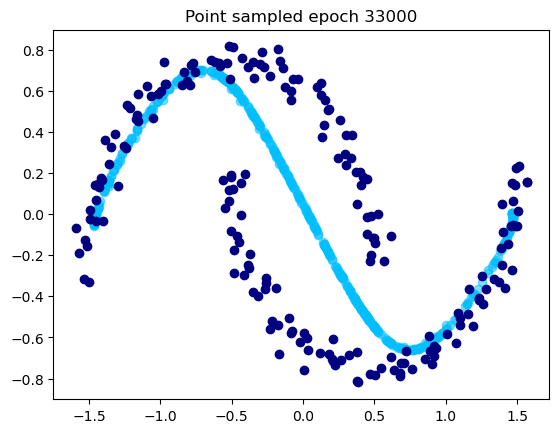

[33050/40000] 	Loss: 0.0000
[33100/40000] 	Loss: 0.0000
[33150/40000] 	Loss: 0.0000
[33200/40000] 	Loss: 0.0001
[33250/40000] 	Loss: 0.0000
[33300/40000] 	Loss: 0.0000
[33350/40000] 	Loss: 0.0000
[33400/40000] 	Loss: 0.0000
[33450/40000] 	Loss: 0.0000
[33500/40000] 	Loss: 0.0000
[33550/40000] 	Loss: 0.0000
[33600/40000] 	Loss: 0.0000
[33650/40000] 	Loss: 0.0000
[33700/40000] 	Loss: 0.0000
[33750/40000] 	Loss: 0.0000
[33800/40000] 	Loss: 0.0000
[33850/40000] 	Loss: 0.0000
[33900/40000] 	Loss: 0.0000
[33950/40000] 	Loss: 0.0000
[34000/40000] 	Loss: 0.0001


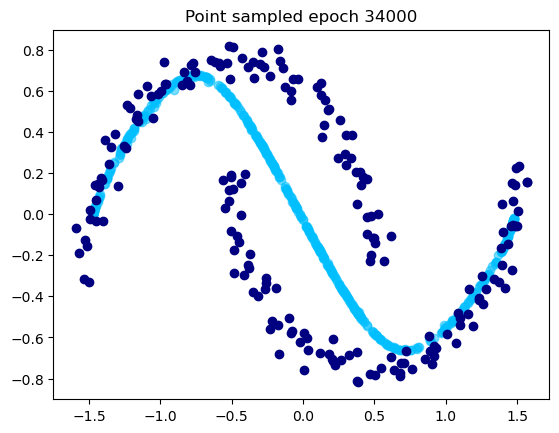

[34050/40000] 	Loss: 0.0003
[34100/40000] 	Loss: 0.0001
[34150/40000] 	Loss: 0.0000
[34200/40000] 	Loss: 0.0000
[34250/40000] 	Loss: 0.0000
[34300/40000] 	Loss: 0.0000
[34350/40000] 	Loss: 0.0000
[34400/40000] 	Loss: 0.0000
[34450/40000] 	Loss: 0.0000
[34500/40000] 	Loss: 0.0000
[34550/40000] 	Loss: 0.0000
[34600/40000] 	Loss: 0.0000
[34650/40000] 	Loss: 0.0002
[34700/40000] 	Loss: 0.0000
[34750/40000] 	Loss: 0.0000
[34800/40000] 	Loss: 0.0000
[34850/40000] 	Loss: 0.0000
[34900/40000] 	Loss: 0.0000
[34950/40000] 	Loss: 0.0001
[35000/40000] 	Loss: 0.0000


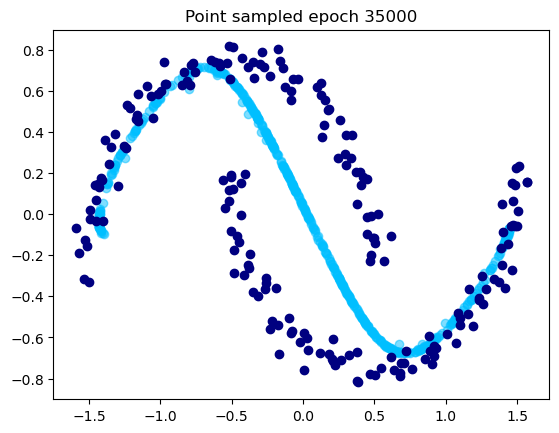

[35050/40000] 	Loss: 0.0000
[35100/40000] 	Loss: 0.0000
[35150/40000] 	Loss: 0.0000
[35200/40000] 	Loss: 0.0000
[35250/40000] 	Loss: 0.0000
[35300/40000] 	Loss: 0.0000
[35350/40000] 	Loss: 0.0000
[35400/40000] 	Loss: 0.0000
[35450/40000] 	Loss: 0.0000
[35500/40000] 	Loss: 0.0000
[35550/40000] 	Loss: 0.0000
[35600/40000] 	Loss: 0.0000
[35650/40000] 	Loss: 0.0000
[35700/40000] 	Loss: 0.0000
[35750/40000] 	Loss: 0.0000
[35800/40000] 	Loss: 0.0000
[35850/40000] 	Loss: 0.0001
[35900/40000] 	Loss: 0.0001
[35950/40000] 	Loss: 0.0001
[36000/40000] 	Loss: 0.0001


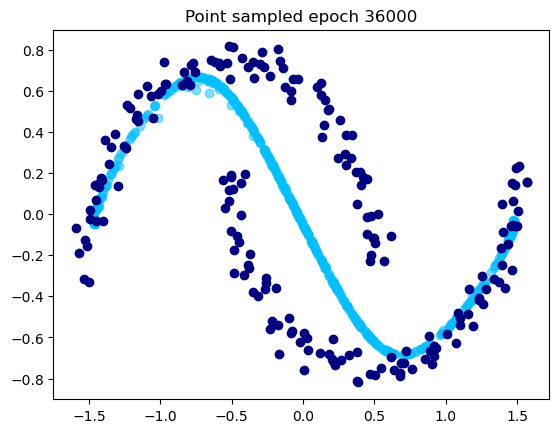

[36050/40000] 	Loss: 0.0000
[36100/40000] 	Loss: 0.0000
[36150/40000] 	Loss: 0.0000
[36200/40000] 	Loss: 0.0000
[36250/40000] 	Loss: 0.0000
[36300/40000] 	Loss: 0.0001
[36350/40000] 	Loss: 0.0000
[36400/40000] 	Loss: 0.0000
[36450/40000] 	Loss: 0.0000
[36500/40000] 	Loss: 0.0000
[36550/40000] 	Loss: 0.0000
[36600/40000] 	Loss: 0.0000
[36650/40000] 	Loss: 0.0000
[36700/40000] 	Loss: 0.0000
[36750/40000] 	Loss: 0.0000
[36800/40000] 	Loss: 0.0000
[36850/40000] 	Loss: 0.0000
[36900/40000] 	Loss: 0.0001
[36950/40000] 	Loss: 0.0000
[37000/40000] 	Loss: 0.0000


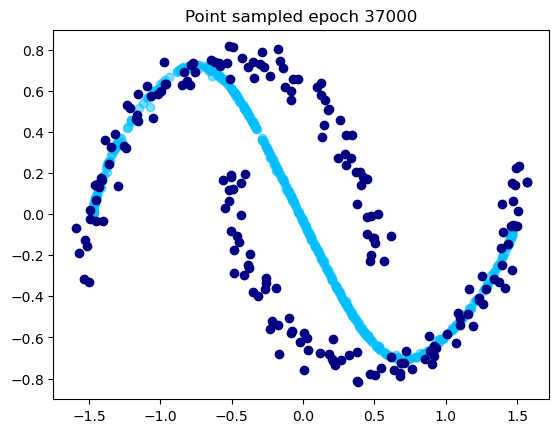

[37050/40000] 	Loss: 0.0000
[37100/40000] 	Loss: 0.0000
[37150/40000] 	Loss: 0.0000
[37200/40000] 	Loss: 0.0000
[37250/40000] 	Loss: 0.0000
[37300/40000] 	Loss: 0.0002
[37350/40000] 	Loss: 0.0000
[37400/40000] 	Loss: 0.0000
[37450/40000] 	Loss: 0.0000
[37500/40000] 	Loss: 0.0000
[37550/40000] 	Loss: 0.0000
[37600/40000] 	Loss: 0.0000
[37650/40000] 	Loss: 0.0002
[37700/40000] 	Loss: 0.0000
[37750/40000] 	Loss: 0.0000
[37800/40000] 	Loss: 0.0000
[37850/40000] 	Loss: 0.0000
[37900/40000] 	Loss: 0.0000
[37950/40000] 	Loss: 0.0001
[38000/40000] 	Loss: 0.0000


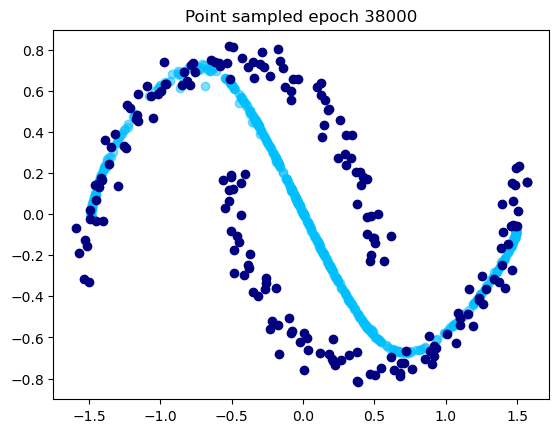

[38050/40000] 	Loss: 0.0000
[38100/40000] 	Loss: 0.0000
[38150/40000] 	Loss: 0.0000
[38200/40000] 	Loss: 0.0000
[38250/40000] 	Loss: 0.0000
[38300/40000] 	Loss: 0.0000
[38350/40000] 	Loss: 0.0000
[38400/40000] 	Loss: 0.0000
[38450/40000] 	Loss: 0.0001
[38500/40000] 	Loss: 0.0000
[38550/40000] 	Loss: 0.0000
[38600/40000] 	Loss: 0.0000
[38650/40000] 	Loss: 0.0000
[38700/40000] 	Loss: 0.0000
[38750/40000] 	Loss: 0.0000
[38800/40000] 	Loss: 0.0000
[38850/40000] 	Loss: 0.0000
[38900/40000] 	Loss: 0.0000
[38950/40000] 	Loss: 0.0000
[39000/40000] 	Loss: 0.0000


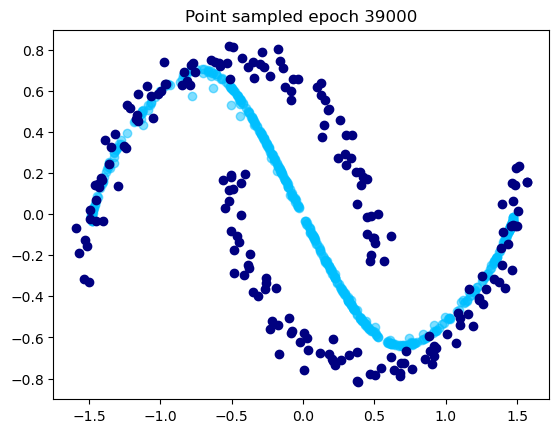

[39050/40000] 	Loss: 0.0000
[39100/40000] 	Loss: 0.0000
[39150/40000] 	Loss: 0.0000
[39200/40000] 	Loss: 0.0000
[39250/40000] 	Loss: 0.0002
[39300/40000] 	Loss: 0.0000
[39350/40000] 	Loss: 0.0000
[39400/40000] 	Loss: 0.0000
[39450/40000] 	Loss: 0.0000
[39500/40000] 	Loss: 0.0000
[39550/40000] 	Loss: 0.0000
[39600/40000] 	Loss: 0.0000
[39650/40000] 	Loss: 0.0000
[39700/40000] 	Loss: 0.0000
[39750/40000] 	Loss: 0.0000
[39800/40000] 	Loss: 0.0000
[39850/40000] 	Loss: 0.0000
[39900/40000] 	Loss: 0.0000
[39950/40000] 	Loss: 0.0000
[40000/40000] 	Loss: 0.0000


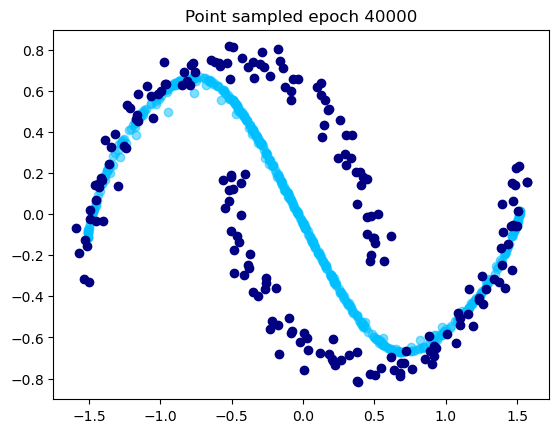

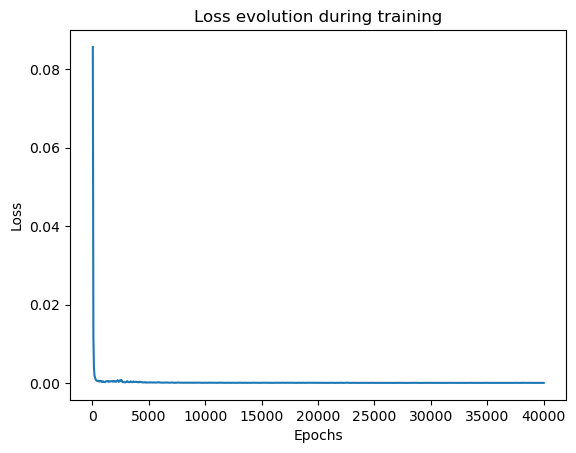

In [ ]:
train_consistency(nepochs, lr, ema_decay,
                    n_samples_per_batch, nb_degradation_per_datapoint,
                    d_model, n_blocks, num_diffusion_timesteps, timespand,
                    epoch_log, epoch_display, nb_samples_display,
                    fig_savepath, model_savepath)

In [17]:
nepochs=40000
lr=1e-3
ema_decay=0.3
                    
n_samples_per_batch=128
nb_degradation_per_datapoint=1

d_model=128
n_blocks=5

num_diffusion_timesteps=1000 # N
timespand=1000 # T

epoch_log=50
epoch_display=1000
nb_samples_display=512

fig_savepath="./figures/CT_two_moons_T1000_N1000"
model_savepath="./models/CT_two_moons_T1000_N1000_epoch40000.pt"

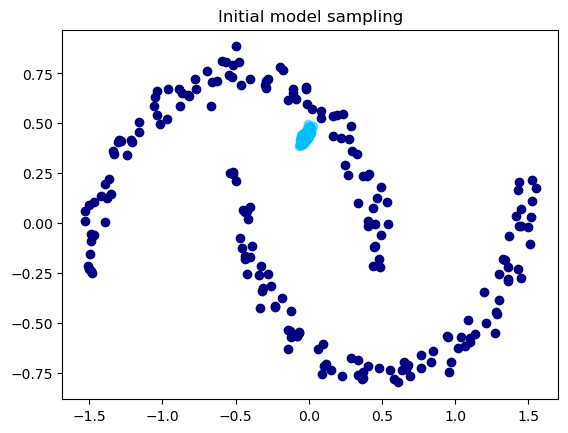

[50/40000] 	Loss: 0.0353
[100/40000] 	Loss: 0.0084
[150/40000] 	Loss: 0.0041
[200/40000] 	Loss: 0.0025
[250/40000] 	Loss: 0.0017
[300/40000] 	Loss: 0.0012
[350/40000] 	Loss: 0.0025
[400/40000] 	Loss: 0.0004
[450/40000] 	Loss: 0.0004
[500/40000] 	Loss: 0.0003
[550/40000] 	Loss: 0.0003
[600/40000] 	Loss: 0.0002
[650/40000] 	Loss: 0.0003
[700/40000] 	Loss: 0.0003
[750/40000] 	Loss: 0.0003
[800/40000] 	Loss: 0.0002
[850/40000] 	Loss: 0.0002
[900/40000] 	Loss: 0.0002
[950/40000] 	Loss: 0.0008
[1000/40000] 	Loss: 0.0005


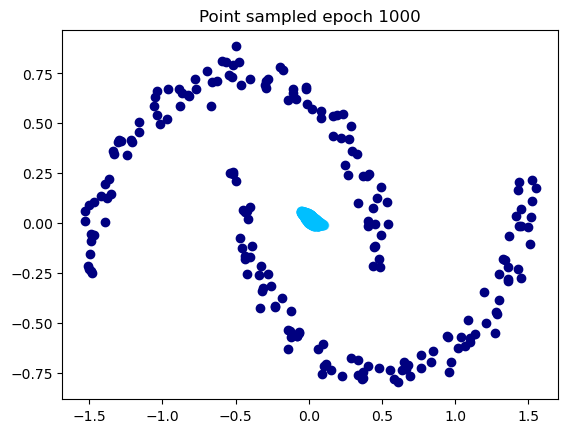

[1050/40000] 	Loss: 0.0003
[1100/40000] 	Loss: 0.0002
[1150/40000] 	Loss: 0.0002
[1200/40000] 	Loss: 0.0005
[1250/40000] 	Loss: 0.0004
[1300/40000] 	Loss: 0.0009
[1350/40000] 	Loss: 0.0002
[1400/40000] 	Loss: 0.0002
[1450/40000] 	Loss: 0.0013
[1500/40000] 	Loss: 0.0002
[1550/40000] 	Loss: 0.0001
[1600/40000] 	Loss: 0.0003
[1650/40000] 	Loss: 0.0005
[1700/40000] 	Loss: 0.0002
[1750/40000] 	Loss: 0.0020
[1800/40000] 	Loss: 0.0004
[1850/40000] 	Loss: 0.0003
[1900/40000] 	Loss: 0.0005
[1950/40000] 	Loss: 0.0009
[2000/40000] 	Loss: 0.0003


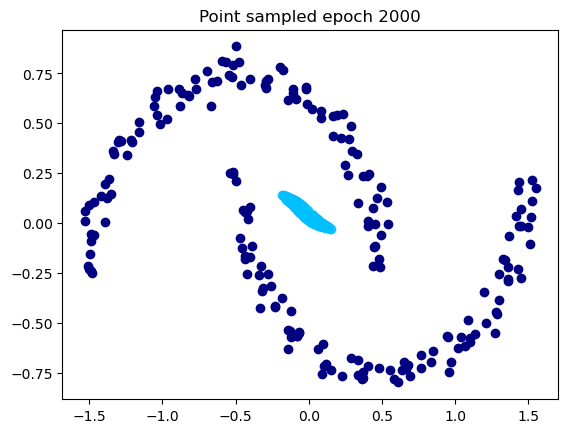

[2050/40000] 	Loss: 0.0002
[2100/40000] 	Loss: 0.0002
[2150/40000] 	Loss: 0.0007
[2200/40000] 	Loss: 0.0004
[2250/40000] 	Loss: 0.0003
[2300/40000] 	Loss: 0.0007
[2350/40000] 	Loss: 0.0006
[2400/40000] 	Loss: 0.0002
[2450/40000] 	Loss: 0.0002
[2500/40000] 	Loss: 0.0004
[2550/40000] 	Loss: 0.0003
[2600/40000] 	Loss: 0.0004
[2650/40000] 	Loss: 0.0003
[2700/40000] 	Loss: 0.0003
[2750/40000] 	Loss: 0.0005
[2800/40000] 	Loss: 0.0007
[2850/40000] 	Loss: 0.0002
[2900/40000] 	Loss: 0.0006
[2950/40000] 	Loss: 0.0003
[3000/40000] 	Loss: 0.0003


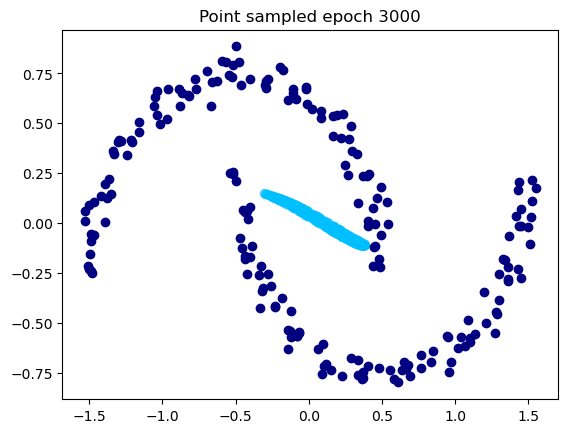

[3050/40000] 	Loss: 0.0003
[3100/40000] 	Loss: 0.0003
[3150/40000] 	Loss: 0.0008
[3200/40000] 	Loss: 0.0002
[3250/40000] 	Loss: 0.0003
[3300/40000] 	Loss: 0.0002
[3350/40000] 	Loss: 0.0005
[3400/40000] 	Loss: 0.0002
[3450/40000] 	Loss: 0.0004
[3500/40000] 	Loss: 0.0004
[3550/40000] 	Loss: 0.0002
[3600/40000] 	Loss: 0.0002
[3650/40000] 	Loss: 0.0003
[3700/40000] 	Loss: 0.0006
[3750/40000] 	Loss: 0.0003
[3800/40000] 	Loss: 0.0003
[3850/40000] 	Loss: 0.0002
[3900/40000] 	Loss: 0.0002
[3950/40000] 	Loss: 0.0002
[4000/40000] 	Loss: 0.0002


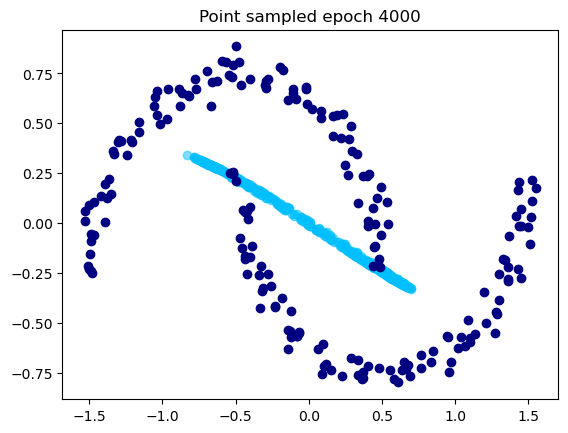

[4050/40000] 	Loss: 0.0002
[4100/40000] 	Loss: 0.0003
[4150/40000] 	Loss: 0.0003
[4200/40000] 	Loss: 0.0002
[4250/40000] 	Loss: 0.0005
[4300/40000] 	Loss: 0.0002
[4350/40000] 	Loss: 0.0002
[4400/40000] 	Loss: 0.0002
[4450/40000] 	Loss: 0.0006
[4500/40000] 	Loss: 0.0002
[4550/40000] 	Loss: 0.0002
[4600/40000] 	Loss: 0.0002
[4650/40000] 	Loss: 0.0002
[4700/40000] 	Loss: 0.0002
[4750/40000] 	Loss: 0.0001
[4800/40000] 	Loss: 0.0001
[4850/40000] 	Loss: 0.0001
[4900/40000] 	Loss: 0.0001
[4950/40000] 	Loss: 0.0001
[5000/40000] 	Loss: 0.0001


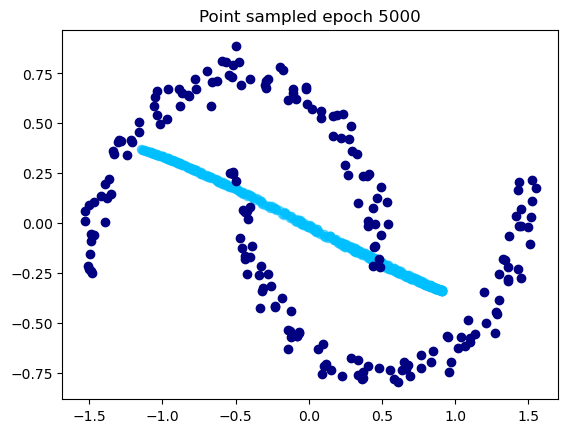

[5050/40000] 	Loss: 0.0001
[5100/40000] 	Loss: 0.0003
[5150/40000] 	Loss: 0.0003
[5200/40000] 	Loss: 0.0001
[5250/40000] 	Loss: 0.0001
[5300/40000] 	Loss: 0.0002
[5350/40000] 	Loss: 0.0001
[5400/40000] 	Loss: 0.0001
[5450/40000] 	Loss: 0.0001
[5500/40000] 	Loss: 0.0001
[5550/40000] 	Loss: 0.0001
[5600/40000] 	Loss: 0.0007
[5650/40000] 	Loss: 0.0002
[5700/40000] 	Loss: 0.0001
[5750/40000] 	Loss: 0.0001
[5800/40000] 	Loss: 0.0002
[5850/40000] 	Loss: 0.0001
[5900/40000] 	Loss: 0.0002
[5950/40000] 	Loss: 0.0001
[6000/40000] 	Loss: 0.0001


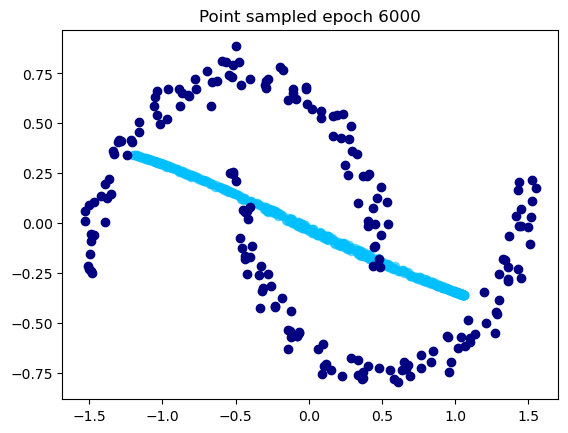

[6050/40000] 	Loss: 0.0002
[6100/40000] 	Loss: 0.0001
[6150/40000] 	Loss: 0.0001
[6200/40000] 	Loss: 0.0005
[6250/40000] 	Loss: 0.0001
[6300/40000] 	Loss: 0.0001
[6350/40000] 	Loss: 0.0007
[6400/40000] 	Loss: 0.0001
[6450/40000] 	Loss: 0.0001
[6500/40000] 	Loss: 0.0001
[6550/40000] 	Loss: 0.0001
[6600/40000] 	Loss: 0.0002
[6650/40000] 	Loss: 0.0001
[6700/40000] 	Loss: 0.0001
[6750/40000] 	Loss: 0.0001
[6800/40000] 	Loss: 0.0001
[6850/40000] 	Loss: 0.0001
[6900/40000] 	Loss: 0.0001
[6950/40000] 	Loss: 0.0001
[7000/40000] 	Loss: 0.0002


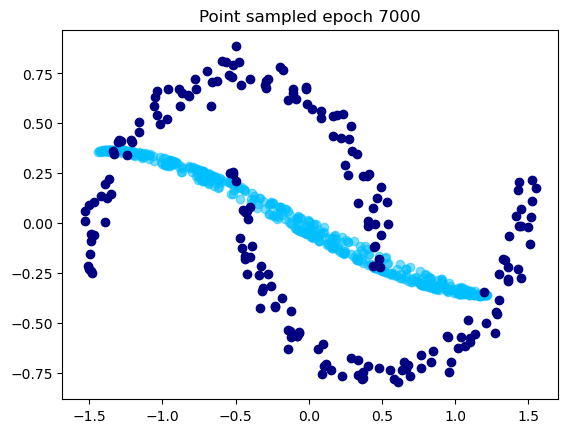

[7050/40000] 	Loss: 0.0001
[7100/40000] 	Loss: 0.0001
[7150/40000] 	Loss: 0.0002
[7200/40000] 	Loss: 0.0002
[7250/40000] 	Loss: 0.0001
[7300/40000] 	Loss: 0.0001
[7350/40000] 	Loss: 0.0002
[7400/40000] 	Loss: 0.0002
[7450/40000] 	Loss: 0.0001
[7500/40000] 	Loss: 0.0001
[7550/40000] 	Loss: 0.0002
[7600/40000] 	Loss: 0.0001
[7650/40000] 	Loss: 0.0003
[7700/40000] 	Loss: 0.0001
[7750/40000] 	Loss: 0.0002
[7800/40000] 	Loss: 0.0001
[7850/40000] 	Loss: 0.0001
[7900/40000] 	Loss: 0.0001
[7950/40000] 	Loss: 0.0001
[8000/40000] 	Loss: 0.0001


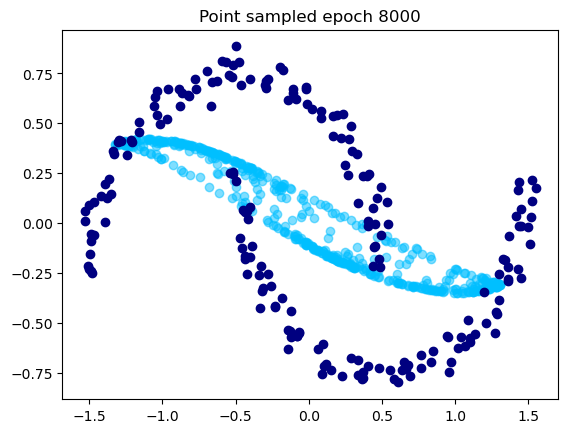

[8050/40000] 	Loss: 0.0001
[8100/40000] 	Loss: 0.0001
[8150/40000] 	Loss: 0.0001
[8200/40000] 	Loss: 0.0001
[8250/40000] 	Loss: 0.0001
[8300/40000] 	Loss: 0.0001
[8350/40000] 	Loss: 0.0001
[8400/40000] 	Loss: 0.0001
[8450/40000] 	Loss: 0.0001
[8500/40000] 	Loss: 0.0001
[8550/40000] 	Loss: 0.0001
[8600/40000] 	Loss: 0.0001
[8650/40000] 	Loss: 0.0001
[8700/40000] 	Loss: 0.0001
[8750/40000] 	Loss: 0.0002
[8800/40000] 	Loss: 0.0001
[8850/40000] 	Loss: 0.0001
[8900/40000] 	Loss: 0.0001
[8950/40000] 	Loss: 0.0002
[9000/40000] 	Loss: 0.0002


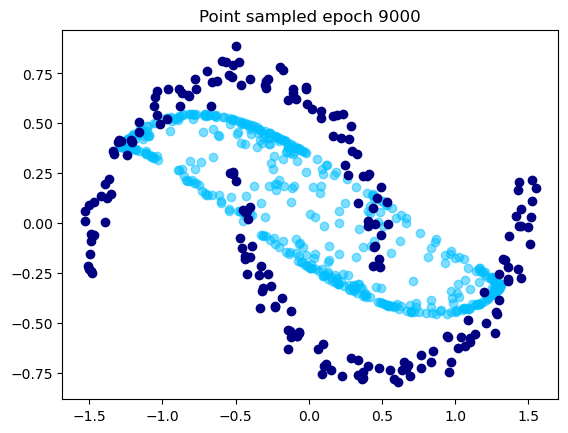

[9050/40000] 	Loss: 0.0001
[9100/40000] 	Loss: 0.0001
[9150/40000] 	Loss: 0.0001
[9200/40000] 	Loss: 0.0001
[9250/40000] 	Loss: 0.0001
[9300/40000] 	Loss: 0.0001
[9350/40000] 	Loss: 0.0001
[9400/40000] 	Loss: 0.0001
[9450/40000] 	Loss: 0.0001
[9500/40000] 	Loss: 0.0001
[9550/40000] 	Loss: 0.0001
[9600/40000] 	Loss: 0.0001
[9650/40000] 	Loss: 0.0002
[9700/40000] 	Loss: 0.0001
[9750/40000] 	Loss: 0.0001
[9800/40000] 	Loss: 0.0001
[9850/40000] 	Loss: 0.0001
[9900/40000] 	Loss: 0.0001
[9950/40000] 	Loss: 0.0001
[10000/40000] 	Loss: 0.0001


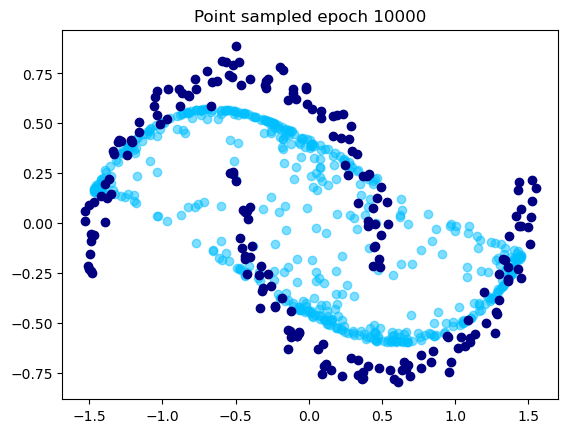

[10050/40000] 	Loss: 0.0001
[10100/40000] 	Loss: 0.0001
[10150/40000] 	Loss: 0.0001
[10200/40000] 	Loss: 0.0001
[10250/40000] 	Loss: 0.0000
[10300/40000] 	Loss: 0.0001
[10350/40000] 	Loss: 0.0001
[10400/40000] 	Loss: 0.0001
[10450/40000] 	Loss: 0.0001
[10500/40000] 	Loss: 0.0000
[10550/40000] 	Loss: 0.0001
[10600/40000] 	Loss: 0.0001
[10650/40000] 	Loss: 0.0001
[10700/40000] 	Loss: 0.0001
[10750/40000] 	Loss: 0.0001
[10800/40000] 	Loss: 0.0000
[10850/40000] 	Loss: 0.0001
[10900/40000] 	Loss: 0.0001
[10950/40000] 	Loss: 0.0001
[11000/40000] 	Loss: 0.0001


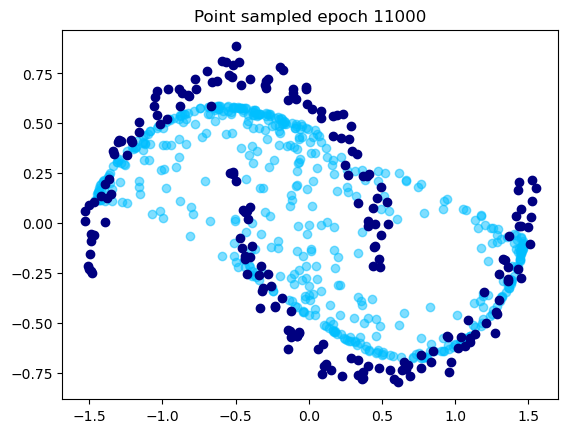

[11050/40000] 	Loss: 0.0000
[11100/40000] 	Loss: 0.0000
[11150/40000] 	Loss: 0.0000
[11200/40000] 	Loss: 0.0000
[11250/40000] 	Loss: 0.0000
[11300/40000] 	Loss: 0.0001
[11350/40000] 	Loss: 0.0000
[11400/40000] 	Loss: 0.0001
[11450/40000] 	Loss: 0.0000
[11500/40000] 	Loss: 0.0001
[11550/40000] 	Loss: 0.0001
[11600/40000] 	Loss: 0.0000
[11650/40000] 	Loss: 0.0000
[11700/40000] 	Loss: 0.0001
[11750/40000] 	Loss: 0.0000
[11800/40000] 	Loss: 0.0000
[11850/40000] 	Loss: 0.0000
[11900/40000] 	Loss: 0.0000
[11950/40000] 	Loss: 0.0001
[12000/40000] 	Loss: 0.0002


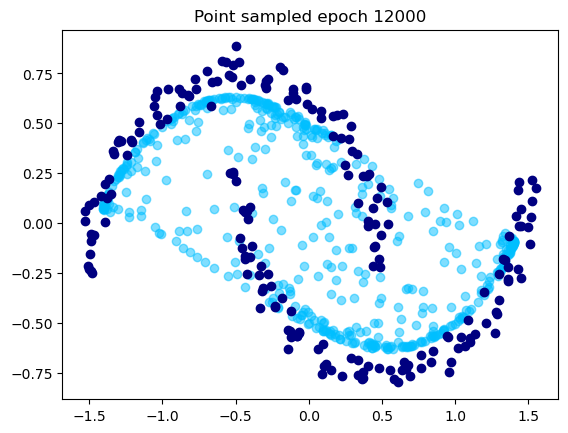

[12050/40000] 	Loss: 0.0000
[12100/40000] 	Loss: 0.0000
[12150/40000] 	Loss: 0.0000
[12200/40000] 	Loss: 0.0001
[12250/40000] 	Loss: 0.0000
[12300/40000] 	Loss: 0.0000
[12350/40000] 	Loss: 0.0001
[12400/40000] 	Loss: 0.0001
[12450/40000] 	Loss: 0.0000
[12500/40000] 	Loss: 0.0001
[12550/40000] 	Loss: 0.0001
[12600/40000] 	Loss: 0.0001
[12650/40000] 	Loss: 0.0001
[12700/40000] 	Loss: 0.0001
[12750/40000] 	Loss: 0.0001
[12800/40000] 	Loss: 0.0001
[12850/40000] 	Loss: 0.0001
[12900/40000] 	Loss: 0.0000
[12950/40000] 	Loss: 0.0000
[13000/40000] 	Loss: 0.0000


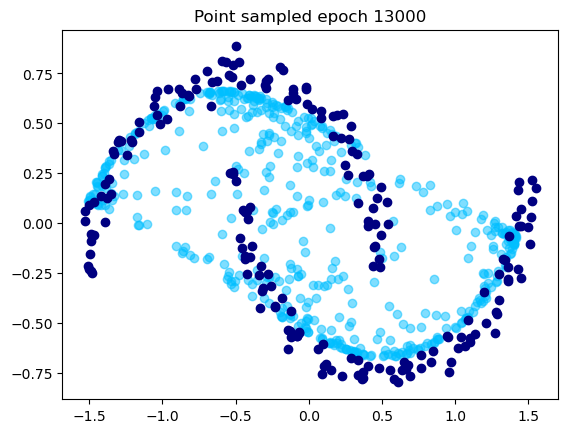

[13050/40000] 	Loss: 0.0000
[13100/40000] 	Loss: 0.0000
[13150/40000] 	Loss: 0.0000
[13200/40000] 	Loss: 0.0000
[13250/40000] 	Loss: 0.0001
[13300/40000] 	Loss: 0.0000
[13350/40000] 	Loss: 0.0000
[13400/40000] 	Loss: 0.0000
[13450/40000] 	Loss: 0.0000
[13500/40000] 	Loss: 0.0000
[13550/40000] 	Loss: 0.0000
[13600/40000] 	Loss: 0.0000
[13650/40000] 	Loss: 0.0000
[13700/40000] 	Loss: 0.0000
[13750/40000] 	Loss: 0.0000
[13800/40000] 	Loss: 0.0000
[13850/40000] 	Loss: 0.0000
[13900/40000] 	Loss: 0.0000
[13950/40000] 	Loss: 0.0000
[14000/40000] 	Loss: 0.0000


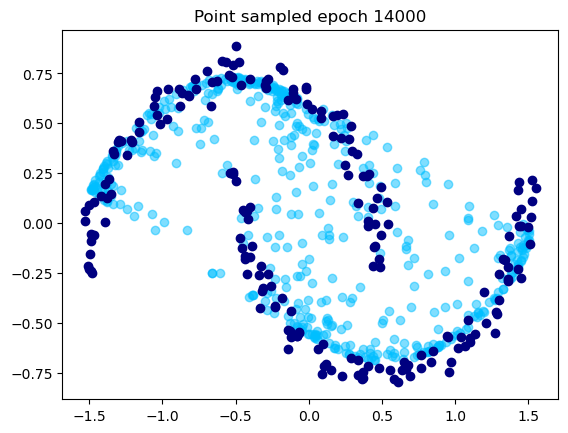

[14050/40000] 	Loss: 0.0000
[14100/40000] 	Loss: 0.0000
[14150/40000] 	Loss: 0.0000
[14200/40000] 	Loss: 0.0000
[14250/40000] 	Loss: 0.0000
[14300/40000] 	Loss: 0.0001
[14350/40000] 	Loss: 0.0000
[14400/40000] 	Loss: 0.0000
[14450/40000] 	Loss: 0.0001
[14500/40000] 	Loss: 0.0000
[14550/40000] 	Loss: 0.0000
[14600/40000] 	Loss: 0.0000
[14650/40000] 	Loss: 0.0000
[14700/40000] 	Loss: 0.0000
[14750/40000] 	Loss: 0.0000
[14800/40000] 	Loss: 0.0000
[14850/40000] 	Loss: 0.0001
[14900/40000] 	Loss: 0.0000
[14950/40000] 	Loss: 0.0000
[15000/40000] 	Loss: 0.0001


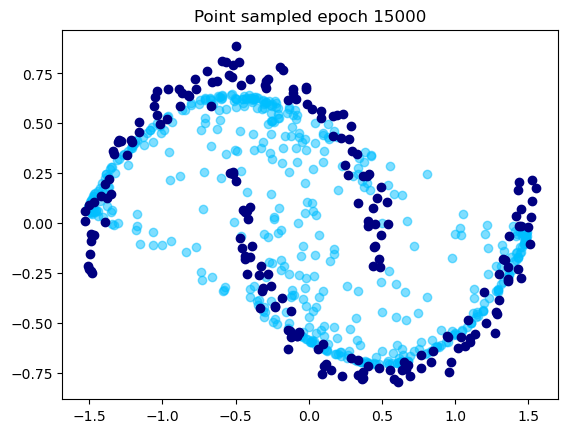

[15050/40000] 	Loss: 0.0000
[15100/40000] 	Loss: 0.0000
[15150/40000] 	Loss: 0.0000
[15200/40000] 	Loss: 0.0000
[15250/40000] 	Loss: 0.0000
[15300/40000] 	Loss: 0.0000
[15350/40000] 	Loss: 0.0000
[15400/40000] 	Loss: 0.0000
[15450/40000] 	Loss: 0.0000
[15500/40000] 	Loss: 0.0000
[15550/40000] 	Loss: 0.0000
[15600/40000] 	Loss: 0.0000
[15650/40000] 	Loss: 0.0000
[15700/40000] 	Loss: 0.0000
[15750/40000] 	Loss: 0.0000
[15800/40000] 	Loss: 0.0000
[15850/40000] 	Loss: 0.0000
[15900/40000] 	Loss: 0.0001
[15950/40000] 	Loss: 0.0000
[16000/40000] 	Loss: 0.0000


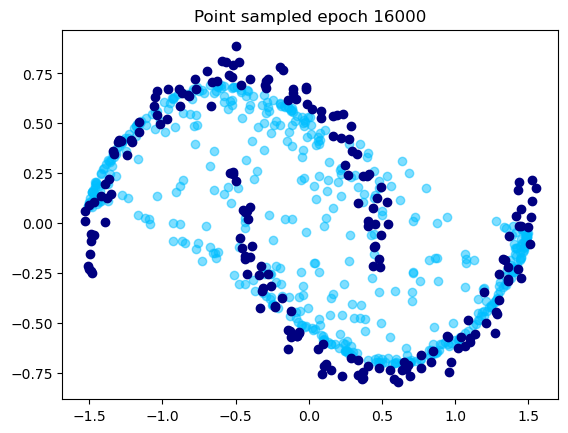

[16050/40000] 	Loss: 0.0000
[16100/40000] 	Loss: 0.0000
[16150/40000] 	Loss: 0.0000
[16200/40000] 	Loss: 0.0000
[16250/40000] 	Loss: 0.0000
[16300/40000] 	Loss: 0.0000
[16350/40000] 	Loss: 0.0000
[16400/40000] 	Loss: 0.0000
[16450/40000] 	Loss: 0.0000
[16500/40000] 	Loss: 0.0000
[16550/40000] 	Loss: 0.0000
[16600/40000] 	Loss: 0.0000
[16650/40000] 	Loss: 0.0000
[16700/40000] 	Loss: 0.0000
[16750/40000] 	Loss: 0.0000
[16800/40000] 	Loss: 0.0000
[16850/40000] 	Loss: 0.0000
[16900/40000] 	Loss: 0.0000
[16950/40000] 	Loss: 0.0000
[17000/40000] 	Loss: 0.0000


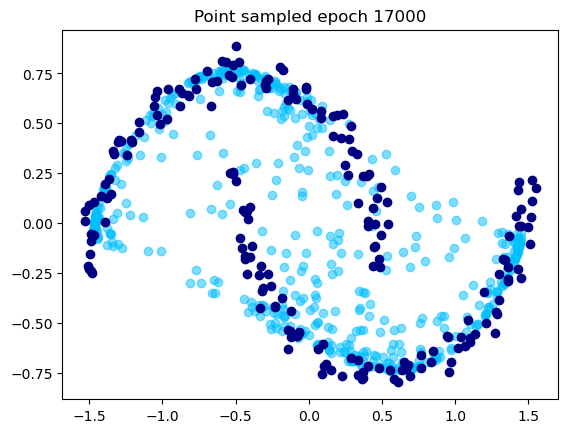

[17050/40000] 	Loss: 0.0000
[17100/40000] 	Loss: 0.0000
[17150/40000] 	Loss: 0.0001
[17200/40000] 	Loss: 0.0000
[17250/40000] 	Loss: 0.0000
[17300/40000] 	Loss: 0.0000
[17350/40000] 	Loss: 0.0001
[17400/40000] 	Loss: 0.0000
[17450/40000] 	Loss: 0.0000
[17500/40000] 	Loss: 0.0000
[17550/40000] 	Loss: 0.0000
[17600/40000] 	Loss: 0.0000
[17650/40000] 	Loss: 0.0000
[17700/40000] 	Loss: 0.0000
[17750/40000] 	Loss: 0.0000
[17800/40000] 	Loss: 0.0000
[17850/40000] 	Loss: 0.0000
[17900/40000] 	Loss: 0.0000
[17950/40000] 	Loss: 0.0000
[18000/40000] 	Loss: 0.0000


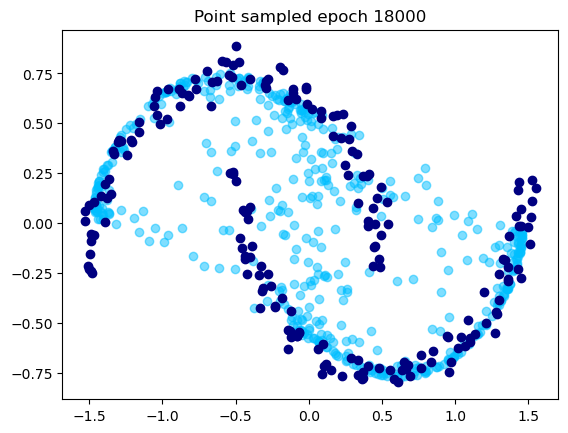

[18050/40000] 	Loss: 0.0000
[18100/40000] 	Loss: 0.0000
[18150/40000] 	Loss: 0.0000
[18200/40000] 	Loss: 0.0000
[18250/40000] 	Loss: 0.0000
[18300/40000] 	Loss: 0.0000
[18350/40000] 	Loss: 0.0000
[18400/40000] 	Loss: 0.0000
[18450/40000] 	Loss: 0.0000
[18500/40000] 	Loss: 0.0000
[18550/40000] 	Loss: 0.0000
[18600/40000] 	Loss: 0.0001
[18650/40000] 	Loss: 0.0000
[18700/40000] 	Loss: 0.0000
[18750/40000] 	Loss: 0.0000
[18800/40000] 	Loss: 0.0000
[18850/40000] 	Loss: 0.0000
[18900/40000] 	Loss: 0.0000
[18950/40000] 	Loss: 0.0000
[19000/40000] 	Loss: 0.0000


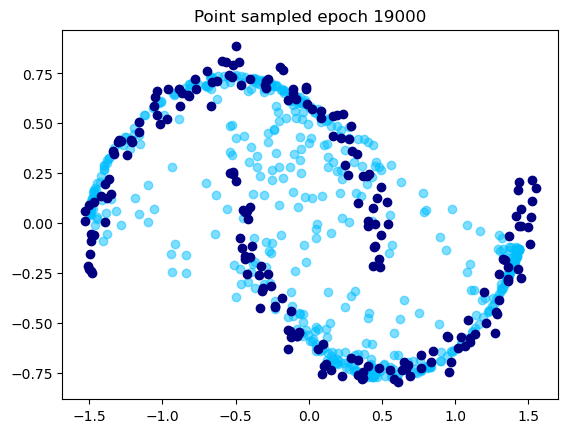

[19050/40000] 	Loss: 0.0000
[19100/40000] 	Loss: 0.0000
[19150/40000] 	Loss: 0.0000
[19200/40000] 	Loss: 0.0000
[19250/40000] 	Loss: 0.0000
[19300/40000] 	Loss: 0.0000
[19350/40000] 	Loss: 0.0001
[19400/40000] 	Loss: 0.0000
[19450/40000] 	Loss: 0.0000
[19500/40000] 	Loss: 0.0000
[19550/40000] 	Loss: 0.0000
[19600/40000] 	Loss: 0.0001
[19650/40000] 	Loss: 0.0000
[19700/40000] 	Loss: 0.0000
[19750/40000] 	Loss: 0.0000
[19800/40000] 	Loss: 0.0000
[19850/40000] 	Loss: 0.0000
[19900/40000] 	Loss: 0.0000
[19950/40000] 	Loss: 0.0000
[20000/40000] 	Loss: 0.0000


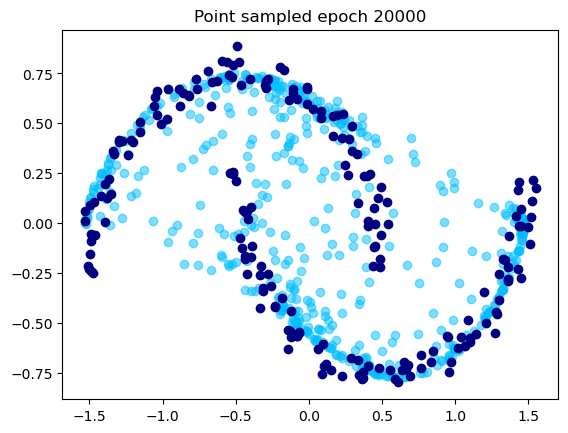

[20050/40000] 	Loss: 0.0000
[20100/40000] 	Loss: 0.0000
[20150/40000] 	Loss: 0.0000
[20200/40000] 	Loss: 0.0000
[20250/40000] 	Loss: 0.0000
[20300/40000] 	Loss: 0.0000
[20350/40000] 	Loss: 0.0000
[20400/40000] 	Loss: 0.0000
[20450/40000] 	Loss: 0.0000
[20500/40000] 	Loss: 0.0000
[20550/40000] 	Loss: 0.0000
[20600/40000] 	Loss: 0.0000
[20650/40000] 	Loss: 0.0000
[20700/40000] 	Loss: 0.0000
[20750/40000] 	Loss: 0.0000
[20800/40000] 	Loss: 0.0000
[20850/40000] 	Loss: 0.0000
[20900/40000] 	Loss: 0.0000
[20950/40000] 	Loss: 0.0001
[21000/40000] 	Loss: 0.0000


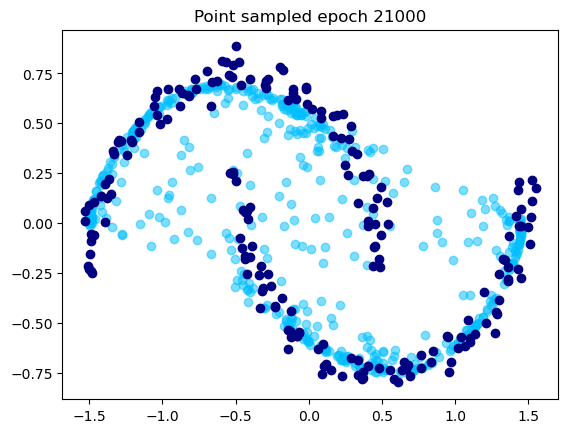

[21050/40000] 	Loss: 0.0000
[21100/40000] 	Loss: 0.0000
[21150/40000] 	Loss: 0.0000
[21200/40000] 	Loss: 0.0000
[21250/40000] 	Loss: 0.0000
[21300/40000] 	Loss: 0.0000
[21350/40000] 	Loss: 0.0000
[21400/40000] 	Loss: 0.0000
[21450/40000] 	Loss: 0.0000
[21500/40000] 	Loss: 0.0000
[21550/40000] 	Loss: 0.0000
[21600/40000] 	Loss: 0.0000
[21650/40000] 	Loss: 0.0000
[21700/40000] 	Loss: 0.0000
[21750/40000] 	Loss: 0.0000
[21800/40000] 	Loss: 0.0000
[21850/40000] 	Loss: 0.0000
[21900/40000] 	Loss: 0.0000
[21950/40000] 	Loss: 0.0000
[22000/40000] 	Loss: 0.0000


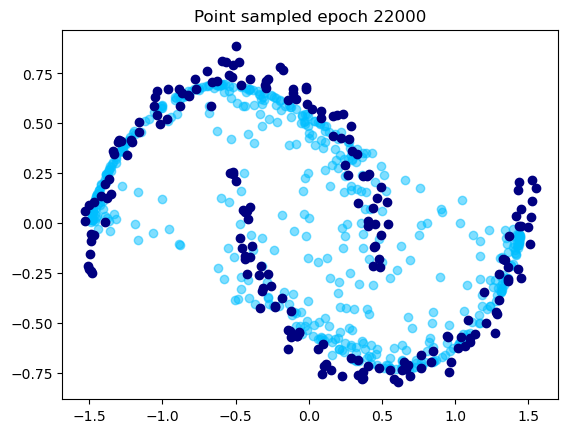

[22050/40000] 	Loss: 0.0000
[22100/40000] 	Loss: 0.0000
[22150/40000] 	Loss: 0.0000
[22200/40000] 	Loss: 0.0000
[22250/40000] 	Loss: 0.0000
[22300/40000] 	Loss: 0.0000
[22350/40000] 	Loss: 0.0000
[22400/40000] 	Loss: 0.0000
[22450/40000] 	Loss: 0.0000
[22500/40000] 	Loss: 0.0000
[22550/40000] 	Loss: 0.0000
[22600/40000] 	Loss: 0.0000
[22650/40000] 	Loss: 0.0000
[22700/40000] 	Loss: 0.0000
[22750/40000] 	Loss: 0.0000
[22800/40000] 	Loss: 0.0000
[22850/40000] 	Loss: 0.0000
[22900/40000] 	Loss: 0.0000
[22950/40000] 	Loss: 0.0000
[23000/40000] 	Loss: 0.0000


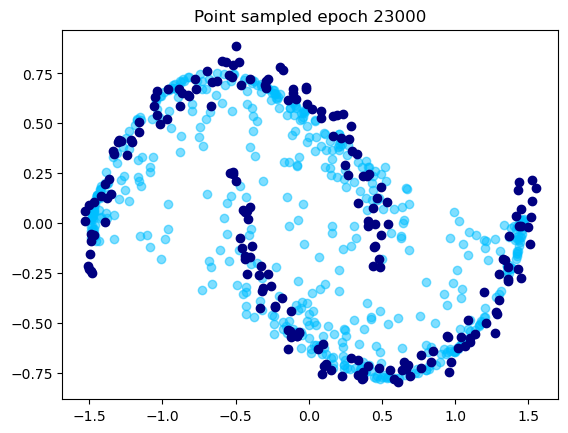

[23050/40000] 	Loss: 0.0000
[23100/40000] 	Loss: 0.0000
[23150/40000] 	Loss: 0.0000
[23200/40000] 	Loss: 0.0000
[23250/40000] 	Loss: 0.0000
[23300/40000] 	Loss: 0.0000
[23350/40000] 	Loss: 0.0001
[23400/40000] 	Loss: 0.0000
[23450/40000] 	Loss: 0.0000
[23500/40000] 	Loss: 0.0000
[23550/40000] 	Loss: 0.0000
[23600/40000] 	Loss: 0.0000
[23650/40000] 	Loss: 0.0000
[23700/40000] 	Loss: 0.0000
[23750/40000] 	Loss: 0.0000
[23800/40000] 	Loss: 0.0000
[23850/40000] 	Loss: 0.0000
[23900/40000] 	Loss: 0.0000
[23950/40000] 	Loss: 0.0000
[24000/40000] 	Loss: 0.0000


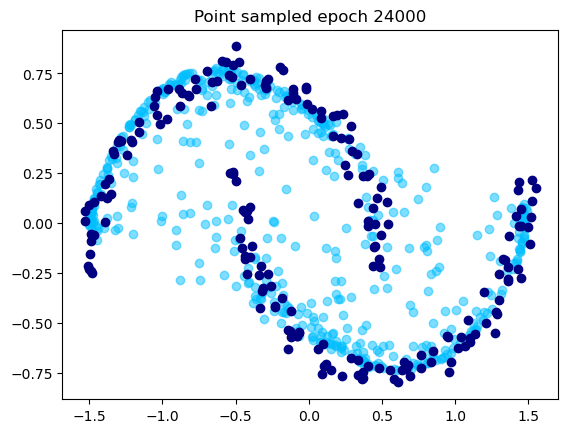

[24050/40000] 	Loss: 0.0000
[24100/40000] 	Loss: 0.0000
[24150/40000] 	Loss: 0.0000
[24200/40000] 	Loss: 0.0000
[24250/40000] 	Loss: 0.0000
[24300/40000] 	Loss: 0.0000
[24350/40000] 	Loss: 0.0000
[24400/40000] 	Loss: 0.0000
[24450/40000] 	Loss: 0.0000
[24500/40000] 	Loss: 0.0000
[24550/40000] 	Loss: 0.0000
[24600/40000] 	Loss: 0.0000
[24650/40000] 	Loss: 0.0000
[24700/40000] 	Loss: 0.0000
[24750/40000] 	Loss: 0.0000
[24800/40000] 	Loss: 0.0000
[24850/40000] 	Loss: 0.0000
[24900/40000] 	Loss: 0.0000
[24950/40000] 	Loss: 0.0000
[25000/40000] 	Loss: 0.0000


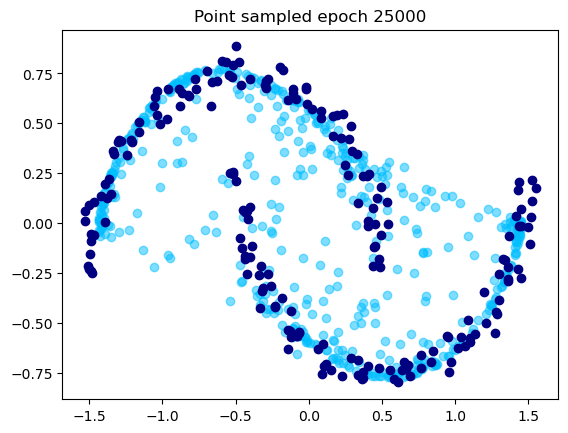

[25050/40000] 	Loss: 0.0000
[25100/40000] 	Loss: 0.0000
[25150/40000] 	Loss: 0.0000
[25200/40000] 	Loss: 0.0000
[25250/40000] 	Loss: 0.0000
[25300/40000] 	Loss: 0.0000
[25350/40000] 	Loss: 0.0000
[25400/40000] 	Loss: 0.0000
[25450/40000] 	Loss: 0.0000
[25500/40000] 	Loss: 0.0000
[25550/40000] 	Loss: 0.0000
[25600/40000] 	Loss: 0.0000
[25650/40000] 	Loss: 0.0000
[25700/40000] 	Loss: 0.0000
[25750/40000] 	Loss: 0.0000
[25800/40000] 	Loss: 0.0000
[25850/40000] 	Loss: 0.0000
[25900/40000] 	Loss: 0.0000
[25950/40000] 	Loss: 0.0000
[26000/40000] 	Loss: 0.0000


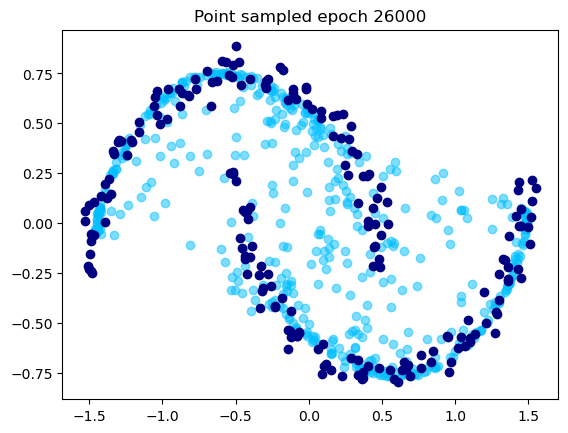

[26050/40000] 	Loss: 0.0000
[26100/40000] 	Loss: 0.0000
[26150/40000] 	Loss: 0.0000
[26200/40000] 	Loss: 0.0000
[26250/40000] 	Loss: 0.0000
[26300/40000] 	Loss: 0.0000
[26350/40000] 	Loss: 0.0000
[26400/40000] 	Loss: 0.0000
[26450/40000] 	Loss: 0.0000
[26500/40000] 	Loss: 0.0000
[26550/40000] 	Loss: 0.0000
[26600/40000] 	Loss: 0.0000
[26650/40000] 	Loss: 0.0000
[26700/40000] 	Loss: 0.0000
[26750/40000] 	Loss: 0.0000
[26800/40000] 	Loss: 0.0000
[26850/40000] 	Loss: 0.0000
[26900/40000] 	Loss: 0.0000
[26950/40000] 	Loss: 0.0000
[27000/40000] 	Loss: 0.0000


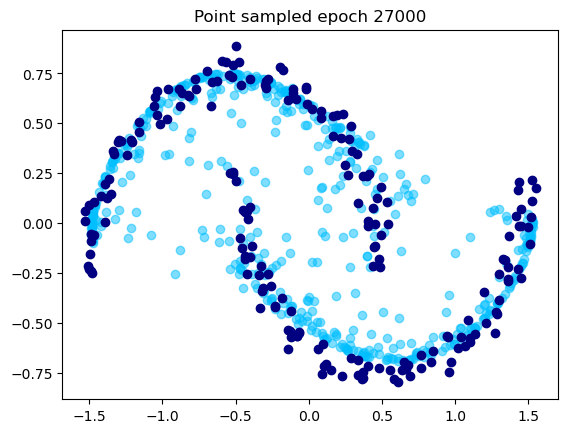

[27050/40000] 	Loss: 0.0000
[27100/40000] 	Loss: 0.0000
[27150/40000] 	Loss: 0.0000
[27200/40000] 	Loss: 0.0000
[27250/40000] 	Loss: 0.0000
[27300/40000] 	Loss: 0.0000
[27350/40000] 	Loss: 0.0000
[27400/40000] 	Loss: 0.0000
[27450/40000] 	Loss: 0.0000
[27500/40000] 	Loss: 0.0000
[27550/40000] 	Loss: 0.0000
[27600/40000] 	Loss: 0.0000
[27650/40000] 	Loss: 0.0000
[27700/40000] 	Loss: 0.0000
[27750/40000] 	Loss: 0.0000
[27800/40000] 	Loss: 0.0000
[27850/40000] 	Loss: 0.0000
[27900/40000] 	Loss: 0.0000
[27950/40000] 	Loss: 0.0000
[28000/40000] 	Loss: 0.0000


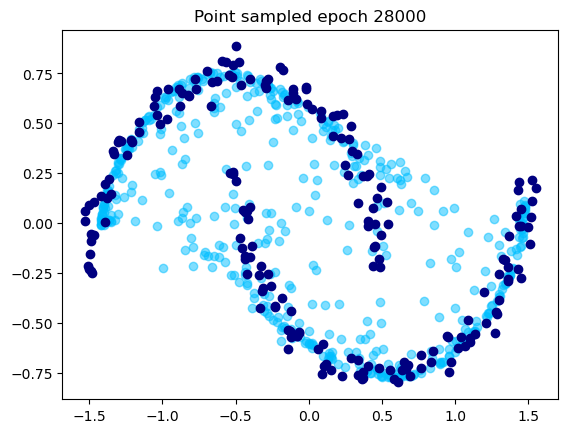

[28050/40000] 	Loss: 0.0000
[28100/40000] 	Loss: 0.0000
[28150/40000] 	Loss: 0.0000
[28200/40000] 	Loss: 0.0000
[28250/40000] 	Loss: 0.0000
[28300/40000] 	Loss: 0.0000
[28350/40000] 	Loss: 0.0000
[28400/40000] 	Loss: 0.0000
[28450/40000] 	Loss: 0.0000
[28500/40000] 	Loss: 0.0001
[28550/40000] 	Loss: 0.0000
[28600/40000] 	Loss: 0.0000
[28650/40000] 	Loss: 0.0000
[28700/40000] 	Loss: 0.0000
[28750/40000] 	Loss: 0.0000
[28800/40000] 	Loss: 0.0000
[28850/40000] 	Loss: 0.0000
[28900/40000] 	Loss: 0.0000
[28950/40000] 	Loss: 0.0000
[29000/40000] 	Loss: 0.0000


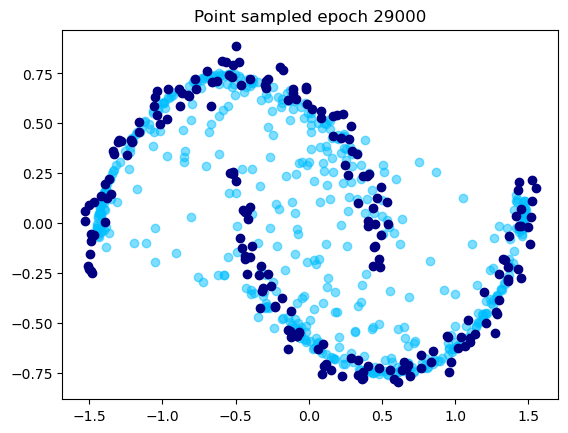

[29050/40000] 	Loss: 0.0000
[29100/40000] 	Loss: 0.0000
[29150/40000] 	Loss: 0.0000
[29200/40000] 	Loss: 0.0000
[29250/40000] 	Loss: 0.0000
[29300/40000] 	Loss: 0.0000
[29350/40000] 	Loss: 0.0000
[29400/40000] 	Loss: 0.0000
[29450/40000] 	Loss: 0.0000
[29500/40000] 	Loss: 0.0000
[29550/40000] 	Loss: 0.0000
[29600/40000] 	Loss: 0.0000
[29650/40000] 	Loss: 0.0000
[29700/40000] 	Loss: 0.0000
[29750/40000] 	Loss: 0.0000
[29800/40000] 	Loss: 0.0000
[29850/40000] 	Loss: 0.0000
[29900/40000] 	Loss: 0.0000
[29950/40000] 	Loss: 0.0000
[30000/40000] 	Loss: 0.0000


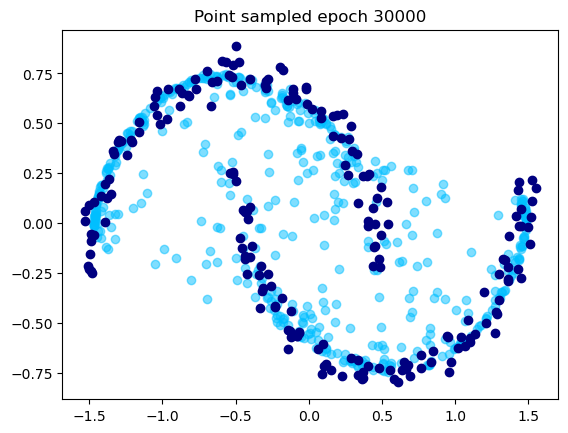

[30050/40000] 	Loss: 0.0000
[30100/40000] 	Loss: 0.0000
[30150/40000] 	Loss: 0.0000
[30200/40000] 	Loss: 0.0000
[30250/40000] 	Loss: 0.0000
[30300/40000] 	Loss: 0.0000
[30350/40000] 	Loss: 0.0000
[30400/40000] 	Loss: 0.0000
[30450/40000] 	Loss: 0.0000
[30500/40000] 	Loss: 0.0000
[30550/40000] 	Loss: 0.0000
[30600/40000] 	Loss: 0.0000
[30650/40000] 	Loss: 0.0000
[30700/40000] 	Loss: 0.0000
[30750/40000] 	Loss: 0.0000
[30800/40000] 	Loss: 0.0000
[30850/40000] 	Loss: 0.0000
[30900/40000] 	Loss: 0.0000
[30950/40000] 	Loss: 0.0000
[31000/40000] 	Loss: 0.0000


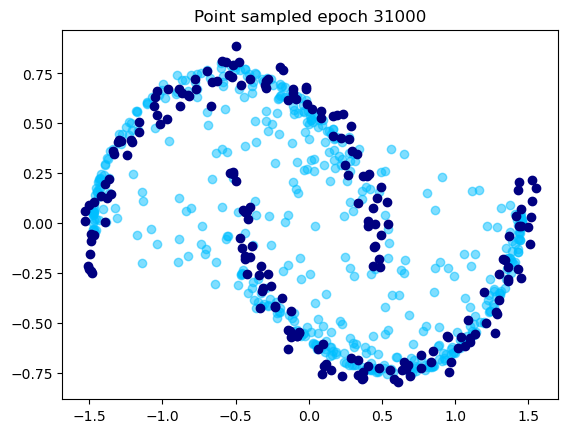

[31050/40000] 	Loss: 0.0000
[31100/40000] 	Loss: 0.0000
[31150/40000] 	Loss: 0.0000
[31200/40000] 	Loss: 0.0000
[31250/40000] 	Loss: 0.0000
[31300/40000] 	Loss: 0.0000
[31350/40000] 	Loss: 0.0000
[31400/40000] 	Loss: 0.0000
[31450/40000] 	Loss: 0.0000
[31500/40000] 	Loss: 0.0000
[31550/40000] 	Loss: 0.0000
[31600/40000] 	Loss: 0.0000
[31650/40000] 	Loss: 0.0000
[31700/40000] 	Loss: 0.0000
[31750/40000] 	Loss: 0.0000
[31800/40000] 	Loss: 0.0000
[31850/40000] 	Loss: 0.0000
[31900/40000] 	Loss: 0.0000
[31950/40000] 	Loss: 0.0000
[32000/40000] 	Loss: 0.0000


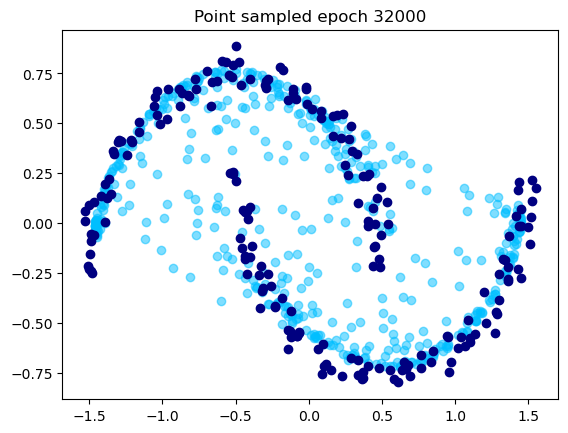

[32050/40000] 	Loss: 0.0000
[32100/40000] 	Loss: 0.0000
[32150/40000] 	Loss: 0.0000
[32200/40000] 	Loss: 0.0000
[32250/40000] 	Loss: 0.0000
[32300/40000] 	Loss: 0.0000
[32350/40000] 	Loss: 0.0000
[32400/40000] 	Loss: 0.0000
[32450/40000] 	Loss: 0.0000
[32500/40000] 	Loss: 0.0000
[32550/40000] 	Loss: 0.0000
[32600/40000] 	Loss: 0.0000
[32650/40000] 	Loss: 0.0000
[32700/40000] 	Loss: 0.0000
[32750/40000] 	Loss: 0.0000
[32800/40000] 	Loss: 0.0000
[32850/40000] 	Loss: 0.0000
[32900/40000] 	Loss: 0.0000
[32950/40000] 	Loss: 0.0000
[33000/40000] 	Loss: 0.0000


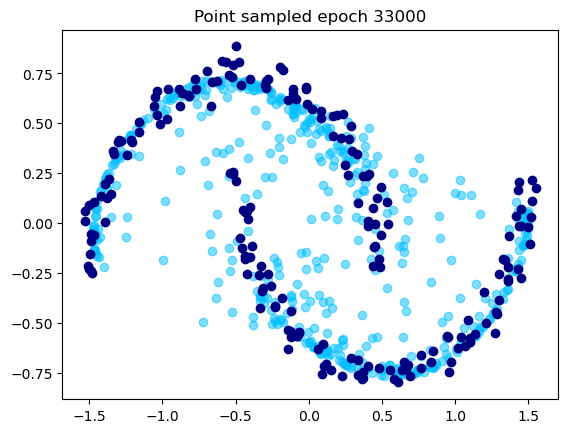

[33050/40000] 	Loss: 0.0000
[33100/40000] 	Loss: 0.0000
[33150/40000] 	Loss: 0.0000
[33200/40000] 	Loss: 0.0000
[33250/40000] 	Loss: 0.0000
[33300/40000] 	Loss: 0.0000
[33350/40000] 	Loss: 0.0000
[33400/40000] 	Loss: 0.0000
[33450/40000] 	Loss: 0.0000
[33500/40000] 	Loss: 0.0000
[33550/40000] 	Loss: 0.0000
[33600/40000] 	Loss: 0.0000
[33650/40000] 	Loss: 0.0000
[33700/40000] 	Loss: 0.0000
[33750/40000] 	Loss: 0.0000
[33800/40000] 	Loss: 0.0000
[33850/40000] 	Loss: 0.0000
[33900/40000] 	Loss: 0.0000
[33950/40000] 	Loss: 0.0000
[34000/40000] 	Loss: 0.0000


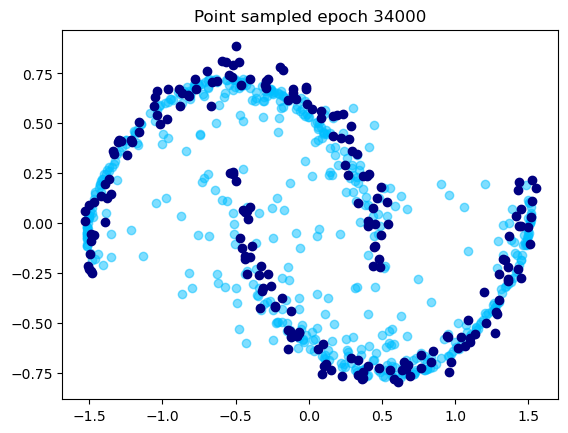

[34050/40000] 	Loss: 0.0000
[34100/40000] 	Loss: 0.0000
[34150/40000] 	Loss: 0.0000
[34200/40000] 	Loss: 0.0000
[34250/40000] 	Loss: 0.0000
[34300/40000] 	Loss: 0.0000
[34350/40000] 	Loss: 0.0000
[34400/40000] 	Loss: 0.0000
[34450/40000] 	Loss: 0.0000
[34500/40000] 	Loss: 0.0000
[34550/40000] 	Loss: 0.0000
[34600/40000] 	Loss: 0.0000
[34650/40000] 	Loss: 0.0000
[34700/40000] 	Loss: 0.0000
[34750/40000] 	Loss: 0.0000
[34800/40000] 	Loss: 0.0000
[34850/40000] 	Loss: 0.0001
[34900/40000] 	Loss: 0.0000
[34950/40000] 	Loss: 0.0000
[35000/40000] 	Loss: 0.0000


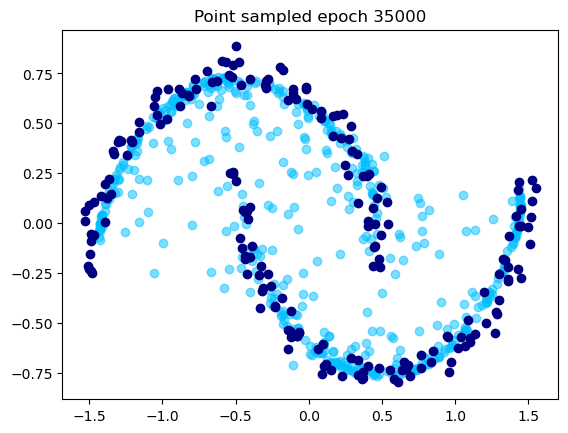

[35050/40000] 	Loss: 0.0000
[35100/40000] 	Loss: 0.0000
[35150/40000] 	Loss: 0.0000
[35200/40000] 	Loss: 0.0000
[35250/40000] 	Loss: 0.0000
[35300/40000] 	Loss: 0.0000
[35350/40000] 	Loss: 0.0000
[35400/40000] 	Loss: 0.0000
[35450/40000] 	Loss: 0.0000
[35500/40000] 	Loss: 0.0001
[35550/40000] 	Loss: 0.0000
[35600/40000] 	Loss: 0.0000
[35650/40000] 	Loss: 0.0000
[35700/40000] 	Loss: 0.0000
[35750/40000] 	Loss: 0.0000
[35800/40000] 	Loss: 0.0000
[35850/40000] 	Loss: 0.0000
[35900/40000] 	Loss: 0.0000
[35950/40000] 	Loss: 0.0000
[36000/40000] 	Loss: 0.0000


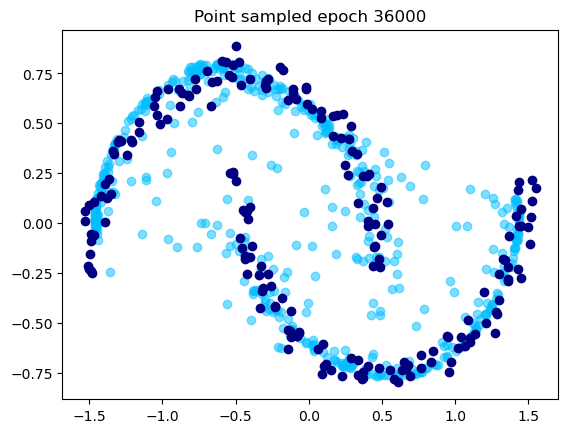

[36050/40000] 	Loss: 0.0000
[36100/40000] 	Loss: 0.0000
[36150/40000] 	Loss: 0.0000
[36200/40000] 	Loss: 0.0000
[36250/40000] 	Loss: 0.0000
[36300/40000] 	Loss: 0.0000
[36350/40000] 	Loss: 0.0000
[36400/40000] 	Loss: 0.0000
[36450/40000] 	Loss: 0.0000
[36500/40000] 	Loss: 0.0000
[36550/40000] 	Loss: 0.0000
[36600/40000] 	Loss: 0.0000
[36650/40000] 	Loss: 0.0000
[36700/40000] 	Loss: 0.0000
[36750/40000] 	Loss: 0.0000
[36800/40000] 	Loss: 0.0000
[36850/40000] 	Loss: 0.0000
[36900/40000] 	Loss: 0.0000
[36950/40000] 	Loss: 0.0000
[37000/40000] 	Loss: 0.0000


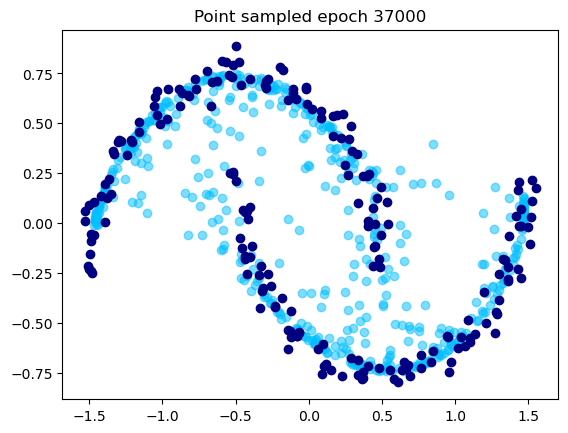

[37050/40000] 	Loss: 0.0000
[37100/40000] 	Loss: 0.0000
[37150/40000] 	Loss: 0.0000
[37200/40000] 	Loss: 0.0000
[37250/40000] 	Loss: 0.0000
[37300/40000] 	Loss: 0.0000
[37350/40000] 	Loss: 0.0000
[37400/40000] 	Loss: 0.0000
[37450/40000] 	Loss: 0.0000
[37500/40000] 	Loss: 0.0000
[37550/40000] 	Loss: 0.0000
[37600/40000] 	Loss: 0.0000
[37650/40000] 	Loss: 0.0000
[37700/40000] 	Loss: 0.0000
[37750/40000] 	Loss: 0.0000
[37800/40000] 	Loss: 0.0000
[37850/40000] 	Loss: 0.0000
[37900/40000] 	Loss: 0.0000
[37950/40000] 	Loss: 0.0000
[38000/40000] 	Loss: 0.0000


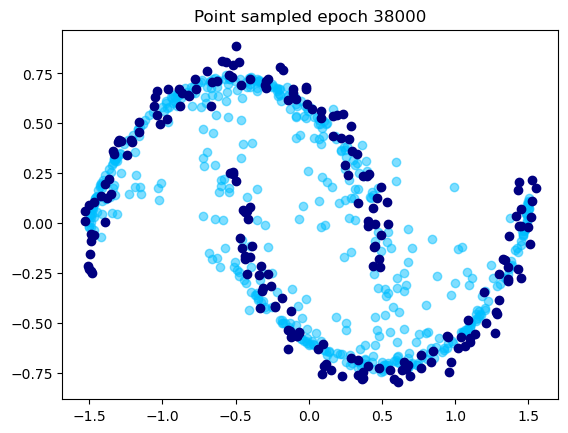

[38050/40000] 	Loss: 0.0000
[38100/40000] 	Loss: 0.0000
[38150/40000] 	Loss: 0.0000
[38200/40000] 	Loss: 0.0000
[38250/40000] 	Loss: 0.0000
[38300/40000] 	Loss: 0.0000
[38350/40000] 	Loss: 0.0000
[38400/40000] 	Loss: 0.0000
[38450/40000] 	Loss: 0.0000
[38500/40000] 	Loss: 0.0000
[38550/40000] 	Loss: 0.0000
[38600/40000] 	Loss: 0.0000
[38650/40000] 	Loss: 0.0000
[38700/40000] 	Loss: 0.0000
[38750/40000] 	Loss: 0.0000
[38800/40000] 	Loss: 0.0000
[38850/40000] 	Loss: 0.0000
[38900/40000] 	Loss: 0.0000
[38950/40000] 	Loss: 0.0000
[39000/40000] 	Loss: 0.0000


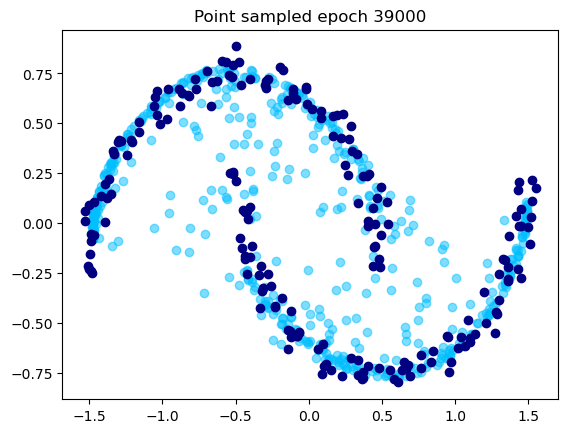

[39050/40000] 	Loss: 0.0000
[39100/40000] 	Loss: 0.0000
[39150/40000] 	Loss: 0.0000
[39200/40000] 	Loss: 0.0000
[39250/40000] 	Loss: 0.0000
[39300/40000] 	Loss: 0.0000
[39350/40000] 	Loss: 0.0000
[39400/40000] 	Loss: 0.0000
[39450/40000] 	Loss: 0.0000
[39500/40000] 	Loss: 0.0000
[39550/40000] 	Loss: 0.0000
[39600/40000] 	Loss: 0.0000
[39650/40000] 	Loss: 0.0000
[39700/40000] 	Loss: 0.0000
[39750/40000] 	Loss: 0.0000
[39800/40000] 	Loss: 0.0000
[39850/40000] 	Loss: 0.0000
[39900/40000] 	Loss: 0.0000
[39950/40000] 	Loss: 0.0000
[40000/40000] 	Loss: 0.0000


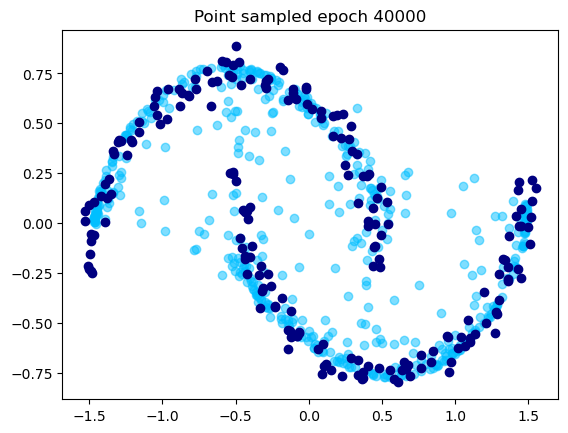

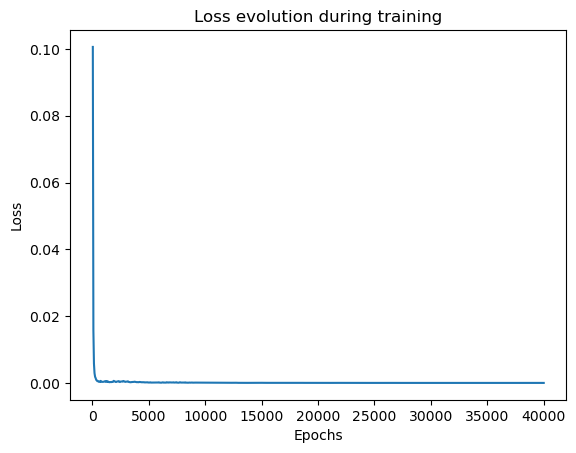

In [18]:
train_consistency(nepochs, lr, ema_decay,
                    n_samples_per_batch, nb_degradation_per_datapoint,
                    d_model, n_blocks, num_diffusion_timesteps, timespand,
                    epoch_log, epoch_display, nb_samples_display,
                    fig_savepath, model_savepath)

## T = 1000, N = 100

In [17]:
nepochs=10000
lr=1e-3
ema_decay=0.3
                    
n_samples_per_batch=128
nb_degradation_per_datapoint=1

d_model=128
n_blocks=5

num_diffusion_timesteps=100 # N
timespand=1000 # T

epoch_log=50
epoch_display=250
nb_samples_display=512

fig_savepath="./figures/CT_two_moons_T1000_N100"
model_savepath="./models/CT_two_moons_T1000_N100_epoch10000.pt"

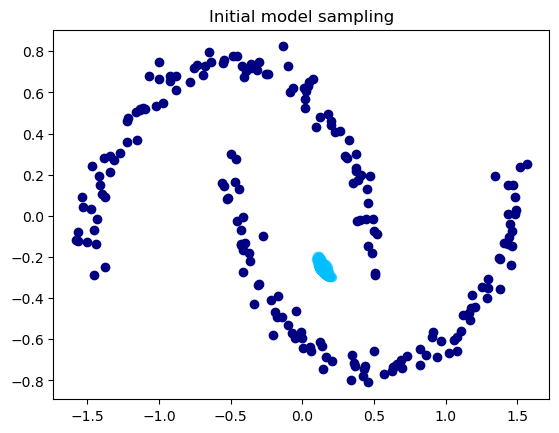

[50/10000] 	Loss: 0.0237
[100/10000] 	Loss: 0.0160
[150/10000] 	Loss: 0.0079
[200/10000] 	Loss: 0.0062
[250/10000] 	Loss: 0.0071


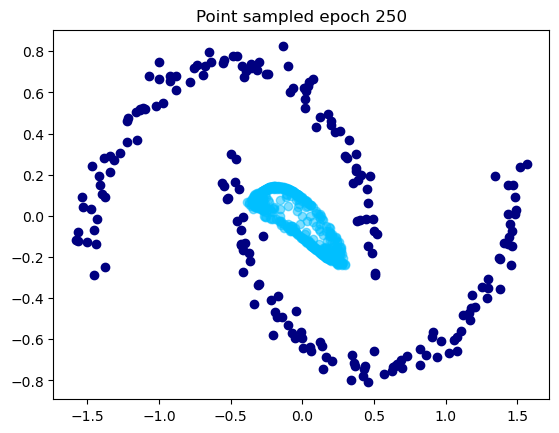

[300/10000] 	Loss: 0.0027
[350/10000] 	Loss: 0.0058
[400/10000] 	Loss: 0.0032
[450/10000] 	Loss: 0.0036
[500/10000] 	Loss: 0.0030


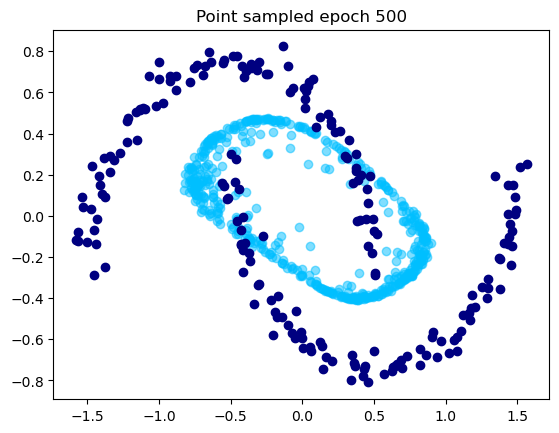

[550/10000] 	Loss: 0.0056
[600/10000] 	Loss: 0.0028
[650/10000] 	Loss: 0.0023
[700/10000] 	Loss: 0.0024
[750/10000] 	Loss: 0.0031


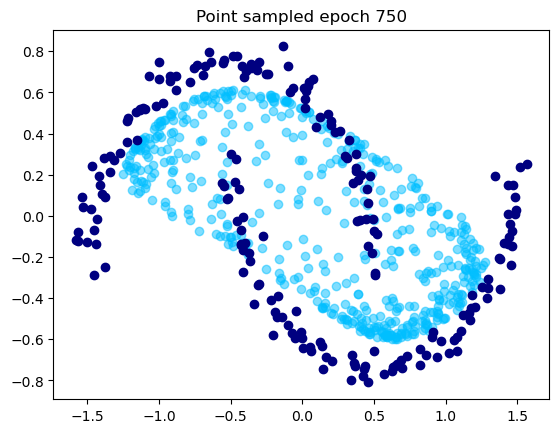

[800/10000] 	Loss: 0.0019
[850/10000] 	Loss: 0.0024
[900/10000] 	Loss: 0.0019
[950/10000] 	Loss: 0.0014
[1000/10000] 	Loss: 0.0017


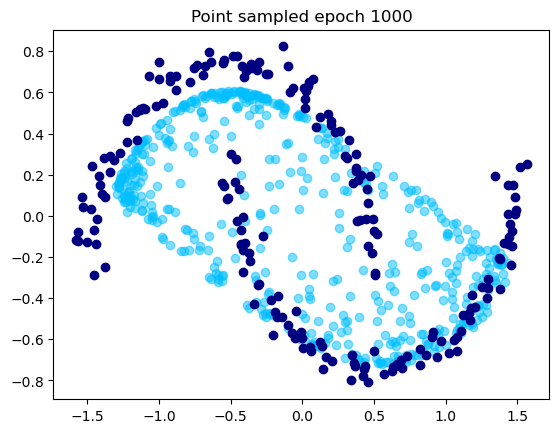

[1050/10000] 	Loss: 0.0012
[1100/10000] 	Loss: 0.0010
[1150/10000] 	Loss: 0.0014
[1200/10000] 	Loss: 0.0010
[1250/10000] 	Loss: 0.0009


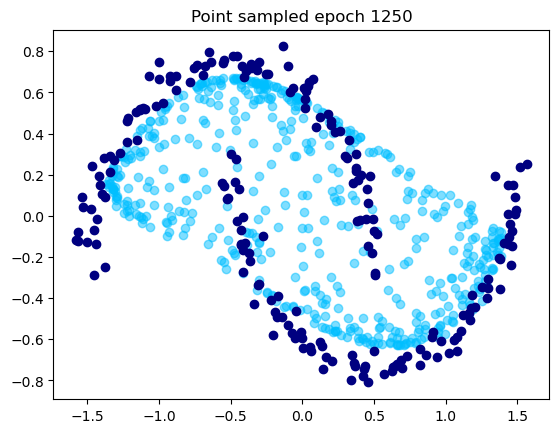

[1300/10000] 	Loss: 0.0011
[1350/10000] 	Loss: 0.0008
[1400/10000] 	Loss: 0.0009
[1450/10000] 	Loss: 0.0009
[1500/10000] 	Loss: 0.0008


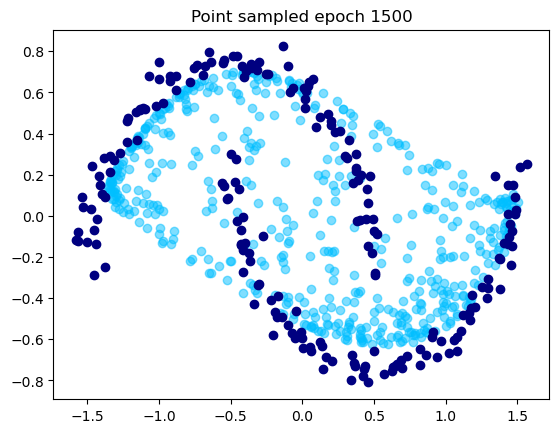

[1550/10000] 	Loss: 0.0010
[1600/10000] 	Loss: 0.0007
[1650/10000] 	Loss: 0.0006
[1700/10000] 	Loss: 0.0006
[1750/10000] 	Loss: 0.0007


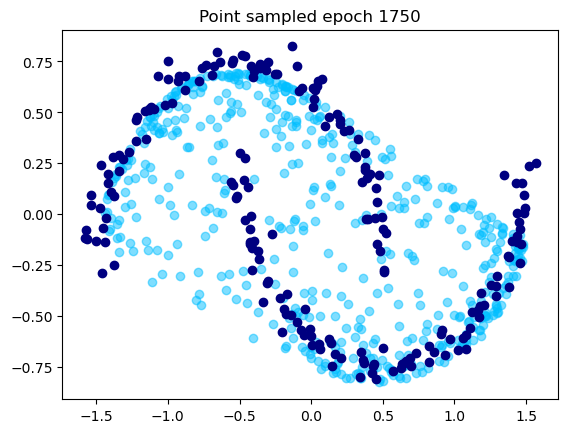

[1800/10000] 	Loss: 0.0006
[1850/10000] 	Loss: 0.0007
[1900/10000] 	Loss: 0.0007
[1950/10000] 	Loss: 0.0008
[2000/10000] 	Loss: 0.0007


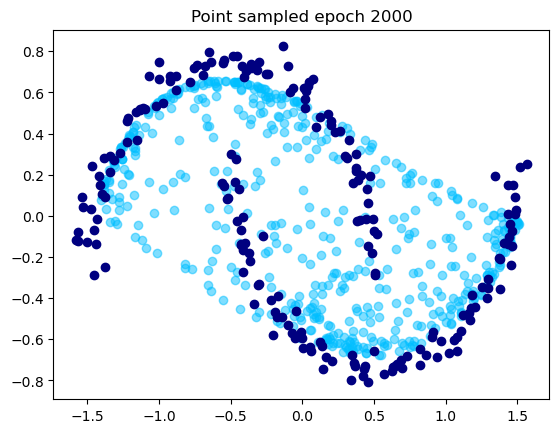

[2050/10000] 	Loss: 0.0007
[2100/10000] 	Loss: 0.0006
[2150/10000] 	Loss: 0.0007
[2200/10000] 	Loss: 0.0009
[2250/10000] 	Loss: 0.0008


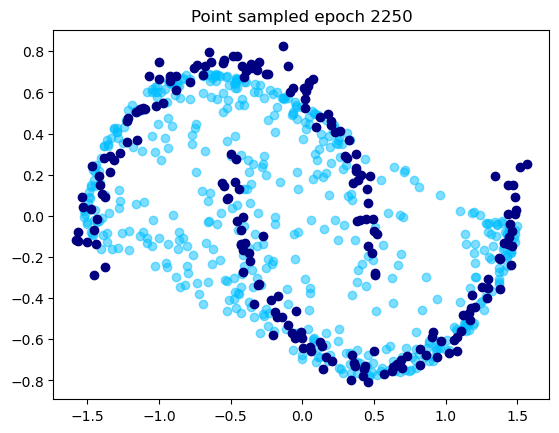

[2300/10000] 	Loss: 0.0005
[2350/10000] 	Loss: 0.0007
[2400/10000] 	Loss: 0.0006
[2450/10000] 	Loss: 0.0005
[2500/10000] 	Loss: 0.0007


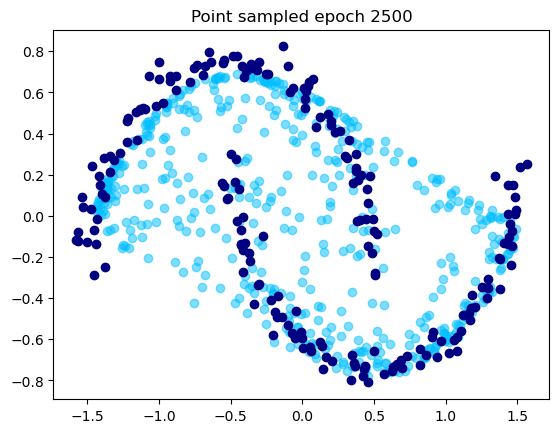

[2550/10000] 	Loss: 0.0005
[2600/10000] 	Loss: 0.0006
[2650/10000] 	Loss: 0.0007
[2700/10000] 	Loss: 0.0005
[2750/10000] 	Loss: 0.0007


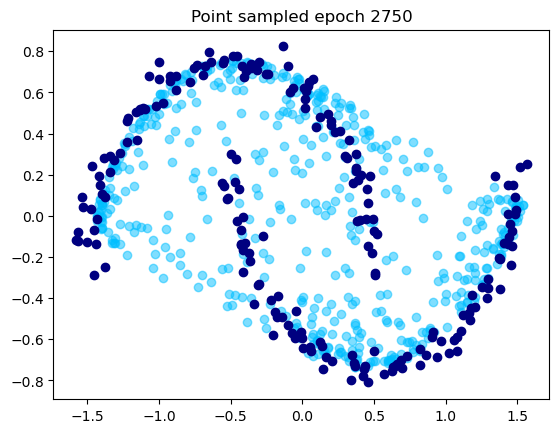

[2800/10000] 	Loss: 0.0005
[2850/10000] 	Loss: 0.0006
[2900/10000] 	Loss: 0.0007
[2950/10000] 	Loss: 0.0004
[3000/10000] 	Loss: 0.0004


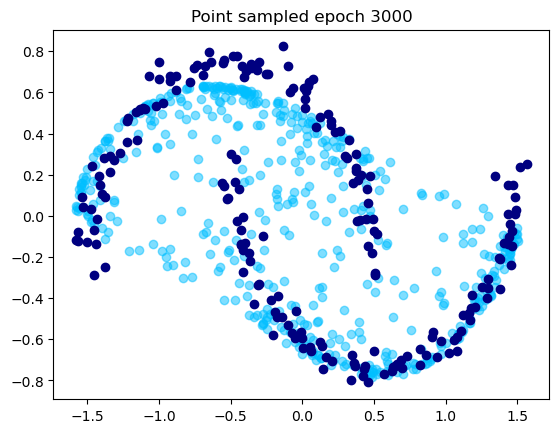

[3050/10000] 	Loss: 0.0006
[3100/10000] 	Loss: 0.0006
[3150/10000] 	Loss: 0.0006
[3200/10000] 	Loss: 0.0004
[3250/10000] 	Loss: 0.0006


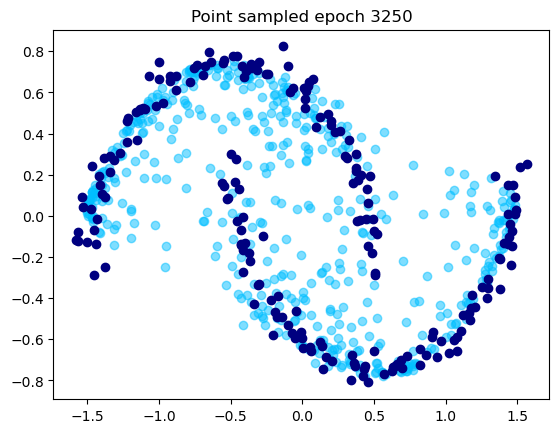

[3300/10000] 	Loss: 0.0007
[3350/10000] 	Loss: 0.0005
[3400/10000] 	Loss: 0.0005
[3450/10000] 	Loss: 0.0007
[3500/10000] 	Loss: 0.0006


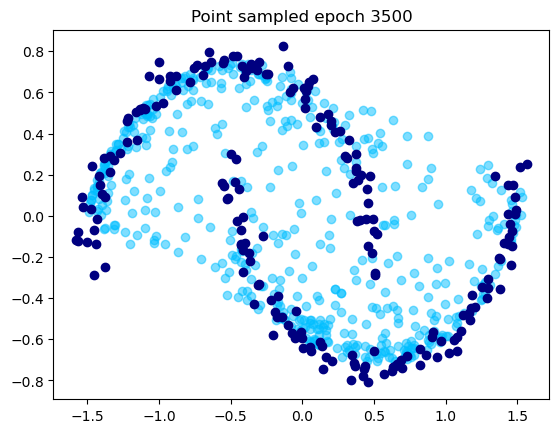

[3550/10000] 	Loss: 0.0005
[3600/10000] 	Loss: 0.0007
[3650/10000] 	Loss: 0.0005
[3700/10000] 	Loss: 0.0005
[3750/10000] 	Loss: 0.0004


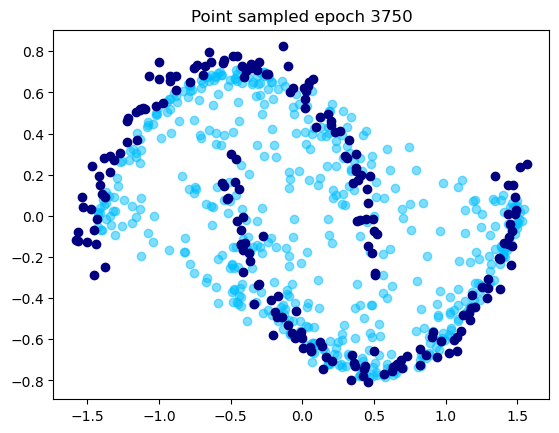

[3800/10000] 	Loss: 0.0010
[3850/10000] 	Loss: 0.0005
[3900/10000] 	Loss: 0.0003
[3950/10000] 	Loss: 0.0004
[4000/10000] 	Loss: 0.0005


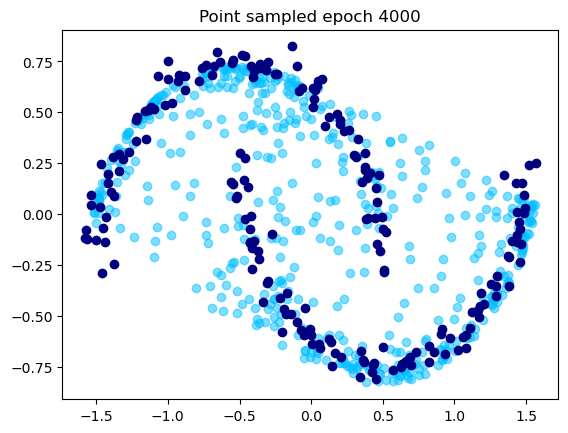

[4050/10000] 	Loss: 0.0004
[4100/10000] 	Loss: 0.0005
[4150/10000] 	Loss: 0.0004
[4200/10000] 	Loss: 0.0006
[4250/10000] 	Loss: 0.0005


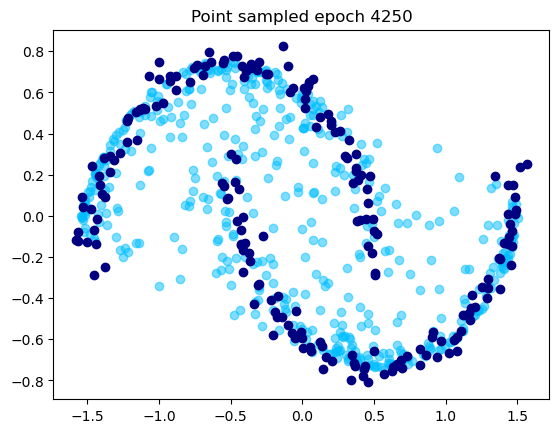

[4300/10000] 	Loss: 0.0005
[4350/10000] 	Loss: 0.0005
[4400/10000] 	Loss: 0.0006
[4450/10000] 	Loss: 0.0006
[4500/10000] 	Loss: 0.0007


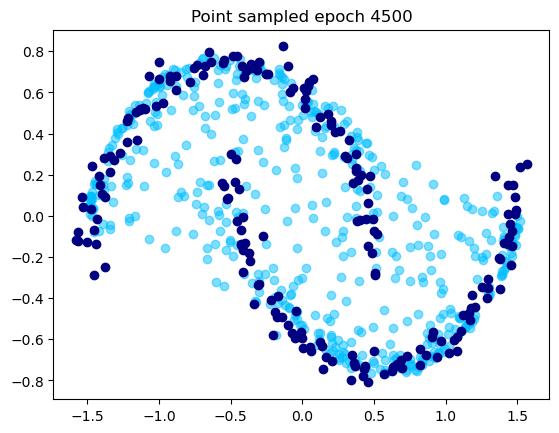

[4550/10000] 	Loss: 0.0004
[4600/10000] 	Loss: 0.0004
[4650/10000] 	Loss: 0.0006
[4700/10000] 	Loss: 0.0008
[4750/10000] 	Loss: 0.0005


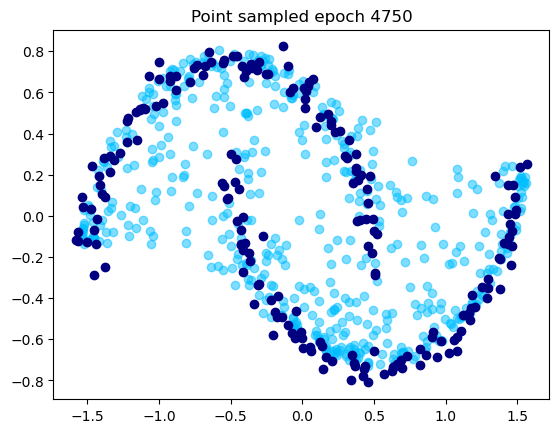

[4800/10000] 	Loss: 0.0005
[4850/10000] 	Loss: 0.0005
[4900/10000] 	Loss: 0.0006
[4950/10000] 	Loss: 0.0007
[5000/10000] 	Loss: 0.0003


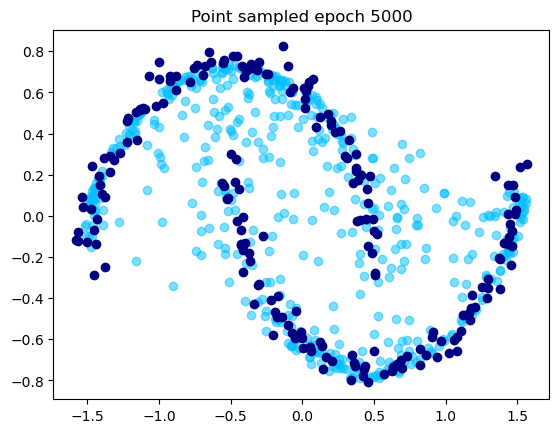

[5050/10000] 	Loss: 0.0005
[5100/10000] 	Loss: 0.0005
[5150/10000] 	Loss: 0.0005
[5200/10000] 	Loss: 0.0005
[5250/10000] 	Loss: 0.0004


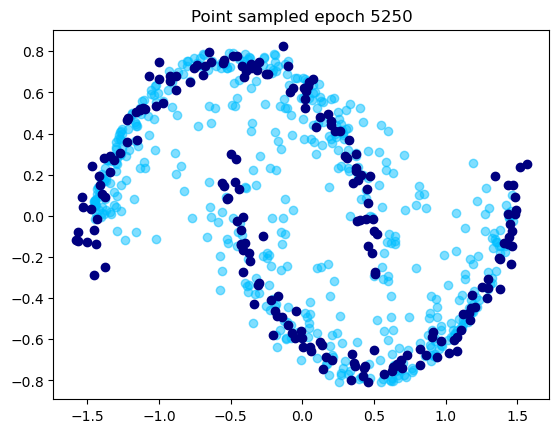

[5300/10000] 	Loss: 0.0005
[5350/10000] 	Loss: 0.0007
[5400/10000] 	Loss: 0.0006
[5450/10000] 	Loss: 0.0004
[5500/10000] 	Loss: 0.0005


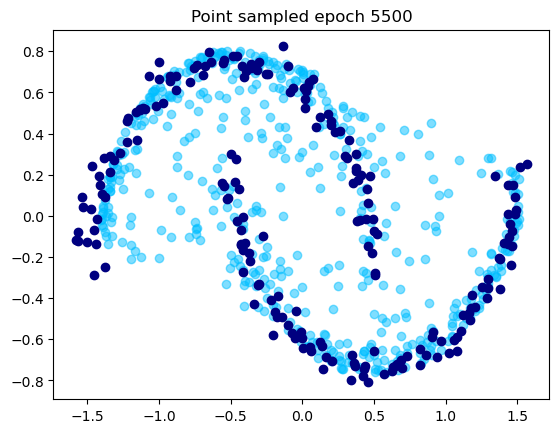

[5550/10000] 	Loss: 0.0005
[5600/10000] 	Loss: 0.0006
[5650/10000] 	Loss: 0.0005
[5700/10000] 	Loss: 0.0004
[5750/10000] 	Loss: 0.0004


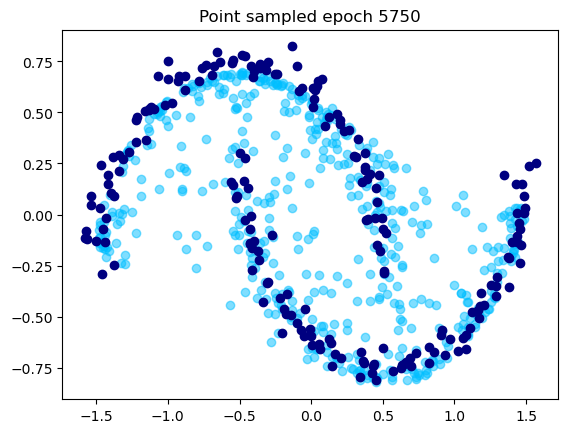

[5800/10000] 	Loss: 0.0004
[5850/10000] 	Loss: 0.0005
[5900/10000] 	Loss: 0.0004
[5950/10000] 	Loss: 0.0004
[6000/10000] 	Loss: 0.0007


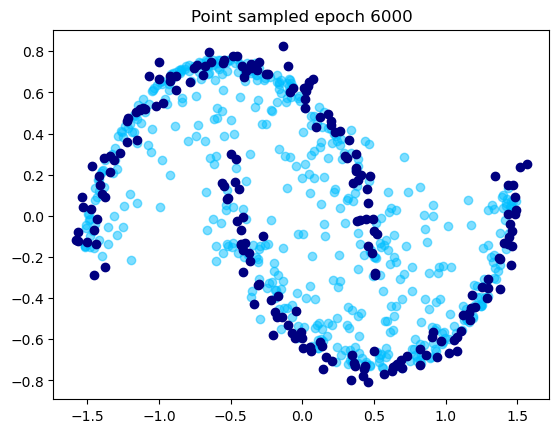

[6050/10000] 	Loss: 0.0005
[6100/10000] 	Loss: 0.0005
[6150/10000] 	Loss: 0.0004
[6200/10000] 	Loss: 0.0004
[6250/10000] 	Loss: 0.0004


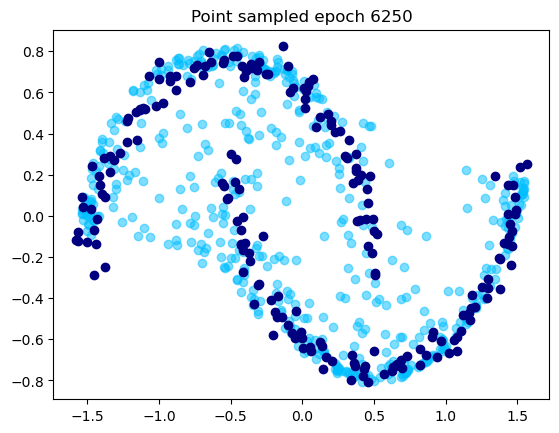

[6300/10000] 	Loss: 0.0005
[6350/10000] 	Loss: 0.0004
[6400/10000] 	Loss: 0.0003
[6450/10000] 	Loss: 0.0005
[6500/10000] 	Loss: 0.0004


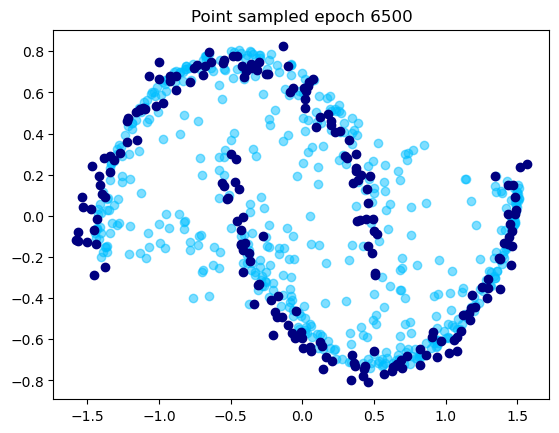

[6550/10000] 	Loss: 0.0003
[6600/10000] 	Loss: 0.0003
[6650/10000] 	Loss: 0.0004
[6700/10000] 	Loss: 0.0005
[6750/10000] 	Loss: 0.0004


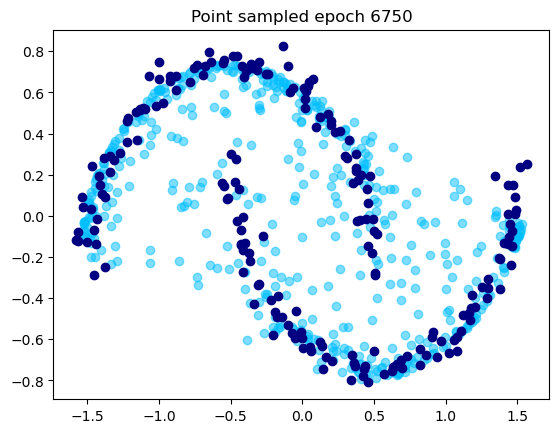

[6800/10000] 	Loss: 0.0006
[6850/10000] 	Loss: 0.0004
[6900/10000] 	Loss: 0.0004
[6950/10000] 	Loss: 0.0005
[7000/10000] 	Loss: 0.0004


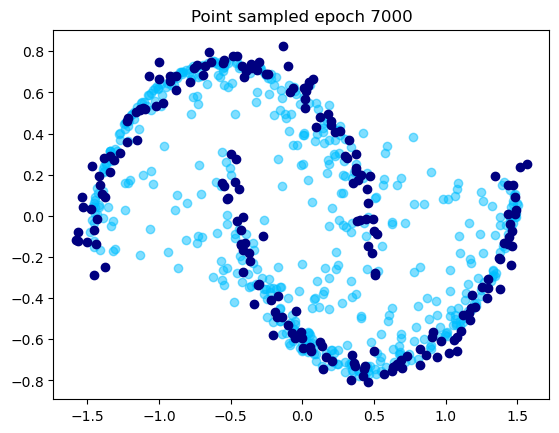

[7050/10000] 	Loss: 0.0007
[7100/10000] 	Loss: 0.0005
[7150/10000] 	Loss: 0.0005
[7200/10000] 	Loss: 0.0003
[7250/10000] 	Loss: 0.0005


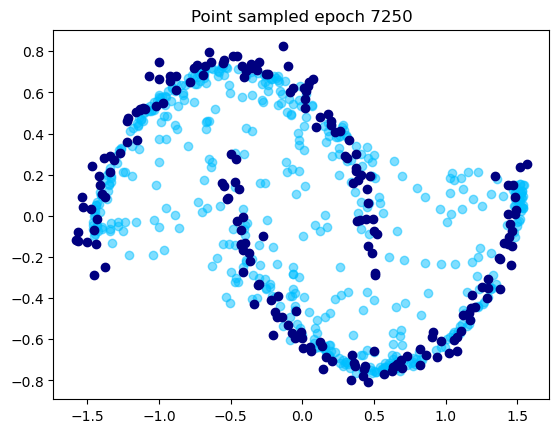

[7300/10000] 	Loss: 0.0004
[7350/10000] 	Loss: 0.0004
[7400/10000] 	Loss: 0.0005
[7450/10000] 	Loss: 0.0006
[7500/10000] 	Loss: 0.0004


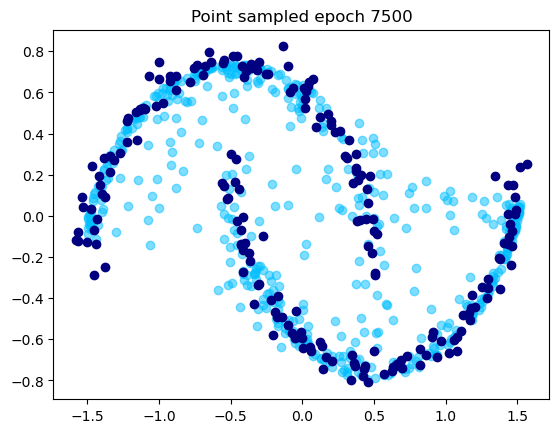

[7550/10000] 	Loss: 0.0006
[7600/10000] 	Loss: 0.0005
[7650/10000] 	Loss: 0.0006
[7700/10000] 	Loss: 0.0006
[7750/10000] 	Loss: 0.0004


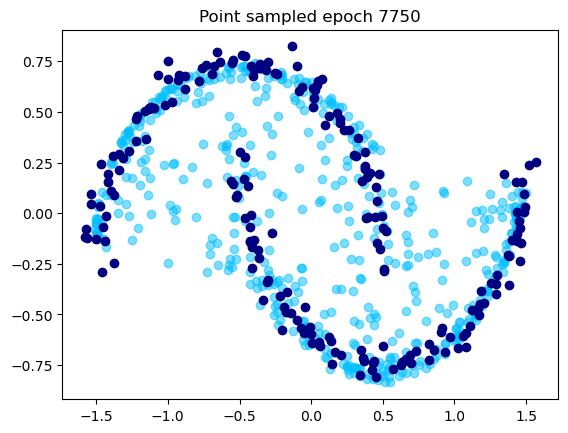

[7800/10000] 	Loss: 0.0002
[7850/10000] 	Loss: 0.0004
[7900/10000] 	Loss: 0.0004
[7950/10000] 	Loss: 0.0006
[8000/10000] 	Loss: 0.0003


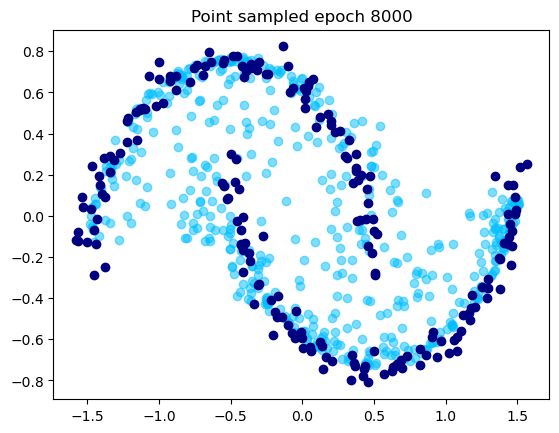

[8050/10000] 	Loss: 0.0007
[8100/10000] 	Loss: 0.0005
[8150/10000] 	Loss: 0.0004
[8200/10000] 	Loss: 0.0003
[8250/10000] 	Loss: 0.0004


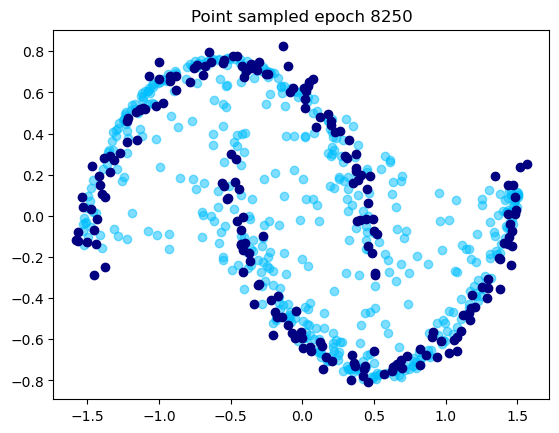

[8300/10000] 	Loss: 0.0004
[8350/10000] 	Loss: 0.0004
[8400/10000] 	Loss: 0.0003
[8450/10000] 	Loss: 0.0004
[8500/10000] 	Loss: 0.0004


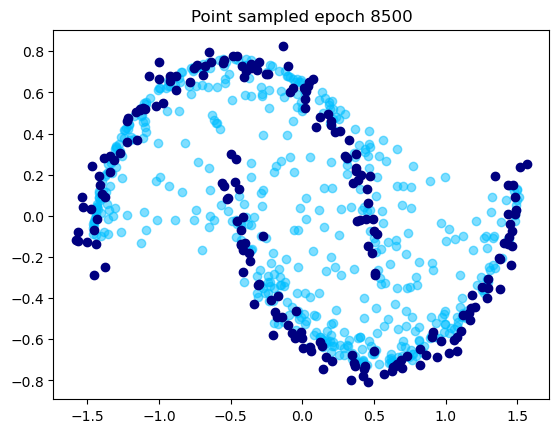

[8550/10000] 	Loss: 0.0004
[8600/10000] 	Loss: 0.0004
[8650/10000] 	Loss: 0.0004
[8700/10000] 	Loss: 0.0004
[8750/10000] 	Loss: 0.0004


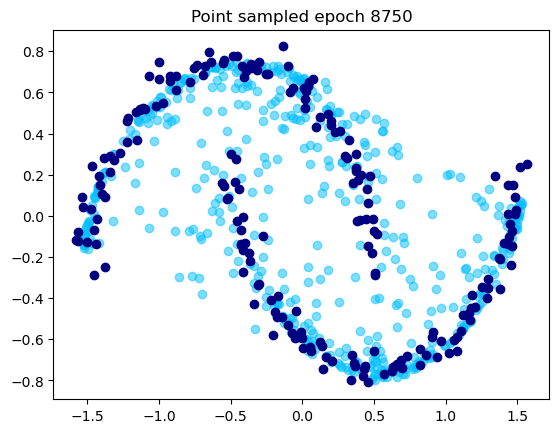

[8800/10000] 	Loss: 0.0003
[8850/10000] 	Loss: 0.0004
[8900/10000] 	Loss: 0.0004
[8950/10000] 	Loss: 0.0005
[9000/10000] 	Loss: 0.0005


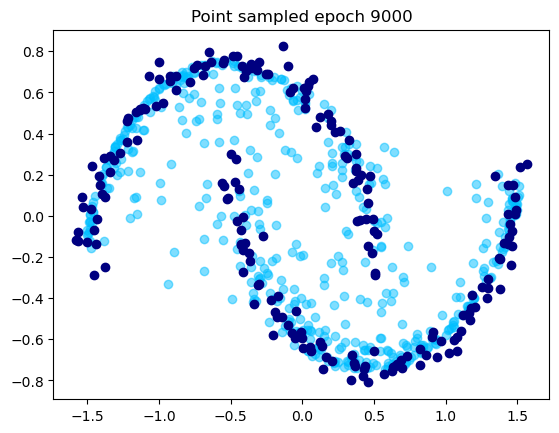

[9050/10000] 	Loss: 0.0005
[9100/10000] 	Loss: 0.0004
[9150/10000] 	Loss: 0.0007
[9200/10000] 	Loss: 0.0003
[9250/10000] 	Loss: 0.0005


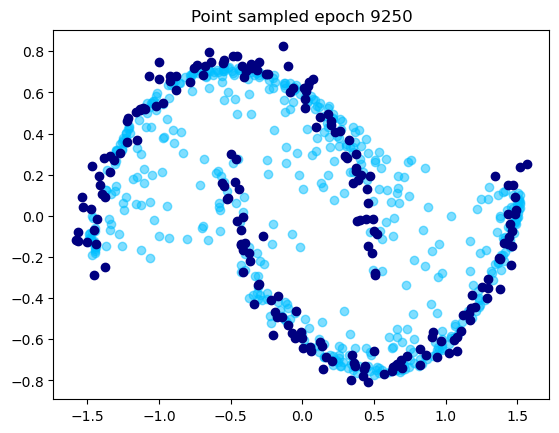

[9300/10000] 	Loss: 0.0003
[9350/10000] 	Loss: 0.0005
[9400/10000] 	Loss: 0.0004
[9450/10000] 	Loss: 0.0005
[9500/10000] 	Loss: 0.0005


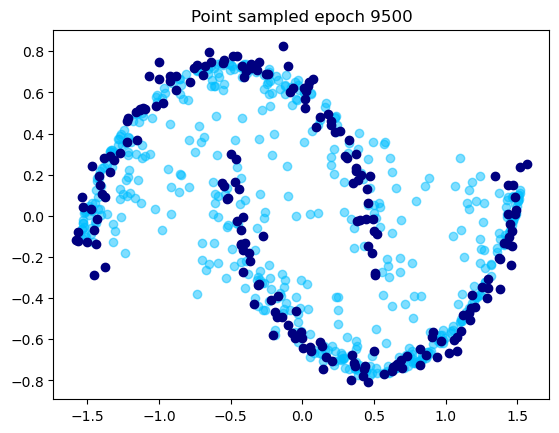

[9550/10000] 	Loss: 0.0004
[9600/10000] 	Loss: 0.0004
[9650/10000] 	Loss: 0.0003
[9700/10000] 	Loss: 0.0004
[9750/10000] 	Loss: 0.0006


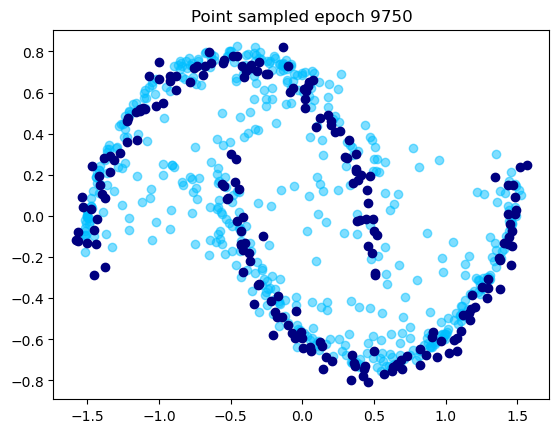

[9800/10000] 	Loss: 0.0003
[9850/10000] 	Loss: 0.0004
[9900/10000] 	Loss: 0.0005
[9950/10000] 	Loss: 0.0005
[10000/10000] 	Loss: 0.0004


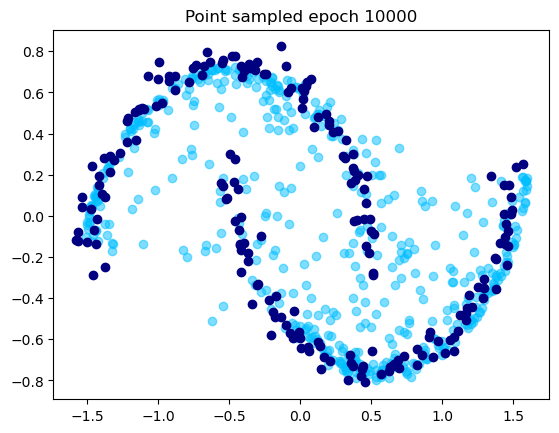

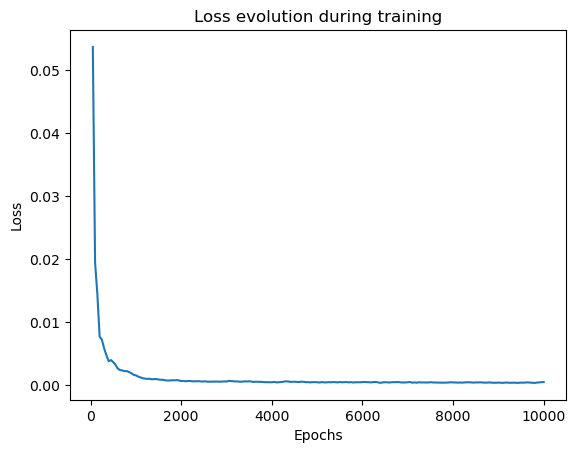

In [18]:
train_consistency(nepochs, lr, ema_decay,
                    n_samples_per_batch, nb_degradation_per_datapoint,
                    d_model, n_blocks, num_diffusion_timesteps, timespand,
                    epoch_log, epoch_display, nb_samples_display,
                    fig_savepath, model_savepath)

## T = 1000, N = 20

In [86]:
nepochs=4000
lr=1e-3
ema_decay=0.3
                    
n_samples_per_batch=128
nb_degradation_per_datapoint=1

d_model=128
n_blocks=5

num_diffusion_timesteps=20 # N
timespand=1000 # T

epoch_log=50
epoch_display=100
nb_samples_display=512

fig_savepath="./figures/CT_two_moons_T1000_N20"
model_savepath="./models/CT_two_moons_T1000_N20_epoch4000.pt"

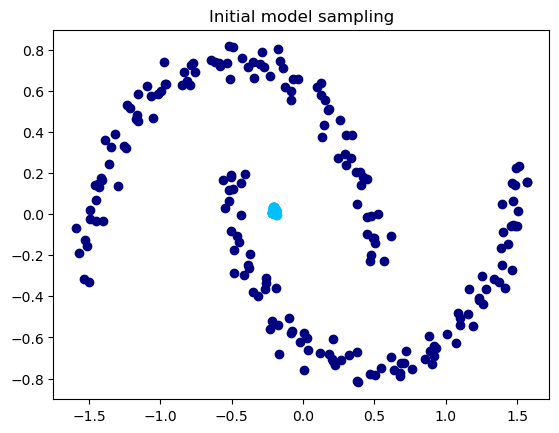

[50/4000] 	Loss: 0.0658
[100/4000] 	Loss: 0.0310


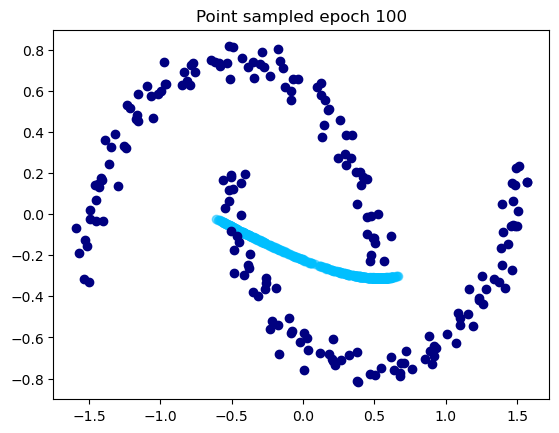

[150/4000] 	Loss: 0.0249
[200/4000] 	Loss: 0.0285


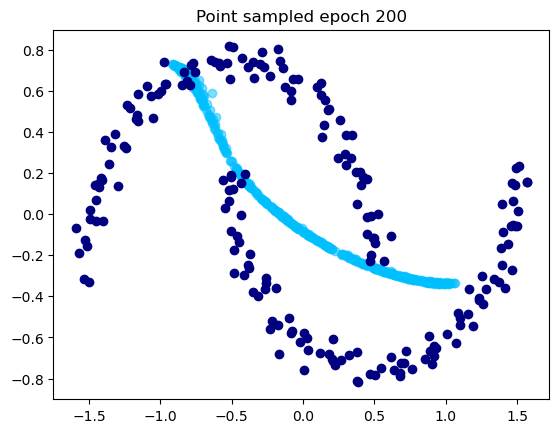

[250/4000] 	Loss: 0.0166
[300/4000] 	Loss: 0.0116


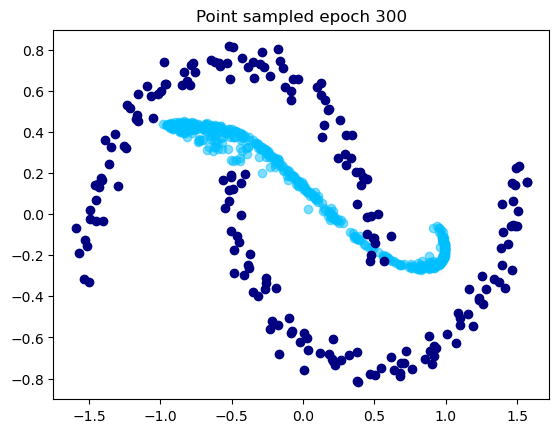

[350/4000] 	Loss: 0.0096
[400/4000] 	Loss: 0.0127


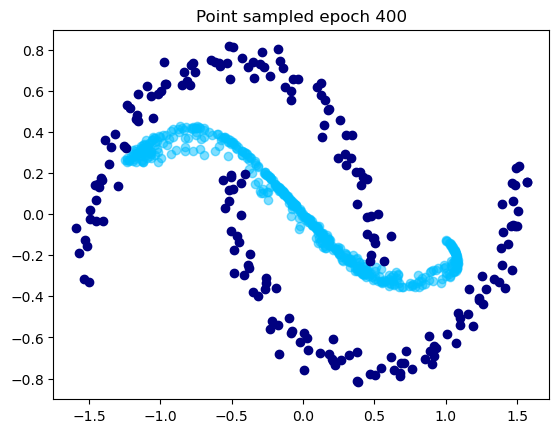

[450/4000] 	Loss: 0.0090
[500/4000] 	Loss: 0.0148


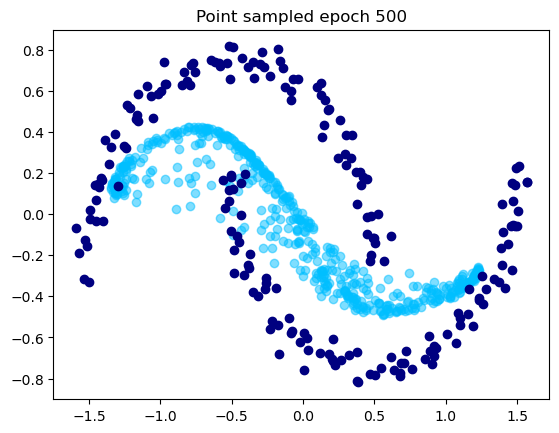

[550/4000] 	Loss: 0.0126
[600/4000] 	Loss: 0.0132


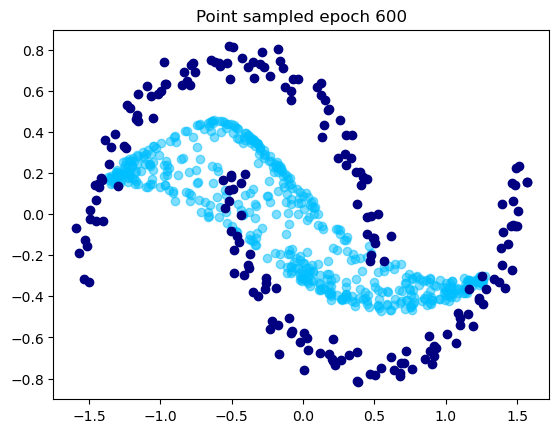

[650/4000] 	Loss: 0.0106
[700/4000] 	Loss: 0.0102


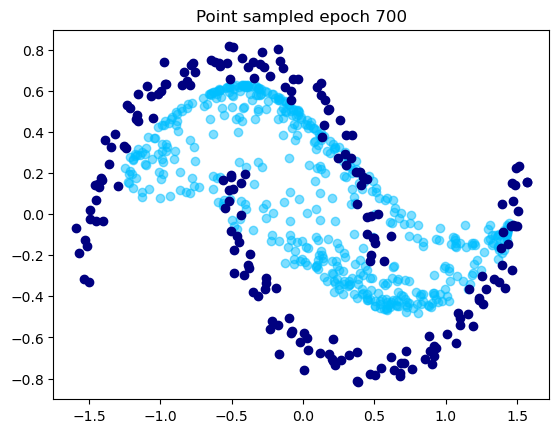

[750/4000] 	Loss: 0.0126
[800/4000] 	Loss: 0.0103


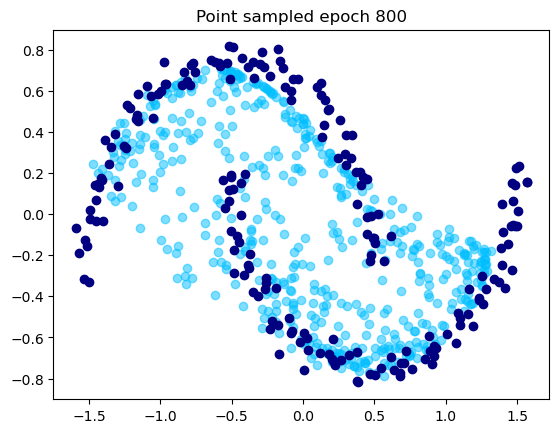

[850/4000] 	Loss: 0.0127
[900/4000] 	Loss: 0.0064


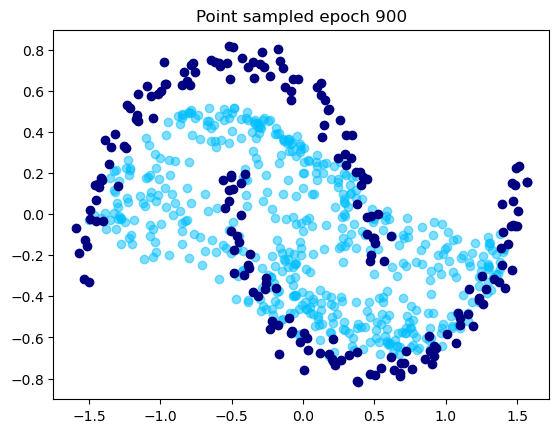

[950/4000] 	Loss: 0.0070
[1000/4000] 	Loss: 0.0102


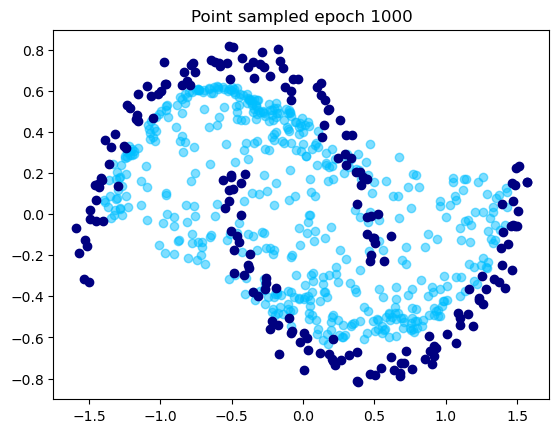

[1050/4000] 	Loss: 0.0108
[1100/4000] 	Loss: 0.0082


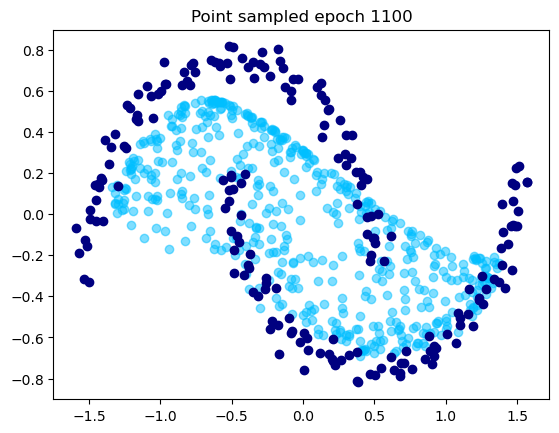

[1150/4000] 	Loss: 0.0077
[1200/4000] 	Loss: 0.0054


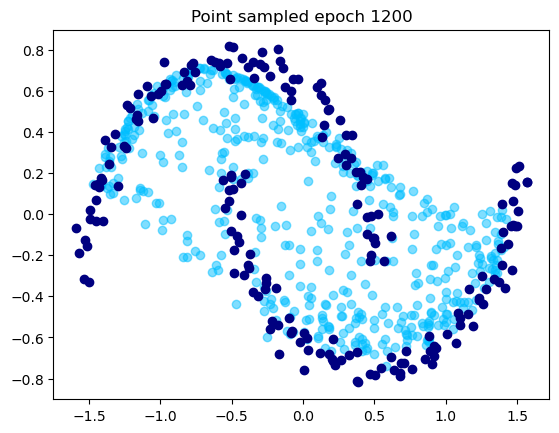

[1250/4000] 	Loss: 0.0072
[1300/4000] 	Loss: 0.0072


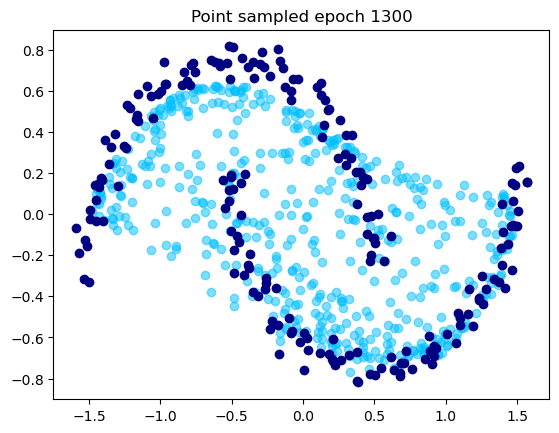

[1350/4000] 	Loss: 0.0090
[1400/4000] 	Loss: 0.0053


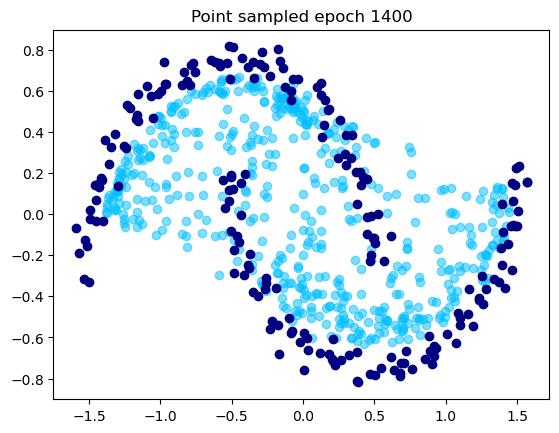

[1450/4000] 	Loss: 0.0055
[1500/4000] 	Loss: 0.0084


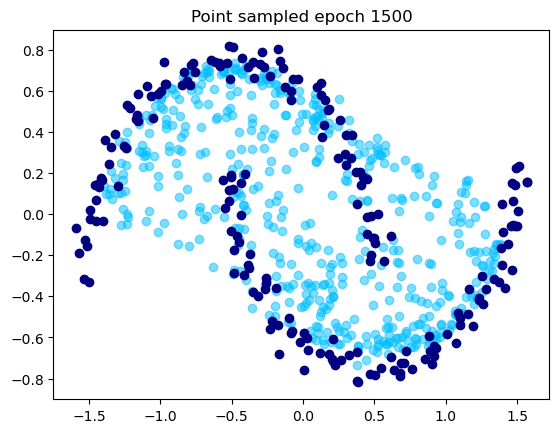

[1550/4000] 	Loss: 0.0068
[1600/4000] 	Loss: 0.0062


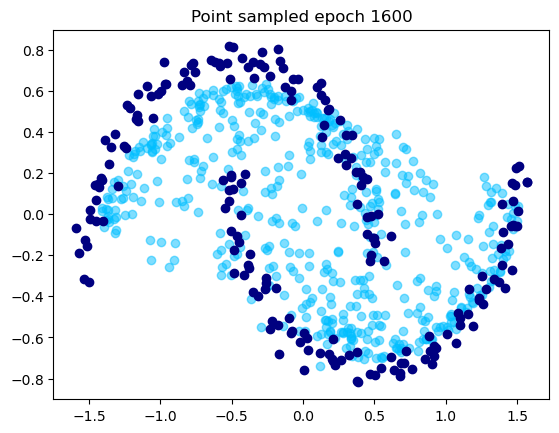

[1650/4000] 	Loss: 0.0082
[1700/4000] 	Loss: 0.0088


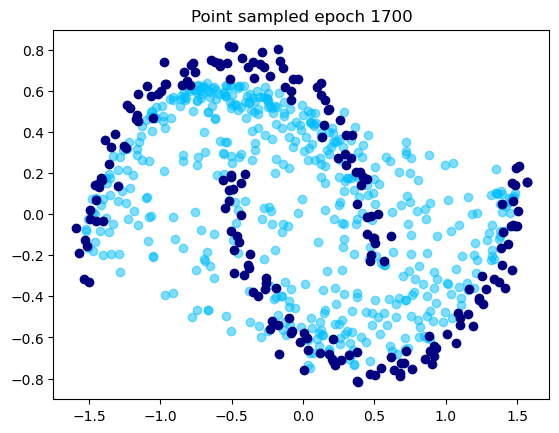

[1750/4000] 	Loss: 0.0051
[1800/4000] 	Loss: 0.0054


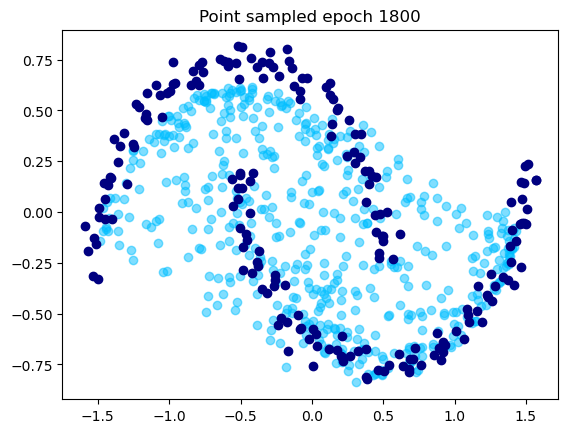

[1850/4000] 	Loss: 0.0054
[1900/4000] 	Loss: 0.0074


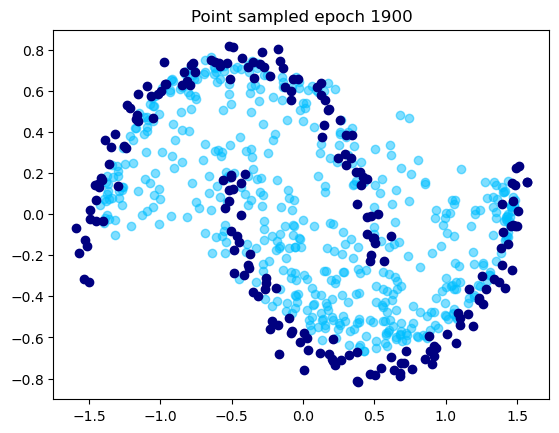

[1950/4000] 	Loss: 0.0058
[2000/4000] 	Loss: 0.0057


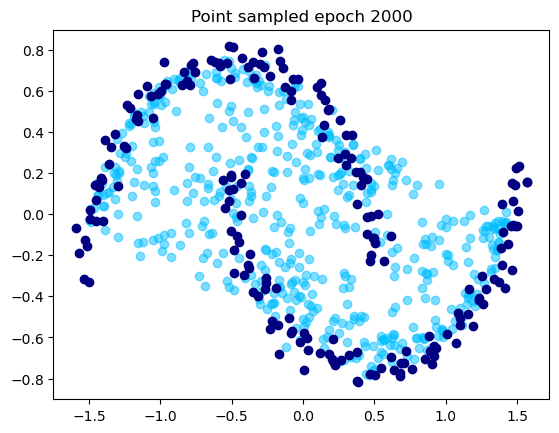

[2050/4000] 	Loss: 0.0071
[2100/4000] 	Loss: 0.0061


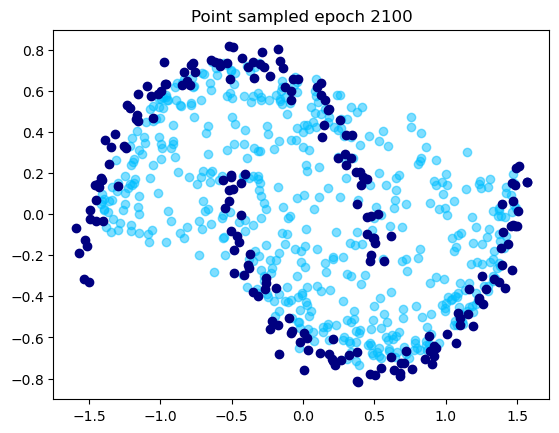

[2150/4000] 	Loss: 0.0064
[2200/4000] 	Loss: 0.0055


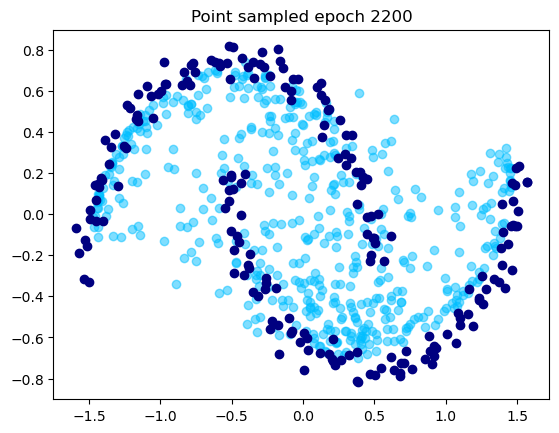

[2250/4000] 	Loss: 0.0134
[2300/4000] 	Loss: 0.0047


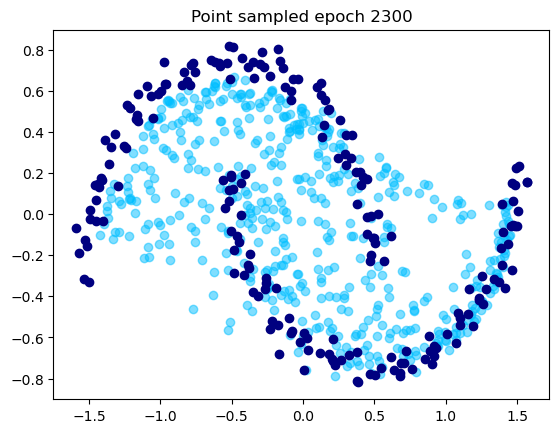

[2350/4000] 	Loss: 0.0078
[2400/4000] 	Loss: 0.0047


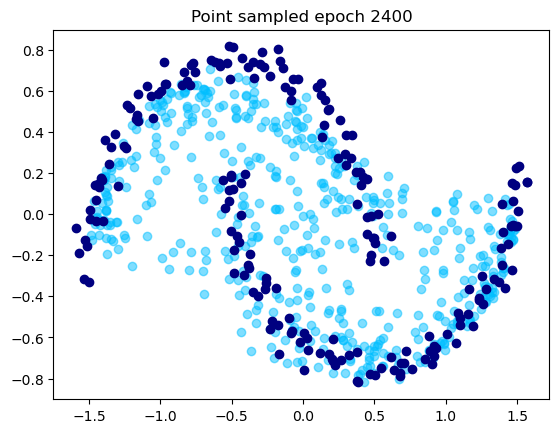

[2450/4000] 	Loss: 0.0059
[2500/4000] 	Loss: 0.0084


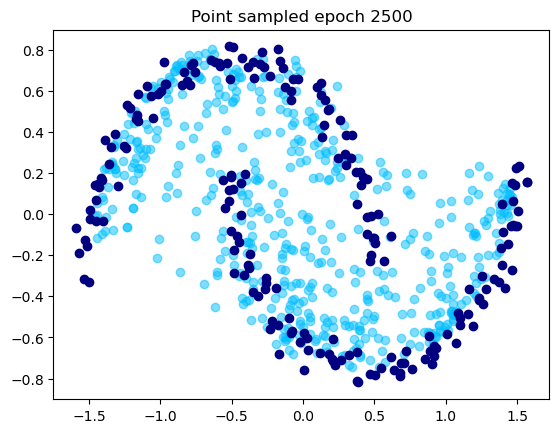

[2550/4000] 	Loss: 0.0058
[2600/4000] 	Loss: 0.0076


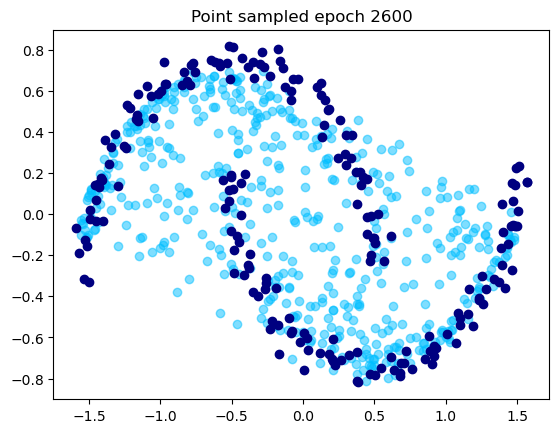

[2650/4000] 	Loss: 0.0045
[2700/4000] 	Loss: 0.0062


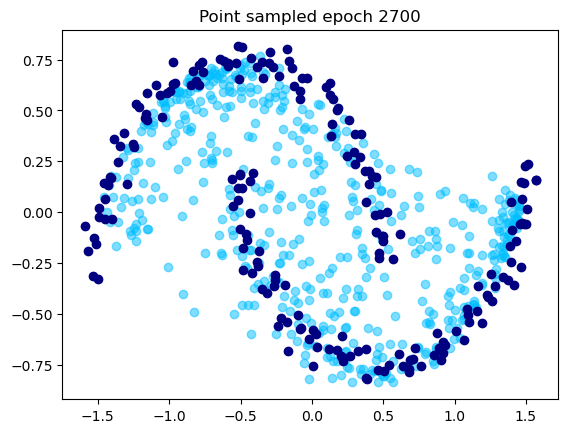

[2750/4000] 	Loss: 0.0073
[2800/4000] 	Loss: 0.0045


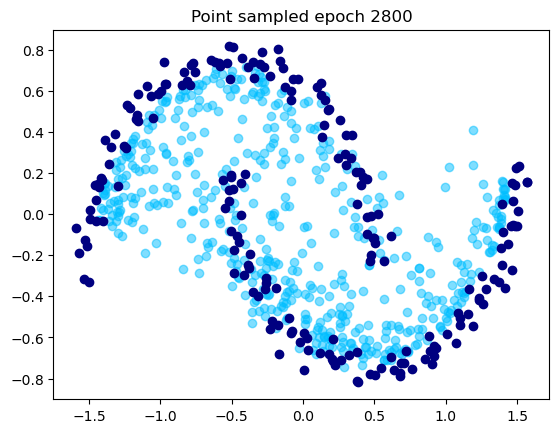

[2850/4000] 	Loss: 0.0082
[2900/4000] 	Loss: 0.0076


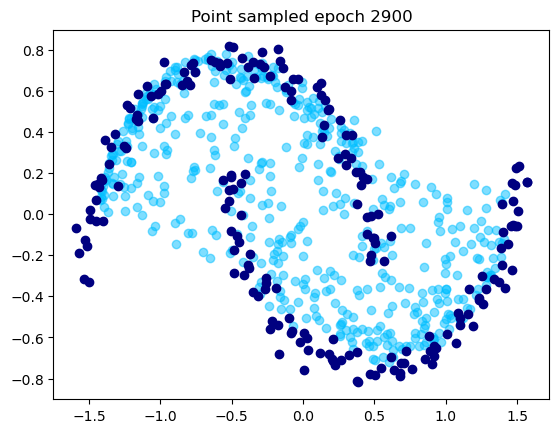

[2950/4000] 	Loss: 0.0049
[3000/4000] 	Loss: 0.0089


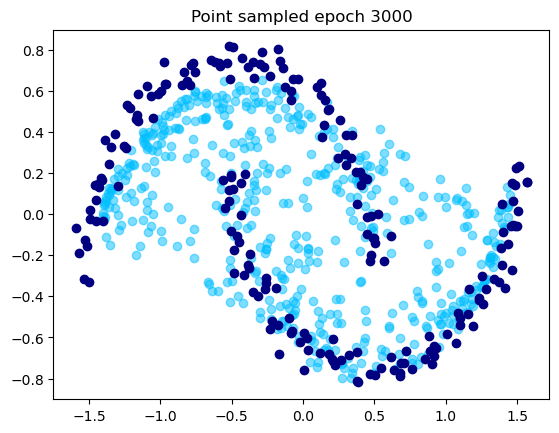

[3050/4000] 	Loss: 0.0054
[3100/4000] 	Loss: 0.0130


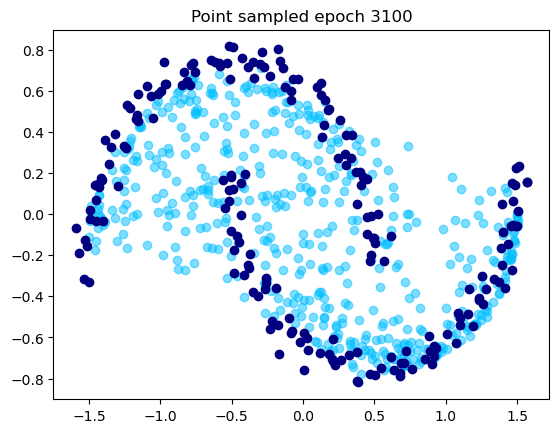

[3150/4000] 	Loss: 0.0072
[3200/4000] 	Loss: 0.0061


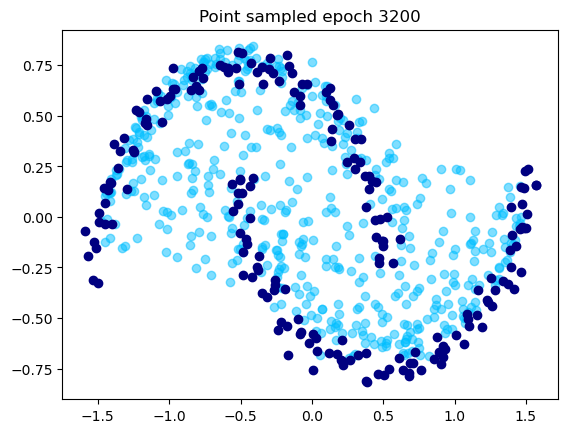

[3250/4000] 	Loss: 0.0050
[3300/4000] 	Loss: 0.0038


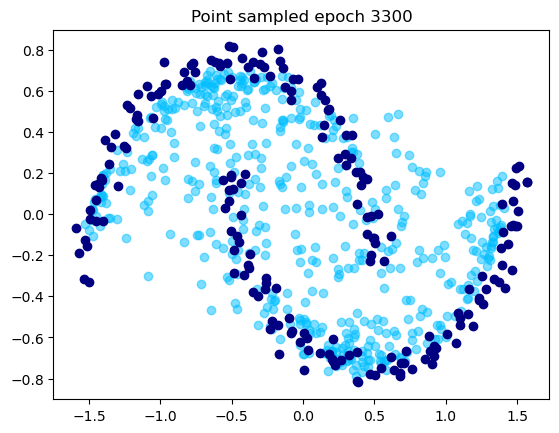

[3350/4000] 	Loss: 0.0054
[3400/4000] 	Loss: 0.0067


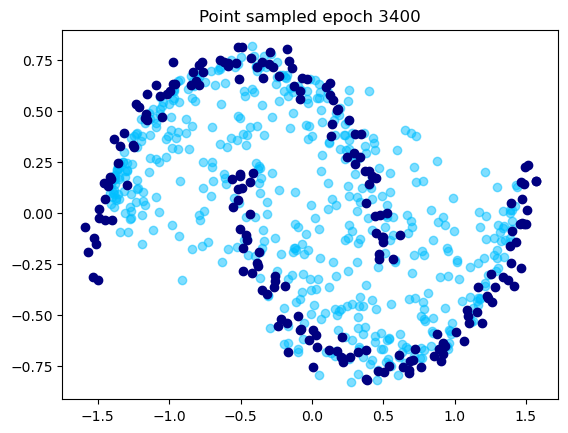

[3450/4000] 	Loss: 0.0028
[3500/4000] 	Loss: 0.0055


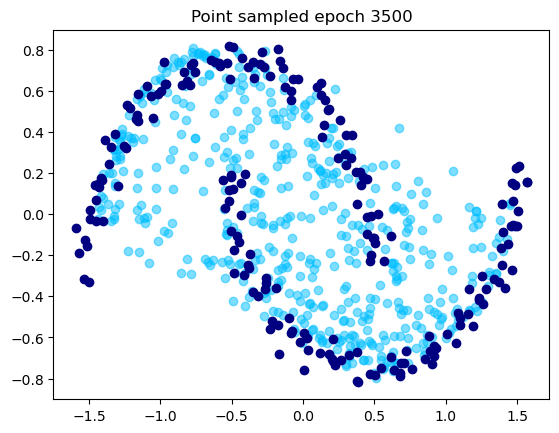

[3550/4000] 	Loss: 0.0054
[3600/4000] 	Loss: 0.0053


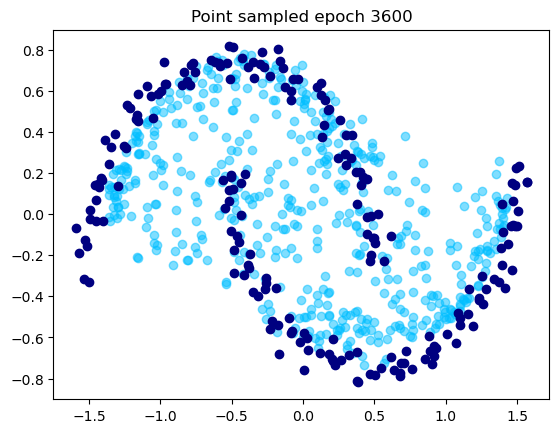

[3650/4000] 	Loss: 0.0049
[3700/4000] 	Loss: 0.0052


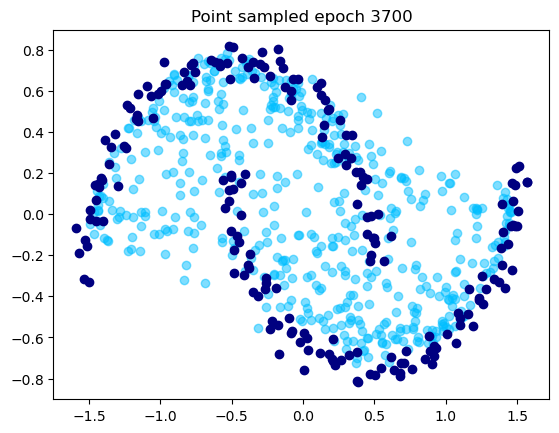

[3750/4000] 	Loss: 0.0051
[3800/4000] 	Loss: 0.0055


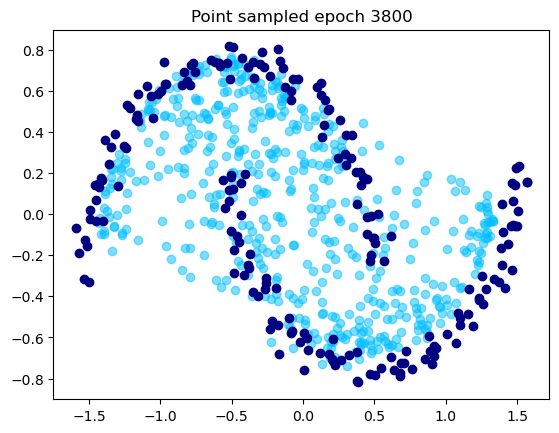

[3850/4000] 	Loss: 0.0051
[3900/4000] 	Loss: 0.0065


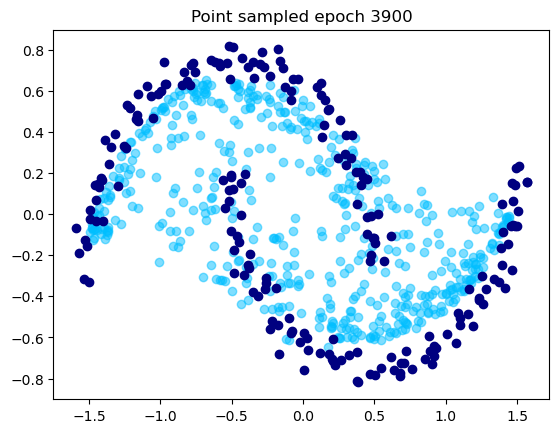

[3950/4000] 	Loss: 0.0070
[4000/4000] 	Loss: 0.0036


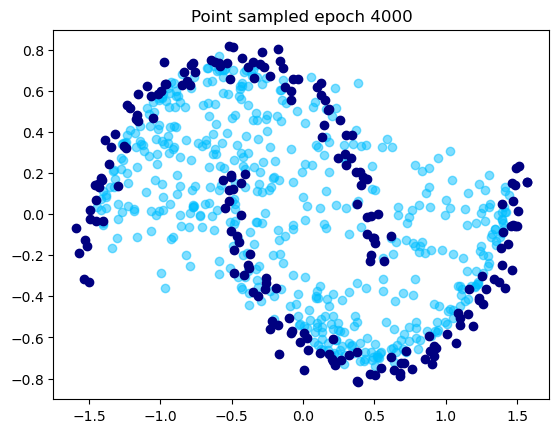

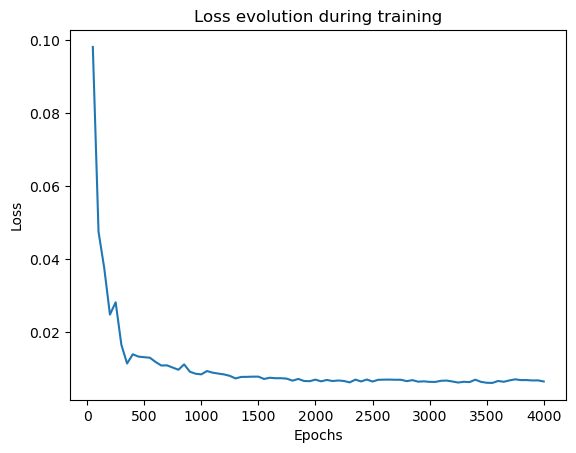

In [87]:
train_consistency(nepochs, lr, ema_decay,
                    n_samples_per_batch, nb_degradation_per_datapoint,
                    d_model, n_blocks, num_diffusion_timesteps, timespand,
                    epoch_log, epoch_display, nb_samples_display,
                    fig_savepath, model_savepath)

# Consistency distillation

In [ ]:
def distill_consistency(score_model_path = "",
                        nepochs=10000, lr=1e-3, ema_decay=0.3,
                        n_samples_per_batch=128, nb_degradation_per_datapoint=1,
                        d_model=128, n_blocks=5, num_diffusion_timesteps=1000, timespand=1000,
                        epoch_log=1, epoch_display=1, nb_samples_display=256,
                        fig_savepath = "", model_savepath=""):
    
    # Load pretrained diffusion model
    # Careful to match the size T=1000 for which the diffusion model was trained
    score_model = BasicDiscreteTimeModel(d_model = d_model,
                                        n_blocks = n_blocks,
                                        n_time_steps=timespand)
    ema_score_model = EMA(score_model, decay = 0.)
    optimizer_score_model = optim.AdamW(score_model.parameters(), lr=0.)
    load_checkpoint(score_model, ema_score_model, optimizer_score_model, score_model_path)

    # Instanciate consistency model
    consistency_model = ConsistencyDiscreteTimeModel(d_model=d_model, n_blocks=n_blocks, n_time_steps=num_diffusion_timesteps, total_time=timespand).to(device)
    # Initialize with pretrained diffusion model
    consistency_model.load_state_dict(score_model.state_dict())

    optimizer = optim.AdamW(consistency_model.parameters(), lr=lr)
    ema_consistency = EMA(consistency_model, decay = ema_decay)

    # Initial plot
    if not os.path.exists(fig_savepath):
        os.makedirs(fig_savepath)
    sample_and_plot(consistency_model, nb_samples_display,
                    title = "Initial model sampling",
                    savepath = f"{fig_savepath}/epoch0")
    
    # Train
    all_losses = {"epochs": [], "loss": []}
    losses = []
    consistency_model.train()
    ema_score_model.apply_shadow()
    score_model.eval()
    for epoch in range(1, 1+nepochs):
        optimizer.zero_grad()
        # Sample batch
        y = get_two_moons_centered(n_samples_per_batch)

        # Degrading image
        ## Degradation time t
        t_idx = torch.randint(1, consistency_model.num_diffusion_timesteps, (n_samples_per_batch, nb_degradation_per_datapoint))
        t_eq = consistency_model.map_tidx_to_teq(t_idx)
        x_t, _ = degrade_data_point(y, consistency_model.alphas_cumprod, t_eq)
        ## Degradation time t-1
        t_idxmoins1 = t_idx-1
        t_eqmoins1 = consistency_model.map_tidx_to_teq(t_idxmoins1)
        ## Predict noise with diffusion model
        with torch.no_grad():
            eps_to_remove = score_model(x_t, t_eq.view(-1))
        score = -1/(torch.sqrt(1-score_model.alphas_cumprod[t_eq])) * eps_to_remove
        ## One step on ODE flow (instead of several denoising steps)
        dt = consistency_model.total_time/consistency_model.num_diffusion_timesteps # Step length
        x_tmoins1 = x_t + 0.5*score_model.betas[t_eq]*x_t*dt +  0.5*score_model.betas[t_eq]*score*dt

        # Distillation process
        ## Student prediction (online)
        data_pred = consistency_model(x_t, t_flatten = t_eq.view(-1))
        ## Teacher prediction (target)
        ema_consistency.apply_shadow()
        consistency_model.eval()
        with torch.no_grad():
            data_pred_ema = consistency_model(x_tmoins1, t_flatten = t_eqmoins1.view(-1))
        ema_consistency.restore()
        consistency_model.train()

        # Loss ; lamba(t)=1
        loss = F.mse_loss(data_pred, data_pred_ema, reduction="mean")

        # Optimization
        loss.backward()
        nn.utils.clip_grad_norm_(consistency_model.parameters(), 1.0)
        optimizer.step() # Student update
        ema_consistency.update() # Teacher update
        losses.append(loss.cpu().detach().item())

        # Intermediary log
        if((epoch)%epoch_log == 0):
            print('[%d/%d] \tLoss: %.4f' % (epoch, nepochs, loss.item()))
            all_losses["epochs"].append(epoch)
            all_losses["loss"].append(sum(losses)/len(losses))
            losses = []
        
        # Intermediary plot
        if((epoch)%epoch_display == 0):
            ## Apply ema weights
            ema_consistency.apply_shadow()
            consistency_model.eval()
            ## Plot
            sample_and_plot(consistency_model, nb_samples_display,
                            title = f"Point sampled epoch {epoch}",
                            savepath = f"{fig_savepath}/{epoch}")
            ## Restore training weights
            ema_consistency.restore()
            consistency_model.train()

    plot_loss(all_losses, savepath = f"{fig_savepath}/losses")
    save_checkpoint(consistency_model, ema_consistency, optimizer, model_savepath)

## T=1000, N=1000

In [16]:
score_model_path = "./models/diffusion_two_moons_T1000_epoch10000.pt"

nepochs=20000
lr=1e-3
ema_decay=0.3

n_samples_per_batch=128
nb_degradation_per_datapoint=1

d_model=128
n_blocks=5
num_diffusion_timesteps=1000 # N
timespand=1000 # T

epoch_log=50
epoch_display=500
nb_samples_display=256

fig_savepath="./figures/CD_two_moons_T1000_N1000"
model_savepath="./models/CD_two_moons_T1000_N1000_epoch20000.pt"

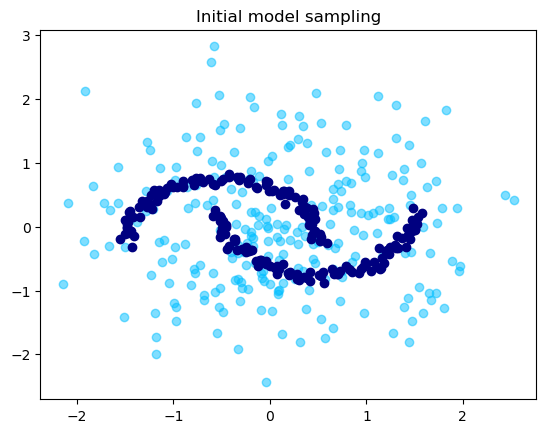

[50/20000] 	Loss: 0.0018
[100/20000] 	Loss: 0.0003
[150/20000] 	Loss: 0.0003
[200/20000] 	Loss: 0.0002
[250/20000] 	Loss: 0.0002
[300/20000] 	Loss: 0.0002
[350/20000] 	Loss: 0.0005
[400/20000] 	Loss: 0.0001
[450/20000] 	Loss: 0.0001
[500/20000] 	Loss: 0.0001


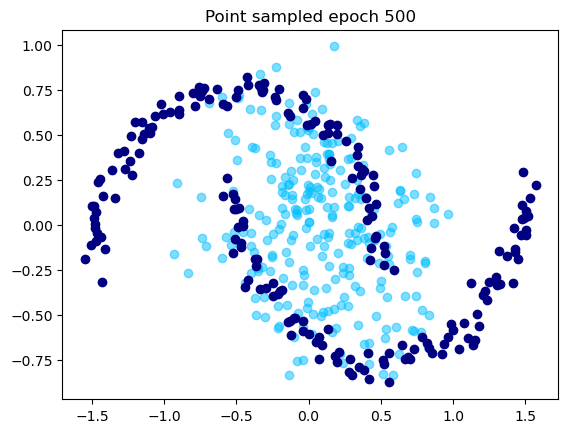

[550/20000] 	Loss: 0.0001
[600/20000] 	Loss: 0.0001
[650/20000] 	Loss: 0.0001
[700/20000] 	Loss: 0.0001
[750/20000] 	Loss: 0.0001
[800/20000] 	Loss: 0.0001
[850/20000] 	Loss: 0.0003
[900/20000] 	Loss: 0.0001
[950/20000] 	Loss: 0.0001
[1000/20000] 	Loss: 0.0001


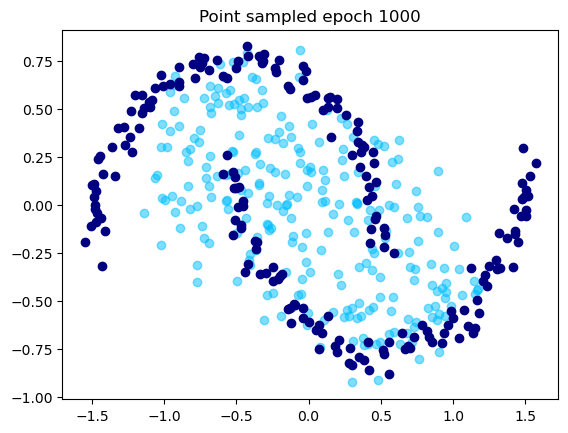

[1050/20000] 	Loss: 0.0001
[1100/20000] 	Loss: 0.0003
[1150/20000] 	Loss: 0.0001
[1200/20000] 	Loss: 0.0001
[1250/20000] 	Loss: 0.0001
[1300/20000] 	Loss: 0.0004
[1350/20000] 	Loss: 0.0001
[1400/20000] 	Loss: 0.0001
[1450/20000] 	Loss: 0.0001
[1500/20000] 	Loss: 0.0001


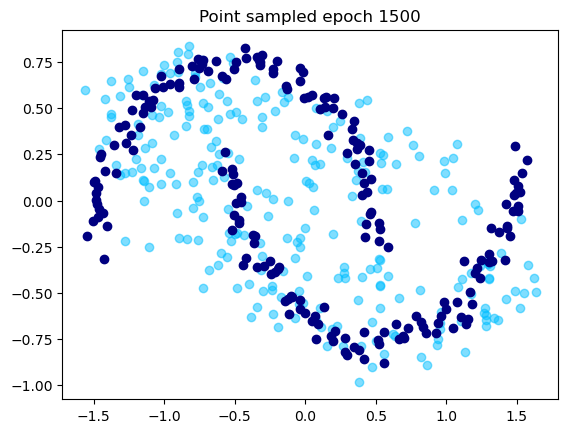

[1550/20000] 	Loss: 0.0001
[1600/20000] 	Loss: 0.0001
[1650/20000] 	Loss: 0.0001
[1700/20000] 	Loss: 0.0001
[1750/20000] 	Loss: 0.0001
[1800/20000] 	Loss: 0.0001
[1850/20000] 	Loss: 0.0001
[1900/20000] 	Loss: 0.0001
[1950/20000] 	Loss: 0.0001
[2000/20000] 	Loss: 0.0001


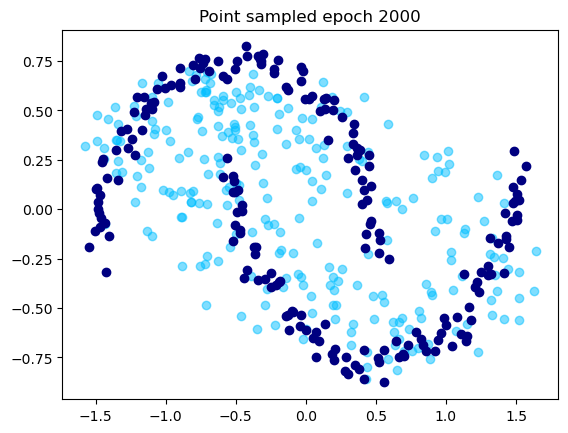

[2050/20000] 	Loss: 0.0001
[2100/20000] 	Loss: 0.0001
[2150/20000] 	Loss: 0.0001
[2200/20000] 	Loss: 0.0001
[2250/20000] 	Loss: 0.0001
[2300/20000] 	Loss: 0.0001
[2350/20000] 	Loss: 0.0001
[2400/20000] 	Loss: 0.0001
[2450/20000] 	Loss: 0.0000
[2500/20000] 	Loss: 0.0000


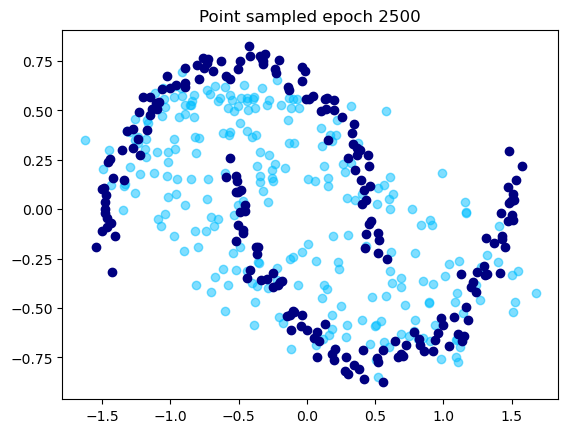

[2550/20000] 	Loss: 0.0000
[2600/20000] 	Loss: 0.0001
[2650/20000] 	Loss: 0.0000
[2700/20000] 	Loss: 0.0000
[2750/20000] 	Loss: 0.0000
[2800/20000] 	Loss: 0.0000
[2850/20000] 	Loss: 0.0000
[2900/20000] 	Loss: 0.0000
[2950/20000] 	Loss: 0.0000
[3000/20000] 	Loss: 0.0000


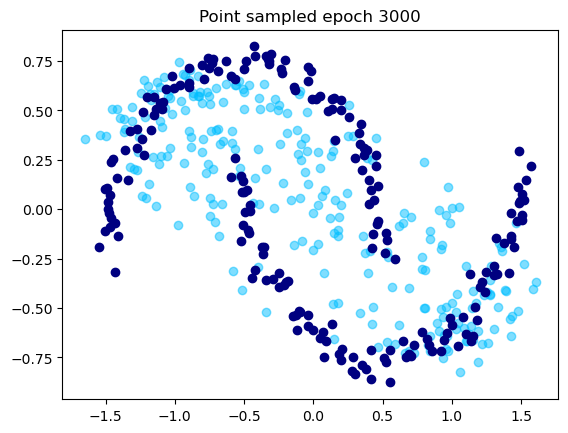

[3050/20000] 	Loss: 0.0000
[3100/20000] 	Loss: 0.0001
[3150/20000] 	Loss: 0.0000
[3200/20000] 	Loss: 0.0001
[3250/20000] 	Loss: 0.0000
[3300/20000] 	Loss: 0.0001
[3350/20000] 	Loss: 0.0000
[3400/20000] 	Loss: 0.0001
[3450/20000] 	Loss: 0.0000
[3500/20000] 	Loss: 0.0001


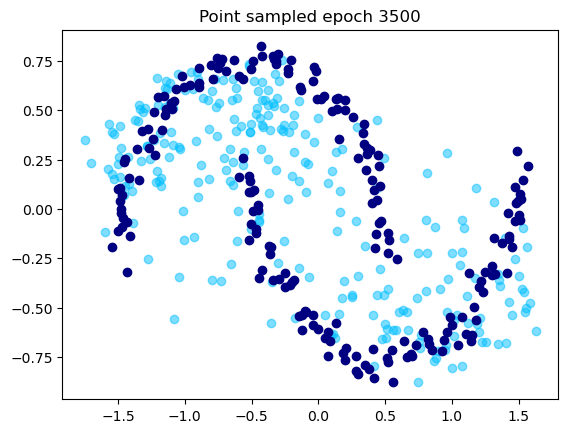

[3550/20000] 	Loss: 0.0000
[3600/20000] 	Loss: 0.0000
[3650/20000] 	Loss: 0.0001
[3700/20000] 	Loss: 0.0000
[3750/20000] 	Loss: 0.0000
[3800/20000] 	Loss: 0.0001
[3850/20000] 	Loss: 0.0001
[3900/20000] 	Loss: 0.0000
[3950/20000] 	Loss: 0.0000
[4000/20000] 	Loss: 0.0000


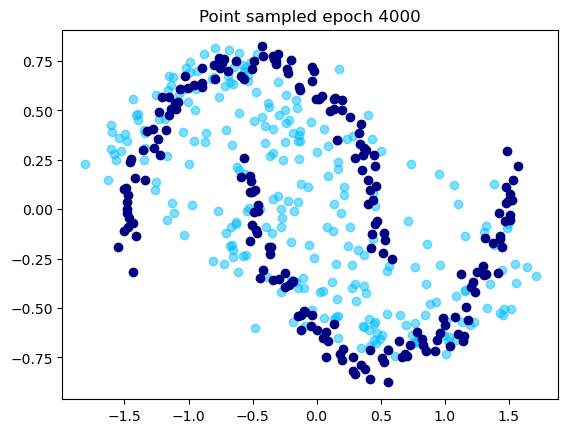

[4050/20000] 	Loss: 0.0000
[4100/20000] 	Loss: 0.0000
[4150/20000] 	Loss: 0.0001
[4200/20000] 	Loss: 0.0000
[4250/20000] 	Loss: 0.0000
[4300/20000] 	Loss: 0.0000
[4350/20000] 	Loss: 0.0000
[4400/20000] 	Loss: 0.0000
[4450/20000] 	Loss: 0.0000
[4500/20000] 	Loss: 0.0000


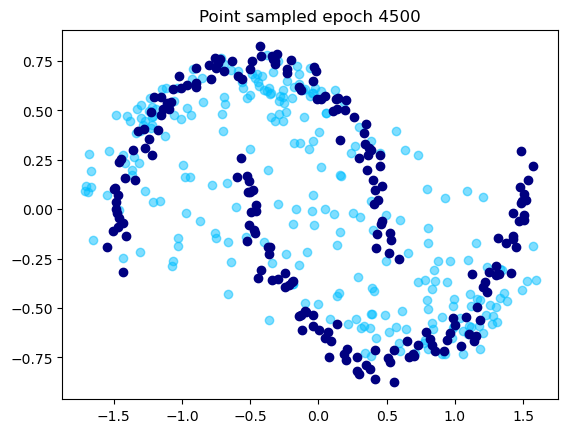

[4550/20000] 	Loss: 0.0000
[4600/20000] 	Loss: 0.0001
[4650/20000] 	Loss: 0.0000
[4700/20000] 	Loss: 0.0000
[4750/20000] 	Loss: 0.0001
[4800/20000] 	Loss: 0.0000
[4850/20000] 	Loss: 0.0000
[4900/20000] 	Loss: 0.0001
[4950/20000] 	Loss: 0.0000
[5000/20000] 	Loss: 0.0000


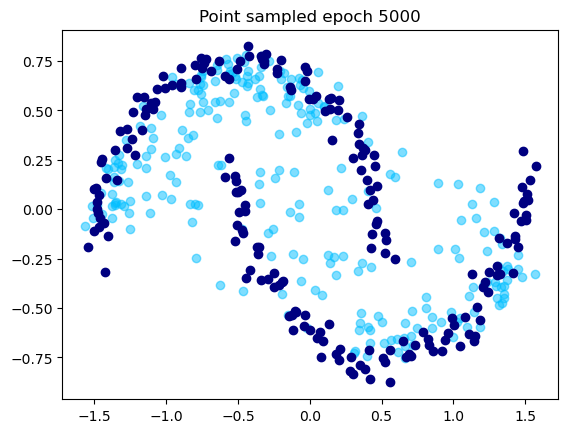

[5050/20000] 	Loss: 0.0000
[5100/20000] 	Loss: 0.0000
[5150/20000] 	Loss: 0.0000
[5200/20000] 	Loss: 0.0001
[5250/20000] 	Loss: 0.0000
[5300/20000] 	Loss: 0.0000
[5350/20000] 	Loss: 0.0000
[5400/20000] 	Loss: 0.0000
[5450/20000] 	Loss: 0.0000
[5500/20000] 	Loss: 0.0000


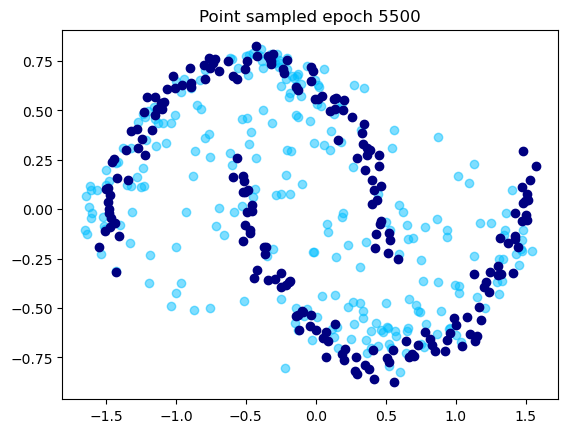

[5550/20000] 	Loss: 0.0001
[5600/20000] 	Loss: 0.0000
[5650/20000] 	Loss: 0.0000
[5700/20000] 	Loss: 0.0001
[5750/20000] 	Loss: 0.0000
[5800/20000] 	Loss: 0.0000
[5850/20000] 	Loss: 0.0000
[5900/20000] 	Loss: 0.0000
[5950/20000] 	Loss: 0.0001
[6000/20000] 	Loss: 0.0000


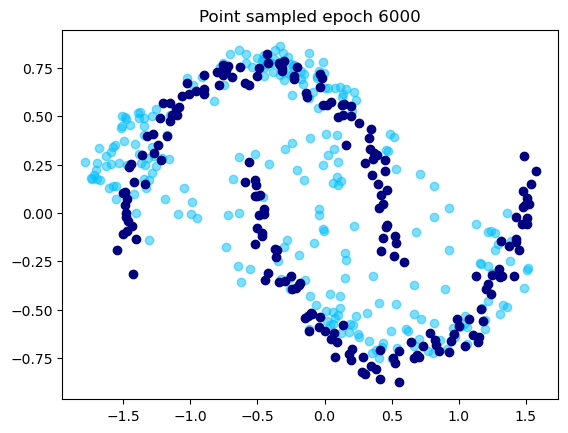

[6050/20000] 	Loss: 0.0001
[6100/20000] 	Loss: 0.0001
[6150/20000] 	Loss: 0.0001
[6200/20000] 	Loss: 0.0000
[6250/20000] 	Loss: 0.0000
[6300/20000] 	Loss: 0.0000
[6350/20000] 	Loss: 0.0000
[6400/20000] 	Loss: 0.0000
[6450/20000] 	Loss: 0.0000
[6500/20000] 	Loss: 0.0000


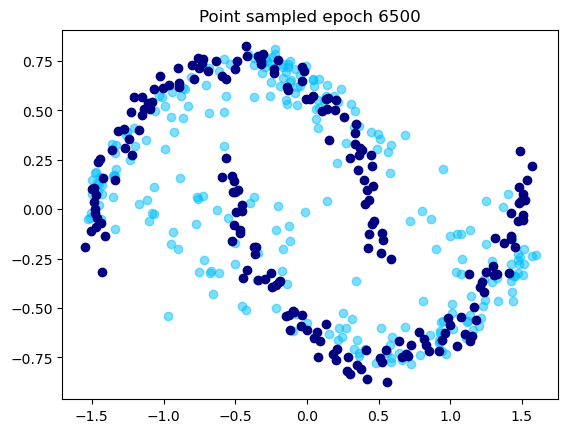

[6550/20000] 	Loss: 0.0000
[6600/20000] 	Loss: 0.0001
[6650/20000] 	Loss: 0.0000
[6700/20000] 	Loss: 0.0000
[6750/20000] 	Loss: 0.0000
[6800/20000] 	Loss: 0.0000
[6850/20000] 	Loss: 0.0000
[6900/20000] 	Loss: 0.0000
[6950/20000] 	Loss: 0.0000
[7000/20000] 	Loss: 0.0000


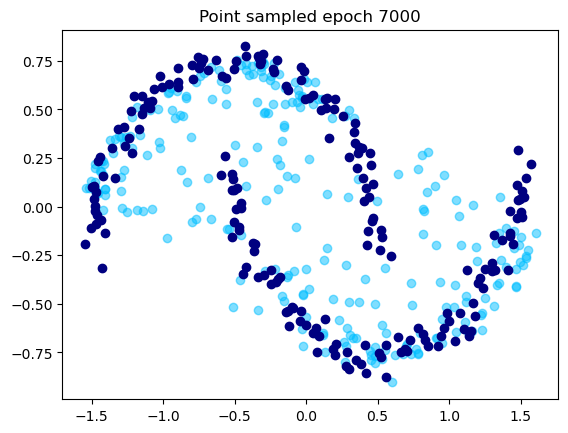

[7050/20000] 	Loss: 0.0000
[7100/20000] 	Loss: 0.0000
[7150/20000] 	Loss: 0.0000
[7200/20000] 	Loss: 0.0000
[7250/20000] 	Loss: 0.0000
[7300/20000] 	Loss: 0.0000
[7350/20000] 	Loss: 0.0000
[7400/20000] 	Loss: 0.0000
[7450/20000] 	Loss: 0.0000
[7500/20000] 	Loss: 0.0000


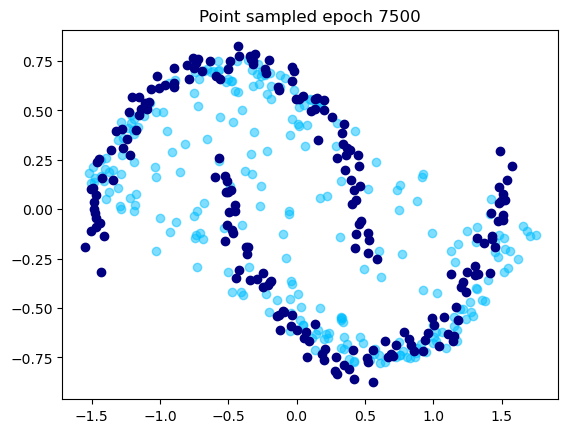

[7550/20000] 	Loss: 0.0000
[7600/20000] 	Loss: 0.0000
[7650/20000] 	Loss: 0.0000
[7700/20000] 	Loss: 0.0000
[7750/20000] 	Loss: 0.0000
[7800/20000] 	Loss: 0.0000
[7850/20000] 	Loss: 0.0000
[7900/20000] 	Loss: 0.0001
[7950/20000] 	Loss: 0.0000
[8000/20000] 	Loss: 0.0000


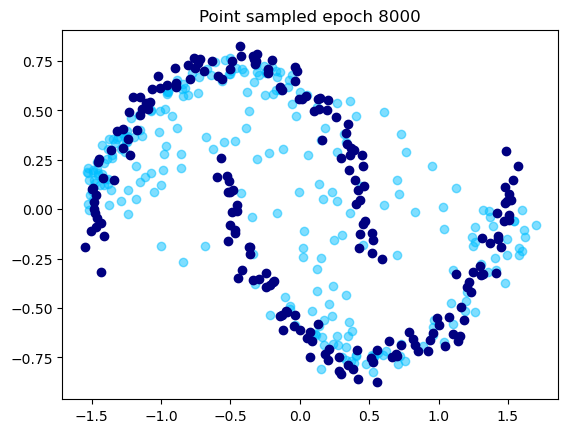

[8050/20000] 	Loss: 0.0000
[8100/20000] 	Loss: 0.0001
[8150/20000] 	Loss: 0.0000
[8200/20000] 	Loss: 0.0000
[8250/20000] 	Loss: 0.0000
[8300/20000] 	Loss: 0.0000
[8350/20000] 	Loss: 0.0000
[8400/20000] 	Loss: 0.0000
[8450/20000] 	Loss: 0.0000
[8500/20000] 	Loss: 0.0000


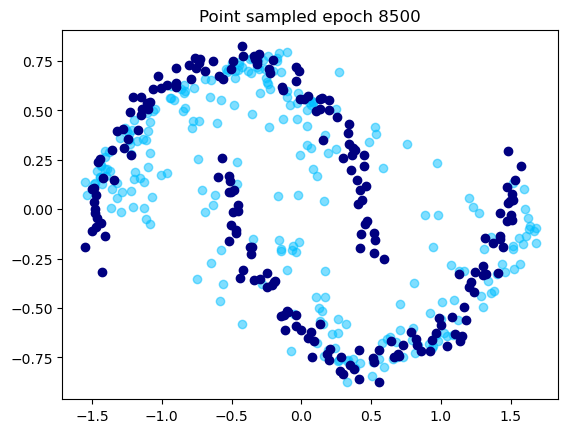

[8550/20000] 	Loss: 0.0000
[8600/20000] 	Loss: 0.0000
[8650/20000] 	Loss: 0.0000
[8700/20000] 	Loss: 0.0000
[8750/20000] 	Loss: 0.0000
[8800/20000] 	Loss: 0.0000
[8850/20000] 	Loss: 0.0000
[8900/20000] 	Loss: 0.0000
[8950/20000] 	Loss: 0.0000
[9000/20000] 	Loss: 0.0000


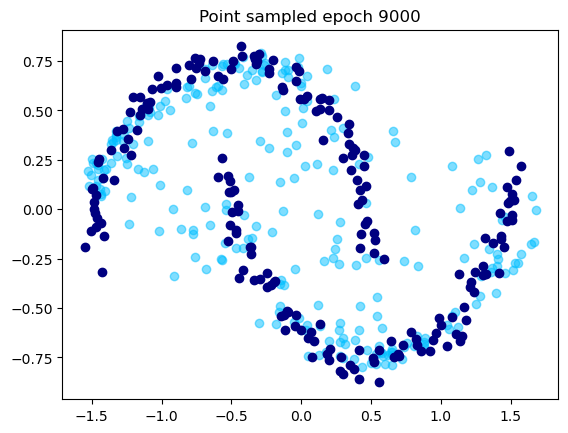

[9050/20000] 	Loss: 0.0000
[9100/20000] 	Loss: 0.0000
[9150/20000] 	Loss: 0.0000
[9200/20000] 	Loss: 0.0000
[9250/20000] 	Loss: 0.0000
[9300/20000] 	Loss: 0.0000
[9350/20000] 	Loss: 0.0000
[9400/20000] 	Loss: 0.0000
[9450/20000] 	Loss: 0.0000
[9500/20000] 	Loss: 0.0000


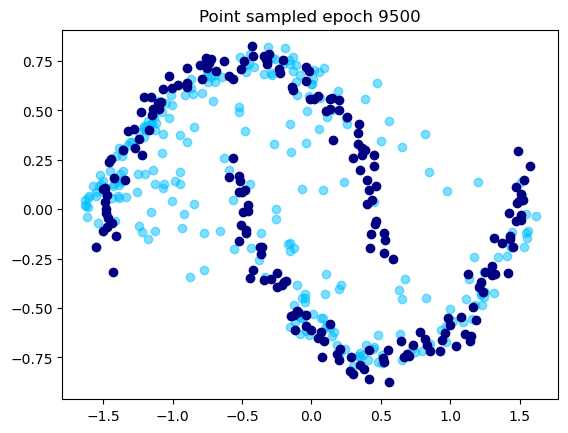

[9550/20000] 	Loss: 0.0000
[9600/20000] 	Loss: 0.0000
[9650/20000] 	Loss: 0.0000
[9700/20000] 	Loss: 0.0000
[9750/20000] 	Loss: 0.0000
[9800/20000] 	Loss: 0.0000
[9850/20000] 	Loss: 0.0000
[9900/20000] 	Loss: 0.0000
[9950/20000] 	Loss: 0.0000
[10000/20000] 	Loss: 0.0000


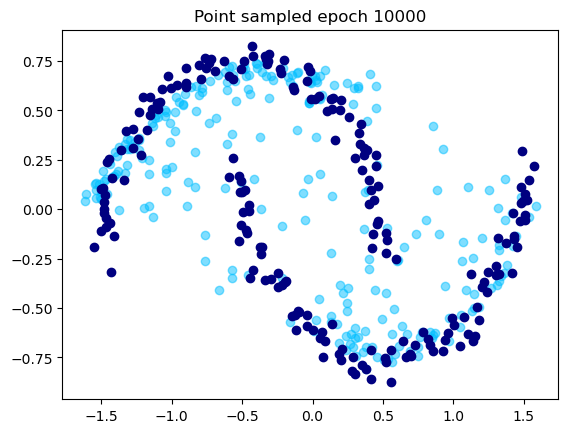

[10050/20000] 	Loss: 0.0000
[10100/20000] 	Loss: 0.0000
[10150/20000] 	Loss: 0.0000
[10200/20000] 	Loss: 0.0000
[10250/20000] 	Loss: 0.0000
[10300/20000] 	Loss: 0.0000
[10350/20000] 	Loss: 0.0000
[10400/20000] 	Loss: 0.0000
[10450/20000] 	Loss: 0.0000
[10500/20000] 	Loss: 0.0000


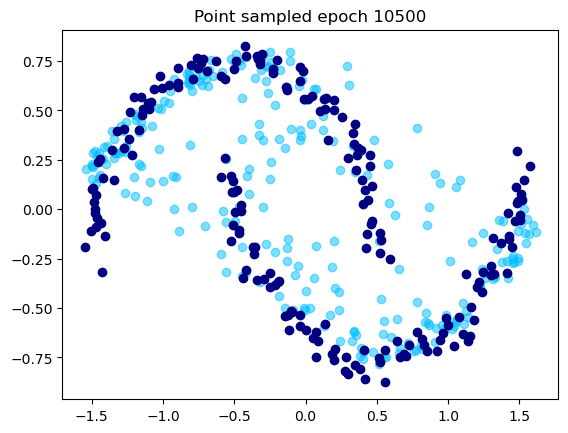

[10550/20000] 	Loss: 0.0000
[10600/20000] 	Loss: 0.0000
[10650/20000] 	Loss: 0.0000
[10700/20000] 	Loss: 0.0000
[10750/20000] 	Loss: 0.0000
[10800/20000] 	Loss: 0.0000
[10850/20000] 	Loss: 0.0000
[10900/20000] 	Loss: 0.0000
[10950/20000] 	Loss: 0.0000
[11000/20000] 	Loss: 0.0000


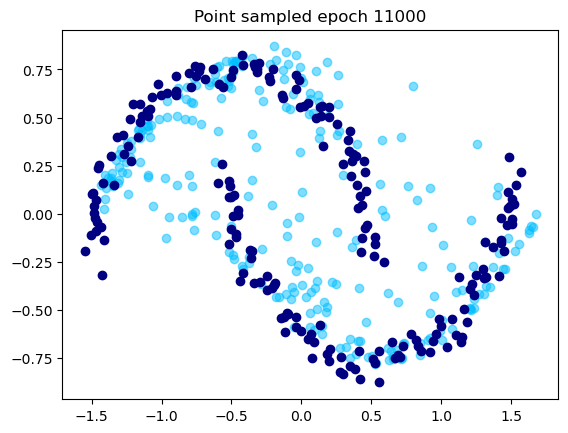

[11050/20000] 	Loss: 0.0000
[11100/20000] 	Loss: 0.0000
[11150/20000] 	Loss: 0.0000
[11200/20000] 	Loss: 0.0000
[11250/20000] 	Loss: 0.0000
[11300/20000] 	Loss: 0.0000
[11350/20000] 	Loss: 0.0000
[11400/20000] 	Loss: 0.0000
[11450/20000] 	Loss: 0.0000
[11500/20000] 	Loss: 0.0000


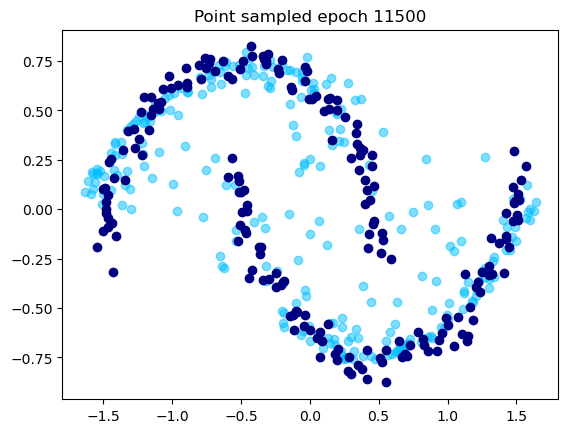

[11550/20000] 	Loss: 0.0000
[11600/20000] 	Loss: 0.0000
[11650/20000] 	Loss: 0.0000
[11700/20000] 	Loss: 0.0000
[11750/20000] 	Loss: 0.0000
[11800/20000] 	Loss: 0.0000
[11850/20000] 	Loss: 0.0000
[11900/20000] 	Loss: 0.0000
[11950/20000] 	Loss: 0.0000
[12000/20000] 	Loss: 0.0000


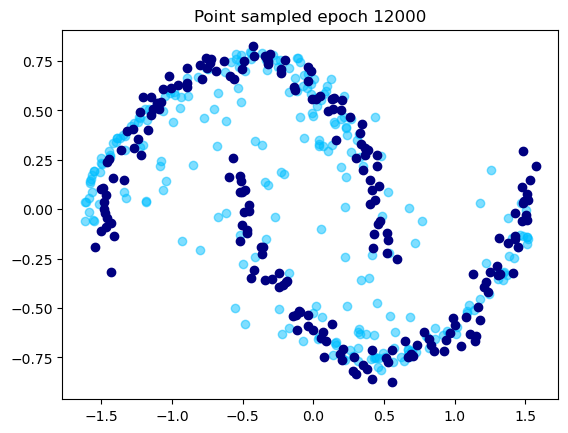

[12050/20000] 	Loss: 0.0000
[12100/20000] 	Loss: 0.0000
[12150/20000] 	Loss: 0.0000
[12200/20000] 	Loss: 0.0000
[12250/20000] 	Loss: 0.0000
[12300/20000] 	Loss: 0.0000
[12350/20000] 	Loss: 0.0000
[12400/20000] 	Loss: 0.0000
[12450/20000] 	Loss: 0.0000
[12500/20000] 	Loss: 0.0000


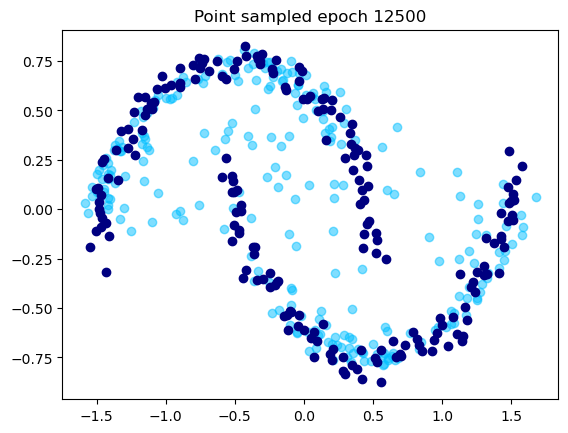

[12550/20000] 	Loss: 0.0000
[12600/20000] 	Loss: 0.0000
[12650/20000] 	Loss: 0.0000
[12700/20000] 	Loss: 0.0000
[12750/20000] 	Loss: 0.0000
[12800/20000] 	Loss: 0.0000
[12850/20000] 	Loss: 0.0000
[12900/20000] 	Loss: 0.0000
[12950/20000] 	Loss: 0.0000
[13000/20000] 	Loss: 0.0000


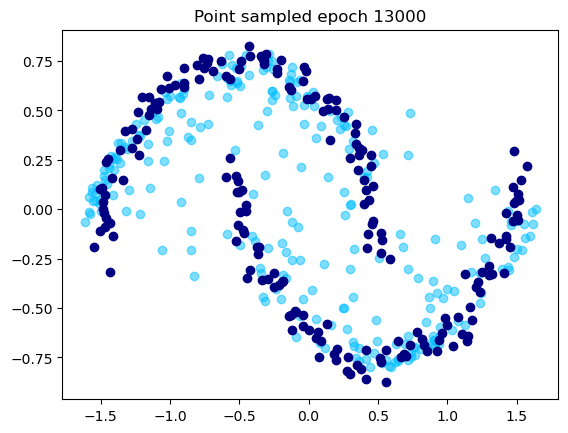

[13050/20000] 	Loss: 0.0000
[13100/20000] 	Loss: 0.0000
[13150/20000] 	Loss: 0.0000
[13200/20000] 	Loss: 0.0000
[13250/20000] 	Loss: 0.0000
[13300/20000] 	Loss: 0.0000
[13350/20000] 	Loss: 0.0000
[13400/20000] 	Loss: 0.0000
[13450/20000] 	Loss: 0.0000
[13500/20000] 	Loss: 0.0000


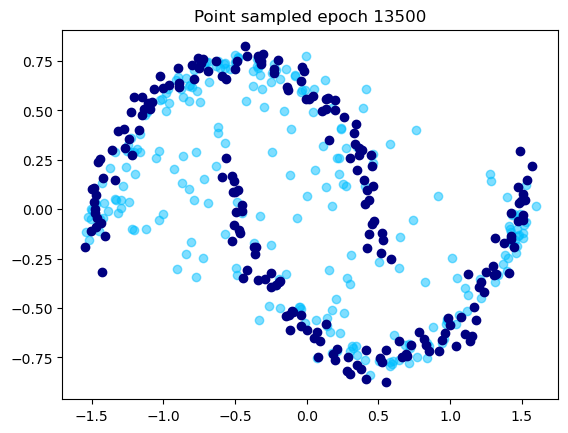

[13550/20000] 	Loss: 0.0000
[13600/20000] 	Loss: 0.0000
[13650/20000] 	Loss: 0.0000
[13700/20000] 	Loss: 0.0000
[13750/20000] 	Loss: 0.0000
[13800/20000] 	Loss: 0.0000
[13850/20000] 	Loss: 0.0000
[13900/20000] 	Loss: 0.0000
[13950/20000] 	Loss: 0.0000
[14000/20000] 	Loss: 0.0000


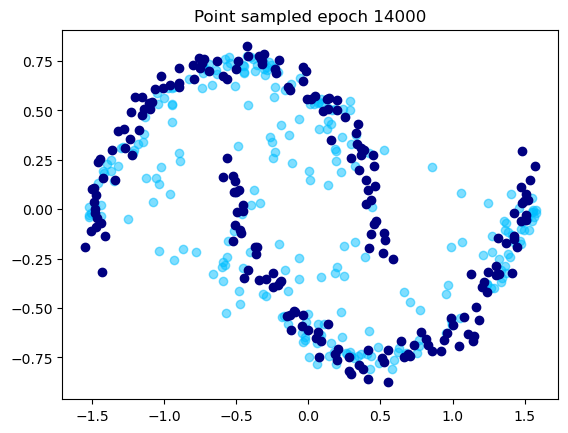

[14050/20000] 	Loss: 0.0000
[14100/20000] 	Loss: 0.0000
[14150/20000] 	Loss: 0.0000
[14200/20000] 	Loss: 0.0000
[14250/20000] 	Loss: 0.0000
[14300/20000] 	Loss: 0.0000
[14350/20000] 	Loss: 0.0000
[14400/20000] 	Loss: 0.0000
[14450/20000] 	Loss: 0.0000
[14500/20000] 	Loss: 0.0000


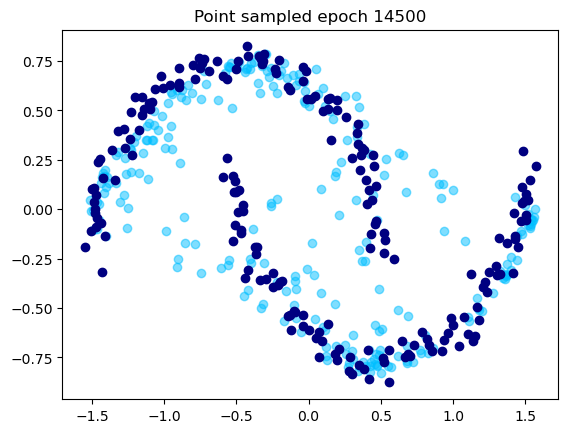

[14550/20000] 	Loss: 0.0000
[14600/20000] 	Loss: 0.0000
[14650/20000] 	Loss: 0.0000
[14700/20000] 	Loss: 0.0000
[14750/20000] 	Loss: 0.0000
[14800/20000] 	Loss: 0.0000
[14850/20000] 	Loss: 0.0000
[14900/20000] 	Loss: 0.0000
[14950/20000] 	Loss: 0.0000
[15000/20000] 	Loss: 0.0000


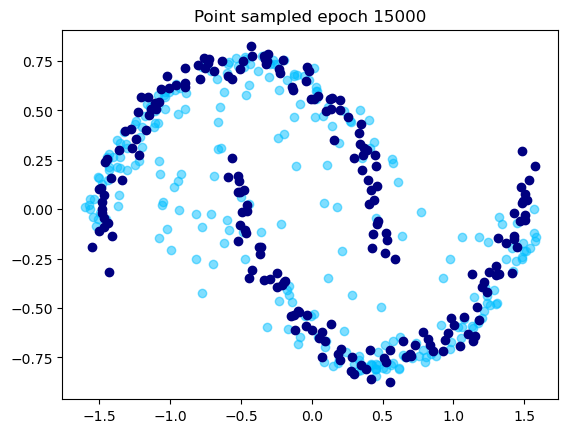

[15050/20000] 	Loss: 0.0000
[15100/20000] 	Loss: 0.0000
[15150/20000] 	Loss: 0.0000
[15200/20000] 	Loss: 0.0000
[15250/20000] 	Loss: 0.0000
[15300/20000] 	Loss: 0.0000
[15350/20000] 	Loss: 0.0000
[15400/20000] 	Loss: 0.0000
[15450/20000] 	Loss: 0.0000
[15500/20000] 	Loss: 0.0000


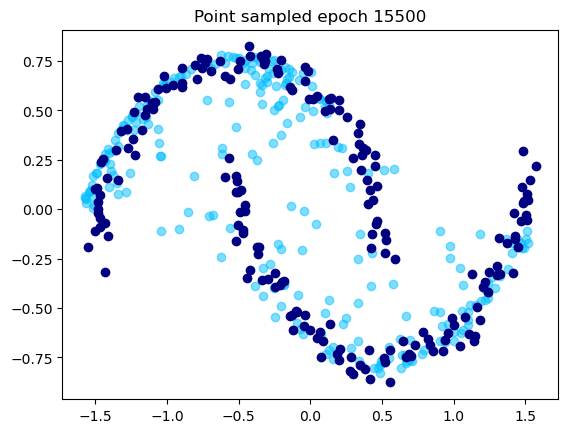

[15550/20000] 	Loss: 0.0000
[15600/20000] 	Loss: 0.0000
[15650/20000] 	Loss: 0.0000
[15700/20000] 	Loss: 0.0000
[15750/20000] 	Loss: 0.0000
[15800/20000] 	Loss: 0.0001
[15850/20000] 	Loss: 0.0000
[15900/20000] 	Loss: 0.0000
[15950/20000] 	Loss: 0.0000
[16000/20000] 	Loss: 0.0000


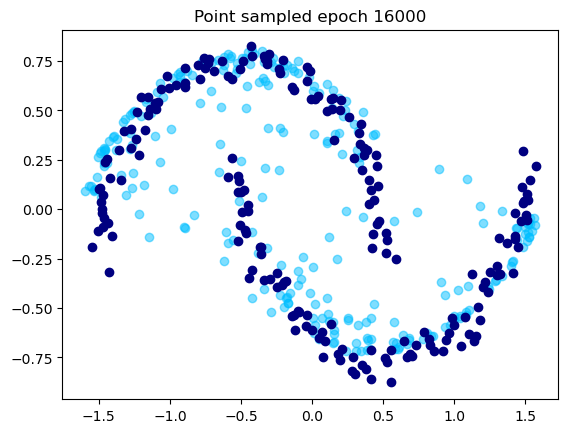

[16050/20000] 	Loss: 0.0000
[16100/20000] 	Loss: 0.0000
[16150/20000] 	Loss: 0.0000
[16200/20000] 	Loss: 0.0000
[16250/20000] 	Loss: 0.0000
[16300/20000] 	Loss: 0.0000
[16350/20000] 	Loss: 0.0000
[16400/20000] 	Loss: 0.0000
[16450/20000] 	Loss: 0.0000
[16500/20000] 	Loss: 0.0000


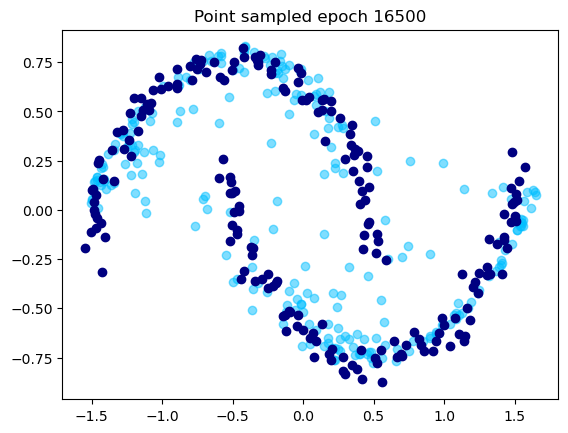

[16550/20000] 	Loss: 0.0000
[16600/20000] 	Loss: 0.0000
[16650/20000] 	Loss: 0.0000
[16700/20000] 	Loss: 0.0000
[16750/20000] 	Loss: 0.0000
[16800/20000] 	Loss: 0.0000
[16850/20000] 	Loss: 0.0000
[16900/20000] 	Loss: 0.0000
[16950/20000] 	Loss: 0.0000
[17000/20000] 	Loss: 0.0000


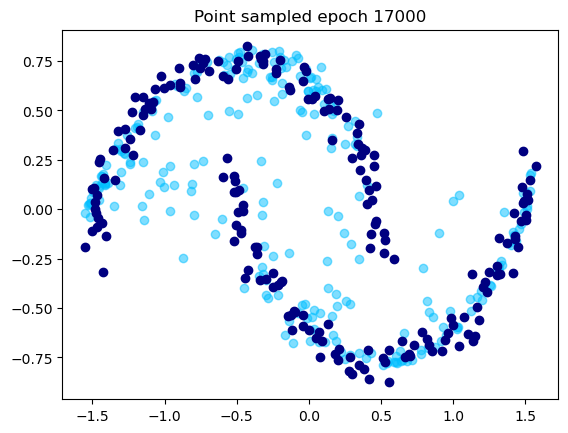

[17050/20000] 	Loss: 0.0000
[17100/20000] 	Loss: 0.0000
[17150/20000] 	Loss: 0.0000
[17200/20000] 	Loss: 0.0000
[17250/20000] 	Loss: 0.0000
[17300/20000] 	Loss: 0.0000
[17350/20000] 	Loss: 0.0000
[17400/20000] 	Loss: 0.0001
[17450/20000] 	Loss: 0.0001
[17500/20000] 	Loss: 0.0000


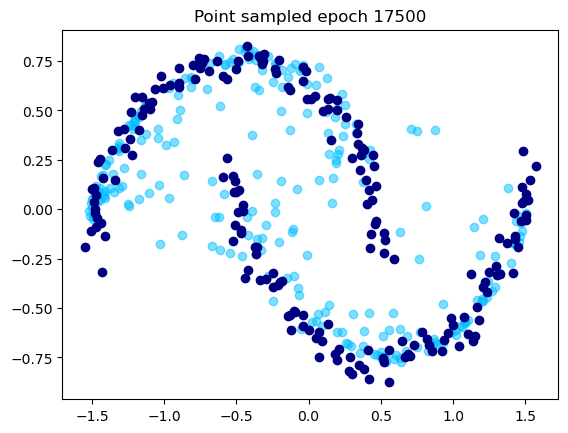

[17550/20000] 	Loss: 0.0000
[17600/20000] 	Loss: 0.0000
[17650/20000] 	Loss: 0.0000
[17700/20000] 	Loss: 0.0000
[17750/20000] 	Loss: 0.0000
[17800/20000] 	Loss: 0.0000
[17850/20000] 	Loss: 0.0000
[17900/20000] 	Loss: 0.0000
[17950/20000] 	Loss: 0.0000
[18000/20000] 	Loss: 0.0000


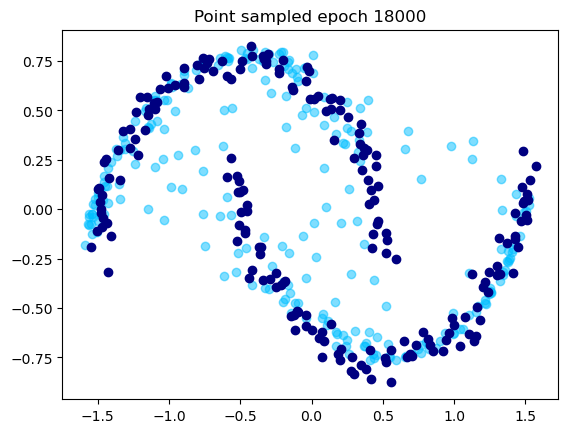

[18050/20000] 	Loss: 0.0000
[18100/20000] 	Loss: 0.0000
[18150/20000] 	Loss: 0.0000
[18200/20000] 	Loss: 0.0000
[18250/20000] 	Loss: 0.0000
[18300/20000] 	Loss: 0.0000
[18350/20000] 	Loss: 0.0000
[18400/20000] 	Loss: 0.0000
[18450/20000] 	Loss: 0.0000
[18500/20000] 	Loss: 0.0000


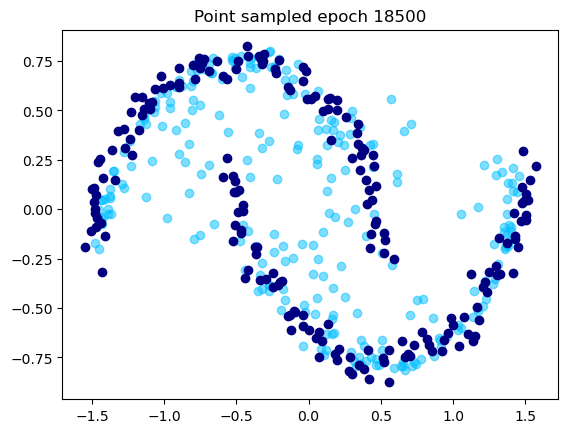

[18550/20000] 	Loss: 0.0000
[18600/20000] 	Loss: 0.0000
[18650/20000] 	Loss: 0.0000
[18700/20000] 	Loss: 0.0000
[18750/20000] 	Loss: 0.0000
[18800/20000] 	Loss: 0.0000
[18850/20000] 	Loss: 0.0000
[18900/20000] 	Loss: 0.0000
[18950/20000] 	Loss: 0.0000
[19000/20000] 	Loss: 0.0000


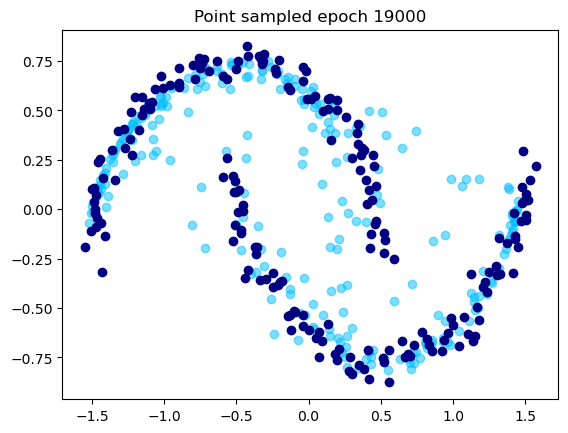

[19050/20000] 	Loss: 0.0000
[19100/20000] 	Loss: 0.0000
[19150/20000] 	Loss: 0.0000
[19200/20000] 	Loss: 0.0000
[19250/20000] 	Loss: 0.0000
[19300/20000] 	Loss: 0.0000
[19350/20000] 	Loss: 0.0000
[19400/20000] 	Loss: 0.0000
[19450/20000] 	Loss: 0.0000
[19500/20000] 	Loss: 0.0000


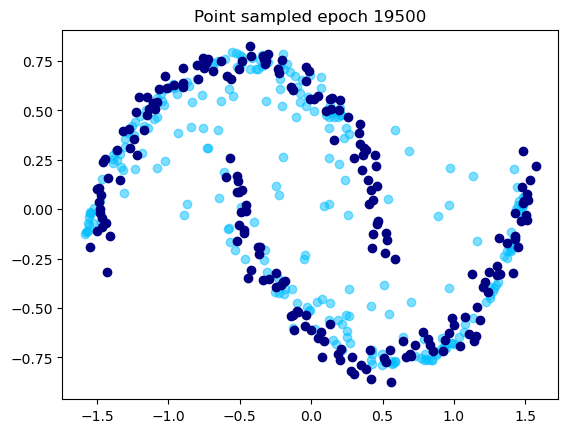

[19550/20000] 	Loss: 0.0000
[19600/20000] 	Loss: 0.0000
[19650/20000] 	Loss: 0.0000
[19700/20000] 	Loss: 0.0000
[19750/20000] 	Loss: 0.0000
[19800/20000] 	Loss: 0.0000
[19850/20000] 	Loss: 0.0001
[19900/20000] 	Loss: 0.0000
[19950/20000] 	Loss: 0.0000
[20000/20000] 	Loss: 0.0000


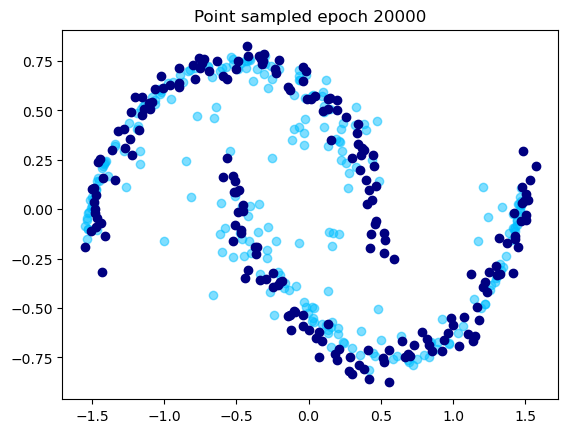

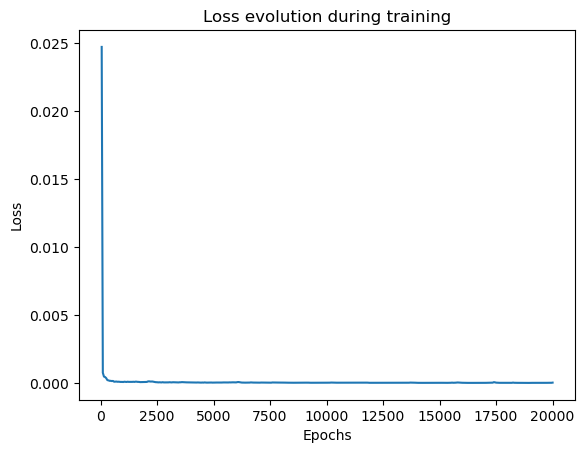

In [17]:
distill_consistency(score_model_path,
                    nepochs, lr, ema_decay,
                    n_samples_per_batch, nb_degradation_per_datapoint,
                    d_model, n_blocks, num_diffusion_timesteps, timespand,
                    epoch_log, epoch_display, nb_samples_display,
                    fig_savepath, model_savepath)

## T=1000, N=100

In [30]:
score_model_path = "./models/diffusion_two_moons_T1000_epoch10000.pt"

nepochs=10000
lr=1e-3
ema_decay=0.3

n_samples_per_batch=128
nb_degradation_per_datapoint=1

d_model=128
n_blocks=5
num_diffusion_timesteps=100 # N
timespand=1000 # T

epoch_log=50
epoch_display=250
nb_samples_display=256

fig_savepath="./figures/CD_two_moons_T1000_N100"
model_savepath="./models/CD_two_moons_T1000_N100_epoch10000.pt"

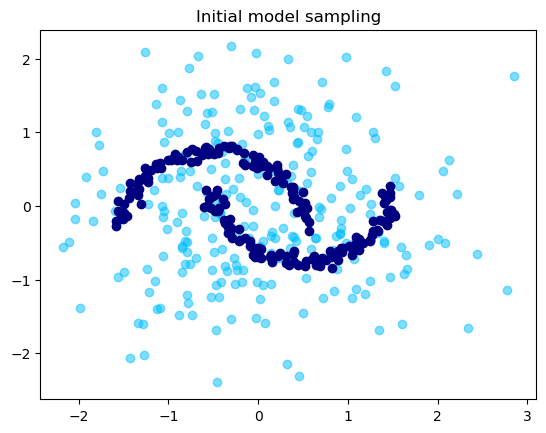

[50/10000] 	Loss: 0.0100
[100/10000] 	Loss: 0.0028
[150/10000] 	Loss: 0.0019
[200/10000] 	Loss: 0.0008
[250/10000] 	Loss: 0.0011


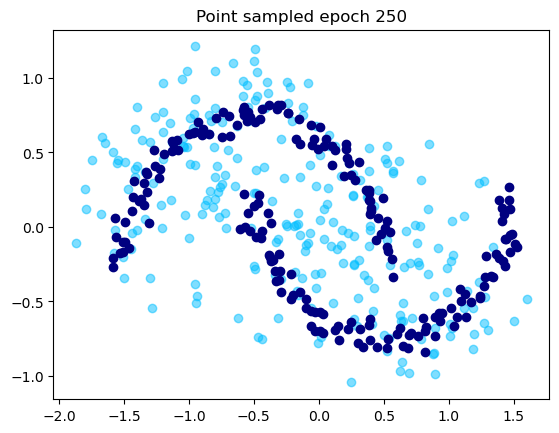

[300/10000] 	Loss: 0.0006
[350/10000] 	Loss: 0.0005
[400/10000] 	Loss: 0.0003
[450/10000] 	Loss: 0.0004
[500/10000] 	Loss: 0.0002


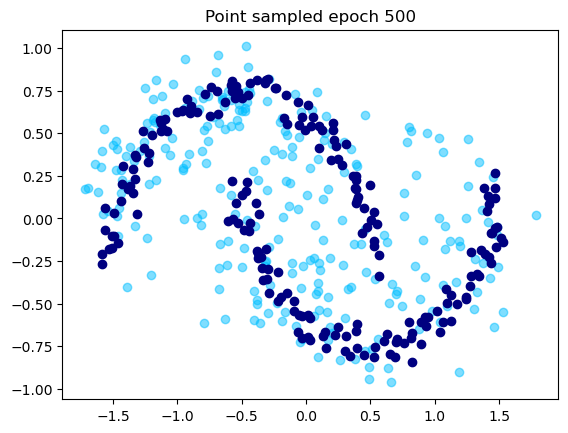

[550/10000] 	Loss: 0.0001
[600/10000] 	Loss: 0.0002
[650/10000] 	Loss: 0.0002
[700/10000] 	Loss: 0.0004
[750/10000] 	Loss: 0.0002


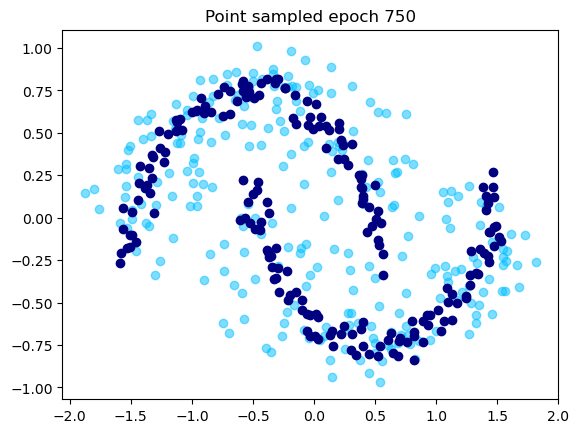

[800/10000] 	Loss: 0.0002
[850/10000] 	Loss: 0.0002
[900/10000] 	Loss: 0.0003
[950/10000] 	Loss: 0.0002
[1000/10000] 	Loss: 0.0002


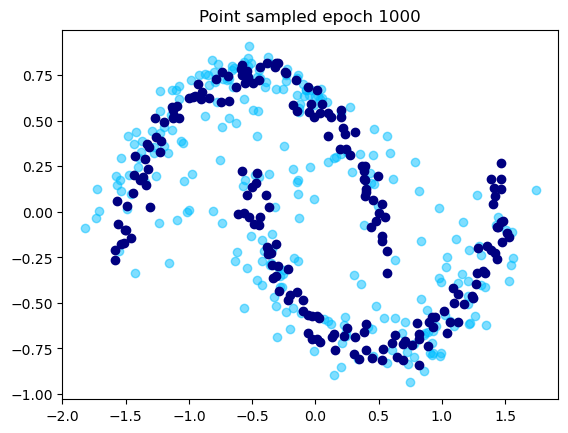

[1050/10000] 	Loss: 0.0004
[1100/10000] 	Loss: 0.0001
[1150/10000] 	Loss: 0.0002
[1200/10000] 	Loss: 0.0002
[1250/10000] 	Loss: 0.0001


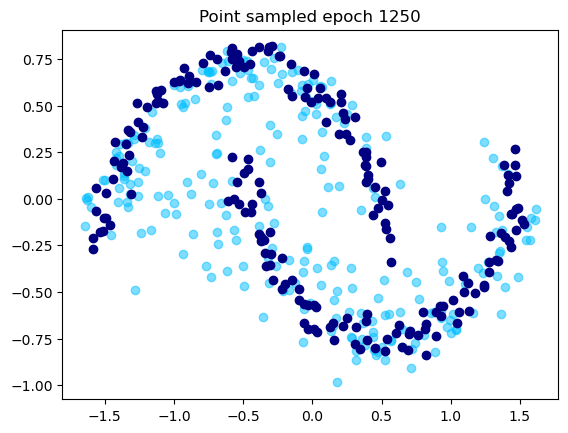

[1300/10000] 	Loss: 0.0002
[1350/10000] 	Loss: 0.0002
[1400/10000] 	Loss: 0.0002
[1450/10000] 	Loss: 0.0002
[1500/10000] 	Loss: 0.0001


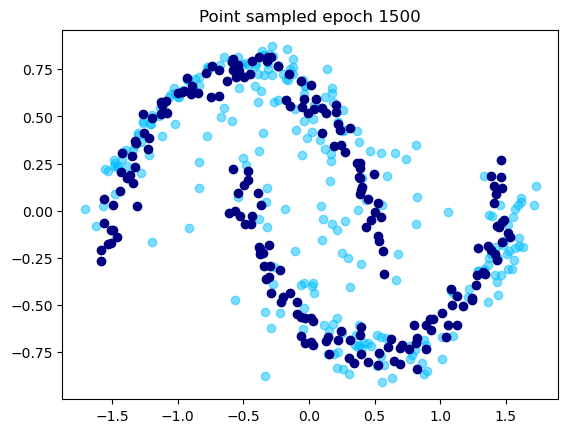

[1550/10000] 	Loss: 0.0001
[1600/10000] 	Loss: 0.0002
[1650/10000] 	Loss: 0.0002
[1700/10000] 	Loss: 0.0002
[1750/10000] 	Loss: 0.0001


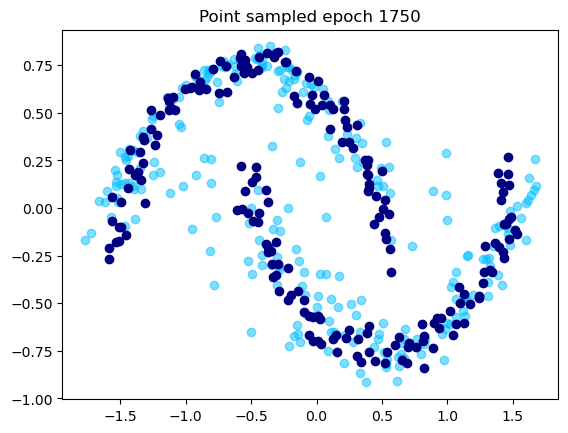

[1800/10000] 	Loss: 0.0002
[1850/10000] 	Loss: 0.0002
[1900/10000] 	Loss: 0.0002
[1950/10000] 	Loss: 0.0002
[2000/10000] 	Loss: 0.0002


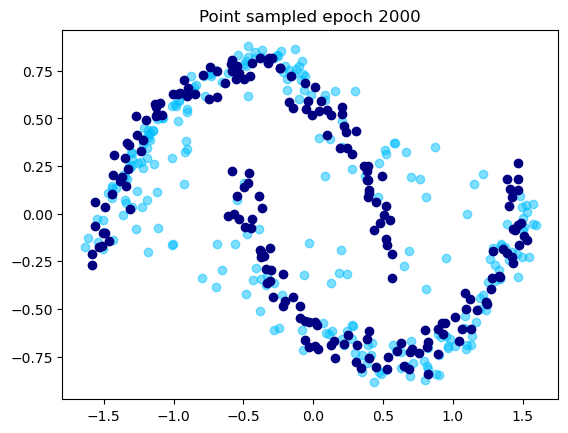

[2050/10000] 	Loss: 0.0002
[2100/10000] 	Loss: 0.0003
[2150/10000] 	Loss: 0.0002
[2200/10000] 	Loss: 0.0001
[2250/10000] 	Loss: 0.0002


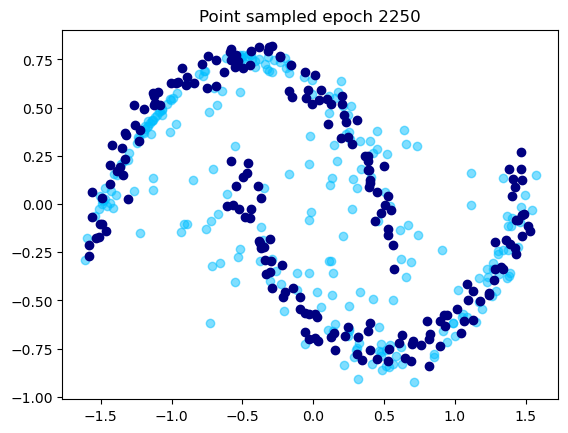

[2300/10000] 	Loss: 0.0002
[2350/10000] 	Loss: 0.0001
[2400/10000] 	Loss: 0.0001
[2450/10000] 	Loss: 0.0002
[2500/10000] 	Loss: 0.0001


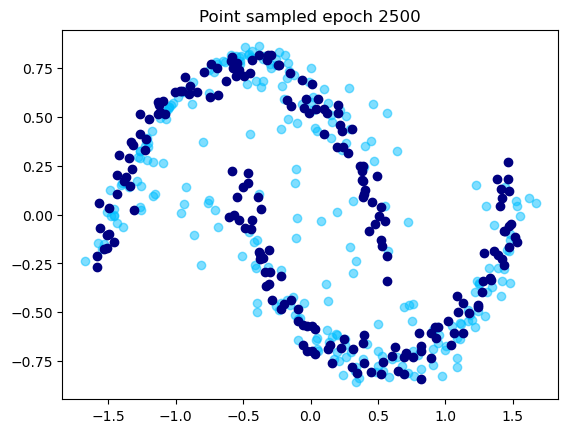

[2550/10000] 	Loss: 0.0002
[2600/10000] 	Loss: 0.0002
[2650/10000] 	Loss: 0.0001
[2700/10000] 	Loss: 0.0001
[2750/10000] 	Loss: 0.0001


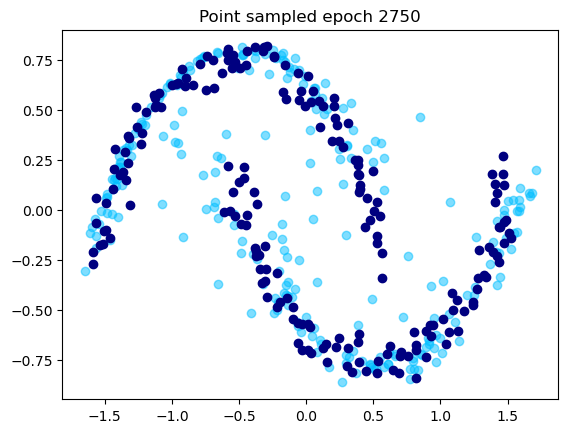

[2800/10000] 	Loss: 0.0002
[2850/10000] 	Loss: 0.0001
[2900/10000] 	Loss: 0.0002
[2950/10000] 	Loss: 0.0001
[3000/10000] 	Loss: 0.0001


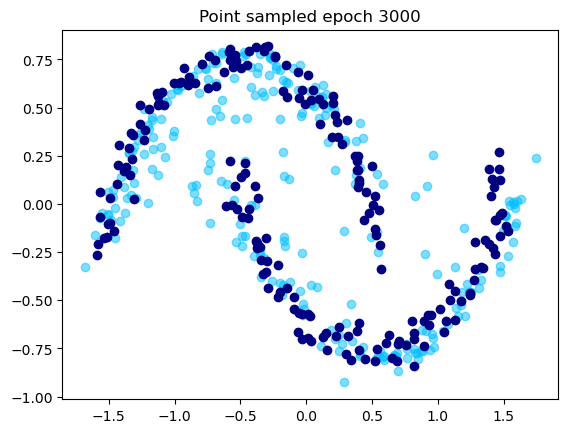

[3050/10000] 	Loss: 0.0001
[3100/10000] 	Loss: 0.0001
[3150/10000] 	Loss: 0.0002
[3200/10000] 	Loss: 0.0001
[3250/10000] 	Loss: 0.0001


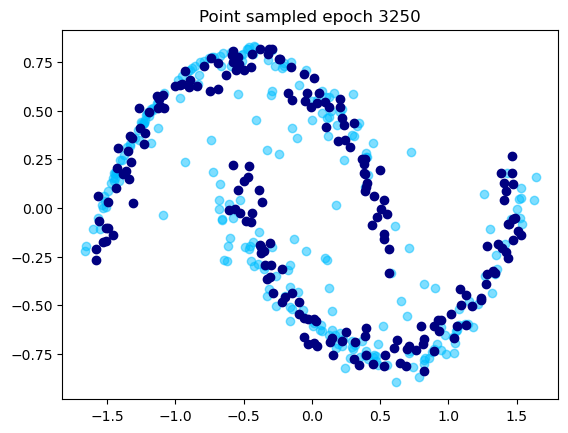

[3300/10000] 	Loss: 0.0001
[3350/10000] 	Loss: 0.0001
[3400/10000] 	Loss: 0.0001
[3450/10000] 	Loss: 0.0002
[3500/10000] 	Loss: 0.0001


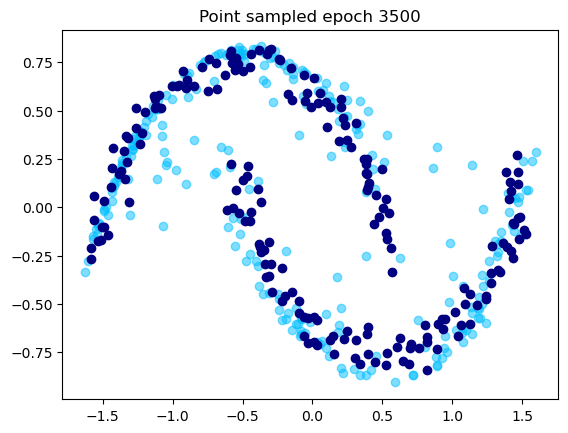

[3550/10000] 	Loss: 0.0001
[3600/10000] 	Loss: 0.0001
[3650/10000] 	Loss: 0.0001
[3700/10000] 	Loss: 0.0001
[3750/10000] 	Loss: 0.0002


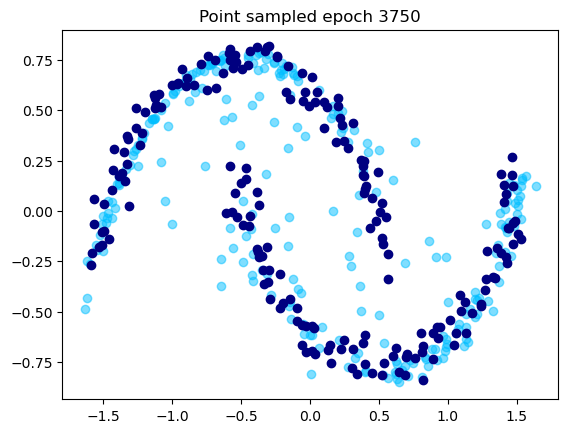

[3800/10000] 	Loss: 0.0001
[3850/10000] 	Loss: 0.0001
[3900/10000] 	Loss: 0.0001
[3950/10000] 	Loss: 0.0001
[4000/10000] 	Loss: 0.0001


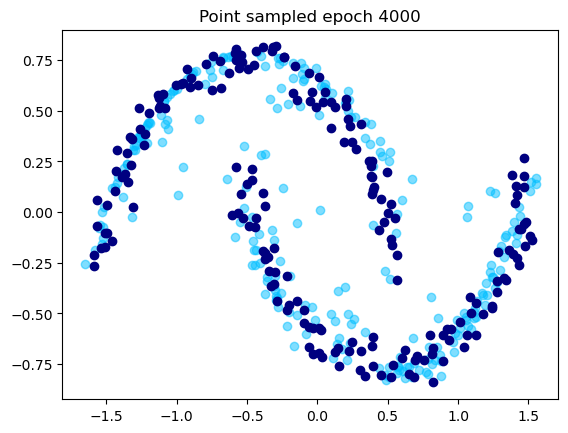

[4050/10000] 	Loss: 0.0001
[4100/10000] 	Loss: 0.0001
[4150/10000] 	Loss: 0.0002
[4200/10000] 	Loss: 0.0002
[4250/10000] 	Loss: 0.0001


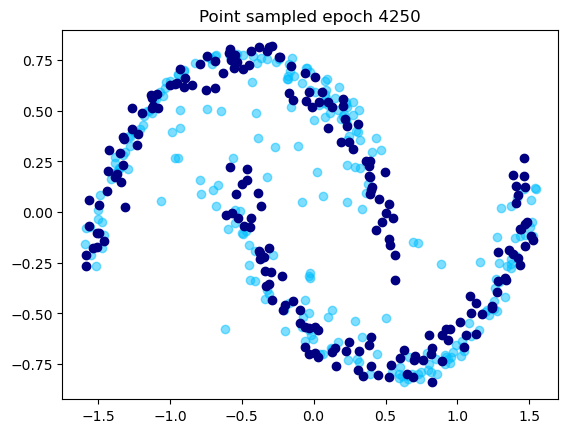

[4300/10000] 	Loss: 0.0001
[4350/10000] 	Loss: 0.0001
[4400/10000] 	Loss: 0.0001
[4450/10000] 	Loss: 0.0001
[4500/10000] 	Loss: 0.0001


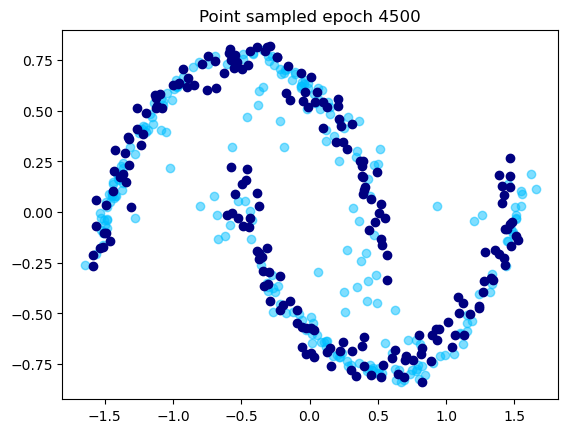

[4550/10000] 	Loss: 0.0001
[4600/10000] 	Loss: 0.0001
[4650/10000] 	Loss: 0.0001
[4700/10000] 	Loss: 0.0001
[4750/10000] 	Loss: 0.0001


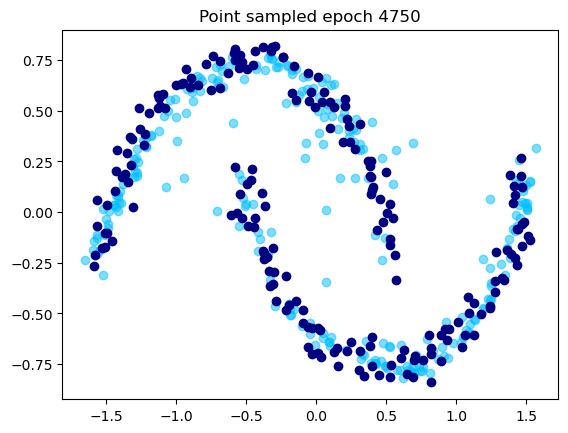

[4800/10000] 	Loss: 0.0001
[4850/10000] 	Loss: 0.0001
[4900/10000] 	Loss: 0.0001
[4950/10000] 	Loss: 0.0001
[5000/10000] 	Loss: 0.0001


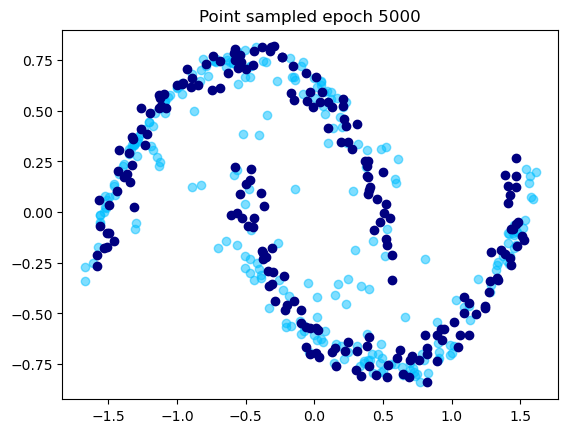

[5050/10000] 	Loss: 0.0001
[5100/10000] 	Loss: 0.0001
[5150/10000] 	Loss: 0.0001
[5200/10000] 	Loss: 0.0001
[5250/10000] 	Loss: 0.0001


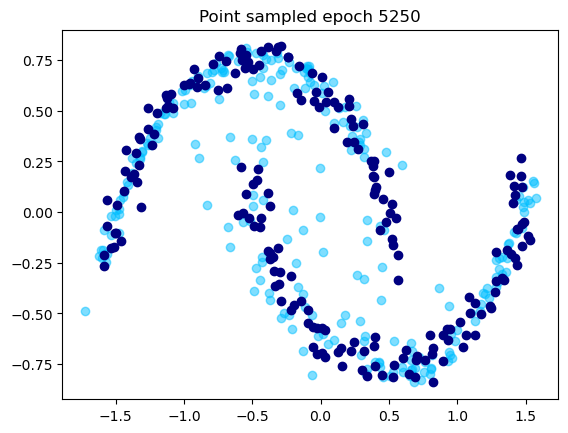

[5300/10000] 	Loss: 0.0001
[5350/10000] 	Loss: 0.0001
[5400/10000] 	Loss: 0.0001
[5450/10000] 	Loss: 0.0001
[5500/10000] 	Loss: 0.0001


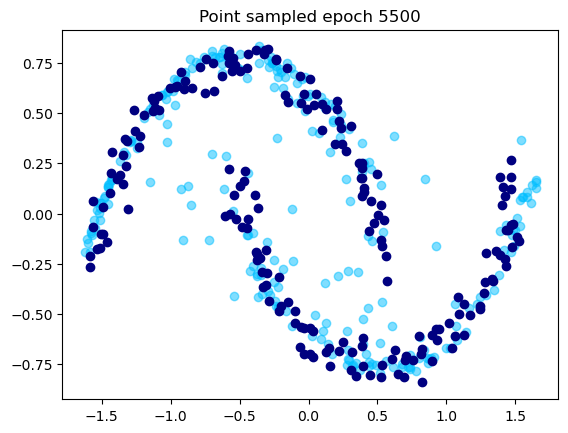

[5550/10000] 	Loss: 0.0001
[5600/10000] 	Loss: 0.0001
[5650/10000] 	Loss: 0.0001
[5700/10000] 	Loss: 0.0001
[5750/10000] 	Loss: 0.0001


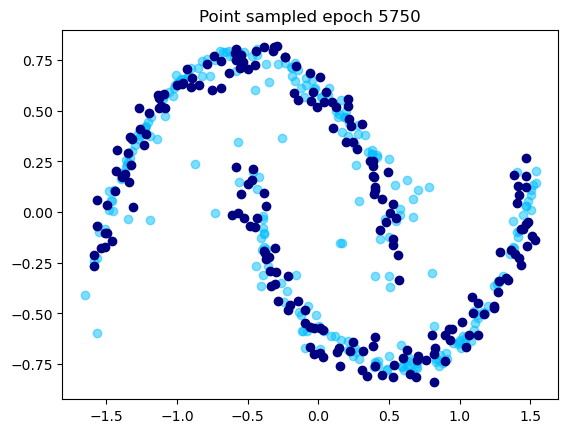

[5800/10000] 	Loss: 0.0001
[5850/10000] 	Loss: 0.0001
[5900/10000] 	Loss: 0.0001
[5950/10000] 	Loss: 0.0002
[6000/10000] 	Loss: 0.0001


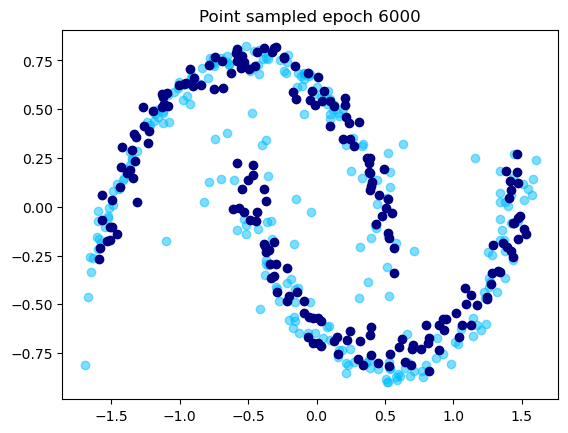

[6050/10000] 	Loss: 0.0001
[6100/10000] 	Loss: 0.0001
[6150/10000] 	Loss: 0.0001
[6200/10000] 	Loss: 0.0002
[6250/10000] 	Loss: 0.0002


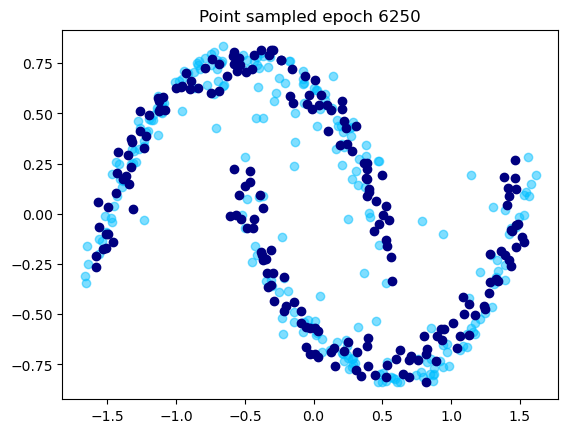

[6300/10000] 	Loss: 0.0001
[6350/10000] 	Loss: 0.0001
[6400/10000] 	Loss: 0.0001
[6450/10000] 	Loss: 0.0001
[6500/10000] 	Loss: 0.0001


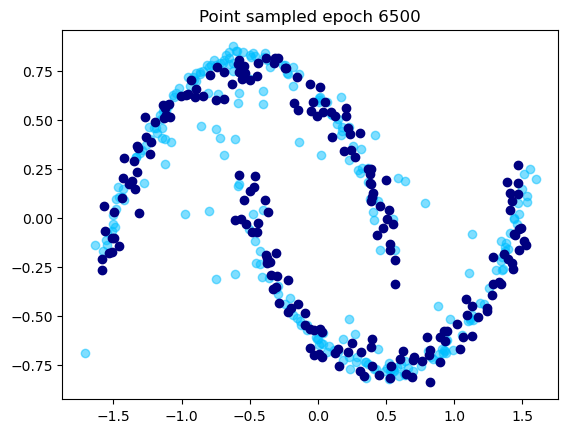

[6550/10000] 	Loss: 0.0002
[6600/10000] 	Loss: 0.0001
[6650/10000] 	Loss: 0.0002
[6700/10000] 	Loss: 0.0001
[6750/10000] 	Loss: 0.0001


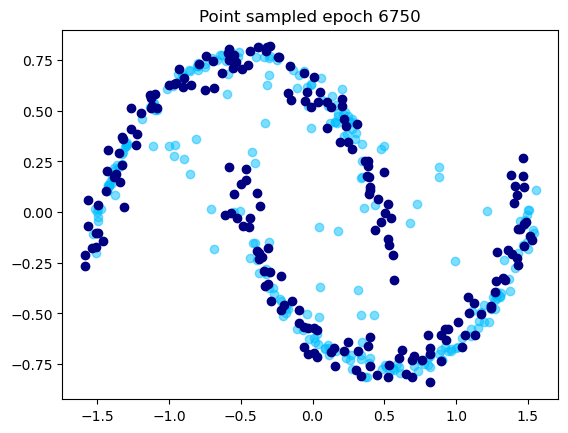

[6800/10000] 	Loss: 0.0001
[6850/10000] 	Loss: 0.0002
[6900/10000] 	Loss: 0.0001
[6950/10000] 	Loss: 0.0001
[7000/10000] 	Loss: 0.0001


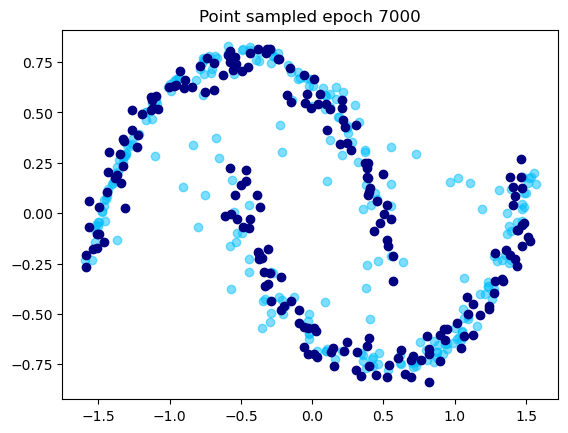

[7050/10000] 	Loss: 0.0001
[7100/10000] 	Loss: 0.0001
[7150/10000] 	Loss: 0.0001
[7200/10000] 	Loss: 0.0001
[7250/10000] 	Loss: 0.0001


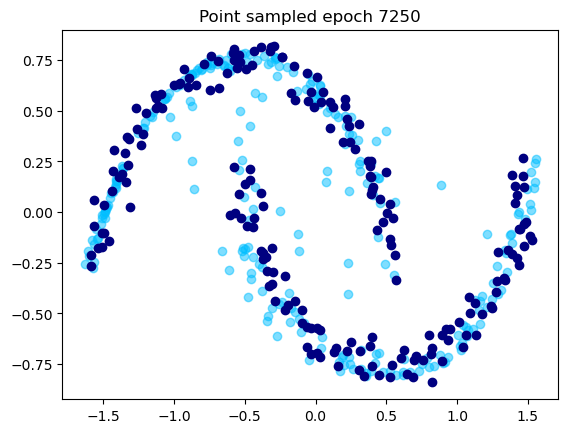

[7300/10000] 	Loss: 0.0002
[7350/10000] 	Loss: 0.0001
[7400/10000] 	Loss: 0.0001
[7450/10000] 	Loss: 0.0001
[7500/10000] 	Loss: 0.0001


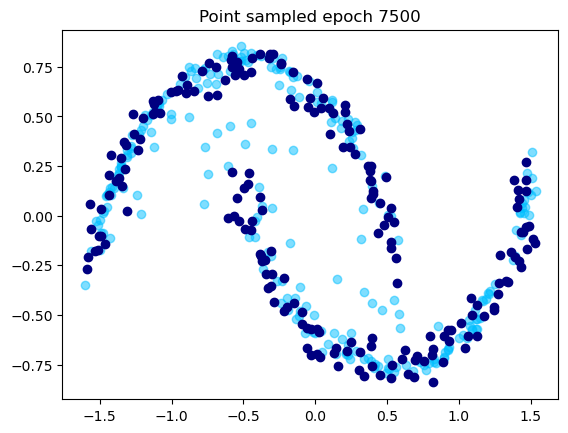

[7550/10000] 	Loss: 0.0001
[7600/10000] 	Loss: 0.0001
[7650/10000] 	Loss: 0.0001
[7700/10000] 	Loss: 0.0001
[7750/10000] 	Loss: 0.0001


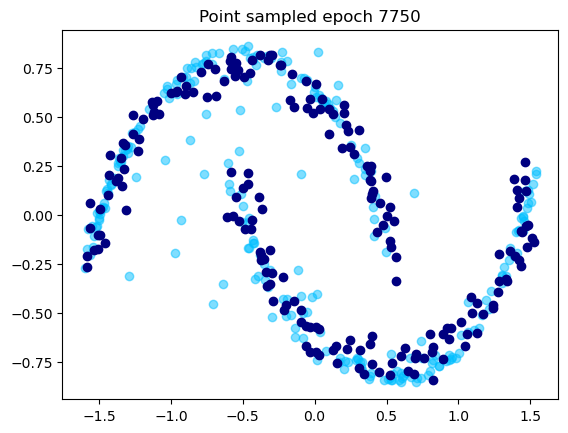

[7800/10000] 	Loss: 0.0001
[7850/10000] 	Loss: 0.0000
[7900/10000] 	Loss: 0.0000
[7950/10000] 	Loss: 0.0001
[8000/10000] 	Loss: 0.0000


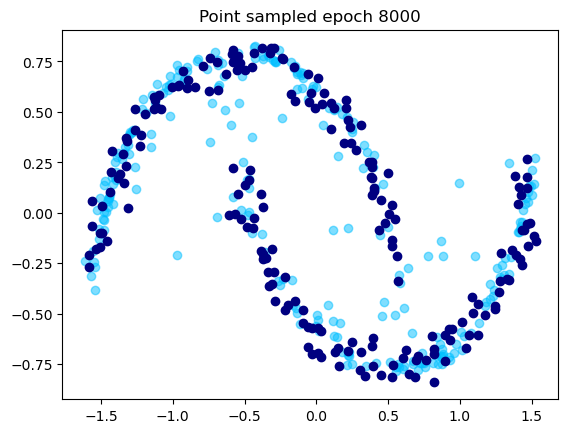

[8050/10000] 	Loss: 0.0001
[8100/10000] 	Loss: 0.0001
[8150/10000] 	Loss: 0.0002
[8200/10000] 	Loss: 0.0001
[8250/10000] 	Loss: 0.0001


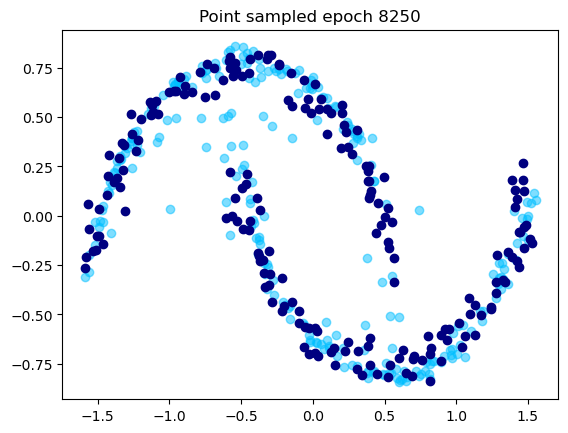

[8300/10000] 	Loss: 0.0001
[8350/10000] 	Loss: 0.0001
[8400/10000] 	Loss: 0.0000
[8450/10000] 	Loss: 0.0001
[8500/10000] 	Loss: 0.0001


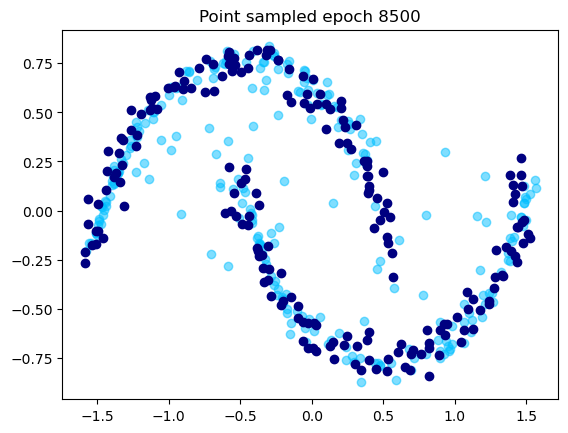

[8550/10000] 	Loss: 0.0001
[8600/10000] 	Loss: 0.0001
[8650/10000] 	Loss: 0.0001
[8700/10000] 	Loss: 0.0001
[8750/10000] 	Loss: 0.0001


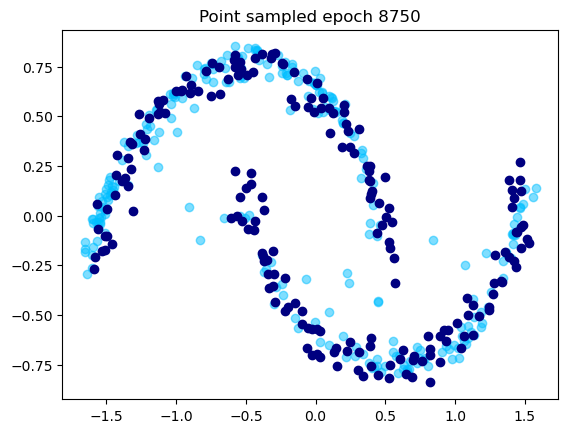

[8800/10000] 	Loss: 0.0001
[8850/10000] 	Loss: 0.0001
[8900/10000] 	Loss: 0.0001
[8950/10000] 	Loss: 0.0001
[9000/10000] 	Loss: 0.0001


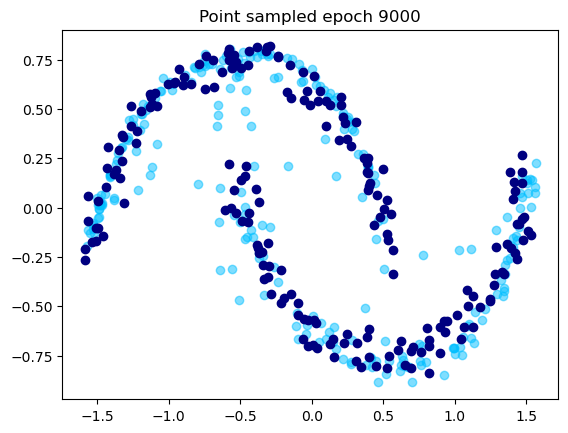

[9050/10000] 	Loss: 0.0001
[9100/10000] 	Loss: 0.0001
[9150/10000] 	Loss: 0.0001
[9200/10000] 	Loss: 0.0001
[9250/10000] 	Loss: 0.0001


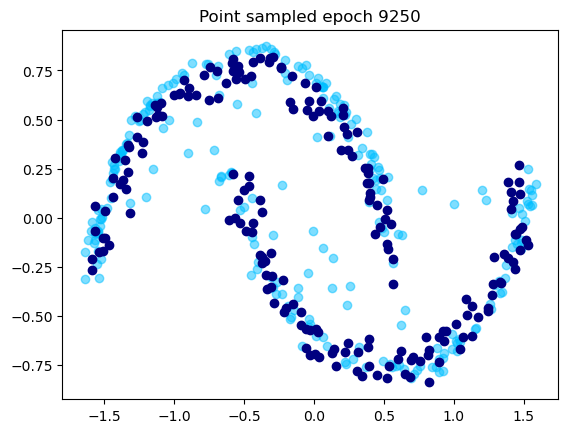

[9300/10000] 	Loss: 0.0001
[9350/10000] 	Loss: 0.0001
[9400/10000] 	Loss: 0.0001
[9450/10000] 	Loss: 0.0000
[9500/10000] 	Loss: 0.0001


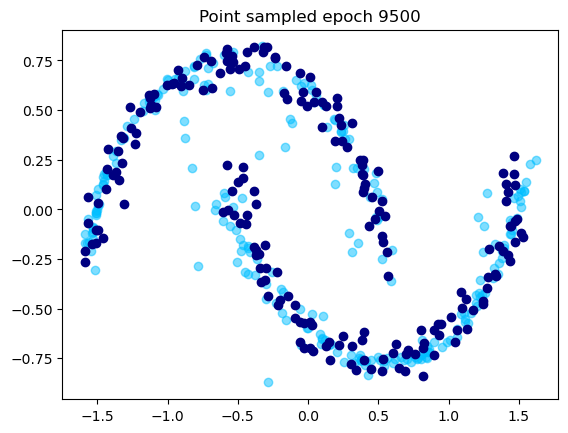

[9550/10000] 	Loss: 0.0000
[9600/10000] 	Loss: 0.0000
[9650/10000] 	Loss: 0.0001
[9700/10000] 	Loss: 0.0001
[9750/10000] 	Loss: 0.0001


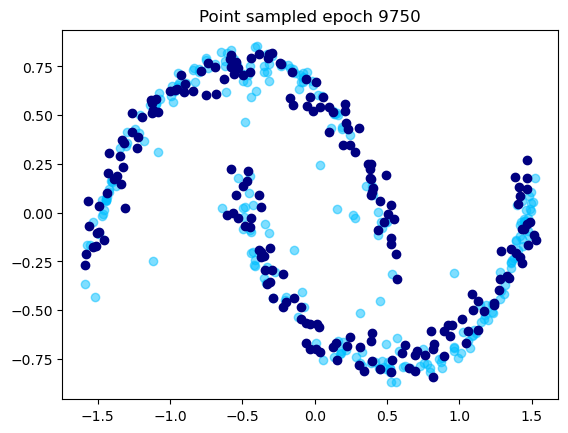

[9800/10000] 	Loss: 0.0001
[9850/10000] 	Loss: 0.0000
[9900/10000] 	Loss: 0.0001
[9950/10000] 	Loss: 0.0001
[10000/10000] 	Loss: 0.0001


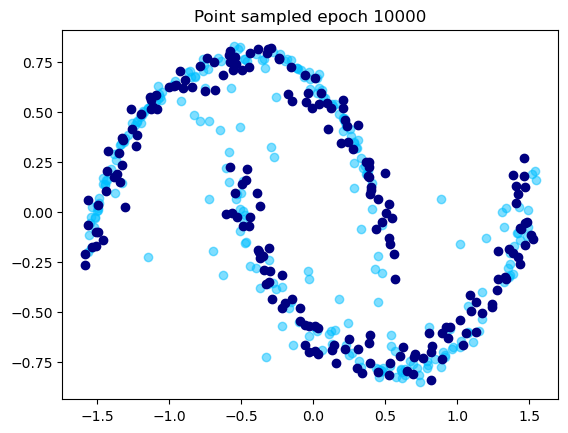

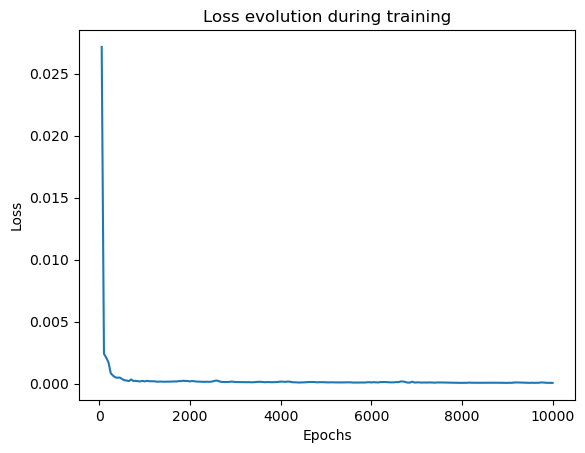

In [31]:
distill_consistency(score_model_path,
                    nepochs, lr, ema_decay,
                    n_samples_per_batch, nb_degradation_per_datapoint,
                    d_model, n_blocks, num_diffusion_timesteps, timespand,
                    epoch_log, epoch_display, nb_samples_display,
                    fig_savepath, model_savepath)

## T=1000, N=20

In [89]:
score_model_path = "./models/diffusion_two_moons_T1000_epoch10000.pt"

nepochs=4000
lr=1e-3
ema_decay=0.3

n_samples_per_batch=128
nb_degradation_per_datapoint=1

d_model=128
n_blocks=5
num_diffusion_timesteps=100 # N
timespand=1000 # T

epoch_log=50
epoch_display=100
nb_samples_display=256

fig_savepath="./figures/CD_two_moons_T1000_N20"
model_savepath="./models/CD_two_moons_T1000_N20_epoch4000.pt"

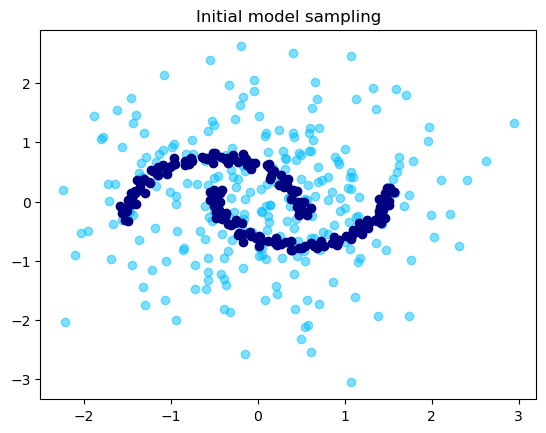

[50/4000] 	Loss: 0.0061
[100/4000] 	Loss: 0.0012


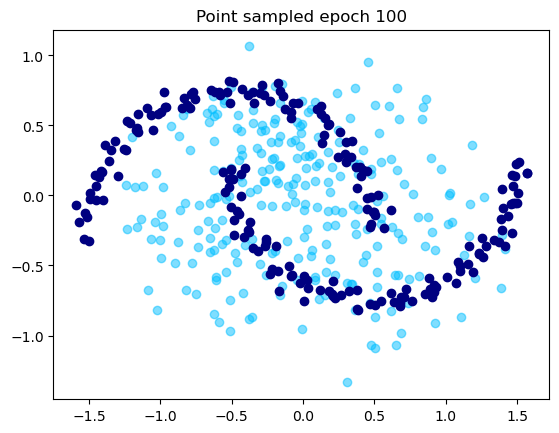

[150/4000] 	Loss: 0.0015
[200/4000] 	Loss: 0.0006


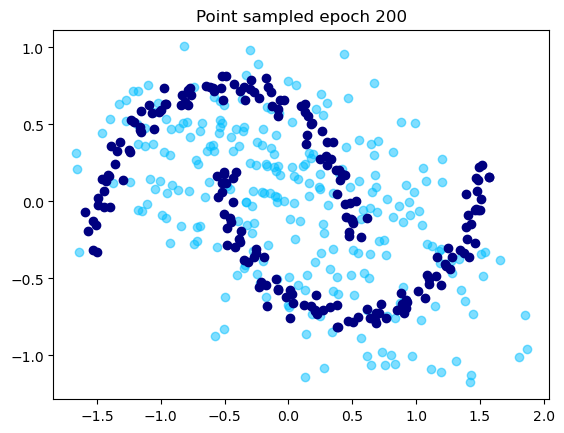

[250/4000] 	Loss: 0.0003
[300/4000] 	Loss: 0.0003


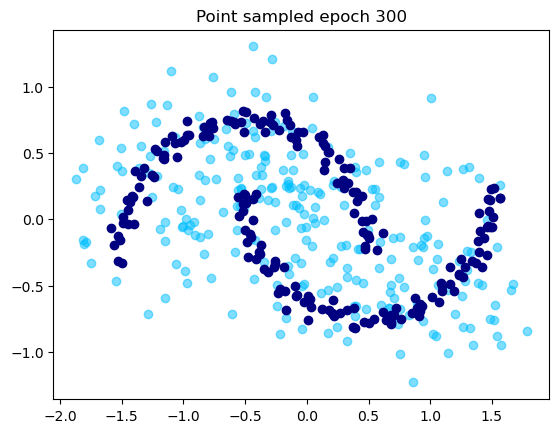

[350/4000] 	Loss: 0.0002
[400/4000] 	Loss: 0.0003


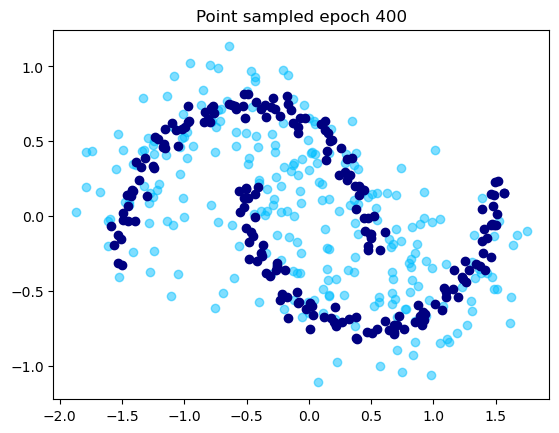

[450/4000] 	Loss: 0.0002
[500/4000] 	Loss: 0.0002


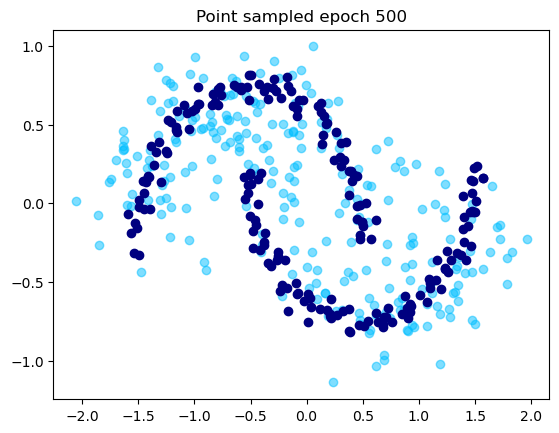

[550/4000] 	Loss: 0.0002
[600/4000] 	Loss: 0.0002


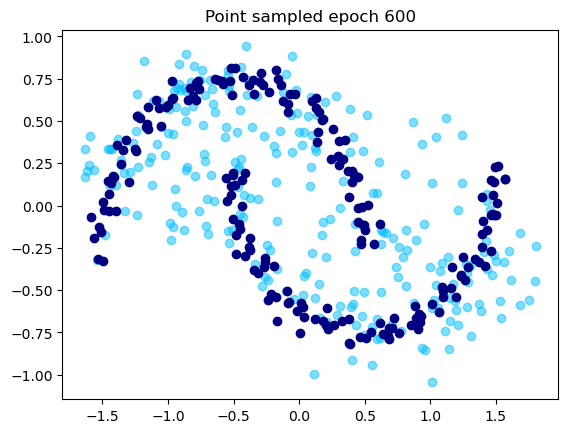

[650/4000] 	Loss: 0.0002
[700/4000] 	Loss: 0.0001


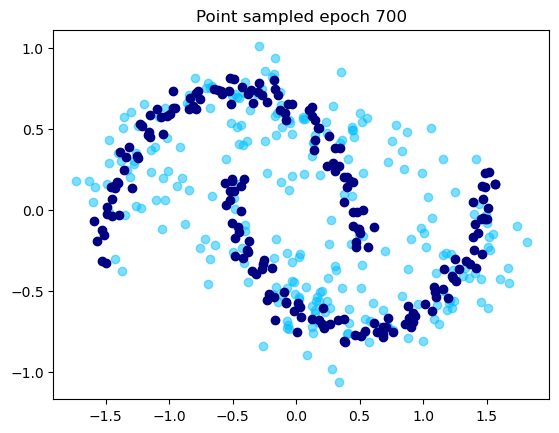

[750/4000] 	Loss: 0.0002
[800/4000] 	Loss: 0.0002


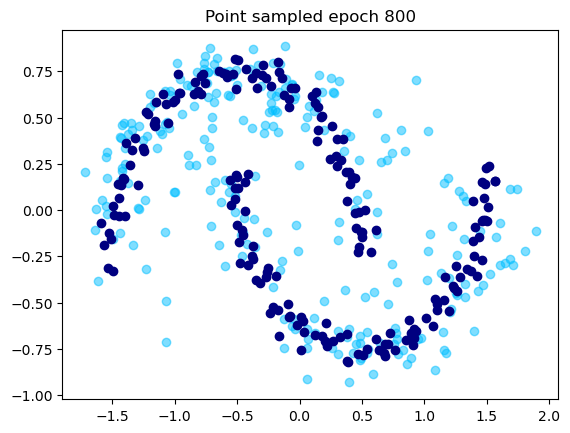

[850/4000] 	Loss: 0.0002
[900/4000] 	Loss: 0.0002


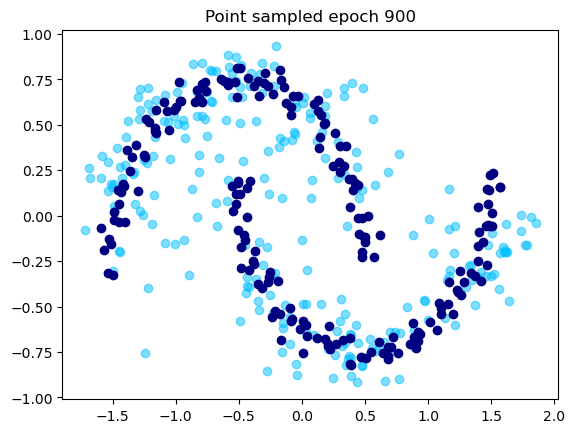

[950/4000] 	Loss: 0.0002
[1000/4000] 	Loss: 0.0001


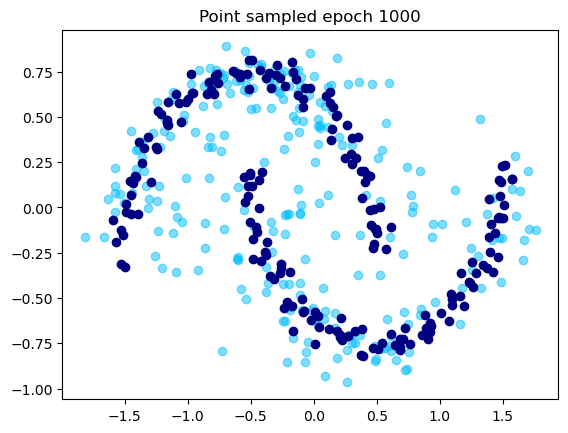

[1050/4000] 	Loss: 0.0002
[1100/4000] 	Loss: 0.0001


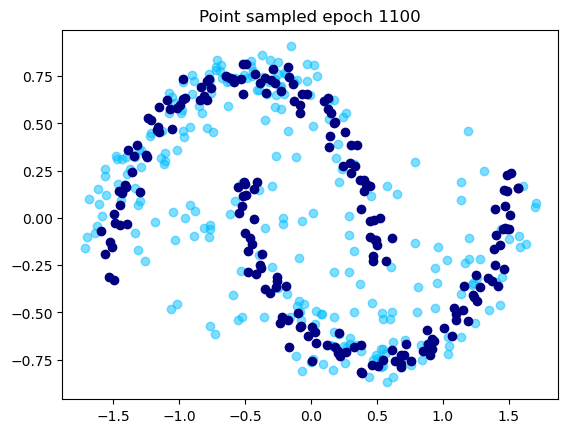

[1150/4000] 	Loss: 0.0001
[1200/4000] 	Loss: 0.0002


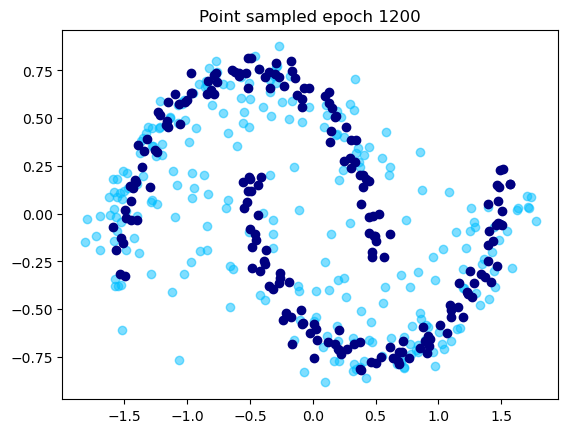

[1250/4000] 	Loss: 0.0002
[1300/4000] 	Loss: 0.0002


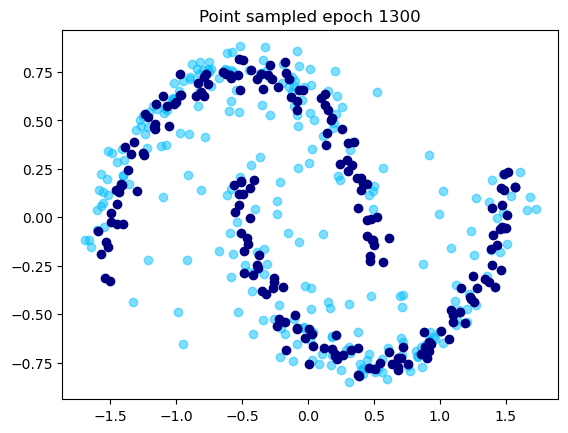

[1350/4000] 	Loss: 0.0002
[1400/4000] 	Loss: 0.0002


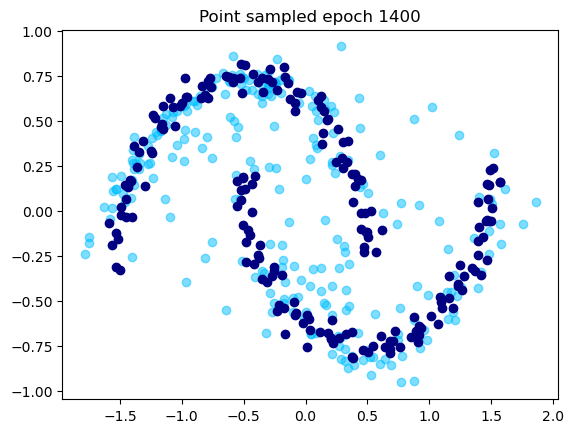

[1450/4000] 	Loss: 0.0002
[1500/4000] 	Loss: 0.0001


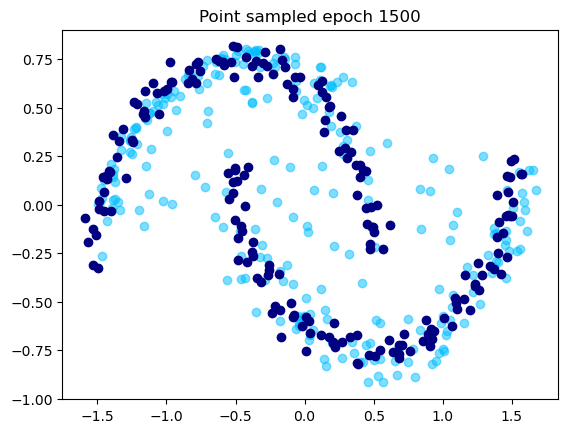

[1550/4000] 	Loss: 0.0001
[1600/4000] 	Loss: 0.0002


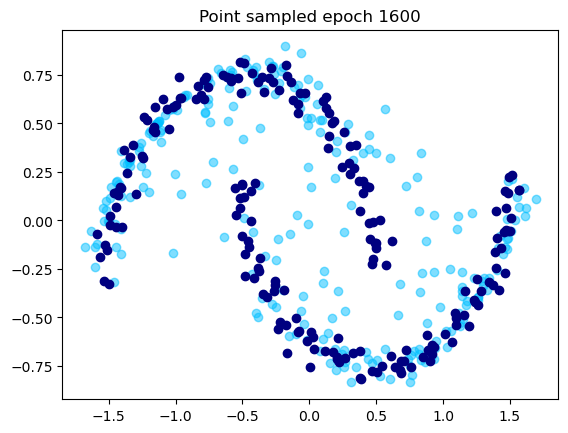

[1650/4000] 	Loss: 0.0002
[1700/4000] 	Loss: 0.0003


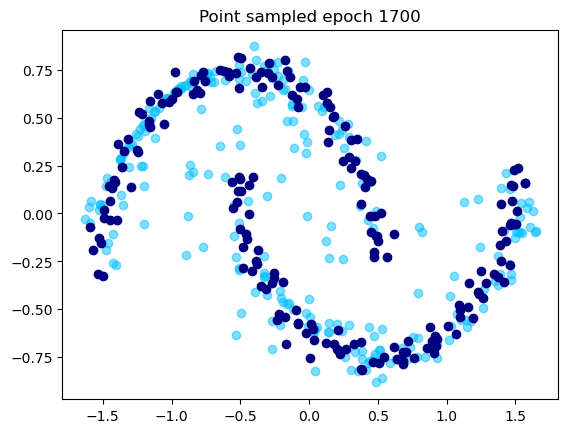

[1750/4000] 	Loss: 0.0002
[1800/4000] 	Loss: 0.0003


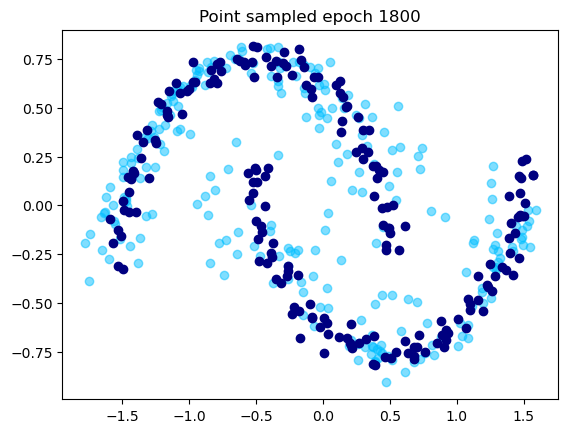

[1850/4000] 	Loss: 0.0002
[1900/4000] 	Loss: 0.0002


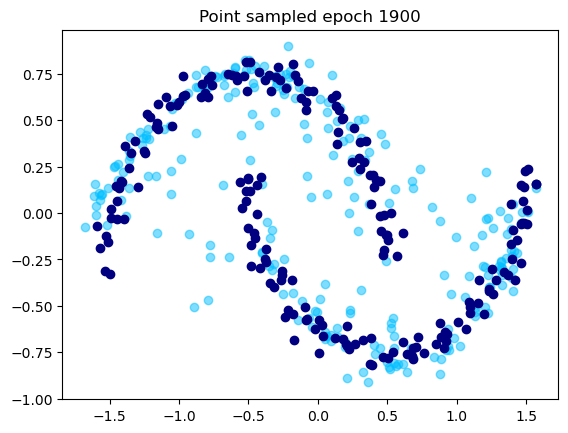

[1950/4000] 	Loss: 0.0002
[2000/4000] 	Loss: 0.0002


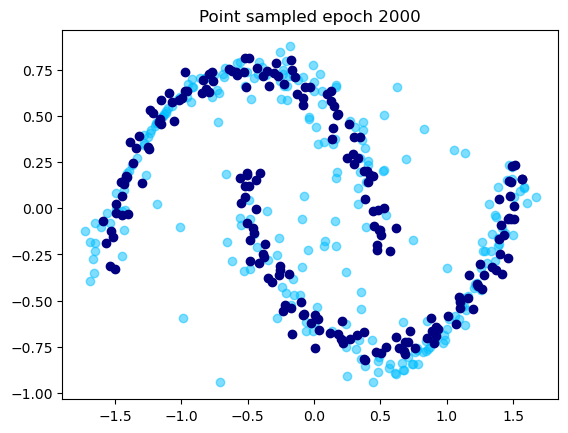

[2050/4000] 	Loss: 0.0001
[2100/4000] 	Loss: 0.0001


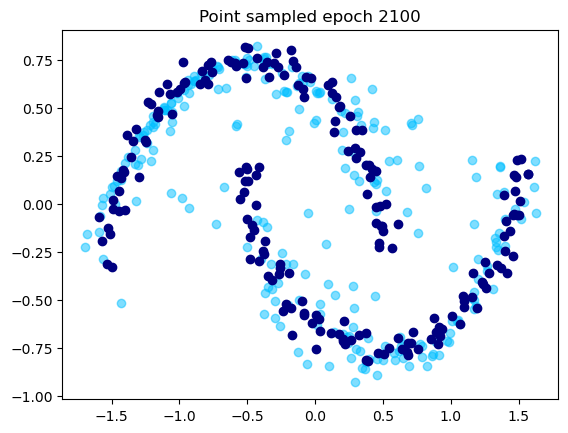

[2150/4000] 	Loss: 0.0002
[2200/4000] 	Loss: 0.0002


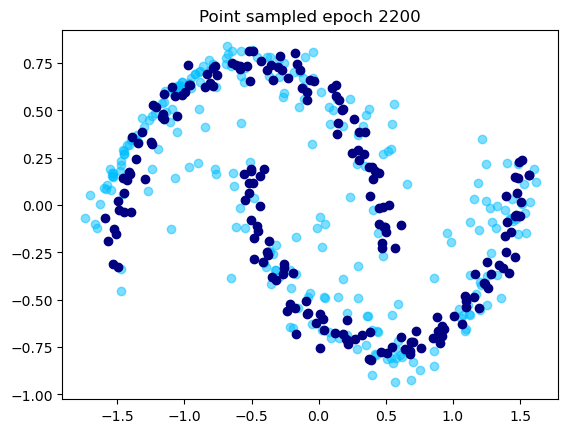

[2250/4000] 	Loss: 0.0001
[2300/4000] 	Loss: 0.0002


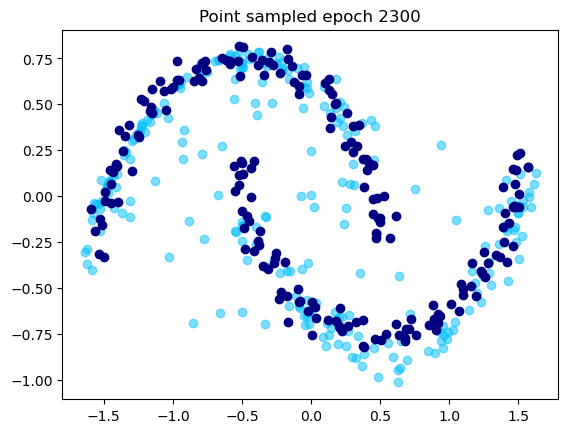

[2350/4000] 	Loss: 0.0001
[2400/4000] 	Loss: 0.0001


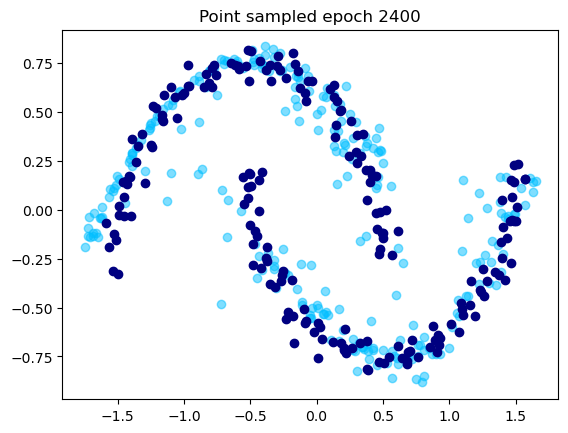

[2450/4000] 	Loss: 0.0001
[2500/4000] 	Loss: 0.0002


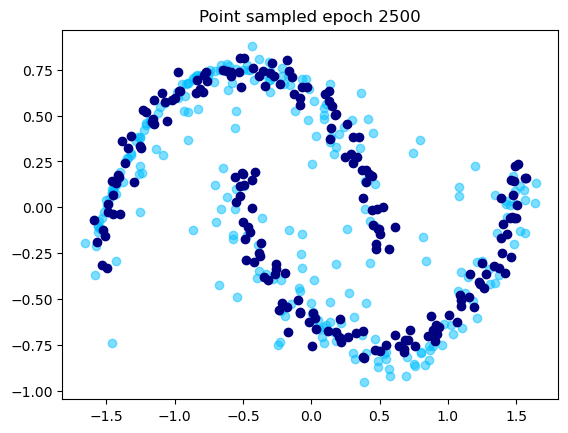

[2550/4000] 	Loss: 0.0001
[2600/4000] 	Loss: 0.0001


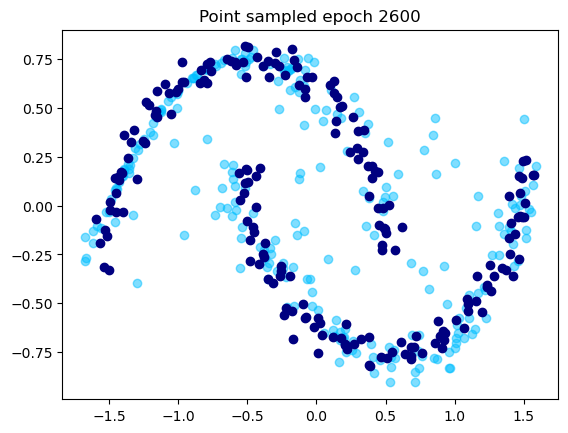

[2650/4000] 	Loss: 0.0001
[2700/4000] 	Loss: 0.0001


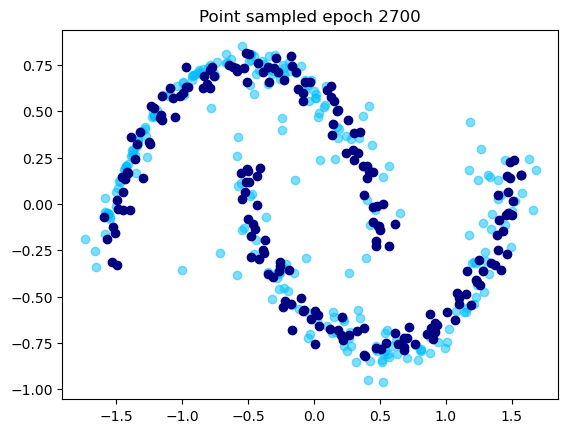

[2750/4000] 	Loss: 0.0002
[2800/4000] 	Loss: 0.0002


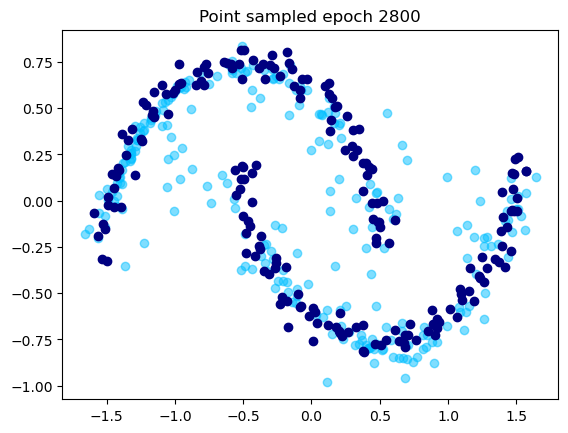

[2850/4000] 	Loss: 0.0002
[2900/4000] 	Loss: 0.0001


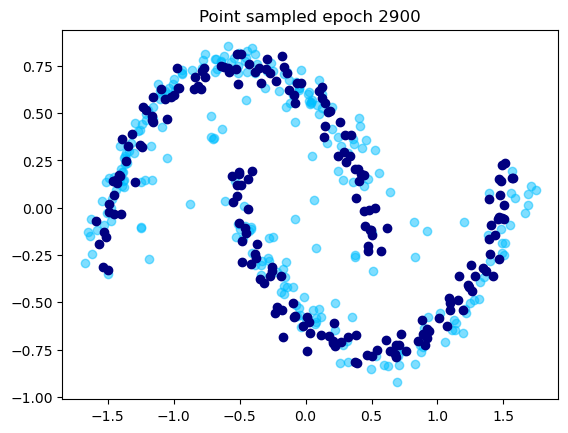

[2950/4000] 	Loss: 0.0002
[3000/4000] 	Loss: 0.0002


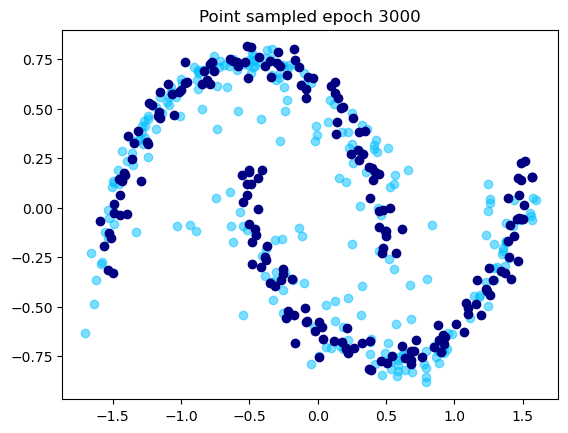

[3050/4000] 	Loss: 0.0002
[3100/4000] 	Loss: 0.0002


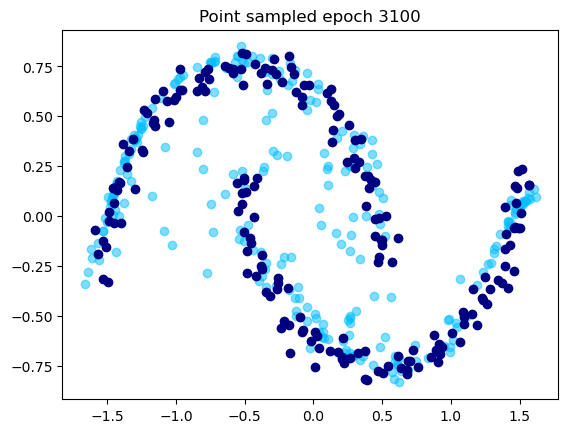

[3150/4000] 	Loss: 0.0002
[3200/4000] 	Loss: 0.0001


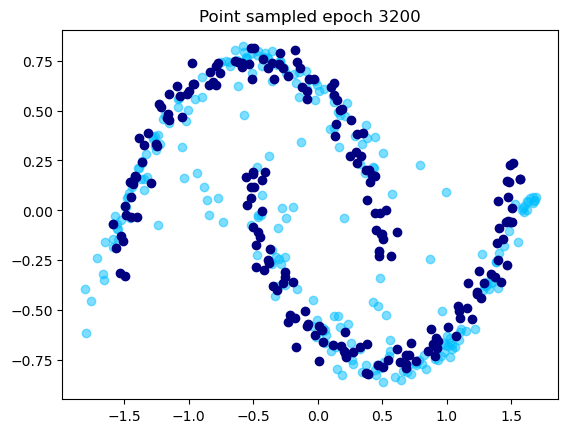

[3250/4000] 	Loss: 0.0001
[3300/4000] 	Loss: 0.0001


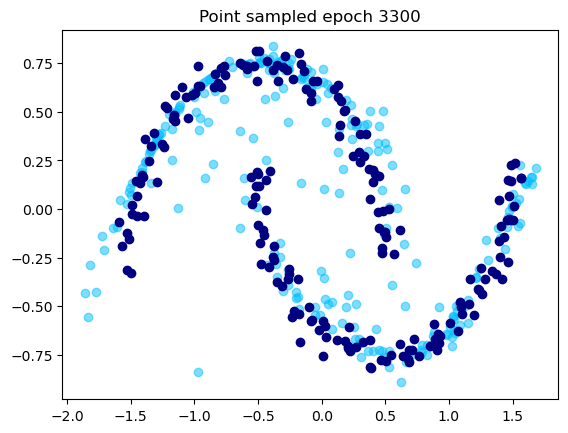

[3350/4000] 	Loss: 0.0001
[3400/4000] 	Loss: 0.0001


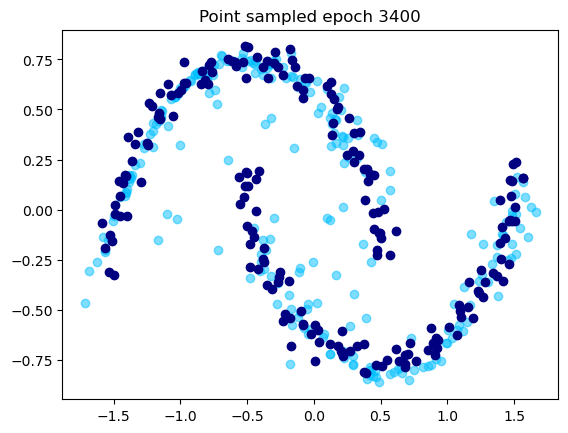

[3450/4000] 	Loss: 0.0001
[3500/4000] 	Loss: 0.0001


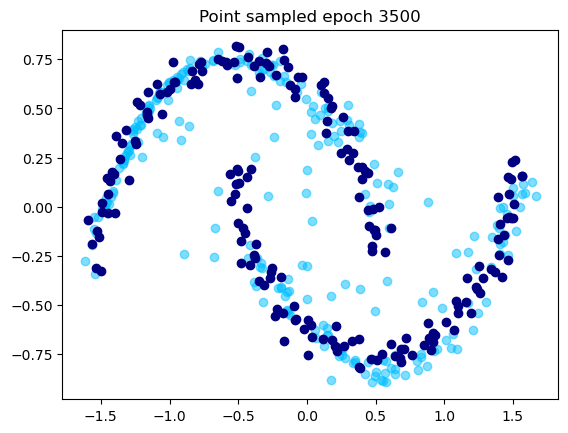

[3550/4000] 	Loss: 0.0001
[3600/4000] 	Loss: 0.0001


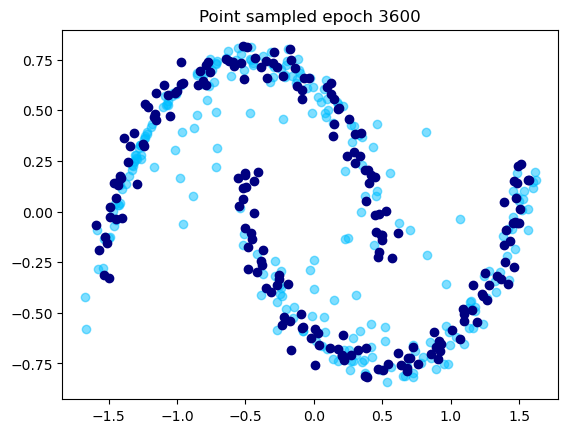

[3650/4000] 	Loss: 0.0001
[3700/4000] 	Loss: 0.0002


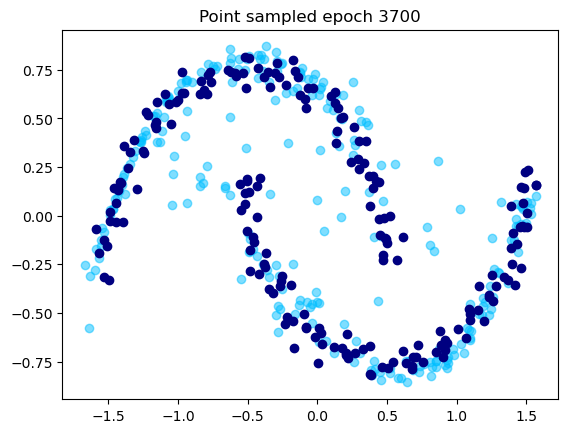

[3750/4000] 	Loss: 0.0002
[3800/4000] 	Loss: 0.0001


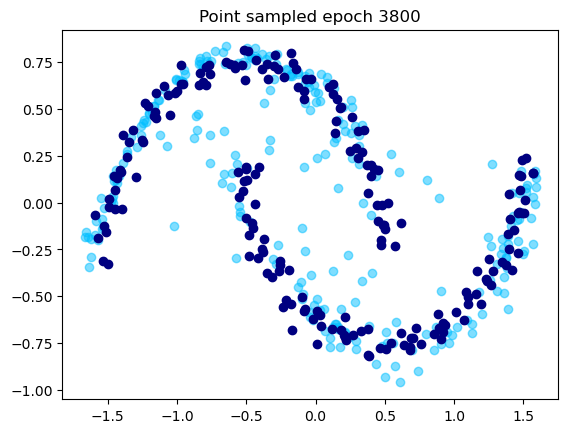

[3850/4000] 	Loss: 0.0001
[3900/4000] 	Loss: 0.0001


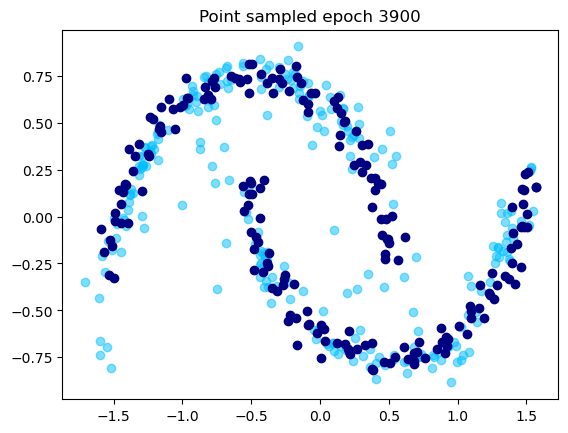

[3950/4000] 	Loss: 0.0002
[4000/4000] 	Loss: 0.0001


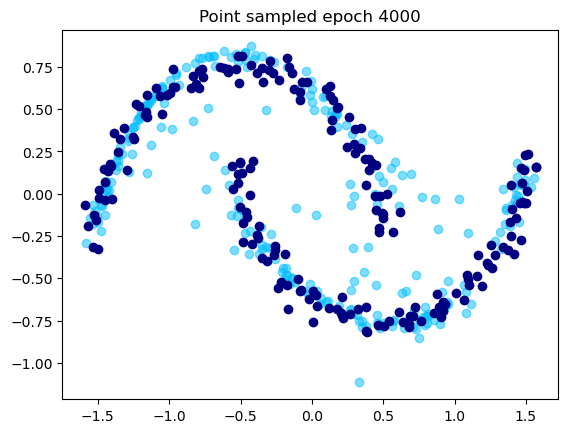

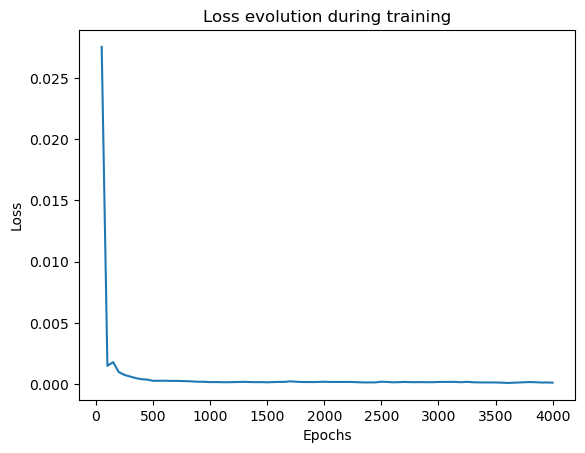

In [90]:
distill_consistency(score_model_path,
                    nepochs, lr, ema_decay,
                    n_samples_per_batch, nb_degradation_per_datapoint,
                    d_model, n_blocks, num_diffusion_timesteps, timespand,
                    epoch_log, epoch_display, nb_samples_display,
                    fig_savepath, model_savepath)

# Multistep sampling

In [21]:
def multistep_sampling(consistency_model_path, N, T, nb_samples, steps, d_model = 128, n_blocks = 5):
    consistency_model = ConsistencyDiscreteTimeModel(d_model=d_model, n_blocks=n_blocks, n_time_steps=N, total_time=T).to(device)
    optimizer = optim.AdamW(consistency_model.parameters(), lr=0.)
    ema_consistency = EMA(consistency_model, decay = 1.)
    load_checkpoint(consistency_model, ema_consistency, optimizer, consistency_model_path)

    with torch.no_grad():  # avoid backprop wrt model parameters
        x = torch.randn((nb_samples, consistency_model.dim_output), device=device)  # initialize x_t for t=T
        t_flatten_idx = (consistency_model.num_diffusion_timesteps-1)*torch.ones((x.shape[0],), dtype = torch.int32, device = x.device)
        t_flatten = consistency_model.map_tidx_to_teq(t_flatten_idx)
        x = consistency_model(x, t_flatten)
        first_sampled = x.clone()
        for t_step in steps:
            t_idx = t_step*torch.ones((x.shape[0],1), dtype = torch.int32, device = x.device)
            t_eq = consistency_model.map_tidx_to_teq(t_idx)
            x, _ = degrade_data_point(x, consistency_model.alphas_cumprod, t_eq)
            x = consistency_model(x, t_eq.view(-1))
    return first_sampled, x

def plot_multistep_sampling(consistency_model_path, N, T, nb_samples, steps, n_distribution_samples = 64, d_model = 128, n_blocks = 5):
    direct_sampling, multistep_sampled = multistep_sampling(consistency_model_path, N, T, nb_samples, steps, d_model = d_model, n_blocks = n_blocks)

    # Plot original and degraded points
    fig = plt.figure(dpi=100)
    plt.scatter(direct_sampling[:, 0].cpu(), direct_sampling[:,1].cpu(), c='deepskyblue', alpha=.5, label = "One step")
    plt.scatter(multistep_sampled[:, 0].cpu(), multistep_sampled[:,1].cpu(), c='darkgreen', alpha=.5, label = "Multi-step")
    original = get_two_moons_centered(n_samples = n_distribution_samples)
    plt.scatter(original[:, 0].cpu(), original[:,1].cpu(), c='navy', label = "Original")
    training = consistency_model_path.replace("./models/", "")[0:2]
    plt.title(f"Multi-step sampling vs. One-step sampling ({training}, N={N})")
    plt.legend()
    plt.savefig(f"./figures/Multistep_sampling/{training}_N{N}")
    plt.show()
    plt.close()

## Consistency distillation

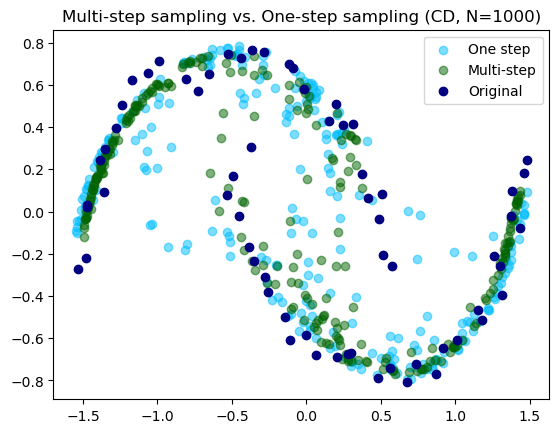

In [22]:
nb_samples = 256
N = 1000
T = 1000
multi_time_steps = [950, 900, 800, 600, 300, 100, 50]
model_path = "./models/CD_two_moons_T1000_N1000_epoch20000.pt"

plot_multistep_sampling(model_path, N, T, nb_samples, multi_time_steps)

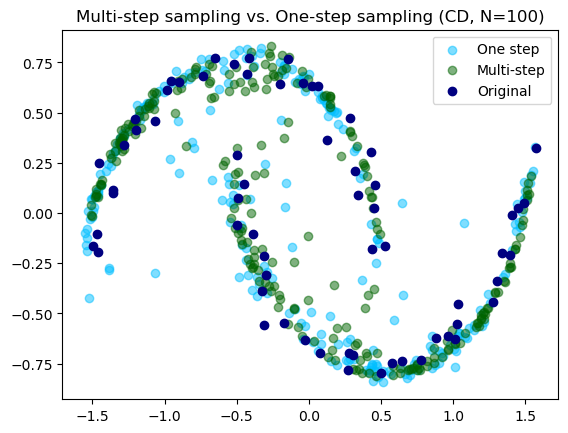

In [23]:
nb_samples = 256
N = 100
T = 1000
multi_time_steps = [95, 90, 80, 60, 30, 10, 5]
model_path = "./models/CD_two_moons_T1000_N100_epoch10000.pt"

plot_multistep_sampling(model_path, N, T, nb_samples, multi_time_steps)

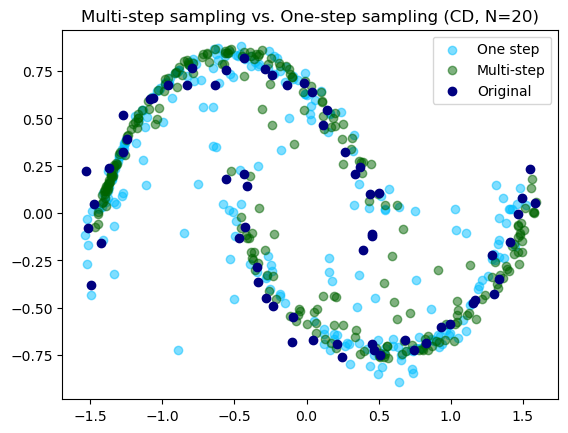

In [24]:
nb_samples = 256
N = 20
T = 1000
multi_time_steps = [19, 18, 16, 12, 6, 2, 1]
model_path = "./models/CD_two_moons_T1000_N20_epoch4000.pt"

plot_multistep_sampling(model_path, N, T, nb_samples, multi_time_steps)

## Consistency training

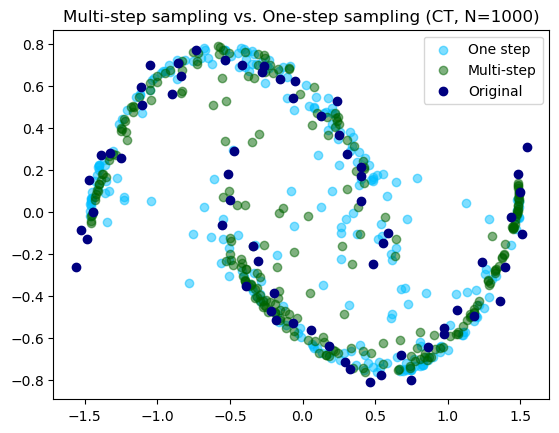

In [25]:
nb_samples = 256
N = 1000
T = 1000
multi_time_steps = [950, 900, 800, 600, 300, 100, 50]
model_path = "./models/CT_two_moons_T1000_N1000_epoch40000.pt"

plot_multistep_sampling(model_path, N, T, nb_samples, multi_time_steps)

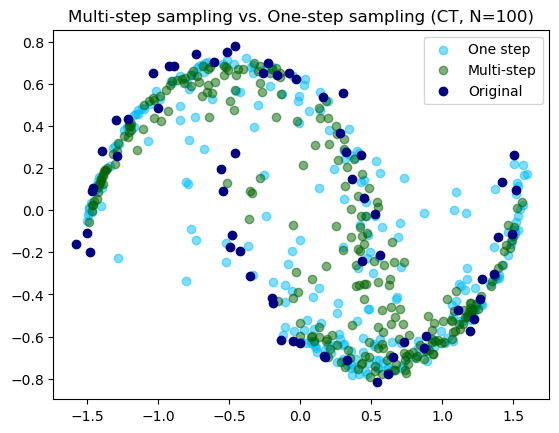

In [26]:
nb_samples = 256
N = 100
T = 1000
multi_time_steps = [95, 90, 80, 60, 30, 10, 5]
model_path = "./models/CT_two_moons_T1000_N100_epoch10000.pt"

plot_multistep_sampling(model_path, N, T, nb_samples, multi_time_steps)

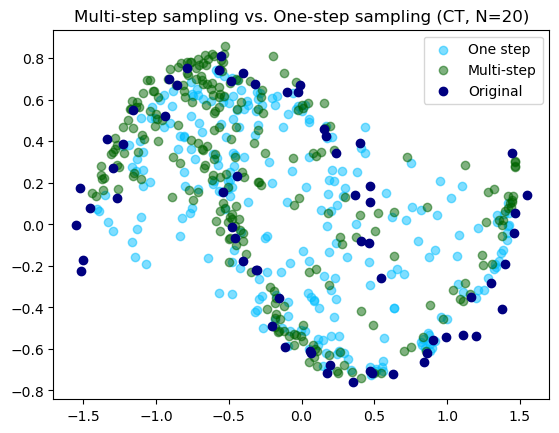

In [27]:
nb_samples = 256
N = 20
T = 1000
multi_time_steps = [19, 18, 16, 12, 6, 2, 1]
model_path = "./models/CT_two_moons_T1000_N20_epoch4000.pt"

plot_multistep_sampling(model_path, N, T, nb_samples, multi_time_steps)